## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
import shutil
warnings.filterwarnings('ignore')

In [5]:
# wipe all solutions in the directory

try:
    shutil.rmtree('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/')
    shutil.rmtree('../leak_location_results/no_leak/each-node-optimization-plots-new/')
    shutil.rmtree('../leak_location_results/no_leak/merged_results-new/')
    print('Folders Deleted')
except FileNotFoundError as e:
    print(e)

# recreate deleted folders
os.makedirs('../leak_location_results/no_leak/each-node-optimization-results-csvs-new')
os.makedirs('../leak_location_results/no_leak/each-node-optimization-plots-new')
os.makedirs('../leak_location_results/no_leak/merged_results-new')


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

Folders Deleted


## Read Inp File

In [6]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    inp_file_path = r"../data/Real_Synthetic_Net.inp" 
    function_inputs = None
    desired_output = None

In [7]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
        #Setup all neccessary folders we need to work with, i.e. create them if they don't exist
        if not os.path.exists('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/solutions_for_'+self.node):
            os.mkdir('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/solutions_for_'+self.node)
            
        if not os.path.exists('../leak_location_results/no_leak/each-node-optimization-plots-new/plots_for_'+self.node):
            os.mkdir('../leak_location_results/no_leak/each-node-optimization-plots-new/plots_for_'+self.node)


        if not os.path.exists('../leak_location_results/no_leak/merged_results-new'):
            os.mkdir('../leak_location_results/no_leak/merged_results-new')
            
        self.temp_dir = '../leak_location_results/no_leak/each-node-optimization-results-csvs-new/solutions_for_'+self.node
        self.plots_dir = '../leak_location_results/no_leak/each-node-optimization-plots-new/plots_for_'+self.node
        self.merged_result = '../leak_location_results/no_leak/merged_results-new'

    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        
        if plot_graph:
            pressure = results.node['pressure']
            pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        if emitter_value>1:
            emitter_value=emitter_value%1
            
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, name:str, path=None):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in solutions:
            data = pd.read_csv(i)
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.function_inputs = function_inputs
        self.desired_output = node.head - node.elevation
            

In [8]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N6')

In [9]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
    
    emitter_coeff = solution[0]*water_model.function_inputs

    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(emitter_coeff)) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.desired_output) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    
    emitter_coeff=abs(solution[0]) 
    
    if emitter_coeff>1:
        emitter_coeff=emitter_coeff%1

    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(emitter_coeff),\
                        'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],\
                        'OUTPUT_DEMAND':(list(demand_output) [0]*1000),\
                        'NODE': current_node},ignore_index=True)
    
    data.to_csv(f"{water_model.temp_dir}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',\
           list(round(pressure_output,3))[0],\
           '|==================|',list(round(fitness, 3))[0],'|==========|',\
           current_node,'|==========')
    
    print('***********************************'*2)

    return list(fitness)[0]

In [10]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1],'NODE':current_node},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [11]:
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
model_nodes = wn.junction_name_list

In [12]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

In [13]:
choosen_nodes_for_leak = [None] #nodes we want to add leak

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 9.355 |==================| 64.163 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 9.368 |==================| 353.43 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 9.361 |==================| 103.108 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 9.366 |==================| 212.024 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 9.363 |==================| 138.129 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 9.359 |==================| 89.758 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.677 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.433 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 9.359 |==================| 84.49 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.956 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 9.365 |==================| 189.271 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 9.365 |==================| 188.316 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 9.366 |==================| 202.768 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.767 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 9.362 |==================| 110.4 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 9.36 |==================| 98.298 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.07 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 9.357 |==================| 73.516 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 9.367 |==================| 300.563 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 9.368 |==================| 353.35 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.948 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 9.365 |==================| 195.242 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 269.808 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 9.359 |==================| 85.756 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 9.36 |==================| 91.76 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 9.37 |==================| 1318.544 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 9.358 |==================| 78.736 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.948 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 9.363 |==================| 124.232 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 9.365 |==================| 180.401 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 443.523 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 9.369 |==================| 506.833 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 9.37 |==================| 1034.022 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 676.626 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 9.362 |==================| 111.063 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.627 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 9.355 |==================| 65.934 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 9.365 |==================| 171.054 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 9.365 |==================| 186.017 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 9.356 |==================| 68.096 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 9.37 |==================| 2341.463 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 9.357 |==================| 73.375 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.556 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 9.362 |==================| 114.492 |==========| N1 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.073 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.313 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 9.356 |==================| 67.199 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 9.37 |==================| 2341.463 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 9.363 |==================| 130.369 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 314.645 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 9.369 |==================| 552.883 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 9.362 |==================| 121.34 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1182.267 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 9.356 |==================| 67.824 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 9.369 |==================| 667.577 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 235.537 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 9.355 |==================| 63.875 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.366 |==================| 195.711 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 9.356 |==================| 66.747 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 9.362 |==================| 121.978 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 9.366 |==================| 228.193 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 9.366 |==================| 206.897 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 9.366 |==================| 242.012 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 9.356 |==================| 68.709 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 9.365 |==================| 180.041 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 9.361 |==================| 99.451 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 9.362 |==================| 113.931 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 9.36 |==================| 89.998 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.679 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 9.355 |==================| 66.152 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 9.36 |==================| 90.459 |==========| N1 |==========
**********************************************************************
Generation = 7
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.687 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.089 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.637 |==========| N1 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 9.367 |==================| 288.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 9.356 |==================| 67.239 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 9.367 |==================| 248.236 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 9.359 |==================| 89.632 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 9.366 |==================| 205.653 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 9.365 |==================| 182.767 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 9.363 |==================| 138.604 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 9.362 |==================| 118.417 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 9.359 |==================| 83.051 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 9.361 |==================| 102.513 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 9.366 |==================| 228.117 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 9.368 |==================| 418.241 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 9.368 |==================| 439.826 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 9.359 |==================| 88.789 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 9.366 |==================| 220.742 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 9.365 |==================| 169.876 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 9.367 |==================| 267.62 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 9.36 |==================| 93.11 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.708 |==========| N1 |==========
**********************************************************************
=====|SOLU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 9.358 |==================| 81.909 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 9.358 |==================| 77.596 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 9.365 |==================| 171.102 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 9.361 |==================| 103.459 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 9.366 |==================| 213.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 269.662 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 9.36 |==================| 93.209 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 9.36 |==================| 94.809 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 9.359 |==================| 83.496 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 9.367 |==================| 313.113 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 9.36 |==================| 93.877 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 97.0 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 9.367 |==================| 305.006 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 9.362 |==================| 114.601 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1189.454 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 9.367 |==================| 279.552 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 9.363 |==================| 126.166 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 9.358 |==================| 77.403 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 9.361 |==================| 103.121 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 9.358 |==================| 82.103 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 9.365 |==================| 184.503 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 9.369 |==================| 483.761 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 9.364 |==================| 144.361 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.15 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 9.357 |==================| 74.36 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 9.357 |==================| 75.427 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 9.364 |==================| 160.552 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 9.367 |==================| 289.304 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 9.355 |==================| 64.315 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 9.363 |==================| 133.334 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 9.366 |==================| 198.965 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 9.37 |==================| 1365.246 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 9.358 |==================| 79.983 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 9.366 |==================| 238.799 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 9.363 |==================| 132.171 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 9.367 |==================| 246.877 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 9.356 |==================| 69.26 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 9.355 |==================| 64.204 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 9.356 |==================| 70.21 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 9.355 |==================| 65.408 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 977.862 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 9.356 |==================| 66.827 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 9.367 |==================| 286.74 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 164.012 |==========| N1 |==========
**********************************************************************
===

======| 0.766 |===========| 9.359 |==================| 83.56 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.527 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.423 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1098.725 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 9.369 |==================| 598.291 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 9.367 |==================| 264.376 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.639 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 9.357 |==================| 72.581 |==========| N1 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 9.36 |==================| 96.812 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.704 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.942 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.237 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 9.369 |==================| 650.724 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 843.535 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 9.37 |==================| 4460.115 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 9.369 |==================| 679.748 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 9.369 |==================| 556.828 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 9.357 |==================| 74.736 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 9.358 |==================| 77.074 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 9.356 |==================| 69.89 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 9.365 |==================| 167.494 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 9.36 |==================| 93.065 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.761 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 9.369 |==================| 824.719 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.922 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 9.357 |==================| 74.273 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 9.36 |==================| 93.101 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 183.81 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 9.355 |==================| 65.81 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 183.994 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 9.368 |==================| 422.989 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 9.358 |==================| 79.827 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 9.369 |==================| 857.623 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.916 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 9.368 |==================| 328.795 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 9.37 |==================| 912.475 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 9.358 |==================| 76.949 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 9.355 |==================| 64.264 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 9.362 |==================| 122.376 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 9.369 |==================| 580.051 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 9.365 |==================| 164.701 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 9.36 |==================| 90.391 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 9.365 |==================| 193.035 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 291.667 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 9.363 |==================| 133.579 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.958 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 9.366 |==================| 219.485 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 9.369 |==================| 511.5 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.402 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 137.087 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 9.369 |==================| 646.018 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 9.359 |==================| 83.844 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 9.369 |==================| 880.666 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 9.364 |==================| 146.382 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 9.362 |==================| 113.782 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.75 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 9.36 |==================| 91.222 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 9.357 |==================| 72.591 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 9.364 |==================| 153.412 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 9.36 |==================| 90.282 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 9.356 |==================| 69.266 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 9.37 |==================| 992.776 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 9.356 |==================| 69.753 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 9.355 |==================| 65.284 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 9.362 |==================| 122.574 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 9.363 |==================| 126.527 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.789 |==========| N1 |==========
**********************************************************************
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 9.364 |==================| 157.231 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 9.363 |==================| 126.59 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 9.367 |==================| 267.284 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 19115.773 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 9.365 |==================| 194.89 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.864 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 431.16 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 9.366 |==================| 216.682 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 9.361 |==================| 99.332 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 9.362 |==================| 114.426 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 19115.773 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 9.369 |==================| 701.691 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.874 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 9.363 |==================| 129.648 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 9.358 |==================| 78.764 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 9.364 |==================| 140.616 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 9.355 |==================| 66.003 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 9.363 |==================| 134.604 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 9.369 |==================| 701.691 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 9.368 |==================| 369.008 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 9.366 |==================| 238.591 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 9.361 |==================| 104.934 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 9.357 |==================| 75.245 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 9.363 |==================| 124.411 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1931.436 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 9.361 |==================| 104.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 9.357 |==================| 75.026 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 9.365 |==================| 173.139 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 9.358 |==================| 76.996 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 289.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 9.358 |==================| 79.597 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.422 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 9.369 |==================| 645.799 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 9.355 |==================| 64.617 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.369 |==================| 898.785 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.318 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 367.155 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.324 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 9.363 |==================| 135.291 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 9.365 |==================| 189.672 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 355.212 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 9.367 |==================| 320.915 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 9.357 |==================| 72.313 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 9.36 |==================| 95.148 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 9.36 |==================| 94.482 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 9.37 |==================| 2770.564 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.153 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 9.357 |==================| 73.213 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 9.367 |==================| 304.616 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 9.371 |==================| 13624.44 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 9.366 |==================| 205.525 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 9.358 |==================| 81.714 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 9.37 |==================| 1238.084 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 9.359 |==================| 86.407 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 120.89 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 9.365 |==================| 182.61 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 9.369 |==================| 608.335 |==========| N1 |==========
**********************************************************************
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 9.356 |==================| 67.496 |==========| N1 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 9.367 |==================| 313.208 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 9.368 |==================| 378.683 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 9.359 |==================| 89.347 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.76 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 9.357 |==================| 75.627 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 9.357 |==================| 73.444 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 9.36 |==================| 93.047 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.479 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.662 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 9.366 |==================| 200.415 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 9.36 |==================| 92.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 9.355 |==================| 64.237 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 9.365 |==================| 177.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 9.369 |==================| 776.852 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 9.356 |==================| 68.202 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 9.367 |==================| 288.501 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.348 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 9.363 |==================| 129.261 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 9.358 |==================| 81.974 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 234.947 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 9.355 |==================| 65.284 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.26 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.921 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 9.356 |==================| 66.592 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 9.37 |==================| 2613.405 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 9.37 |==================| 955.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 9.355 |==================| 64.505 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 9.365 |==================| 187.353 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.602 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 9.366 |==================| 197.933 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 291.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 9.358 |==================| 80.131 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 9.356 |==================| 70.686 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 9.364 |==================| 150.068 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 9.364 |==================| 147.182 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.602 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 9.366 |==================| 225.718 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 9.36 |==================| 95.511 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 9.365 |==================| 165.162 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 9.361 |==================| 101.753 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 9.358 |==================| 81.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 9.357 |==================| 76.035 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 9.358 |==================| 76.746 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 9.368 |==================| 425.391 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 431.008 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 9.361 |==================| 104.704 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.37 |==================| 908.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 9.355 |==================| 65.735 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 9.365 |==================| 168.87 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 9.361 |==================| 105.811 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 9.362 |==================| 116.184 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 9.36 |==================| 94.884 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 9.369 |==================| 504.798 |==========| N1 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 9.365 |==================| 177.082 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.188 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 444.184 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 261.41 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 9.361 |==================| 105.213 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.362 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 9.369 |==================| 535.48 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 9.357 |==================| 71.412 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 9.369 |==================| 712.462 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 9.362 |==================| 111.305 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 162.146 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 9.358 |==================| 79.704 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 9.369 |==================| 524.855 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 9.364 |==================| 145.161 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 9.364 |==================| 144.121 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 9.364 |==================| 162.559 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.447 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.092 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 9.37 |==================| 1907.733 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.357 |==================| 70.865 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 9.368 |==================| 323.307 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 9.366 |==================| 201.412 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 9.36 |==================| 91.849 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 9.359 |==================| 86.537 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 9.358 |==================| 78.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 9.36 |==================| 95.2 |==========| N1 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 9.356 |==================| 69.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 9.363 |==================| 132.364 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 9.361 |==================| 109.008 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 9.359 |==================| 89.396 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 9.365 |==================| 187.674 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 9.37 |==================| 1291.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.293 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 9.366 |==================| 226.629 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.431 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 9.357 |==================| 74.933 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 9.359 |==================| 86.579 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.839 |==========| N1 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 9.369 |==================| 744.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.992 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 9.364 |==================| 145.32 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 9.359 |==================| 84.327 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 9.355 |==================| 64.837 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 9.362 |==================| 118.043 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 9.357 |==================| 73.077 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.571 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 9.36 |==================| 97.722 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.896 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 9.357 |==================| 76.031 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 9.368 |==================| 440.221 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 161.842 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 9.366 |==================| 240.925 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 9.361 |==================| 101.272 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 9.362 |==================| 120.291 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 9.361 |==================| 102.549 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 9.365 |==================| 176.242 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 9.359 |==================| 87.499 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 9.358 |==================| 77.862 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.176 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 9.366 |==================| 208.519 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 9.37 |==================| 1329.11 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 9.356 |==================| 67.996 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 9.357 |==================| 73.036 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 9.368 |==================| 446.528 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 9.367 |==================| 247.164 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 9.37 |==================| 3887.222 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 9.358 |==================| 76.383 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 9.371 |==================| 12343.777 |==========| N1 |==========
**********************************************************************
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 586.025 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 9.356 |==================| 68.511 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 9.369 |==================| 473.87 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 9.356 |==================| 69.103 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 9.358 |==================| 76.939 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 9.357 |==================| 73.484 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 9.355 |==================| 65.702 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.345 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.466 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 9.356 |==================| 69.394 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.788 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 9.369 |==================| 531.827 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 9.358 |==================| 78.606 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 9.364 |==================| 160.415 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 9.363 |==================| 140.423 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 9.356 |==================| 68.42 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 340.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 9.37 |==================| 2278.097 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 9.356 |==================| 66.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 9.37 |==================| 950.197 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 9.37 |==================| 1567.731 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 9.361 |==================| 107.377 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 9.359 |==================| 88.665 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 9.357 |==================| 75.869 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 9.369 |==================| 612.275 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 9.367 |==================| 279.008 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.518 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.321 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 9.356 |==================| 67.392 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 9.359 |==================| 88.665 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 9.362 |==================| 113.581 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 9.36 |==================| 98.358 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 9.366 |==================| 227.333 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.649 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 9.37 |==================| 3853.83 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 9.368 |==================| 398.11 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 9.357 |==================| 71.44 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 9.362 |==================| 113.581 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.705 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 9.37 |==================| 1309.632 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 9.364 |==================| 162.419 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.804 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 9.36 |==================| 98.04 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 9.363 |==================| 126.408 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 9.37 |==================| 1442.907 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 9.36 |==================| 98.159 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 9.361 |==================| 100.377 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 9.359 |==================| 82.831 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 9.369 |==================| 671.202 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 9.36 |==================| 91.635 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 9.361 |==================| 105.585 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 9.367 |==================| 274.704 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 9.36 |==================| 94.458 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 9.367 |==================| 319.283 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 9.366 |==================| 197.994 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 9.368 |==================| 414.92 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 9.361 |==================| 107.42 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 9.364 |==================| 152.247 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 9.357 |==================| 76.195 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 9.365 |==================| 186.879 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 9.368 |==================| 362.876 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.843 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.155 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 9.37 |==================| 3108.334 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.013 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.798 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 9.365 |==================| 186.434 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 9.357 |==================| 75.238 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 9.369 |==================| 563.7 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 9.367 |==================| 277.619 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 9.37 |==================| 1347.349 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 9.358 |==================| 81.029 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 9.364 |==================| 152.742 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 9.355 |==================| 64.9 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 589.576 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 9.359 |==================| 83.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.031 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 9.366 |==================| 224.882 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.85 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 9.366 |==================| 196.301 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 9.362 |==================| 118.897 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 9.364 |==================| 152.335 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 9.363 |==================| 136.255 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 9.363 |==================| 135.509 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 9.37 |==================| 1447.149 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.85 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 9.369 |==================| 856.582 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 9.361 |==================| 103.937 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 9.365 |==================| 186.168 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 9.366 |==================| 197.218 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 9.357 |==================| 75.726 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1191.657 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 9.369 |==================| 639.929 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 9.36 |==================| 90.133 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 9.364 |==================| 160.258 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.041 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 9.369 |==================| 837.717 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 9.365 |==================| 177.279 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 9.37 |==================| 5812.886 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.179 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 9.36 |==================| 97.204 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 9.364 |==================| 156.39 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 9.358 |==================| 82.283 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 9.369 |==================| 483.089 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 9.363 |==================| 138.146 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 9.364 |==================| 156.41 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 9.358 |==================| 76.299 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 9.365 |==================| 166.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 9.367 |==================| 273.575 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 9.365 |==================| 192.427 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 9.369 |==================| 892.253 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 9.357 |==================| 72.62 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 9.355 |==================| 66.13 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 9.359 |==================| 87.157 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 9.363 |==================| 134.377 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 9.365 |==================| 175.154 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.774 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 9.358 |==================| 82.007 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 9.368 |==================| 363.108 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1818.974 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 9.366 |==================| 228.64 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.516 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 9.364 |==================| 155.362 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 9.358 |==================| 78.451 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 9.355 |==================| 65.358 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 9.363 |==================| 132.9 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 9.36 |==================| 93.876 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 9.364 |==================| 140.968 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 9.363 |==================| 129.173 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 9.36 |==================| 91.288 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1197.295 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 9.358 |==================| 76.71 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 9.367 |==================| 311.59 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 846.523 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 9.359 |==================| 85.876 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 9.358 |==================| 77.723 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.57 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 9.367 |==================| 305.695 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 9.37 |==================| 2834.704 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 314.502 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 9.359 |==================| 87.423 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.84 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 9.355 |==================| 65.522 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 9.358 |==================| 82.103 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 9.368 |==================| 416.232 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 9.357 |==================| 75.477 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.319 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 9.355 |==================| 65.443 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 258.503 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 9.359 |==================| 84.893 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.177 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 9.356 |==================| 70.647 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 9.362 |==================| 115.076 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.319 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 9.362 |==================| 111.326 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.296 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 9.359 |==================| 84.603 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 9.37 |==================| 1740.789 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 9.359 |==================| 83.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 9.365 |==================| 177.855 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.356 |==================| 70.842 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 9.365 |==================| 167.41 |==========| N1 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 9.364 |==================| 156.964 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 9.359 |==================| 89.175 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 333.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 9.367 |==================| 257.474 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 9.363 |==================| 139.247 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 9.357 |==================| 71.346 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 9.36 |==================| 92.63 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 9.365 |==================| 181.446 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 9.36 |==================| 96.146 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 9.358 |==================| 77.129 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 9.365 |==================| 172.751 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.791 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.701 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 9.357 |==================| 76.18 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 9.366 |==================| 207.433 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 9.363 |==================| 126.04 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.237 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 9.356 |==================| 67.779 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 9.365 |==================| 165.196 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 9.365 |==================| 168.856 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 9.365 |==================| 184.5 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 9.366 |==================| 213.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 9.368 |==================| 397.136 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 9.359 |==================| 87.976 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 9.36 |==================| 93.599 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 9.368 |==================| 420.987 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 9.36 |==================| 98.852 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 9.367 |==================| 256.244 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 9.366 |==================| 232.306 |==========| N1 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 9.356 |==================| 69.567 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 520.555 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 9.363 |==================| 132.177 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 9.362 |==================| 110.946 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 9.356 |==================| 66.852 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 9.364 |==================| 142.503 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 9.359 |==================| 89.251 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 9.369 |==================| 711.737 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 9.366 |==================| 240.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 9.37 |==================| 958.773 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 9.358 |==================| 80.326 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 9.358 |==================| 78.66 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 9.369 |==================| 609.061 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 9.365 |==================| 176.074 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 9.363 |==================| 129.405 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 9.358 |==================| 80.175 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 9.355 |==================| 64.029 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 9.357 |==================| 73.605 |==========| N1 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 9.37 |==================| 2197.659 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 9.365 |==================| 173.579 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 9.359 |==================| 87.527 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 9.365 |==================| 191.994 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 9.36 |==================| 90.871 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 9.363 |==================| 128.794 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 9.36 |==================| 96.937 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 9.359 |==================| 85.428 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 9.368 |==================| 388.78 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.729 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.79 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 796.695 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 9.367 |==================| 262.331 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 290.504 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.274 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 9.356 |==================| 68.934 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 9.363 |==================| 132.979 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.455 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 9.357 |==================| 74.197 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 9.359 |==================| 84.518 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 9.36 |==================| 96.078 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 9.36 |==================| 93.101 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 9.363 |==================| 135.095 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.507 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1849.059 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 9.365 |==================| 170.435 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.743 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.697 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.717 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 9.358 |==================| 77.545 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 9.368 |==================| 419.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 9.366 |==================| 211.44 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.611 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 9.37 |==================| 1398.766 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 9.357 |==================| 75.147 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 9.367 |==================| 247.353 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 522.353 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 9.365 |==================| 184.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 9.367 |==================| 262.405 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 9.359 |==================| 84.986 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.832 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.42 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 9.366 |==================| 234.453 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 522.353 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 9.356 |==================| 66.511 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 9.369 |==================| 600.671 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 9.364 |==================| 149.736 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 9.363 |==================| 138.606 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 9.356 |==================| 68.39 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 9.361 |==================| 108.266 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 9.364 |==================| 145.314 |==========| N1 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 9.37 |==================| 4322.832 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 9.361 |==================| 105.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 9.355 |==================| 65.304 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 9.362 |==================| 112.581 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 9.364 |==================| 141.717 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.446 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.354 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 9.37 |==================| 915.086 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 9.37 |==================| 1406.258 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 9.362 |==================| 121.403 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 9.359 |==================| 86.948 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 9.369 |==================| 537.852 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 9.363 |==================| 131.278 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 9.355 |==================| 66.038 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 9.363 |==================| 126.818 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 9.36 |==================| 97.844 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 9.36 |==================| 97.838 |==========| N1 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 519.592 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.254 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 9.357 |==================| 71.521 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 9.367 |==================| 311.867 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 9.357 |==================| 75.798 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 9.367 |==================| 282.876 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 9.37 |==================| 1686.729 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 137.13 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 9.368 |==================| 351.898 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 9.368 |==================| 361.801 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 9.369 |==================| 801.184 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 9.37 |==================| 1210.625 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 9.367 |==================| 308.186 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 9.363 |==================| 135.371 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 9.359 |==================| 83.429 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.328 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 9.37 |==================| 1239.922 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 9.371 |==================| 18842.743 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.044 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 9.366 |==================| 220.269 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 9.365 |==================| 189.643 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 9.356 |==================| 70.141 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 9.361 |==================| 102.293 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 9.363 |==================| 140.206 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.887 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 9.369 |==================| 532.187 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 675.647 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 9.362 |==================| 118.563 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.167 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 9.369 |==================| 513.829 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.115 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 9.369 |==================| 708.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 9.367 |==================| 279.65 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 9.365 |==================| 176.259 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.904 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 9.366 |==================| 231.845 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 284.03 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 9.367 |==================| 263.527 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 9.356 |==================| 69.623 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 9.361 |==================| 102.284 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.316 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.49 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 9.361 |==================| 101.648 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 9.369 |==================| 809.17 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.459 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 9.36 |==================| 93.408 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 9.358 |==================| 79.45 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.215 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 9.359 |==================| 87.323 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 9.357 |==================| 75.87 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 9.362 |==================| 116.979 |==========| N1 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 9.37 |==================| 2526.873 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 9.367 |==================| 299.915 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.286 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 9.367 |==================| 246.281 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 9.355 |==================| 64.47 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 429.657 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 9.365 |==================| 163.81 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 9.356 |==================| 70.413 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 9.356 |==================| 70.803 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 333.108 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 121.046 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 9.368 |==================| 396.671 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 9.365 |==================| 178.357 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 839.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 9.37 |==================| 1071.508 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 9.359 |==================| 82.58 |==========| N1 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 9.357 |==================| 73.268 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 9.359 |==================| 84.82 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 9.359 |==================| 87.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 9.366 |==================| 218.434 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 9.357 |==================| 75.358 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 9.356 |==================| 67.093 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 9.37 |==================| 3627.084 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 9.37 |==================| 2637.382 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 979.517 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 9.369 |==================| 477.404 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 9.363 |==================| 129.726 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 9.366 |==================| 202.307 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 9.356 |==================| 70.433 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 9.365 |==================| 184.775 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 9.358 |==================| 77.298 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 259.06 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 366.579 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 9.358 |==================| 79.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 9.36 |==================| 94.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 9.357 |==================| 74.822 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.503 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 9.364 |==================| 141.004 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 9.355 |==================| 65.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 235.431 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 139.918 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 9.371 |==================| 9033.027 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 9.356 |==================| 70.126 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.849 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 9.369 |==================| 508.579 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.518 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 9.367 |==================| 284.708 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 139.918 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.451 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 9.37 |==================| 5576.299 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 9.359 |==================| 84.149 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 9.365 |==================| 183.158 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.228 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 9.361 |==================| 98.901 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 333.262 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 9.368 |==================| 326.487 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 9.363 |==================| 129.772 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 9.359 |==================| 87.23 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 9.368 |==================| 464.262 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.228 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 9.359 |==================| 86.519 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 9.367 |==================| 295.918 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 9.362 |==================| 118.415 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 9.367 |==================| 256.481 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.866 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 9.368 |==================| 438.117 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 9.36 |==================| 98.482 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 9.365 |==================| 182.46 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 9.368 |==================| 345.087 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 9.367 |==================| 274.444 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 9.366 |==================| 218.775 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 839.869 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 9.358 |==================| 77.462 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.628 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 9.362 |==================| 114.258 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 9.368 |==================| 345.087 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 9.366 |==================| 203.941 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 9.36 |==================| 97.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 9.359 |==================| 86.235 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 9.356 |==================| 67.257 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 9.364 |==================| 161.591 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 9.367 |==================| 281.29 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 9.366 |==================| 210.315 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 9.362 |==================| 111.069 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 9.37 |==================| 1096.104 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 9.361 |==================| 100.834 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.212 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 9.367 |==================| 278.841 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 9.369 |==================| 629.063 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 9.358 |==================| 80.035 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 9.362 |==================| 114.637 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 9.368 |==================| 394.745 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 9.361 |==================| 105.629 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 9.36 |==================| 90.616 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 9.37 |==================| 1671.143 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 9.367 |==================| 313.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 234.856 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 9.368 |==================| 410.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 9.366 |==================| 219.35 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 9.364 |==================| 151.004 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 9.355 |==================| 65.317 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 485.109 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 9.361 |==================| 101.715 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 674.348 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.193 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 9.37 |==================| 1135.046 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 9.365 |==================| 168.495 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 672.655 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 9.364 |==================| 154.397 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 9.366 |==================| 198.291 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 9.364 |==================| 146.282 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 9.363 |==================| 126.398 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 9.359 |==================| 84.25 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 586.269 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 9.369 |==================| 500.738 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 9.363 |==================| 125.23 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 9.363 |==================| 129.391 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 9.37 |==================| 3065.264 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 9.358 |==================| 80.709 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 9.369 |==================| 760.861 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.723 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 9.358 |==================| 77.375 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 9.362 |==================| 116.128 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 9.359 |==================| 83.476 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 9.367 |==================| 256.205 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 9.359 |==================| 86.134 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 9.369 |==================| 663.088 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 9.369 |==================| 610.213 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 9.359 |==================| 86.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 9.364 |==================| 148.304 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 9.355 |==================| 65.722 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.423 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 9.367 |==================| 285.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 9.368 |==================| 465.307 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 9.357 |==================| 71.944 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 9.358 |==================| 76.436 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 9.365 |==================| 190.61 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 9.366 |==================| 200.009 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 9.366 |==================| 219.354 |==========| N1 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.776 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 9.37 |==================| 7336.561 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 9.357 |==================| 71.933 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 9.358 |==================| 76.436 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 626.177 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 9.366 |==================| 237.218 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 9.364 |==================| 150.775 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 9.368 |==================| 327.773 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 9.365 |==================| 181.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 9.363 |==================| 126.642 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 9.366 |==================| 196.86 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 9.358 |==================| 76.481 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.94 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 9.368 |==================| 460.459 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 9.362 |==================| 118.495 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 9.363 |==================| 136.72 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 9.367 |==================| 252.738 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 9.366 |==================| 235.921 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 9.365 |==================| 188.258 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.863 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 9.361 |==================| 99.055 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 9.365 |==================| 170.896 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 9.361 |==================| 103.122 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 9.359 |==================| 88.903 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 9.369 |==================| 649.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 9.37 |==================| 1290.359 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.599 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.855 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.646 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.808 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 486.638 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 9.368 |==================| 337.246 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 9.358 |==================| 78.943 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 9.368 |==================| 431.113 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 9.365 |==================| 180.181 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 9.36 |==================| 92.133 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 91.983 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 9.37 |==================| 4617.189 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 9.356 |==================| 66.578 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 9.368 |==================| 423.187 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 9.363 |==================| 134.182 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 9.357 |==================| 74.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 9.359 |==================| 86.363 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 9.361 |==================| 102.115 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 9.356 |==================| 69.349 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 487.355 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.186 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 9.36 |==================| 96.336 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 523.791 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 9.369 |==================| 507.347 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 9.363 |==================| 125.429 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 9.356 |==================| 70.011 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 9.361 |==================| 104.102 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 9.365 |==================| 182.555 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 9.361 |==================| 100.286 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 9.37 |==================| 2350.345 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.357 |==================| 70.89 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 9.37 |==================| 985.357 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 9.366 |==================| 229.531 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.857 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.54 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 9.363 |==================| 125.823 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 9.365 |==================| 188.591 |==========| N1 |==========
**********************************************************************
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 9.37 |==================| 993.4 |==========| N1 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 625.459 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 9.366 |==================| 233.281 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 9.359 |==================| 88.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 9.36 |==================| 94.738 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 9.365 |==================| 166.935 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 9.362 |==================| 110.195 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 9.369 |==================| 853.65 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 136.948 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 9.363 |==================| 133.329 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 9.357 |==================| 75.81 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 9.358 |==================| 80.547 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 9.361 |==================| 108.122 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 9.366 |==================| 228.594 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 9.358 |==================| 81.856 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 9.357 |==================| 71.761 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.945 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 9.358 |==================| 76.419 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 9.363 |==================| 130.409 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 9.363 |==================| 139.358 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 9.37 |==================| 2320.972 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 9.361 |==================| 105.24 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1097.998 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 9.37 |==================| 914.411 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 9.359 |==================| 84.601 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 9.366 |==================| 230.95 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 9.367 |==================| 245.81 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 9.365 |==================| 188.337 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 106.952 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 9.357 |==================| 73.72 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 9.369 |==================| 765.655 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 9.364 |==================| 156.636 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 9.356 |==================| 67.526 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 259.071 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 9.368 |==================| 449.592 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 9.363 |==================| 135.522 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 676.324 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 9.361 |==================| 108.275 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 9.357 |==================| 74.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 9.371 |==================| 10930.061 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 9.368 |==================| 392.278 |==========| N1 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 9.362 |==================| 112.58 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 9.358 |==================| 81.842 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 9.363 |==================| 133.641 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 9.357 |==================| 74.02 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 9.358 |==================| 81.286 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 9.368 |==================| 349.318 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 9.358 |==================| 77.921 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.085 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 9.359 |==================| 88.6 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 9.37 |==================| 1203.769 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 126.964 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 9.367 |==================| 307.851 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 9.37 |==================| 1620.072 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 9.365 |==================| 166.899 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 9.367 |==================| 277.888 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 9.367 |==================| 270.403 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 9.358 |==================| 77.06 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.923 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 9.369 |==================| 556.538 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 9.366 |==================| 199.702 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 590.553 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.458 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 340.493 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 9.361 |==================| 106.14 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 459.8 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 9.355 |==================| 65.755 |==========| N1 |==========
**********************************************************************
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.82 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 9.36 |==================| 90.451 |==========| N1 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 9.359 |==================| 82.841 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 9.355 |==================| 66.096 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 9.36 |==================| 90.904 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 9.362 |==================| 118.294 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 9.358 |==================| 80.536 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.24 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 9.368 |==================| 391.195 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 9.362 |==================| 119.392 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 9.363 |==================| 127.792 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 9.367 |==================| 268.172 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 9.364 |==================| 144.041 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 9.364 |==================| 142.881 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 9.368 |==================| 343.587 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 9.365 |==================| 167.701 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 9.366 |==================| 200.894 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 9.363 |==================| 130.806 |==========| N1 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.88 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1849.753 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 9.36 |==================| 98.162 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 406.473 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.2 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 9.367 |==================| 303.216 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 9.365 |==================| 190.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 9.367 |==================| 250.311 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 9.361 |==================| 105.894 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 9.364 |==================| 162.974 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 9.366 |==================| 206.823 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 9.358 |==================| 78.835 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.797 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 9.365 |==================| 189.076 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 9.363 |==================| 124.061 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 582.021 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 9.36 |==================| 97.852 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 9.355 |==================| 65.485 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 9.37 |==================| 1666.821 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 9.36 |==================| 94.585 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 9.365 |==================| 172.233 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.895 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 9.369 |==================| 493.511 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 9.36 |==================| 92.601 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 9.356 |==================| 68.368 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 9.366 |==================| 213.284 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 9.369 |==================| 631.467 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 9.359 |==================| 86.413 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 9.365 |==================| 188.536 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 585.069 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 9.359 |==================| 85.57 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 9.362 |==================| 111.388 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 9.357 |==================| 73.63 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 9.368 |==================| 421.75 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.446 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.239 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 9.362 |==================| 111.774 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 9.356 |==================| 70.312 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 9.364 |==================| 146.155 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 9.362 |==================| 115.275 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 9.37 |==================| 1209.763 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.053 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 9.365 |==================| 164.29 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.864 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 9.356 |==================| 67.305 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 9.368 |==================| 344.854 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 9.363 |==================| 138.936 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 9.36 |==================| 95.381 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 589.102 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 9.364 |==================| 155.341 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 9.359 |==================| 84.992 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 9.363 |==================| 128.788 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 9.358 |==================| 80.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.878 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 9.37 |==================| 3158.371 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 9.365 |==================| 184.753 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 9.369 |==================| 533.136 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 9.36 |==================| 94.61 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 9.36 |==================| 97.449 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 9.365 |==================| 166.38 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 9.365 |==================| 173.508 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.252 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 9.364 |==================| 140.846 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 9.365 |==================| 179.219 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 441.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 9.36 |==================| 90.837 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.615 |==========| N1 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 9.369 |==================| 502.835 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.52 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 9.357 |==================| 71.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 9.367 |==================| 287.058 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 9.367 |==================| 288.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 9.356 |==================| 67.215 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 9.367 |==================| 288.87 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 9.358 |==================| 76.358 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 846.929 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 9.358 |==================| 78.09 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 9.361 |==================| 102.951 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.941 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 9.363 |==================| 138.136 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 9.366 |==================| 228.889 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.253 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 9.358 |==================| 81.215 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 9.361 |==================| 102.625 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 9.36 |==================| 98.303 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 9.369 |==================| 644.633 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.333 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 244.736 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 127.086 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 9.357 |==================| 71.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 9.366 |==================| 241.448 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 9.367 |==================| 319.168 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1196.388 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 9.371 |==================| 35309.048 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 9.368 |==================| 326.321 |==========| N1 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6419.801 |==========| N1 |==========
**********************************************************************
Fitness = 179021.6593332112
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 355.459 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 9.356 |==================| 69.842 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 9.368 |==================| 357.251 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 9.355 |==================| 65.996 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 9.356 |==================| 69.574 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 9.365 |==================| 191.648 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 9.362 |==================| 119.034 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 9.359 |==================| 86.865 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 9.37 |==================| 1452.072 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 9.36 |==================| 90.876 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.76 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 442.568 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 261.423 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.894 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.619 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 9.357 |==================| 75.281 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 9.368 |==================| 443.139 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 9.361 |==================| 104.99 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 9.365 |==================| 165.055 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.499 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 9.366 |==================| 225.061 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 9.357 |==================| 74.685 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 9.366 |==================| 226.541 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.706 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 9.356 |==================| 68.169 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 9.359 |==================| 86.14 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.283 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 9.356 |==================| 69.098 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 9.367 |==================| 311.436 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 9.356 |==================| 69.324 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 9.369 |==================| 513.466 |==========| N1 |==========
**********************************************************************
==

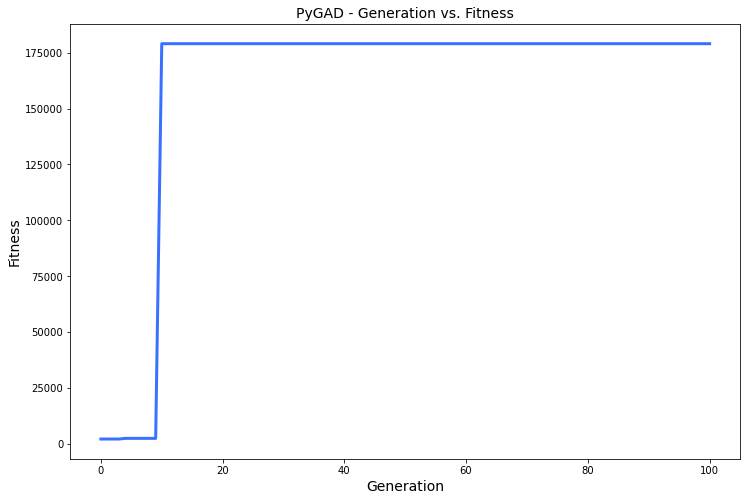

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 9.367 |==================| 291.816 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.568 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.524 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.906 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.809 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.01 |==================| 73.868 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 128.896 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 23.98 |==================| 23.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.685 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.008 |==================| 65.296 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.017 |==================| 154.145 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.009 |==================| 70.33 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 23.981 |==================| 23.184 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.979 |==================| 22.379 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 23.98 |==================| 22.919 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 23.995 |==================| 35.049 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 23.996 |==================| 35.88 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.021 |==================| 385.684 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.986 |==================| 26.219 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.023 |==================| 1260.428 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 151.249 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.974 |==================| 20.289 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.988 |==================| 28.348 |==========| N5 |==========
**********************************************************************

======| 0.082 |===========| 24.019 |==================| 240.499 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.01 |==================| 73.616 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.015 |==================| 118.398 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 23.994 |==================| 33.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.978 |==================| 21.754 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.014 |==================| 102.18 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 23.999 |==================| 40.809 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.858 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 23.995 |==================| 34.736 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 23.985 |==================| 25.697 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.019 |==================| 238.096 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 23.996 |==================| 35.766 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.975 |==================| 20.716 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.017 |==================| 147.465 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.024 |==================| 8039.958 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.988 |==================| 28.348 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.6 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.021 |==================| 418.423 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.985 |==================| 26.09 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.008 |==================| 62.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.013 |==================| 97.703 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.024 |==================| 8039.958 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.016 |==================| 126.671 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.223 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.576 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.988 |==================| 27.694 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 23.997 |==================| 37.812 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.815 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.772 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.986 |==================| 26.841 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.009 |==================| 66.484 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.004 |==================| 51.613 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.983 |==================| 24.575 |==========| N5 |==========
**********************************************************************
Change = 2080.6039143348326
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 23.982 |==================| 24.169 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.989 |==================| 28.527 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.974 |==================| 19.946 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 23.997 |==================| 37.46 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.229 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.009 |==================| 70.452 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.981 |==================| 23.284 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.018 |==================| 180.609 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 23.981 |==================| 23.344 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 23.991 |==================| 31.031 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 23.99 |==================| 29.88 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.011 |==================| 78.066 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.002 |==================| 47.121 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.986 |==================| 26.424 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.978 |==================| 21.947 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 23.988 |==================| 28.393 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.015 |==================| 121.956 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.012 |==================| 82.83 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 23.999 |==================| 40.746 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 499.43 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.977 |==================| 21.538 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.001 |==================| 44.062 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.005 |==================| 53.005 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.985 |==================| 25.849 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.979 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.006 |==================| 57.561 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.989 |==================| 29.179 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.993 |==================| 32.138 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.005 |==================| 53.247 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.579 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.013 |==================| 97.096 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.98 |==================| 22.943 |==========| N5 |==========
**********************************************************************
Fitness = 10120.561564417249
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.02 |==================| 252.039 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.985 |==================| 25.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.006 |==================| 55.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.977 |==================| 21.53 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.035 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.989 |==================| 29.026 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.021 |==================| 359.797 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.023 |==================| 4730.314 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.003 |==================| 49.339 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.992 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.277 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 23.995 |==================| 35.452 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.982 |==================| 23.844 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.976 |==================| 20.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 23.994 |==================| 33.457 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.018 |==================| 173.884 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.822 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 23.979 |==================| 22.168 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 278.686 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.986 |==================| 26.298 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.908 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.993 |==================| 32.568 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.977 |==================| 21.544 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 23.981 |==================| 23.436 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.015 |==================| 115.008 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.436 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.513 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.983 |==================| 24.66 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.986 |==================| 26.596 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.018 |==================| 168.695 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.447 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.063 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.001 |==================| 43.568 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.002 |==================| 46.754 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.392 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 23.987 |==================| 27.372 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.01 |==================| 75.222 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.017 |==================| 160.849 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.005 |==================| 52.961 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.974 |==================| 20.012 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.977 |==================| 21.606 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.023 |==================| 3063.768 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.979 |==================| 22.471 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.99 |==================| 29.996 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.004 |==================| 51.869 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.989 |==================| 29.192 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.991 |==================| 30.211 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.007 |==================| 59.951 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.975 |==================| 20.656 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.016 |==================| 134.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.787 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 23.998 |==================| 39.098 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.013 |==================| 90.55 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.18 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.019 |==================| 197.077 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.976 |==================| 20.996 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 23.984 |==================| 25.428 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.022 |==================| 534.712 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 23.977 |==================| 21.564 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.007 |==================| 59.673 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.973 |==================| 19.761 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.973 |==================| 19.623 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 23.977 |==================| 21.562 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.271 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.98 |==================| 23.086 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.001 |==================| 43.337 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.002 |==================| 45.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.457 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.717 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.989 |==================| 28.915 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 23.993 |==================| 33.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.456 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.981 |==================| 23.642 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.968 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.431 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.991 |==================| 30.777 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.548 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.786 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.336 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.008 |==================| 64.354 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.016 |==================| 128.114 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.973 |==================| 19.894 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.969 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.007 |==================| 61.766 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 23.997 |==================| 38.116 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.976 |==================| 20.948 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.016 |==================| 130.465 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.01 |==================| 75.327 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.405 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.019 |==================| 230.493 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.751 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.242 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.008 |==================| 62.55 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.003 |==================| 49.558 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.847 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.978 |==================| 22.117 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.013 |==================| 96.073 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.017 |==================| 161.423 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.976 |==================| 21.041 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.483 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.489 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.024 |==================| 16676.611 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.008 |==================| 64.584 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.012 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.017 |==================| 155.18 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.008 |==================| 64.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.233 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.016 |==================| 132.112 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.984 |==================| 25.243 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.015 |==================| 116.658 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.992 |==================| 31.647 |==========| N5 |==========
**********************************************************************
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.002 |==================| 46.82 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.453 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 23.997 |==================| 38.035 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.978 |==================| 22.121 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.353 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.012 |==================| 85.61 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.011 |==================| 80.466 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.02 |==================| 306.547 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.307 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.044 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.017 |==================| 158.269 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.495 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.012 |==================| 89.452 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.068 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.008 |==================| 64.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.978 |==================| 22.135 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.005 |==================| 52.663 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.702 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.991 |==================| 31.071 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.99 |==================| 30.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.15 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.98 |==================| 22.708 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 23.992 |==================| 31.322 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.015 |==================| 112.949 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.973 |==================| 19.721 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.001 |==================| 43.214 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.987 |==================| 27.234 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.009 |==================| 66.561 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.973 |==================| 19.721 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.016 |==================| 130.925 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 23.991 |==================| 30.263 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.986 |==================| 26.836 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.98 |==================| 22.937 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 23.995 |==================| 34.737 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.976 |==================| 21.149 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.793 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.976 |==================| 20.95 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.009 |==================| 68.247 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.019 |==================| 234.556 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 23.993 |==================| 32.904 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.979 |==================| 22.418 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.009 |==================| 68.246 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 23.982 |==================| 23.79 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.977 |==================| 21.44 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.011 |==================| 81.51 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.139 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 23.998 |==================| 38.553 |==========| N5 |==========
**********************************************************************
Fitness = 16676.61070667581
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 23.983 |==================| 24.433 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.006 |==================| 55.763 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.01 |==================| 74.832 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.974 |==================| 20.037 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.004 |==================| 50.421 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.989 |==================| 29.243 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.898 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.977 |==================| 21.392 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.975 |==================| 20.405 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.003 |==================| 47.579 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.99 |==================| 29.971 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.016 |==================| 139.069 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.469 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 23.987 |==================| 27.365 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 24.022 |==================| 542.261 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.982 |==================| 24.245 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.01 |==================| 74.418 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.023 |==================| 1474.346 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 23.992 |==================| 31.676 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.009 |==================| 69.597 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.001 |==================| 43.539 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.976 |==================| 21.031 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.003 |==================| 47.951 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.013 |==================| 96.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 505.961 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.007 |==================| 58.908 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.992 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.989 |==================| 28.767 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.021 |==================| 335.394 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.0 |==================| 42.127 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.011 |==================| 81.31 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.734 |==========| N5 |==========
**********************************************************************
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.993 |==================| 32.184 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 23.975 |==================| 20.641 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.67 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.003 |==================| 48.565 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.651 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.355 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.017 |==================| 146.718 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.982 |==================| 24.022 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.018 |==================| 185.756 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.99 |==================| 29.372 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.454 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 148.94 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.501 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.978 |==================| 22.009 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.712 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.443 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.006 |==================| 57.457 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.416 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 23.994 |==================| 33.416 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.115 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.007 |==================| 61.058 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.019 |==================| 196.985 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.007 |==================| 59.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.348 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.977 |==================| 21.254 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.973 |==================| 19.724 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.98 |==================| 23.038 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 23.986 |==================| 26.631 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.003 |==================| 48.301 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.001 |==================| 43.475 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.979 |==================| 22.172 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 23.986 |==================| 26.369 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.227 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.01 |==================| 71.615 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.983 |==================| 24.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.904 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.906 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.981 |==================| 23.249 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.982 |==================| 23.864 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.022 |==================| 847.12 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.006 |==================| 55.256 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 23.995 |==================| 34.82 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.001 |==================| 44.261 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.077 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 23.985 |==================| 26.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 23.982 |==================| 24.181 |==========| N5 |==========
**********************************************************************
Fitness = 16676.61070667581
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 23.991 |==================| 31.051 |==========| N5 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.985 |==================| 25.741 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.121 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.008 |==================| 65.557 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.007 |==================| 61.729 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.989 |==================| 28.459 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.973 |==================| 19.935 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.973 |==================| 19.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.71 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.368 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.253 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 61.999 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.805 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.018 |==================| 164.38 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.985 |==================| 25.982 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.989 |==================| 29.035 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.015 |==================| 122.254 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.993 |==================| 32.107 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.002 |==================| 46.999 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.008 |==================| 63.768 |==========| N5 |==========
**********************************************************************

======| 0.108 |===========| 24.018 |==================| 181.54 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.992 |==================| 31.916 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.992 |==================| 31.232 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.018 |==================| 187.469 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 23.995 |==================| 35.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.155 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.202 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.005 |==================| 53.493 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.007 |==================| 60.737 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.983 |==================| 24.846 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.988 |==================| 27.8 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.018 |==================| 189.733 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.992 |==================| 31.536 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 23.994 |==================| 34.192 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 23.999 |==================| 39.821 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.985 |==================| 26.155 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.017 |==================| 158.154 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.469 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.02 |==================| 293.11 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.577 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 171.277 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.023 |==================| 2890.591 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.985 |==================| 25.994 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.827 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 23.997 |==================| 37.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.007 |==================| 61.892 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.606 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.019 |==================| 198.981 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.973 |==================| 19.828 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.987 |==================| 27.283 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 23.986 |==================| 26.643 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 23.996 |==================| 36.559 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.002 |==================| 46.451 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.013 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.001 |==================| 44.633 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.022 |==================| 581.388 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 23.994 |==================| 34.27 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.006 |==================| 58.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.013 |==================| 92.048 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.932 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 23.985 |==================| 25.821 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.987 |==================| 27.552 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.002 |==================| 45.393 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.015 |==================| 111.702 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.975 |==================| 20.745 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.558 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.018 |==================| 188.092 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.985 |==================| 25.65 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.02 |==================| 291.5 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.988 |==================| 27.684 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.023 |==================| 2967.069 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.977 |==================| 21.619 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.976 |==================| 20.865 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.974 |==================| 20.191 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.405 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.973 |==================| 19.764 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.984 |==================| 25.186 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.993 |==================| 32.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.005 |==================| 53.645 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 23.978 |==================| 21.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 23.996 |==================| 36.334 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.988 |==================| 28.317 |==========| N5 |==========
**********************************************************************
=

======| 0.404 |===========| 24.003 |==================| 48.48 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.839 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.973 |==================| 19.626 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.008 |==================| 64.672 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.382 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.979 |==================| 22.511 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.003 |==================| 49.39 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.003 |==================| 48.48 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 298.499 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.016 |==================| 128.012 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.005 |==================| 52.695 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.989 |==================| 29.09 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 23.991 |==================| 30.961 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.876 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.419 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.007 |==================| 59.399 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 23.996 |==================| 35.768 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.833 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.925 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.305 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 23.985 |==================| 25.814 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.006 |==================| 56.539 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 23.999 |==================| 40.438 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 23.975 |==================| 20.68 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.893 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 23.972 |==================| 19.493 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.569 |==========| N5 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.878 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 23.996 |==================| 36.057 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 23.998 |==================| 38.931 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 23.989 |==================| 28.713 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.017 |==================| 153.429 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.982 |==================| 23.874 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.975 |==================| 20.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.007 |==================| 61.01 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.913 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.974 |==================| 20.118 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.013 |==================| 95.674 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.984 |==================| 24.921 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 23.994 |==================| 34.219 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.115 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.011 |==================| 81.488 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.981 |==================| 23.685 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.97 |==========| N5 |==========
**********************************************************************
Ch

======| 0.8 |===========| 23.983 |==================| 24.39 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 23.996 |==================| 36.658 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.013 |==================| 94.431 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.011 |==================| 78.194 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 23.991 |==================| 30.983 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.0 |==================| 43.187 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 23.995 |==================| 34.313 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.014 |==================| 104.254 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.987 |==================| 27.566 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.973 |==================| 19.627 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.02 |==================| 316.711 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.005 |==================| 52.39 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.225 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.012 |==================| 85.017 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.023 |==================| 3612.468 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.98 |==================| 22.695 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.988 |==================| 28.42 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 23.987 |==================| 27.21 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.599 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.303 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.985 |==================| 25.756 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 23.998 |==================| 39.258 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.0 |==================| 42.786 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 814.767 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.976 |==================| 20.941 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.982 |==================| 24.226 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 23.983 |==================| 24.406 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.001 |==================| 45.01 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.981 |==================| 23.219 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.995 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.227 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.016 |==================| 126.461 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.981 |==================| 23.405 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.977 |==================| 21.436 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.831 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.976 |==================| 20.957 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.021 |==================| 370.812 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.606 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.013 |==================| 98.526 |==========| N5 |==========
**********************************************************************
Fitness = 30529.064567759255
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.004 |==================| 52.082 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.984 |==================| 25.3 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 23.995 |==================| 34.862 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 811.705 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.976 |==================| 20.805 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.016 |==================| 128.259 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.01 |==================| 73.005 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.018 |==================| 193.674 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 23.996 |==================| 35.816 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.013 |==================| 90.02 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.975 |==================| 20.538 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.973 |==================| 19.637 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.977 |==================| 21.481 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.019 |==================| 234.496 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.975 |==================| 20.729 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.007 |==================| 59.061 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.914 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.002 |==================| 46.7 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.161 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.004 |==================| 51.376 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.013 |==================| 95.585 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 23.988 |==================| 27.737 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.456 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 23.99 |==================| 29.486 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.805 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.013 |==================| 90.652 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.023 |==================| 1028.608 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 23.998 |==================| 38.619 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.044 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 23.997 |==================| 38.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.019 |==================| 195.714 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 23.998 |==================| 38.939 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 23.994 |==================| 33.908 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.989 |==================| 29.035 |==========| N5 |==========
**********************************************************************
Generation = 47
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.012 |==================| 85.337 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.678 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.019 |==================| 207.88 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 23.999 |==================| 40.826 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.013 |==================| 90.04 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 145.002 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.012 |==================| 85.98 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.022 |==================| 661.228 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.008 |==================| 64.22 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 23.999 |==================| 40.327 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 23.993 |==================| 32.432 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 23.998 |==================| 38.517 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 23.985 |==================| 25.711 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.014 |==================| 100.133 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.485 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.974 |==================| 20.228 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.981 |==================| 23.489 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.974 |==================| 20.285 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.002 |==================| 46.411 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.002 |==================| 45.352 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.124 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.011 |==================| 79.118 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.012 |==================| 83.201 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.979 |==================| 22.368 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.021 |==================| 372.763 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.476 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.824 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.982 |==================| 23.98 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 23.994 |==================| 34.048 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.987 |==================| 27.379 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.48 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 23.993 |==================| 33.126 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.023 |==================| 1685.596 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.023 |==================| 1546.875 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.973 |==================| 19.654 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.656 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.975 |==================| 20.529 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 23.998 |==================| 39.316 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.985 |==================| 25.807 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.018 |==================| 176.063 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.974 |==================| 20.336 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.024 |==================| 32413.682 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 510.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.974 |==================| 20.154 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.015 |==================| 119.576 |==========| N5 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 23.989 |==================| 28.719 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.006 |==================| 55.461 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.99 |==================| 29.527 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.009 |==================| 68.953 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.011 |==================| 76.206 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.01 |==================| 73.921 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.004 |==================| 51.218 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.002 |==================| 45.943 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.973 |==================| 19.901 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.009 |==================| 68.845 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.01 |==================| 73.38 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.003 |==================| 48.984 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.013 |==================| 95.817 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 510.412 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.973 |==================| 19.746 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.978 |==================| 22.131 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.983 |==================| 24.642 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 23.999 |==================| 40.14 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 23.981 |==================| 23.543 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.005 |==================| 54.262 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.197 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.016 |==================| 131.6 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.997 |==================| 36.858 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.019 |==================| 207.224 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.988 |==================| 28.348 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.008 |==================| 62.827 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.833 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.992 |==================| 31.836 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.014 |==================| 100.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.021 |==================| 362.944 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.033 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.976 |==================| 21.127 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.977 |==================| 21.615 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.162 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 23.994 |==================| 34.021 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.13 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.023 |==================| 1012.77 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.014 |==================| 104.426 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.021 |==================| 323.662 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.01 |==================| 72.922 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.585 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.003 |==================| 47.584 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.456 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.735 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 23.994 |==================| 33.652 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.017 |==================| 139.931 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.973 |==================| 19.676 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.991 |==================| 31.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.016 |==================| 134.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.566 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.976 |==================| 21.158 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.017 |==================| 149.593 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.954 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.003 |==================| 48.491 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 23.997 |==================| 37.47 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.012 |==================| 85.945 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.579 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.018 |==================| 172.8 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.007 |==================| 58.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.987 |==================| 27.424 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.977 |==========| N5 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.986 |==================| 26.82 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.49 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.022 |==================| 555.295 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.02 |==================| 245.601 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.988 |==================| 27.957 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.016 |==================| 126.374 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.806 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 23.982 |==================| 24.008 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.979 |==================| 22.576 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.021 |==================| 324.054 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.011 |==================| 79.109 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.795 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.022 |==================| 469.984 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.981 |==================| 23.361 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.019 |==================| 220.253 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.002 |==================| 45.713 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.808 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.974 |==================| 20.24 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.987 |==================| 27.247 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.975 |==================| 20.655 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.055 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.02 |==================| 253.31 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 23.995 |==================| 34.909 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.343 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.001 |==================| 44.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.342 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.005 |==================| 53.605 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 23.995 |==================| 34.391 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 23.994 |==================| 33.75 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.017 |==================| 162.061 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 125.605 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.98 |==================| 22.999 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.004 |==================| 49.934 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 23.983 |==================| 24.373 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.021 |==================| 339.598 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.019 |==================| 204.825 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.979 |==================| 22.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.989 |==================| 29.15 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.01 |==================| 74.951 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.001 |==================| 43.596 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.979 |==================| 22.483 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.44 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.915 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.287 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.0 |==================| 42.014 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 23.995 |==================| 34.991 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.008 |==================| 63.45 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.214 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.072 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.982 |==================| 23.855 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.012 |==================| 85.01 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.34 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.0 |==================| 43.006 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.002 |==================| 45.819 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.002 |==================| 45.236 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.02 |==================| 274.406 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.616 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 23.996 |==================| 36.273 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.0 |==================| 43.199 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 23.997 |==================| 36.902 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 23.994 |==================| 33.601 |==========| N5 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.975 |==================| 20.736 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 23.993 |==================| 32.909 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.0 |==================| 42.676 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.991 |==================| 30.898 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.399 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.015 |==================| 112.766 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.017 |==================| 161.268 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.976 |==================| 21.031 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 23.998 |==================| 38.862 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 23.997 |==================| 37.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.976 |==================| 20.993 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.014 |==================| 106.162 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.365 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.012 |==================| 82.694 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.013 |==================| 95.526 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.975 |==================| 20.77 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.988 |==================| 27.809 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.003 |==================| 48.782 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.979 |==================| 22.511 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.987 |==================| 27.411 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.982 |==================| 24.281 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.98 |==================| 23.156 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 296.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.976 |==================| 20.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.018 |==================| 172.832 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.023 |==================| 1449.206 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.007 |==================| 59.447 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.982 |==================| 24.04 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.02 |==================| 315.55 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.977 |==================| 21.481 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 270.049 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.451 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.005 |==================| 54.532 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.0 |==================| 42.071 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.99 |==================| 29.748 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.982 |==================| 23.82 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.979 |==================| 22.177 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.98 |==================| 23.101 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.995 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 23.994 |==================| 33.954 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.267 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.986 |==================| 26.515 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 803.992 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.988 |==================| 27.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.013 |==================| 98.456 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.011 |==================| 78.54 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.986 |==================| 26.309 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.001 |==================| 43.609 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.02 |==================| 265.716 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 23.994 |==================| 33.303 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.586 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 23.984 |==================| 25.407 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.532 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.018 |==================| 192.525 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.015 |==================| 117.471 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.02 |==================| 250.352 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.986 |==================| 26.235 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.014 |==================| 104.63 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.019 |==================| 201.535 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.993 |==================| 32.603 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.981 |==================| 23.493 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.59 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.991 |==================| 30.936 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.148 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 23.997 |==================| 37.17 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.015 |==================| 113.163 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.987 |==================| 26.957 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.022 |==================| 860.458 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.007 |==================| 60.743 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.0 |==================| 41.457 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.98 |==================| 22.896 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.326 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.978 |==================| 21.742 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.001 |==================| 43.486 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.008 |==================| 64.722 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.685 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.712 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.418 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.01 |==================| 70.931 |==========| N5 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.988 |==================| 27.951 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.981 |==================| 23.641 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 23.981 |==================| 23.541 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.99 |==================| 29.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.978 |==================| 21.939 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 23.994 |==================| 34.024 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.001 |==================| 43.752 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.0 |==================| 41.706 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.011 |==================| 80.993 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.993 |==================| 32.7 |==========| N5 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.004 |==================| 50.851 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 23.995 |==================| 35.504 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.973 |==================| 19.94 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.188 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.974 |==================| 20.173 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.78 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.019 |==================| 213.714 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.022 |==================| 856.323 |==========| N5 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 23.998 |==================| 38.454 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 23.999 |==================| 40.365 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.007 |==================| 58.52 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.49 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.004 |==================| 51.781 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.974 |==================| 20.021 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.007 |==================| 58.914 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.002 |==================| 45.977 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.014 |==================| 98.698 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.512 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.011 |==================| 77.916 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.02 |==================| 302.075 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 23.993 |==================| 33.068 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 278.382 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.996 |==================| 36.834 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.023 |==================| 2639.425 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.011 |==================| 79.098 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.022 |==================| 524.251 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.973 |==================| 19.663 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.584 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 23.996 |==================| 36.739 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.916 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.006 |==================| 56.487 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.011 |==================| 80.821 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.376 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.013 |==================| 90.356 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.977 |==================| 21.587 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 278.586 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.009 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.985 |==================| 26.149 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.883 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.48 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.012 |==================| 82.561 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.074 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.977 |==================| 21.454 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.012 |==================| 84.47 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.986 |==================| 26.254 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 23.984 |==================| 24.945 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.002 |==================| 46.826 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.989 |==================| 28.85 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.432 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.003 |==================| 48.423 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.004 |==================| 51.613 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.225 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.017 |==================| 153.381 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.26 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.282 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.013 |==================| 91.758 |==========| N5 |==========
**********************************************************************

======| 0.931 |===========| 23.976 |==================| 20.94 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.978 |==================| 21.768 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.007 |==================| 61.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 150.706 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.992 |==================| 31.263 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.018 |==================| 177.608 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.014 |==================| 101.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 23.992 |==================| 32.054 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.209 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 23.98 |==================| 22.789 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 23.998 |==================| 38.491 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.013 |==================| 92.901 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.018 |==================| 164.73 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.02 |==================| 291.808 |==========| N5 |==========
**********************************************************************
Generation = 76
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.012 |==================| 82.925 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.007 |==================| 58.537 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.881 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.012 |==================| 84.771 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.002 |==================| 45.68 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 23.999 |==================| 40.793 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.285 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 23.996 |==================| 36.269 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 23.982 |==================| 24.196 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.013 |==================| 94.174 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.017 |==================| 140.024 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.01 |==================| 72.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.844 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 23.998 |==================| 39.188 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.003 |==================| 47.779 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.019 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.696 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.255 |==========| N5 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 23.996 |==================| 35.869 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.015 |==================| 109.692 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.005 |==================| 54.751 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.988 |==================| 27.788 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.991 |==================| 30.334 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.977 |==================| 21.436 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.807 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 23.988 |==================| 28.19 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.992 |==================| 31.546 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.268 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 23.994 |==================| 33.844 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.979 |==================| 22.496 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 23.992 |==================| 31.311 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 23.978 |==================| 21.804 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.017 |==================| 155.655 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.472 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.003 |==================| 49.58 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.008 |==================| 63.317 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.079 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.978 |==================| 21.898 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.0 |==================| 42.603 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.006 |==================| 58.209 |==========| N5 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.975 |==================| 20.4 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.641 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.716 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.018 |==================| 168.507 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.391 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.019 |==================| 222.219 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 23.996 |==================| 36.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 23.995 |==================| 34.624 |==========| N5 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.005 |==================| 52.98 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.983 |==================| 24.848 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.013 |==================| 93.056 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 276.668 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 23.996 |==================| 36.64 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.993 |==================| 32.218 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.976 |==================| 20.823 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.997 |==================| 36.866 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 23.993 |==================| 32.243 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.021 |==================| 350.341 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.983 |==================| 24.863 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.153 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.351 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.02 |==================| 252.486 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 23.987 |==================| 27.332 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 23.999 |==================| 40.677 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 23.998 |==================| 39.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.019 |==================| 207.181 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.016 |==================| 124.735 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.882 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 23.979 |==================| 22.154 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.019 |==================| 195.527 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 23.994 |==================| 33.936 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.009 |==================| 67.916 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 23.982 |==================| 24.214 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.012 |==================| 86.992 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 23.988 |==================| 27.917 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 23.982 |==================| 24.134 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.305 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.004 |==================| 50.881 |==========| N5 |==========
**********************************************************************
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 669.258 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 23.999 |==================| 40.841 |==========| N5 |==========
*******************************************************

======| 0.739 |===========| 23.986 |==================| 26.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.974 |==================| 20.02 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.975 |==================| 20.517 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.981 |==================| 23.351 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.006 |==================| 57.616 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.977 |==================| 21.599 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.021 |==================| 406.903 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.98 |==================| 22.895 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 23.994 |==================| 34.154 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.002 |==================| 45.285 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 23.995 |==================| 35.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.018 |==================| 182.096 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.466 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.987 |==================| 27.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.981 |==================| 23.632 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.011 |==================| 80.202 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 132.796 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.007 |==================| 59.106 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.979 |==================| 22.3 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.982 |==================| 24.29 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 23.993 |==================| 32.498 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.977 |==================| 21.419 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.585 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 23.999 |==================| 40.516 |==========| N5 |==========
**********************************************************************
=

======| 0.795 |===========| 23.983 |==================| 24.549 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 28.007 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.015 |==================| 122.375 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.991 |==================| 30.93 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.111 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.318 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.018 |==================| 193.054 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.003 |==================| 49.152 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.204 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 23.985 |==================| 25.7 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.978 |==================| 21.963 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 23.986 |==================| 26.859 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 151.664 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.979 |==================| 22.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.023 |==================| 2966.861 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.009 |==================| 66.656 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.018 |==================| 191.979 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.006 |==================| 58.096 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.003 |==================| 47.888 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.974 |==================| 20.178 |==========| N5 |==========
**********************************************************************

======| 0.984 |===========| 23.973 |==================| 19.802 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.021 |==================| 376.373 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.981 |==================| 23.23 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.021 |==================| 443.046 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.99 |==================| 29.638 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.911 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.002 |==================| 45.316 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.912 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.981 |==================| 23.284 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.976 |==================| 20.792 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 23.982 |==================| 24.186 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.005 |==================| 52.443 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.023 |==================| 909.175 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.051 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.634 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.011 |==================| 76.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 23.998 |==================| 38.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.011 |==================| 80.231 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.0 |==================| 42.216 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.02 |==================| 256.848 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.002 |==================| 46.509 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.006 |==================| 58.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.955 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.974 |==================| 20.341 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.217 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.001 |==================| 44.91 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.013 |==================| 97.133 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.022 |==================| 764.853 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 51.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.365 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.004 |==================| 51.413 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.985 |==================| 26.095 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.977 |==================| 21.376 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.002 |==================| 45.555 |==========| N5 |==========
**********************************************************************
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 23.985 |==================| 25.948 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.012 |==================| 86.744 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.551 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.024 |==================| 25131.693 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.019 |==================| 237.081 |==========| N5 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.015 |==================| 112.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 23.984 |==================| 25.514 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.015 |==================| 116.69 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.984 |==================| 25.263 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.007 |==================| 60.068 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.022 |==================| 473.789 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 23.993 |==================| 33.143 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 23.985 |==================| 25.735 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.004 |==================| 51.544 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.606 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.013 |==================| 94.274 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.108 |==========| N5 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.012 |==================| 87.903 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.986 |==================| 26.62 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.99 |==================| 29.627 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 23.993 |==================| 33.009 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.578 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 23.976 |==================| 21.085 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.578 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.021 |==================| 328.232 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.979 |==================| 22.333 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.006 |==================| 56.431 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.023 |==================| 1113.207 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.979 |==================| 22.335 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.606 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.01 |==================| 70.785 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.007 |==================| 61.688 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 23.972 |==================| 19.468 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.847 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.378 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 23.975 |==================| 20.443 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.986 |==================| 26.302 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.015 |==================| 117.349 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 23.999 |==================| 41.081 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.976 |==================| 21.173 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 23.999 |==================| 41.134 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 23.983 |==================| 24.451 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.004 |==================| 50.918 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 822.353 |==========| N5 |==========
**********************************************************************
Fitness = 32413.682229551767
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.98 |==================| 23.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.977 |==================| 21.641 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 23.992 |==================| 31.325 |==========| N5 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.119 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.977 |==================| 21.213 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.006 |==================| 57.95 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.032 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.015 |==================| 117.128 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.564 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.53 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.985 |==================| 25.792 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.018 |==================| 169.165 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 23.974 |==================| 20.304 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.974 |==================| 20.279 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.011 |==================| 77.808 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 23.996 |==================| 36.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.986 |==================| 26.26 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.003 |==================| 48.424 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 23.984 |==================| 24.968 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.993 |==================| 32.344 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.539 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.992 |==================| 31.547 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 23.993 |==================| 32.975 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.007 |==================| 60.349 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.019 |==================| 204.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.005 |==================| 53.075 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.975 |==================| 20.761 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 129.317 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 23.989 |==================| 28.604 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 299.433 |==========| N5 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.469 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.023 |==================| 934.797 |==========| N5 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.0 |==================| 42.34 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.974 |==================| 19.947 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.016 |==================| 125.195 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.22 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.018 |==================| 177.477 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.992 |==================| 31.299 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.021 |==================| 370.963 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.783 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 400.865 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.811 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 23.985 |==================| 26.163 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.01 |==================| 73.697 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.021 |==================| 328.323 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.021 |==================| 331.532 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.987 |==================| 27.655 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.977 |==================| 21.325 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.059 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.006 |==================| 56.982 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.984 |==================| 25.11 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.022 |==================| 704.68 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.984 |==================| 25.189 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 23.995 |==================| 34.704 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.021 |==================| 427.664 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.001 |==================| 43.469 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 23.991 |==================| 30.996 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.772 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 23.997 |==================| 37.177 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.551 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 300.12 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.992 |==================| 31.298 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.002 |==================| 45.461 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.99 |==================| 30.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 23.983 |==================| 24.363 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.003 |==================| 47.33 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.014 |==================| 105.601 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.002 |==================| 47.028 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 23.996 |==================| 36.383 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.012 |==================| 86.018 |==========| N5 |==========
**********************************************************************


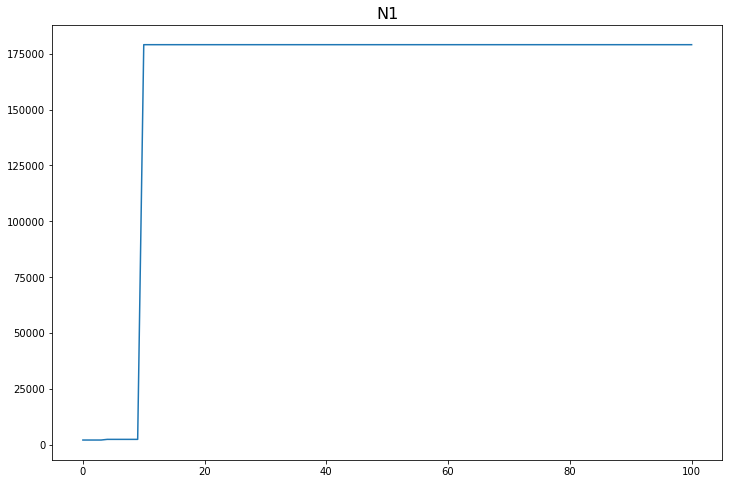

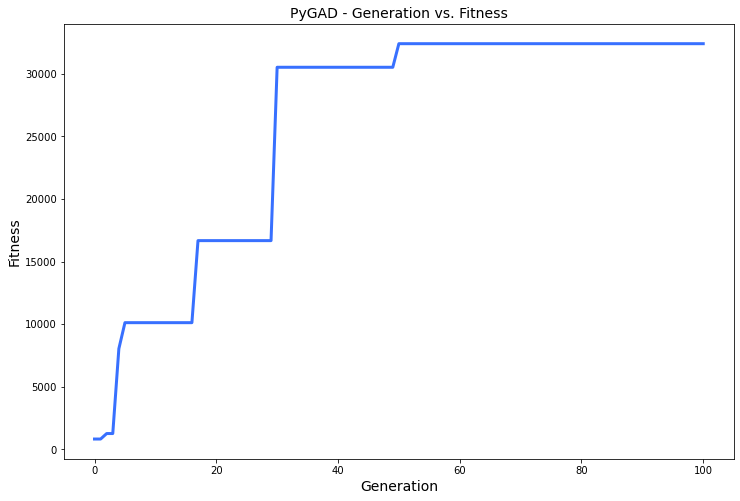

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.002 |==================| 45.461 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.015 |==================| 121.312 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.009 |==================| 67.475 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.02 |==================| 281.858 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.88 |==================| 11.096 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.95 |==================| 49.922 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.9 |==================| 14.361 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.857 |==================| 8.827 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.907 |==================| 15.857 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.452 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.927 |==================| 23.157 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.908 |==================| 16.011 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.458 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.003 |===========| 28.854 |==================| 8.598 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.954 |==================| 62.615 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.861 |==================| 9.138 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.926 |==================| 22.76 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.955 |==================| 65.852 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.037 |===========| 28.849 |==================| 8.29 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.927 |==================| 23.214 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.176 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.941 |==================| 33.936 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.879 |==================| 10.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.854 |==================| 8.628 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.896 |==================| 13.427 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.964 |==================| 152.515 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.933 |==================| 26.959 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.948 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.3 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.886 |==================| 11.86 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 405.381 |==========| N10 |==========
**********************************************************************
Fitness = 405.38117484695675
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.91 |==================| 16.632 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.902 |==================| 14.597 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.821 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.871 |==================| 10.138 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.921 |==================| 20.483 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.922 |==================| 20.991 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.907 |==================| 15.778 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.915 |==================| 17.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.742 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.942 |==================| 35.111 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.904 |==================| 15.158 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.914 |==================| 17.699 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.87 |==================| 9.941 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.893 |==================| 12.948 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.951 |==================| 51.285 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.867 |==================| 9.667 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.938 |==================| 31.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.898 |==================| 13.777 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.935 |==================| 28.227 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.962 |==================| 123.173 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.888 |==================| 12.197 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.792 |==========| N10 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.897 |==================| 13.71 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.913 |==================| 17.502 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 28.899 |==================| 13.994 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 28.969 |==================| 899.175 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.948 |==================| 45.457 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.373 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.044 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.949 |==================| 47.608 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.605 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.716 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.951 |==================| 51.049 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.543 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.905 |==================| 15.409 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 28.923 |==================| 21.384 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.863 |==================| 9.37 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.945 |==================| 39.838 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.921 |==================| 20.555 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.921 |==================| 20.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.662 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 28.896 |==================| 13.489 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.934 |==================| 27.948 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.916 |==================| 18.492 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.918 |==================| 19.069 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.912 |==================| 17.085 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.925 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.893 |==================| 12.913 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.861 |==================| 9.193 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.142 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.96 |==================| 98.93 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.96 |==================| 96.966 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.902 |==================| 14.783 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.875 |==================| 10.502 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.903 |==================| 14.963 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.888 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.386 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.904 |==================| 15.12 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.387 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.883 |==================| 11.416 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.891 |==================| 12.691 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.964 |==================| 172.494 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.942 |==================| 35.371 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.96 |==================| 100.371 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.923 |==================| 21.085 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.385 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.207 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.887 |==================| 12.084 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.986 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 28.854 |==================| 8.611 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.878 |==================| 10.799 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.866 |==================| 9.561 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.88 |==================| 11.096 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.18 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.952 |==================| 55.57 |==========| N10 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.954 |==================| 62.062 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.926 |==================| 22.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.965 |==================| 204.123 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.399 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.881 |==================| 11.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 249.157 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.334 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.838 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.892 |==================| 12.738 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.856 |==================| 8.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.908 |==================| 16.068 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.934 |==================| 27.472 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.908 |==================| 15.985 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.939 |==================| 32.149 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.889 |==================| 12.305 |==========| N10 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.91 |==================| 16.504 |==========| N10 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.787 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 29.969 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.952 |==================| 55.091 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.97 |==================| 4315.349 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.895 |==================| 13.25 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.933 |==================| 26.657 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.916 |==================| 18.411 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.875 |==================| 10.548 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.927 |==================| 23.097 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.91 |==================| 16.528 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.536 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.887 |==================| 11.992 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.879 |==================| 10.966 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.858 |==================| 8.902 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.936 |==================| 29.244 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.95 |==================| 50.59 |==========| N10 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.885 |==================| 11.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.883 |==================| 11.523 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.966 |==================| 239.108 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.859 |==================| 8.981 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.968 |==================| 570.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.925 |==================| 22.094 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.914 |==================| 17.893 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.892 |==================| 12.87 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.822 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.83 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.872 |==================| 10.155 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.952 |==================| 55.715 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.811 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.891 |==================| 12.72 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.957 |==================| 76.875 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.449 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.934 |==================| 28.051 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.854 |==================| 8.625 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.906 |==================| 15.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.965 |==================| 181.202 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.937 |==================| 30.497 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.945 |==================| 39.413 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.768 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.967 |==================| 294.589 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.894 |==================| 13.167 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.86 |==================| 9.073 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.906 |==================| 15.574 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.96 |==================| 98.759 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.945 |==================| 39.25 |==========| N10 |==========
**********************************************************************
Fitness = 4315.3488606142455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.624 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.913 |==================| 17.64 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.891 |==================| 12.703 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.649 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.568 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.865 |==================| 9.551 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.959 |==================| 88.056 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.862 |==================| 9.235 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.858 |==================| 8.934 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.964 |==================| 157.222 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.928 |==================| 23.64 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.924 |==================| 21.774 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.876 |==================| 10.63 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.957 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.304 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 28.946 |==================| 42.237 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.927 |==================| 23.438 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.87 |==================| 9.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.936 |==================| 29.759 |==========| N10 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.528 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.316 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.557 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.723 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.943 |==================| 37.219 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.622 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.914 |==================| 17.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.921 |==================| 20.356 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.918 |==================| 19.098 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.945 |==================| 40.531 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 28.865 |==================| 9.521 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.965 |==================| 196.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.631 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.885 |==================| 11.738 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.89 |==================| 12.436 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.859 |==================| 9.011 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.997 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.952 |==================| 54.668 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.88 |==================| 11.138 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.404 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.888 |==================| 12.194 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.952 |==================| 54.275 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.901 |==================| 14.481 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.898 |==================| 13.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.94 |==================| 33.451 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.888 |==================| 12.22 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.766 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.881 |==================| 11.193 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.919 |==================| 19.684 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.9 |==================| 14.269 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.956 |==================| 68.589 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.894 |==================| 13.222 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.863 |==================| 9.371 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.894 |==================| 13.056 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.544 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.961 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.94 |==================| 33.053 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.899 |==================| 14.127 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.889 |==================| 12.283 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.854 |==================| 8.647 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.918 |==================| 19.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.888 |==================| 12.144 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.058 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.914 |==================| 17.926 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 28.903 |==================| 14.999 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.877 |==================| 10.735 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.861 |==================| 9.165 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.915 |==================| 18.243 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.783 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.418 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.917 |==================| 18.679 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.923 |==================| 21.073 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.936 |==================| 28.95 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.948 |==================| 45.346 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.916 |==================| 18.421 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.962 |==================| 122.275 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.878 |==================| 10.809 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.893 |==================| 13.043 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.325 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.857 |==================| 8.875 |==========| N10 |==========
**********************************************************************
Fitness = 4315.3488606142455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.871 |==================| 10.11 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.884 |==================| 11.548 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.928 |==================| 23.584 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.614 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.955 |==================| 64.826 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.92 |==================| 20.08 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.887 |==================| 12.064 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.956 |==================| 69.4 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.88 |==================| 11.085 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.93 |==================| 24.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.558 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.914 |==================| 17.977 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.585 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.896 |==================| 13.539 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.362 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.898 |==================| 13.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.965 |==================| 181.196 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.855 |==================| 8.676 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.864 |==================| 9.387 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 46.971 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.901 |==================| 14.479 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.284 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.927 |==================| 23.469 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.914 |==================| 17.822 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.96 |==================| 99.621 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.968 |==================| 547.686 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.897 |==================| 13.759 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.858 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.894 |==================| 13.224 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.945 |==================| 39.434 |==========| N10 |==========
**********************************************************************
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.887 |==================| 11.965 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.881 |==================| 11.257 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.329 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.637 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.669 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.95 |==================| 49.86 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 120.022 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.864 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 84.297 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.728 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.887 |==================| 12.087 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.925 |==================| 22.068 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.951 |==================| 53.756 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.943 |==================| 37.39 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.905 |==================| 15.467 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 18.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.919 |==================| 19.539 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.918 |==================| 19.335 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.856 |==================| 8.764 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.954 |==================| 62.608 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.394 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.904 |==================| 15.201 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.868 |==================| 9.751 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.896 |==================| 13.469 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.436 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.945 |==================| 39.385 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.881 |==================| 11.18 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.352 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.93 |==================| 24.669 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.884 |==================| 11.586 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.844 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.864 |==================| 9.459 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 416.793 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.896 |==================| 13.413 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.894 |==================| 13.148 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.88 |==================| 11.137 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.856 |==================| 8.735 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.914 |==================| 17.811 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.861 |==================| 9.186 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.826 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.902 |==================| 14.661 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.948 |==================| 45.323 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.947 |==================| 43.333 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.938 |==================| 30.738 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.859 |==================| 9.023 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.929 |==================| 24.474 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.947 |==================| 43.301 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.314 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.944 |==================| 38.21 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.907 |==================| 15.929 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.899 |==================| 14.075 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.9 |==================| 14.332 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 149.364 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.907 |==================| 15.883 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.843 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.258 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.899 |==================| 14.143 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 28.949 |==================| 48.161 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.87 |==================| 9.951 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.937 |==================| 29.978 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.862 |==================| 9.214 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.933 |==================| 26.898 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.381 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.091 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.723 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.969 |==================| 984.744 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.93 |==================| 24.866 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.913 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.882 |==================| 11.398 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.929 |==================| 24.354 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.942 |==================| 36.092 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 28.909 |==================| 16.256 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.872 |==================| 10.225 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.707 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.542 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.885 |==================| 11.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.872 |==================| 10.161 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.032 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.919 |==================| 19.457 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.91 |==================| 16.588 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.917 |==================| 18.66 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.111 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.958 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.946 |==================| 42.36 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.709 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.899 |==================| 14.003 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.969 |==================| 977.792 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.684 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.95 |==================| 49.114 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.887 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.95 |==================| 50.866 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.892 |==================| 12.8 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.918 |==================| 19.1 |==========| N10 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.958 |==================| 83.324 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.959 |==================| 88.73 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.866 |==================| 9.613 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.95 |==================| 49.042 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.154 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.929 |==================| 24.071 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.86 |==================| 9.086 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.936 |==================| 29.266 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.741 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.879 |==================| 10.992 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.969 |==================| 1442.278 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.948 |==================| 46.18 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.898 |==================| 13.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.771 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.897 |==================| 13.601 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.957 |==================| 78.948 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.914 |==================| 17.889 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.67 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.896 |==================| 13.546 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 28.899 |==================| 13.982 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.91 |==================| 16.772 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.961 |==================| 106.572 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.895 |==================| 13.399 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.921 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.443 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.954 |==================| 63.059 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.869 |==================| 9.92 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.879 |==================| 10.918 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.93 |==================| 25.135 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.96 |==================| 94.81 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.912 |==================| 17.128 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.858 |==================| 8.932 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.922 |==================| 20.681 |==========| N10 |==========
**********************************************************************
Fitness = 4315.3488606142455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.356 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.453 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.755 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.931 |==================| 25.421 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.927 |==================| 23.34 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.895 |==================| 13.242 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.823 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.911 |==================| 16.906 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.961 |==================| 109.229 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.962 |==================| 125.861 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.89 |==================| 12.513 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 210.734 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.88 |==================| 11.058 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.86 |==================| 9.11 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.922 |==================| 20.883 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.872 |==================| 10.232 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.511 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.87 |==================| 10.027 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.866 |==================| 9.608 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.946 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.949 |==================| 48.138 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.893 |==================| 12.898 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.922 |==================| 20.844 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.916 |==================| 18.435 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.967 |==================| 297.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.895 |==================| 13.403 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.964 |==================| 153.155 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.311 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.964 |==================| 160.941 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.928 |==================| 23.702 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 28.895 |==================| 13.265 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 28.955 |==================| 65.22 |==========| N10 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.882 |==================| 11.385 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.92 |==================| 19.975 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.897 |==================| 13.631 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.883 |==================| 11.459 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.986 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.952 |==================| 56.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.928 |==================| 23.572 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.855 |==================| 8.68 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.922 |==================| 20.976 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.903 |==================| 14.823 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.904 |==================| 15.172 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.857 |==================| 8.843 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.616 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.904 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.925 |==================| 22.161 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.874 |==================| 10.388 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.931 |==================| 25.902 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.467 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.868 |==================| 9.824 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.881 |==================| 11.178 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.863 |==================| 9.297 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.909 |==================| 16.319 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 28.958 |==================| 85.813 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 694.806 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.872 |==================| 10.242 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.716 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.935 |==================| 28.58 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.964 |==================| 174.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.206 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.929 |==================| 24.356 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.887 |==================| 12.099 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.916 |==================| 18.582 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.898 |==================| 13.902 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.739 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.86 |==================| 9.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.651 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.922 |==================| 20.658 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.965 |==================| 200.483 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.966 |==================| 269.44 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.889 |==================| 12.267 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.815 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.891 |==================| 12.689 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.891 |==================| 12.68 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.535 |==========| N10 |==========
**********************************************************************
Fitness = 4315.3488606142455
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.884 |==================| 11.633 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.957 |==================| 76.046 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.95 |==================| 49.102 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.915 |==================| 18.068 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.1 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.9 |==================| 14.292 |==========| N10 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.893 |==================| 13.018 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.474 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 28.953 |==================| 58.377 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.334 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 28.962 |==================| 127.374 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.943 |==================| 37.229 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.323 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.947 |==================| 42.926 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.742 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.93 |==================| 24.763 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.887 |==================| 11.987 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.88 |==================| 11.132 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.542 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.884 |==================| 11.57 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.512 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.063 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.923 |==================| 21.142 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.635 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.878 |==================| 10.889 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.889 |==================| 12.318 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.962 |==================| 128.834 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.891 |==================| 12.663 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.904 |==================| 15.223 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.964 |==================| 169.208 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.88 |==================| 11.098 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.955 |==================| 66.849 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.857 |==================| 8.873 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.302 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.967 |==================| 280.408 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.959 |==================| 86.847 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.871 |==================| 10.124 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.905 |==================| 15.269 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 28.874 |==================| 10.417 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.669 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 13.003 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.857 |==================| 8.851 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.101 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.966 |==================| 224.729 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.951 |==================| 52.14 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.924 |==================| 21.915 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.955 |==================| 65.336 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.28 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.904 |==================| 15.173 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.07 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.932 |==================| 26.129 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 28.863 |==================| 9.34 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.932 |==================| 26.401 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.093 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 691.66 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.943 |==================| 37.488 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.969 |==================| 796.204 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.88 |==================| 11.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 190.945 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.883 |==================| 11.417 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.026 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.962 |==================| 130.456 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.95 |==================| 49.894 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.633 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.811 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.88 |==================| 11.147 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.894 |==================| 13.165 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.944 |==================| 38.004 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.922 |==================| 20.663 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.945 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.871 |==================| 10.09 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.964 |==================| 155.216 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.111 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.886 |==================| 11.961 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.91 |==================| 16.569 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.907 |==================| 15.762 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.864 |==================| 9.429 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.908 |==================| 16.079 |==========| N10 |==========
**********************************************************************
Fitness = 11608.771264572053
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.819 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.636 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.952 |==================| 53.973 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.883 |==================| 11.451 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.889 |==================| 12.258 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.31 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.711 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.902 |==================| 14.643 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.862 |==================| 9.229 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.726 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.381 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.9 |==================| 14.236 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.331 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.945 |==================| 39.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.786 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.924 |==================| 21.517 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.877 |==================| 10.768 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.914 |==================| 17.69 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.859 |==================| 8.969 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.91 |==================| 16.729 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.905 |==================| 15.42 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.869 |==================| 9.94 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.668 |==========| N10 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.524 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.895 |==================| 13.231 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.896 |==================| 13.461 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.863 |==================| 9.319 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.898 |==================| 13.906 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.875 |==================| 10.46 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.856 |==================| 8.788 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.91 |==================| 16.757 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.913 |==================| 17.366 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.957 |==================| 73.741 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.795 |==========| N10 |==========
**********************************************************************
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.871 |==================| 10.087 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.864 |==================| 9.466 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.931 |==================| 25.306 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.387 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.937 |==================| 30.429 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.928 |==================| 24.027 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.957 |==================| 74.375 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.877 |==================| 10.733 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.929 |==================| 24.478 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.878 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.86 |==================| 9.055 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 28.962 |==================| 127.979 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.618 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.88 |==================| 11.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.947 |==================| 43.729 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.944 |==================| 38.812 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.909 |==================| 16.331 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 28.963 |==================| 143.015 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.958 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.942 |==================| 35.724 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.736 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.894 |==================| 13.115 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.86 |==================| 9.097 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.046 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.877 |==================| 10.79 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.916 |==================| 18.531 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.963 |==================| 131.828 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.918 |==================| 19.072 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.915 |==================| 18.069 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.931 |==================| 25.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.967 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.953 |==================| 58.077 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.608 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.894 |==================| 13.089 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.899 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.847 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.871 |==================| 10.131 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.922 |==================| 20.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.258 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.78 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.535 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.922 |==================| 20.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.892 |==================| 12.771 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.952 |==================| 55.496 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 47.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.946 |==================| 42.069 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.773 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.904 |==================| 15.238 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.881 |==================| 11.257 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.861 |==================| 9.132 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.294 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.895 |==================| 13.246 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.862 |==================| 9.267 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.899 |==================| 14.003 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.928 |==================| 23.67 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.893 |==================| 12.941 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.892 |==================| 12.868 |==========| N10 |==========
**********************************************************************
Fitness = 11608.771264572053
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.94 |==================| 32.946 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.664 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.125 |==========| N10 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.256 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.86 |==================| 9.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.889 |==================| 12.368 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.91 |==================| 16.573 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.9 |==================| 14.235 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.962 |==================| 128.624 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.863 |==================| 9.298 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.865 |==================| 9.557 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.956 |==================| 72.898 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.978 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.896 |==================| 13.434 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 28.899 |==================| 13.985 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.897 |==================| 13.676 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.356 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 28.942 |==================| 35.249 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.885 |==================| 11.745 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.907 |==================| 15.833 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.916 |==================| 18.338 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.949 |==================| 47.518 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.945 |==================| 40.342 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.913 |==================| 17.369 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.536 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.481 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.876 |==================| 10.626 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.887 |==================| 11.996 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.947 |==================| 43.881 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.855 |==================| 8.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.375 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.893 |==================| 12.995 |==========| N10 |==========
**********************************************************************
Generation = 61
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.917 |==================| 18.962 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.885 |==================| 11.771 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.484 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.957 |==================| 76.216 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.879 |==================| 10.962 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.963 |==================| 146.175 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.967 |==================| 345.908 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 188.29 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.86 |==================| 9.085 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.914 |==================| 17.959 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.958 |==================| 80.949 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.949 |==================| 46.584 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.927 |==================| 22.938 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.902 |==================| 14.722 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.92 |==================| 19.998 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.952 |==================| 54.895 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.874 |==================| 10.363 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.956 |==================| 72.984 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.379 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.948 |==================| 46.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.915 |==================| 18.175 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.868 |==================| 9.765 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.931 |==================| 25.787 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.86 |==================| 9.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.86 |==================| 9.055 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.401 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.866 |==================| 9.577 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.936 |==================| 28.953 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.076 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.855 |==================| 8.681 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.961 |==================| 107.618 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.892 |==================| 12.827 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.93 |==================| 25.003 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.044 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.893 |==================| 12.897 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.649 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.882 |==================| 11.363 |==========| N10 |==========
**********************************************************************
Fitness = 11608.771264572053
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.911 |==================| 16.922 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.125 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.513 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.279 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.655 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.915 |==================| 18.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.864 |==================| 9.413 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.309 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.927 |==================| 23.443 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 28.97 |==================| 117484.474 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.963 |==================| 139.881 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.947 |==================| 43.137 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.669 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.94 |==================| 33.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.975 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.94 |==================| 33.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.91 |==================| 16.562 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.967 |==================| 360.832 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.959 |==================| 86.823 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.957 |==================| 74.375 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.868 |==================| 9.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.914 |==================| 17.876 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.938 |==================| 31.304 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.859 |==================| 9.014 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.77 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.91 |==================| 16.511 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.973 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.867 |==================| 9.653 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.959 |==================| 88.158 |==========| N10 |==========
**********************************************************************
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.937 |==================| 30.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.94 |==================| 33.356 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.863 |==================| 9.297 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 409.951 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.894 |==================| 13.199 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.949 |==================| 46.884 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.934 |==================| 27.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.886 |==================| 11.875 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.956 |==================| 71.647 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.868 |==================| 9.774 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 28.965 |==================| 191.846 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 108.017 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.946 |==================| 41.676 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.908 |==================| 16.187 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.925 |==================| 21.935 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.933 |==================| 27.098 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.874 |==================| 10.392 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 150.887 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.644 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.87 |==================| 9.991 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.898 |==================| 13.877 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.843 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 28.965 |==================| 194.37 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 28.873 |==================| 10.315 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.451 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.94 |==================| 33.306 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.875 |==================| 10.477 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.948 |==================| 45.414 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.914 |==================| 17.725 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.949 |==================| 46.757 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.878 |==================| 10.853 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.69 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.817 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.938 |==================| 31.346 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 28.906 |==================| 15.488 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.885 |==================| 11.773 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.886 |==================| 11.952 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.957 |==================| 79.292 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 28.898 |==================| 13.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.944 |==================| 37.912 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.81 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.933 |==================| 27.32 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.93 |==================| 24.807 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.963 |==================| 144.973 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.882 |==================| 11.413 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.949 |==================| 46.492 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.951 |==================| 53.53 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 28.963 |==================| 142.793 |==========| N10 |==========
**********************************************************************
Fitness = 117484.47381336034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.721 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.814 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 28.867 |==================| 9.697 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.882 |==================| 11.407 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.891 |==================| 12.673 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.529 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.648 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.864 |==================| 9.402 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.881 |==================| 11.193 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.875 |==================| 10.461 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.355 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.667 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.936 |==================| 29.094 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.889 |==================| 12.299 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.893 |==================| 12.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.969 |==================| 991.901 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.101 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.859 |==================| 8.975 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.893 |==================| 12.966 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.11 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.93 |==================| 24.657 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.928 |==================| 23.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.944 |==================| 37.963 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.95 |==================| 48.754 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.882 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.302 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.874 |==================| 10.368 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.509 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.858 |==================| 8.882 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.868 |==================| 9.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.476 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.433 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.883 |==================| 11.444 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.873 |==================| 10.338 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 18.976 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.968 |==================| 624.246 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.876 |==================| 10.661 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.935 |==================| 28.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.964 |==================| 153.536 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.966 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.877 |==================| 10.759 |==========| N10 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.416 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.967 |==================| 297.615 |==========| N10 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.483 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.942 |==================| 35.787 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.949 |==================| 47.65 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.947 |==================| 42.948 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.964 |==================| 164.265 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.865 |==================| 9.551 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.916 |==================| 18.651 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.783 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.893 |==================| 12.902 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.928 |==================| 23.581 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.541 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.91 |==================| 16.523 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.916 |==================| 18.52 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.93 |==================| 24.939 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.864 |==================| 9.427 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.87 |==================| 10.01 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.946 |==================| 41.002 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 150.994 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.887 |==================| 11.976 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.913 |==================| 17.6 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 28.968 |==================| 389.885 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.938 |==================| 31.639 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 28.863 |==================| 9.375 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.964 |==================| 172.051 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.963 |==================| 138.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.645 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.73 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.936 |==================| 29.364 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.875 |==================| 10.486 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.928 |==================| 23.657 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.933 |==================| 27.078 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.931 |==================| 25.322 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.868 |==================| 9.834 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.934 |==================| 27.888 |==========| N10 |==========
**********************************************************************
Fitness = 117484.47381336034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.893 |==================| 12.937 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.182 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.647 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.961 |==================| 113.816 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.297 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.963 |==================| 133.626 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.899 |==================| 14.052 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.954 |==================| 62.847 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.917 |==================| 18.703 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.96 |==================| 94.362 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.275 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.97 |==================| 6047.921 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.877 |==================| 10.731 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 60.992 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.94 |==================| 32.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.8 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.86 |==================| 9.072 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.968 |==================| 434.995 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.916 |==================| 18.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.856 |==================| 8.746 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.918 |==================| 19.313 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.872 |==================| 10.155 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.712 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.937 |==================| 30.558 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.785 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.634 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.857 |==================| 8.808 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.954 |==================| 60.268 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.191 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.915 |==================| 18.066 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.916 |==================| 18.446 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.87 |==================| 9.994 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.97 |==================| 3595.631 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.919 |==================| 19.55 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.9 |==================| 14.275 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.933 |==================| 26.702 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.102 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.738 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.931 |==================| 25.703 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 28.887 |==================| 11.962 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.952 |==================| 56.003 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.622 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.918 |==================| 19.015 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.926 |==================| 22.502 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.933 |==================| 27.244 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.968 |==================| 603.063 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.9 |==================| 14.237 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.399 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.913 |==================| 17.605 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.867 |==================| 9.656 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.856 |==================| 8.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.933 |==================| 27.148 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.162 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.717 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.869 |==================| 9.843 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.968 |==================| 622.215 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.532 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.888 |==================| 12.178 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.951 |==================| 51.07 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 28.917 |==================| 18.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.875 |==================| 10.496 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.87 |==================| 10.018 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.875 |==================| 10.471 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.871 |==================| 10.087 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.918 |==================| 19.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.965 |==================| 207.035 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.895 |==================| 13.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.89 |==================| 12.549 |==========| N10 |==========
**********************************************************************
Fitness = 117484.47381336034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.886 |==================| 11.822 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.947 |==================| 43.99 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.866 |==================| 9.584 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.86 |==================| 9.074 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.238 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 28.865 |==================| 9.523 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.916 |==================| 18.53 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.925 |==================| 22.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 28.939 |==================| 31.778 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.868 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.951 |==================| 53.284 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.784 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.935 |==================| 28.881 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.902 |==================| 14.605 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.904 |==================| 15.098 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.857 |==================| 8.814 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.939 |==================| 32.531 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.859 |==================| 9.013 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.868 |==================| 9.751 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.921 |==================| 20.43 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.901 |==================| 14.506 |==========| N10 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.953 |==================| 57.494 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.88 |==================| 11.101 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.331 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.872 |==================| 10.242 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.912 |==================| 17.232 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.935 |==================| 28.577 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.964 |==================| 169.757 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.928 |==================| 23.52 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.021 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.969 |==================| 1556.268 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.693 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.929 |==================| 24.111 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.93 |==================| 24.738 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.869 |==================| 9.878 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.964 |==================| 175.518 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.928 |==================| 23.999 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.929 |==================| 24.215 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.958 |==================| 86.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.912 |==================| 17.344 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.626 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.825 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.877 |==================| 10.685 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.871 |==================| 10.14 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.896 |==================| 13.409 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.915 |==================| 18.169 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.918 |==================| 19.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.853 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.926 |==================| 22.838 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.921 |==================| 20.229 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.908 |==================| 16.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.897 |==================| 13.707 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.936 |==================| 29.07 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.876 |==================| 10.583 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.898 |==================| 13.849 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.896 |==================| 13.405 |==========| N10 |==========
**********************************************************************
Fitness = 117484.47381336034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.892 |==================| 12.882 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.531 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.883 |==================| 11.49 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.902 |==================| 14.664 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.917 |==================| 18.747 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.441 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.969 |==================| 1496.642 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.856 |==================| 8.734 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.87 |==================| 10.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.869 |==================| 9.928 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.855 |==================| 8.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.913 |==================| 17.632 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.875 |==================| 10.497 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.87 |==================| 9.98 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.903 |==================| 14.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.893 |==================| 12.949 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.945 |==================| 39.797 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.94 |==================| 33.411 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.93 |==================| 25.125 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 28.945 |==================| 40.076 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.926 |==================| 22.862 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.409 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.917 |==================| 18.961 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.326 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.923 |==================| 21.326 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.886 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.889 |==================| 12.295 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.95 |==================| 50.285 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 90.951 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.885 |==================| 11.784 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.953 |==================| 56.882 |==========| N10 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.558 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.87 |==================| 9.983 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.924 |==================| 21.63 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 28.868 |==================| 9.795 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.941 |==================| 33.865 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.948 |==================| 45.773 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.88 |==================| 11.086 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.861 |==================| 9.171 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.564 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.114 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.878 |==================| 10.908 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.868 |==================| 9.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.307 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.961 |==================| 113.609 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.946 |==================| 41.259 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.969 |==================| 741.446 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.962 |==================| 126.52 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.968 |==================| 515.328 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.856 |==================| 8.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.278 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.889 |==================| 12.271 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.869 |==================| 9.895 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.952 |==================| 54.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.857 |==================| 8.828 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.949 |==================| 46.486 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.964 |==================| 160.005 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 410.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.692 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.864 |==================| 9.396 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.96 |==================| 96.902 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.09 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.885 |==================| 11.738 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.962 |==================| 123.147 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.922 |==================| 20.962 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.242 |==========| N10 |==========
**********************************************************************
Fitness = 117484.47381336034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 102.642 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.767 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.339 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.636 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.902 |==================| 14.592 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.961 |==================| 107.035 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 28.906 |==================| 15.487 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.932 |==================| 26.021 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.886 |==================| 11.93 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.956 |==================| 68.888 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.945 |==================| 39.716 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.724 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.913 |==================| 17.605 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.3 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.876 |==================| 10.594 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.882 |==================| 11.306 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.872 |==================| 10.175 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.919 |==================| 19.649 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 91.572 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.881 |==================| 11.189 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.907 |==================| 15.787 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.879 |==================| 11.0 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 28.953 |==================| 58.391 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.958 |==================| 83.38 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.899 |==================| 14.122 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.872 |==================| 10.168 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.96 |==================| 100.912 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.89 |==================| 12.549 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.882 |==================| 11.292 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.911 |==================| 17.038 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.508 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.878 |==================| 10.834 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.863 |==================| 9.299 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.948 |==================| 44.474 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.378 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 108.185 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.962 |==================| 131.457 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.93 |==================| 24.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.947 |==================| 42.429 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.932 |==================| 26.428 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.951 |==================| 52.487 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.869 |==================| 9.923 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.922 |==================| 20.58 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.915 |==================| 18.117 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.126 |==========| N10 |==========
*********************************************************************

======| 0.419 |===========| 28.924 |==================| 21.743 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.962 |==================| 118.358 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.968 |==================| 540.296 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.874 |==================| 10.395 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.891 |==================| 12.592 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.928 |==================| 23.85 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.896 |==================| 13.546 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.329 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.931 |==================| 25.636 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.793 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.959 |==================| 86.874 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.868 |==================| 9.806 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.874 |==================| 10.408 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 683.756 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.907 |==================| 15.736 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.94 |==================| 33.302 |==========| N10 |==========
*******************************************************************

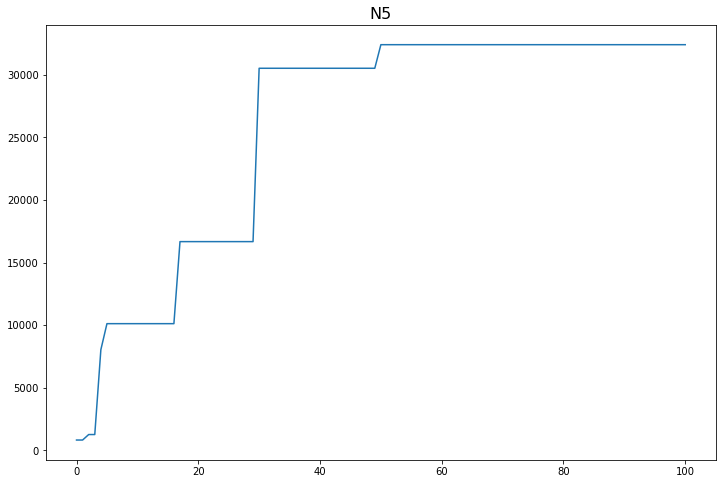

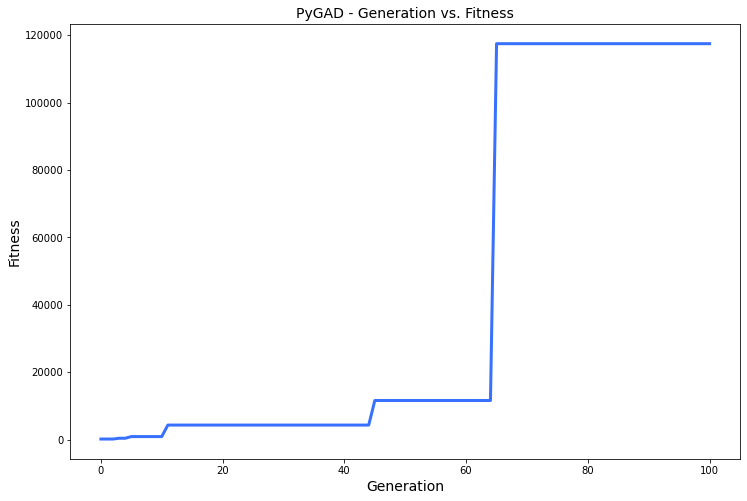

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.896 |==================| 13.546 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.329 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.778 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.902 |==================| 14.662 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.143 |==================| 8.872 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.155 |==================| 9.915 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.017 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.221 |==================| 28.447 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.055 |==================| 4.959 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.186 |==================| 14.318 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.144 |==================| 8.927 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.172 |==================| 11.941 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.179 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.017 |==================| 4.186 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.094 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.126 |==================| 7.666 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.133 |==================| 8.094 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.254 |==================| 481.558 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.118 |==================| 7.229 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.783 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.138 |==================| 8.461 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.208 |==================| 20.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.141 |==================| 8.655 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.196 |==================| 16.675 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.9 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.523 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.362 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.088 |==================| 5.958 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.17 |==================| 11.663 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.181 |==================| 13.281 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.224 |==================| 31.143 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.307 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.132 |==================| 8.041 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.089 |==================| 5.99 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.407 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.182 |==================| 13.538 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.223 |==================| 29.708 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.207 |==================| 20.318 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.253 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.245 |==================| 91.884 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.075 |==================| 5.519 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.078 |==================| 5.598 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.133 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.216 |==================| 24.959 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.133 |==================| 8.086 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.234 |==================| 45.859 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.202 |==================| 18.309 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.101 |==================| 6.458 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.051 |==================| 4.877 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.207 |==================| 20.465 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.179 |==================| 12.879 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.182 |==================| 13.569 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.023 |==================| 4.283 |==========| N7 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.241 |==================| 68.008 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.084 |==================| 5.793 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.698 |==========| N7 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.178 |==================| 12.731 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.215 |==================| 24.072 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.048 |==================| 4.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.147 |==================| 9.13 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.099 |==================| 6.354 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 27.043 |==================| 4.687 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.051 |==================| 4.872 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.255 |==================| 980.593 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.066 |==================| 5.253 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 27.107 |==================| 6.702 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.096 |==================| 6.246 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.247 |==================| 114.68 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.128 |==================| 7.782 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.109 |==================| 6.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.487 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.058 |==================| 5.048 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.174 |==================| 12.169 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.162 |==================| 10.613 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.039 |==================| 4.601 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.694 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.161 |==================| 10.495 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.207 |==================| 20.209 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.202 |==================| 18.438 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 27.032 |==================| 4.464 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.076 |==================| 5.544 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.062 |==================| 5.146 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.248 |==================| 116.448 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.428 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.024 |==================| 4.299 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.428 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.024 |==================| 4.309 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.165 |==================| 10.942 |==========| N7 |==========
**********************************************************************
Fitness = 980.5929325438176
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.197 |==================| 16.983 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.115 |==================| 7.07 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.063 |==================| 5.177 |==========| N7 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.143 |==================| 8.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.063 |==================| 5.178 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.09 |==================| 6.016 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.057 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.162 |==================| 10.622 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.771 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 27.055 |==================| 4.982 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.196 |==================| 16.753 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.11 |==================| 6.844 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.178 |==================| 12.81 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.059 |==================| 5.08 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.662 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.147 |==================| 9.177 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.175 |==================| 12.367 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.214 |==================| 23.944 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.886 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.033 |==================| 4.487 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.112 |==================| 6.933 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.164 |==================| 10.846 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.205 |==================| 19.405 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.237 |==================| 52.64 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.201 |==================| 18.057 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.231 |==================| 38.937 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.048 |==================| 4.812 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.043 |==================| 4.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.294 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.356 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.088 |==================| 5.931 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.746 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.101 |==================| 6.428 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.361 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.163 |==================| 10.693 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.25 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.146 |==================| 9.04 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.09 |==================| 6.009 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.032 |==================| 4.467 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.137 |==================| 8.39 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.15 |==================| 9.391 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.432 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.115 |==================| 7.085 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.115 |==================| 7.088 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.182 |==================| 13.396 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 27.091 |==================| 6.066 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.216 |==================| 25.171 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 27.065 |==================| 5.243 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.076 |==================| 5.562 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.618 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.122 |==================| 7.457 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.164 |==================| 10.79 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.164 |==================| 10.888 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.7 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.144 |==================| 8.875 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.161 |==================| 10.505 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 193.029 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.57 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.078 |==================| 5.621 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.236 |==================| 50.226 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.126 |==================| 7.658 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.225 |==================| 31.771 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.049 |==================| 4.825 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.105 |==================| 6.611 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.124 |==================| 7.588 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.049 |==================| 4.816 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.198 |==================| 17.072 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.105 |==================| 6.599 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.203 |==================| 18.849 |==========| N7 |==========
**********************************************************************
Fitness = 980.5929325438176
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.324 |==========| N7 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.24 |==================| 61.529 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.162 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.076 |==================| 5.565 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.109 |==================| 6.789 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.217 |==================| 25.303 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.097 |==================| 6.287 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 27.174 |==================| 12.229 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.05 |==================| 4.847 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.172 |==================| 11.81 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.222 |==================| 29.069 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.123 |==================| 7.489 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.131 |==================| 7.967 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.155 |==================| 9.846 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.114 |==================| 7.053 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.173 |==================| 12.044 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.215 |==================| 24.533 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.449 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.164 |==================| 10.852 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.219 |==================| 27.157 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.119 |==================| 7.305 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.042 |==================| 4.666 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.086 |==================| 5.866 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.067 |==================| 5.284 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.152 |==================| 9.58 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.25 |==================| 156.856 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 202.236 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.09 |==================| 6.022 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.172 |==================| 11.938 |==========| N7 |==========
**********************************************************************
=

======| 0.728 |===========| 27.081 |==================| 5.721 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.19 |==================| 15.184 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.132 |==================| 8.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.186 |==================| 14.326 |==========| N7 |==========
**********************************************************************
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NOD

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.189 |==================| 14.778 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.248 |==================| 117.131 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.187 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.081 |==================| 5.721 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.196 |==================| 16.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.181 |==================| 13.261 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.175 |==================| 12.286 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.163 |==================| 10.748 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.156 |==================| 9.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.188 |==================| 14.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.244 |==================| 83.635 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.087 |==================| 5.906 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.225 |==================| 31.925 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.209 |==================| 21.407 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.075 |==================| 5.521 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.156 |==================| 9.948 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.865 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.351 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.037 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.073 |==================| 5.463 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.151 |==================| 9.541 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.019 |==================| 4.225 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.037 |==================| 4.565 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.105 |==================| 6.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.028 |==================| 4.39 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.037 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.034 |==================| 4.492 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.654 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.164 |==================| 10.836 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 27.043 |==================| 4.68 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.163 |==================| 10.677 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.235 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.181 |==================| 13.313 |==========| N7 |==========
**********************************************************************
Fitness = 980.5929325438176
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.214 |==================| 23.852 |==========| N7 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.06 |==================| 5.086 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.938 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.252 |==================| 269.015 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.088 |==================| 5.963 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.057 |==================| 5.01 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.226 |==================| 33.104 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.867 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.978 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.188 |==================| 14.693 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.808 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.648 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.104 |==================| 6.57 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.063 |==================| 5.166 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.186 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.023 |==================| 4.291 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.671 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.037 |==================| 4.563 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.115 |==================| 7.073 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.244 |==================| 79.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.096 |==================| 6.227 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.036 |==================| 4.551 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.175 |==================| 12.359 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.092 |==================| 6.107 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.204 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 245.9 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.914 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.13 |==================| 7.953 |==========| N7 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.199 |==================| 17.439 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.226 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.408 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.614 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.037 |==================| 4.571 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.159 |==================| 10.242 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.917 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.218 |==================| 26.429 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.19 |==================| 15.222 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.235 |==================| 46.215 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.134 |==================| 8.198 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.029 |==================| 4.399 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.235 |==================| 47.127 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.612 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.021 |==================| 4.246 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.403 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.959 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.203 |==================| 18.765 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.242 |==================| 70.508 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.137 |==================| 8.423 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.182 |==================| 13.397 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.89 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.116 |==================| 7.135 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.114 |==================| 7.051 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.216 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.088 |==================| 5.942 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.376 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.064 |==================| 5.2 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.14 |==================| 8.628 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.118 |==========| N7 |==========
**********************************************************************
=====|SOL

======| 0.479 |===========| 27.142 |==================| 8.721 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 27.108 |==================| 6.763 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.221 |==================| 28.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.184 |==================| 13.867 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.611 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.15 |==================| 9.447 |==========| N7 |==========
**********************************************************************
Fitness = 980.5929325438176
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.193 |==================| 15.91 |==========| N7 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.016 |==================| 4.165 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.218 |==================| 25.85 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.158 |==================| 10.176 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.035 |==================| 4.516 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.717 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.197 |==================| 16.81 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.167 |==================| 11.271 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.039 |==================| 4.608 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.076 |==================| 5.55 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.049 |==================| 4.826 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.717 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.038 |==================| 4.593 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.041 |==================| 4.639 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.151 |==================| 9.495 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.119 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.148 |==================| 9.265 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.214 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.15 |==================| 9.388 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.053 |==================| 4.929 |==========| N7 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 80.411 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.847 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.079 |==================| 5.65 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.21 |==================| 21.672 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.113 |==================| 6.991 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.041 |==================| 4.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 27.014 |==================| 4.137 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.343 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.39 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.168 |==================| 11.285 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.23 |==================| 38.136 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.032 |==================| 4.465 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.096 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.193 |==================| 15.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.063 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.181 |==================| 13.331 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.178 |==================| 12.811 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.052 |==================| 4.907 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.246 |==================| 99.981 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.087 |==================| 5.908 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.073 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.547 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.107 |==================| 6.712 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.075 |==================| 5.534 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.244 |==================| 82.267 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.077 |==================| 5.59 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.193 |==================| 15.891 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.249 |==================| 144.807 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.207 |==================| 20.462 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.24 |==================| 60.995 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 27.077 |==================| 5.572 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.216 |==================| 24.691 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.018 |==================| 4.191 |==========| N7 |==========
**********************************************************************
Fitness = 980.5929325438176
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.253 |==================| 271.126 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.225 |==================| 32.033 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.207 |==================| 20.462 |==========| N7 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.139 |==================| 8.567 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.037 |==================| 4.569 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.084 |==================| 5.795 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.037 |==================| 4.555 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.161 |==================| 10.455 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.156 |==================| 9.942 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.142 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.162 |==================| 10.602 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.242 |==================| 72.28 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.915 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.35 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.246 |==================| 93.974 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 27.071 |==================| 5.404 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.021 |==================| 4.248 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.04 |==================| 4.621 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.193 |==================| 15.724 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.132 |==================| 8.045 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.048 |==================| 4.809 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.966 |==========| N7 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.098 |==================| 6.304 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.12 |==================| 7.356 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.763 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.229 |==================| 36.705 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 167.645 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.347 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.209 |==================| 21.123 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.415 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.177 |==================| 12.551 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.071 |==================| 5.412 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 27.046 |==================| 4.765 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.449 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.055 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.175 |==================| 12.341 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.745 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.129 |==================| 7.832 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.229 |==================| 37.074 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.168 |==================| 11.32 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.019 |==================| 4.22 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.101 |==================| 6.432 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.146 |==================| 9.07 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.204 |==================| 19.065 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.076 |==================| 5.539 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.158 |==================| 10.203 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.058 |==================| 5.044 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.173 |==================| 11.951 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 190.573 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.795 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.255 |==================| 959.914 |==========| N7 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.057 |==================| 5.01 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.124 |==================| 7.585 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.519 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.179 |==================| 12.906 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.052 |==================| 4.89 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.136 |==================| 8.322 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.173 |==================| 12.068 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.161 |==================| 10.469 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.195 |==================| 16.296 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 27.108 |==================| 6.763 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.247 |==================| 110.736 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.243 |==================| 73.824 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.213 |==================| 23.28 |==========| N7 |==========
**********************************************************************
Fitness = 1614.3501442564318
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.255 |==================| 609.324 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.334 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.087 |==================| 5.922 |==========| N7 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.777 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.143 |==================| 8.811 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.142 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.172 |==================| 11.857 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.211 |==================| 22.252 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.024 |==================| 4.309 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.237 |==================| 50.829 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.02 |==================| 4.232 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.225 |==================| 32.554 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.193 |==================| 15.775 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.054 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.245 |==================| 89.701 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 27.047 |==================| 4.777 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.02 |==================| 4.227 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.089 |==================| 5.986 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.222 |==================| 29.485 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.193 |==================| 15.874 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.152 |==================| 9.573 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.239 |==================| 57.004 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.881 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.42 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.171 |==================| 11.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.098 |==================| 6.339 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.195 |==================| 16.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.148 |==================| 9.226 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.104 |==================| 6.557 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.112 |==================| 6.941 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.096 |==================| 6.254 |==========| N7 |==========
**********************************************************************
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.034 |==================| 4.509 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.254 |==================| 490.095 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.613 |==========| N7 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.245 |==================| 85.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.021 |==================| 4.254 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.191 |==================| 15.294 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.225 |==================| 32.412 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.115 |==================| 7.079 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.156 |==================| 10.023 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.074 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.109 |==================| 6.778 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.163 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.401 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.184 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.182 |==================| 13.567 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.131 |==================| 7.974 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.028 |==================| 4.373 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.085 |==================| 5.832 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.163 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.484 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.139 |==================| 8.508 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.066 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.035 |==================| 4.517 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 27.138 |==================| 8.479 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.104 |==================| 6.572 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.254 |==================| 410.038 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.198 |==================| 17.14 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.045 |==================| 4.74 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.214 |==================| 23.836 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.088 |==================| 5.938 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.137 |==================| 8.377 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.188 |==================| 14.568 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.235 |==================| 47.051 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.098 |==================| 6.337 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.042 |==================| 4.658 |==========| N7 |==========
**********************************************************************
==

**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.085 |==================| 5.834 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.249 |==================| 148.647 |==========| N7 |==========
**********************************************************************
Fitness = 1614.3501442564318
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.229 |==================| 37.224 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.188 |==================| 14.568

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.092 |==================| 6.107 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.027 |==================| 4.359 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.194 |==================| 16.125 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.085 |==================| 5.834 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.211 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.201 |==================| 18.193 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.127 |==================| 7.749 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.192 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.222 |==================| 29.022 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.052 |==================| 4.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.152 |==================| 9.566 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.211 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.246 |==================| 95.995 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 201.525 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.427 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.222 |==================| 29.022 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.038 |==================| 4.585 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.212 |==================| 22.468 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.027 |==================| 4.371 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.182 |==================| 13.451 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.248 |==================| 121.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.461 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.736 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.251 |==================| 185.525 |==========| N7 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.325 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.506 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.223 |==================| 30.117 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.054 |==================| 4.944 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.03 |==================| 4.414 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.125 |==================| 7.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.11 |==================| 6.847 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.076 |==================| 5.553 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.135 |==================| 8.247 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.138 |==================| 8.483 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.06 |==================| 5.107 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 189.873 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.094 |==================| 6.157 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.073 |==================| 5.448 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.06 |==================| 5.108 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.239 |==================| 58.77 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.115 |==================| 7.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.233 |==================| 43.51 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.023 |==================| 4.283 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.166 |==================| 11.095 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 27.015 |==================| 4.153 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.202 |==================| 18.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.152 |==================| 9.601 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.038 |==================| 4.577 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.162 |==================| 10.641 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.669 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.18 |==================| 13.206 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.24 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.077 |==================| 5.592 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.078 |==================| 5.598 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.434 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.035 |==================| 4.512 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.023 |==================| 4.289 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.164 |==================| 10.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.253 |==================| 280.094 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.219 |==================| 27.031 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.638 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.112 |==================| 6.926 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.109 |==================| 6.793 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.237 |==================| 52.735 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 169.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.018 |==================| 4.196 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.033 |==================| 4.49 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.076 |==================| 5.536 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.406 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.024 |==================| 4.299 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.245 |==================| 89.242 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.101 |==================| 6.427 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.088 |==================| 5.939 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.508 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.085 |==================| 5.844 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.172 |==================| 11.865 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.075 |==================| 5.527 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 27.123 |==================| 7.514 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.153 |==================| 9.681 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.162 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.057 |==================| 5.03 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.519 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.09 |==================| 6.01 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.247 |==================| 113.538 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.24 |==================| 59.96 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.108 |==================| 6.768 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.151 |==================| 9.51 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.031 |==================| 4.443 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.209 |==================| 21.215 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.464 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.735 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.087 |==================| 5.923 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.097 |==================| 6.269 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.067 |==================| 5.289 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.197 |==================| 17.003 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.216 |==================| 25.169 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.083 |==================| 5.785 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.054 |==================| 4.94 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.121 |==================| 7.406 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.248 |==================| 128.596 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.212 |==================| 22.676 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.901 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 27.074 |==================| 5.477 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.189 |==================| 14.815 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.914 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.096 |==================| 6.242 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.144 |==================| 8.951 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.058 |==================| 5.046 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.037 |==================| 4.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.173 |==================| 12.005 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.25 |==================| 172.637 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.129 |==================| 7.867 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.237 |==================| 52.938 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.202 |==================| 18.506 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.15 |==================| 9.436 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.223 |==================| 29.91 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 27.043 |==================| 4.68 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.029 |==================| 4.401 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.187 |==================| 14.409 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.199 |==================| 17.529 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.117 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.182 |==================| 13.495 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.064 |==================| 5.194 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.35 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.047 |==================| 4.78 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.235 |==================| 48.19 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 27.125 |==================| 7.603 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.254 |==================| 376.584 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.336 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.209 |==================| 21.377 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.05 |==================| 4.846 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.224 |==================| 30.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.019 |==================| 4.224 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.207 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.075 |==================| 5.519 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.09 |==================| 6.011 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 33.831 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.149 |==================| 9.297 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.744 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.022 |==================| 4.274 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.074 |==================| 5.481 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.249 |==================| 137.604 |==========| N7 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.123 |==================| 7.513 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.134 |==================| 8.182 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.109 |==================| 6.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.177 |==================| 12.675 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.132 |==================| 8.07 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.006 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.177 |==================| 12.602 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.246 |==================| 102.441 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.243 |==================| 75.935 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.174 |==================| 12.15 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.113 |==================| 7.004 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.043 |==================| 4.702 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.307 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 187.949 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.365 |==========| N7 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.661 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.144 |==================| 8.947 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.024 |==================| 4.307 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.243 |==================| 73.687 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.144 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.783 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.94 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.224 |==================| 31.377 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.036 |==================| 4.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.016 |==================| 4.172 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.749 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.084 |==================| 5.804 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.177 |==================| 12.661 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.142 |==================| 8.736 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.117 |==================| 7.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.239 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.064 |==================| 5.206 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.252 |==================| 214.864 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.118 |==================| 7.213 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.064 |==================| 5.192 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.198 |==================| 17.109 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.027 |==================| 4.363 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.208 |==================| 20.946 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.635 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.069 |==================| 5.337 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.027 |==================| 4.368 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.685 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.078 |==================| 5.626 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.116 |==================| 7.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.056 |==================| 4.998 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.019 |==========| N7 |==========
**********************************************************************
Fitness = 1925.291692139244
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.072 |==================| 5.436 |==========| N7 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.126 |==================| 7.653 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.086 |==================| 5.863 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.022 |==================| 4.264 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.193 |==================| 15.875 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.047 |==================| 4.769 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.036 |==================| 4.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.246 |==================| 94.962 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.053 |==================| 4.933 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 202.215 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.193 |==================| 15.78 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.597 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.123 |==================| 7.533 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.198 |==================| 17.224 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.128 |==================| 7.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.105 |==================| 6.622 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.113 |==================| 6.977 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.106 |==================| 6.638 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.071 |==================| 5.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.151 |==================| 9.504 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.238 |==================| 54.391 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.069 |==================| 5.346 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.174 |==================| 12.162 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.16 |==================| 10.429 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.645 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.215 |==================| 24.107 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.191 |==================| 15.344 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.378 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.197 |==================| 16.986 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.081 |==================| 5.692 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.447 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.119 |==================| 7.284 |==========| N7 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.128 |==================| 7.826 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.177 |==================| 12.619 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.164 |==================| 10.894 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.218 |==================| 26.16 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.081 |==================| 5.718 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.049 |==================| 4.829 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.156 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 166.056 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.066 |==================| 5.267 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.159 |==================| 10.262 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.251 |==================| 180.394 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.127 |==================| 7.757 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.035 |==================| 4.525 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.035 |==================| 4.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.212 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.066 |==================| 5.267 |==========| N7 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.047 |==================| 4.777 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.016 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.205 |==================| 19.54 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.174 |==================| 12.099 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.213 |==================| 22.99 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.054 |==================| 4.946 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.24 |==================| 61.908 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.218 |==================| 26.469 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.195 |==================| 16.247 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.033 |==================| 4.484 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.088 |==================| 5.929 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.101 |==================| 6.457 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.205 |==================| 19.71 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.099 |==================| 6.37 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.107 |==================| 6.71 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.246 |==================| 97.899 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.194 |==================| 15.959 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.073 |==================| 5.46 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.211 |==================| 22.349 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.09 |==================| 6.034 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.224 |==================| 31.551 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.219 |==================| 26.876 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.166 |==================| 11.044 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.221 |==================| 28.504 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.449 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.033 |==================| 4.481 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.233 |==================| 43.031 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 27.061 |==================| 5.113 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.068 |==================| 5.321 |==========| N7 |==========
**********************************************************************
Fitness = 1925.291692139244
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.042 |==================| 4.662 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.04 |==================| 4.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.223 |==================| 30.279 |==========| N7 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.233 |==================| 42.79 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.132 |==================| 8.057 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.048 |==================| 4.802 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.061 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.183 |==================| 13.735 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.117 |==================| 7.202 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.226 |==================| 33.376 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.194 |==================| 16.189 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.334 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.681 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.159 |==================| 10.295 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.247 |==================| 112.574 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 27.15 |==================| 9.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.182 |==================| 13.416 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.734 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.184 |==================| 13.791 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.075 |==================| 5.513 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.254 |==================| 438.565 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.131 |==================| 7.956 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.21 |==================| 21.683 |==========| N7 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.251 |==================| 180.316 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.018 |==================| 4.199 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.249 |==================| 147.0 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 123.393 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.152 |==================| 9.64 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.038 |==================| 4.583 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.213 |==================| 23.363 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 27.149 |==================| 9.306 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.167 |==================| 11.151 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.077 |==================| 5.577 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.674 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.471 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.223 |==================| 30.488 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.091 |==================| 6.043 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.163 |==================| 10.748 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.211 |==================| 22.159 |==========| N7 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.237 |==================| 52.986 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.057 |==================| 5.032 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.192 |==================| 15.48 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.223 |==================| 30.488 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.177 |==================| 12.678 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.073 |==================| 5.46 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.506 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.172 |==================| 11.808 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 27.122 |==================| 7.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.103 |==================| 6.537 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.64 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.147 |==================| 9.184 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.13 |==================| 7.903 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.004 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.854 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.079 |==================| 5.633 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.097 |==================| 6.281 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.076 |==================| 5.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.21 |==================| 21.752 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.066 |==================| 5.264 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.101 |==================| 6.452 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.201 |==================| 18.138 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.084 |==================| 5.806 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.207 |==================| 20.211 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.005 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.254 |==================| 402.382 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.202 |==================| 18.441 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.173 |==========| N7 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.133 |==================| 8.117 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.039 |==================| 4.613 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.178 |==================| 12.833 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.005 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.116 |==================| 7.112 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.2 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.067 |==================| 5.287 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.237 |==================| 52.971 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.178 |==================| 12.828 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.132 |==================| 8.034 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.206 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.18 |==================| 13.202 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.028 |==================| 4.386 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.238 |==================| 56.07 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.18 |==================| 13.201 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.039 |==================| 4.602 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.616 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.094 |==================| 6.168 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.06 |==================| 5.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.643 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.216 |==================| 24.872 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.023 |==================| 4.288 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.096 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.056 |==================| 4.998 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 27.086 |==================| 5.87 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.048 |==================| 4.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.122 |==================| 7.45 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.234 |==================| 44.342 |==========| N7 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.76 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.049 |==================| 4.821 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.069 |==================| 5.34 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.159 |==================| 10.322 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.385 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.152 |==================| 9.612 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.118 |==================| 7.223 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.1 |==================| 6.421 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.063 |==================| 5.174 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.44 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.233 |==================| 42.436 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.08 |==================| 5.684 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.039 |==================| 4.611 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 123.156 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.667 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.048 |==================| 4.811 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.408 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.048 |==================| 4.812 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.097 |==================| 6.289 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 27.014 |==================| 4.137 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.236 |==================| 49.156 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.127 |==================| 7.729 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 27.106 |==================| 6.66 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.029 |==================| 4.395 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.074 |==================| 5.497 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.24 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.491 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 27.015 |==================| 4.154 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.705 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.224 |==================| 31.528 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.052 |==================| 4.89 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.053 |==================| 4.92 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.157 |==================| 10.127 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.491 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.412 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.194 |==================| 16.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.841 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.192 |==================| 15.58 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.057 |==================| 5.031 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.246 |==================| 99.353 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.063 |==================| 5.179 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.052 |==================| 4.909 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.841 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.036 |==================| 4.545 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.171 |==================| 11.716 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.095 |==================| 6.208 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.071 |==================| 5.41 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.16 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.068 |==================| 5.32 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.241 |==================| 63.953 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.036 |==================| 4.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.014 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.164 |==================| 10.817 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.112 |==================| 6.948 |==========| N7 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.2 |==================| 17.943 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.056 |==================| 4.987 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.207 |==================| 20.293 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.016 |==================| 4.162 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.05 |==================| 4.854 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.253 |==================| 327.82 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.102 |==================| 6.488 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.135 |==================| 8.275 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.022 |==================| 4.266 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.247 |==================| 108.329 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.039 |==================| 4.614 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.348 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.548 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.041 |==================| 4.652 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.206 |==================| 19.822 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.194 |==================| 16.185 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.256 |==================| 50520.026 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.248 |==================| 121.019 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.2 |==================| 17.724 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.473 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.162 |==================| 10.641 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.219 |==================| 26.964 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.23 |==================| 38.734 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 165.64 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.186 |==================| 14.188 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.2 |==================| 17.925 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.192 |==================| 15.575 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.188 |==================| 14.679 |==========| N7 |==========
**********************************************************************
Fitness = 50520.025822165975
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.25 |==================| 156.235 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.244 |==================| 82.607 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.099 |==================| 6.379 |==========| N7 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.652 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.194 |==================| 15.983 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.803 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.188 |==================| 14.679 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.039 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.061 |==================| 5.121 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.231 |==================| 39.597 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.523 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.207 |==================| 20.208 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.185 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.421 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 27.085 |==================| 5.854 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.066 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.18 |==================| 13.088 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.016 |==================| 4.165 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.03 |==================| 4.415 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.09 |==================| 6.019 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.205 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.093 |==================| 6.124 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.9 |==========| N7 |==========
**********************************************************************
Generati

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.102 |==================| 6.491 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.152 |==================| 9.562 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.204 |==================| 19.244 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.438 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.818 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.171 |==================| 11.731 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.093 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.148 |==================| 9.262 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.082 |==================| 5.738 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.182 |==================| 13.511 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.238 |==================| 55.469 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.219 |==================| 26.687 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.194 |==================| 16.036 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.111 |==================| 6.89 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.17 |==================| 11.555 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.192 |==================| 15.691 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.084 |==================| 5.797 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.206 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.692 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.04 |==================| 4.621 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.431 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.512 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.253 |==================| 306.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 27.113 |==================| 6.993 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.107 |==================| 6.688 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.097 |==================| 6.283 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.413 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 27.091 |==================| 6.062 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.205 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.347 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.048 |==================| 4.796 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.242 |==================| 72.954 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.747 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.124 |==================| 7.569 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.246 |==================| 93.781 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.135 |==================| 8.273 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.871 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.142 |==================| 8.773 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.125 |==================| 7.61 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.14 |==================| 8.59 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 27.086 |==================| 5.86 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.062 |==================| 5.137 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.825 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.109 |==================| 6.801 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.165 |==================| 11.024 |==========| N7 |==========
**********************************************************************
Fitness = 50520.025822165975
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.048 |==================| 4.798 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.126 |==================| 7.67 |==========| N7 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.172 |==================| 11.841 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.175 |==================| 12.264 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 27.121 |==================| 7.424 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.229 |==================| 37.12 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.236 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.177 |==================| 12.694 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.128 |==================| 7.791 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.024 |==================| 4.298 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.151 |==================| 9.524 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 27.14 |==================| 8.585 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.02 |==================| 4.236 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.508 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.209 |==================| 21.19 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.053 |==================| 4.919 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.112 |==================| 6.942 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.095 |==================| 6.188 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.849 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.146 |==================| 9.115 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 27.125 |==================| 7.603 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.031 |==================| 4.434 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 27.107 |==================| 6.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.098 |==================| 6.341 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.081 |==================| 5.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.121 |==================| 7.382 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.024 |==================| 4.298 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.075 |==================| 5.524 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.18 |==================| 13.062 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.139 |==================| 8.527 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.252 |==================| 229.584 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.962 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.16 |==================| 10.379 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.154 |==================| 9.763 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.202 |==================| 18.549 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.251 |==================| 208.146 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.075 |==================| 5.512 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.032 |==================| 4.469 |==========| N7 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.04 |==================| 4.635 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.207 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.165 |==================| 10.994 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.845 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.576 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.185 |==================| 14.105 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.188 |==================| 14.592 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.424 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.071 |==================| 5.409 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.238 |==================| 55.268 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.216 |==================| 25.109 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.576 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.125 |==================| 7.624 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.168 |==================| 11.336 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.184 |==================| 13.848 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.038 |==================| 4.578 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.047 |==================| 4.79 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.121 |==================| 7.408 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.032 |==================| 4.466 |==========| N7 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.047 |==================| 4.789 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.21 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.25 |==================| 160.854 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.138 |==================| 8.484 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.041 |==================| 4.646 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.053 |==================| 4.925 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.159 |==================| 10.241 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.084 |==================| 5.82 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.151 |==================| 9.541 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.17 |==================| 11.553 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.034 |==================| 4.501 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.082 |==================| 5.744 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.017 |==================| 4.174 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.149 |==================| 9.324 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.066 |==================| 5.251 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.247 |==================| 104.723 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.209 |==================| 21.034 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.55 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.608 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.186 |==================| 14.3 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.116 |==================| 7.114 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.108 |==================| 6.77 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.202 |==================| 18.558 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.031 |==================| 4.438 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.094 |==================| 6.164 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 27.102 |==================| 6.501 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.207 |==================| 20.296 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.047 |==================| 4.782 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.598 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.245 |==================| 92.389 |==========| N7 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.088 |==================| 5.946 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.098 |==================| 6.32 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.196 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.094 |==================| 6.16 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.204 |==================| 19.163 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.039 |==================| 4.598 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.252 |==================| 230.84 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 74.89 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.179 |==================| 12.881 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.196 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.225 |==================| 31.837 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.2 |==================| 17.789 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.045 |==================| 4.746 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.128 |==================| 7.793 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 27.135 |==================| 8.286 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.14 |==================| 8.624 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.212 |==================| 22.847 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.225 |==================| 31.837 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.035 |==================| 4.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.118 |==================| 7.224 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.595 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.142 |==================| 8.731 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.24 |==================| 63.107 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.603 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.138 |==================| 8.451 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.092 |==================| 6.072 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.675 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.029 |==================| 4.397 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.122 |==================| 7.455 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.143 |==================| 8.799 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.175 |==================| 12.322 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.173 |==================| 12.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.183 |==================| 13.733 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.225 |==================| 31.648 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.327 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.079 |==================| 5.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.647 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.14 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.018 |==================| 4.196 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.2 |==================| 17.663 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.021 |==================| 4.246 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.449 |==========| N7 |==========
**********************************************************************
===

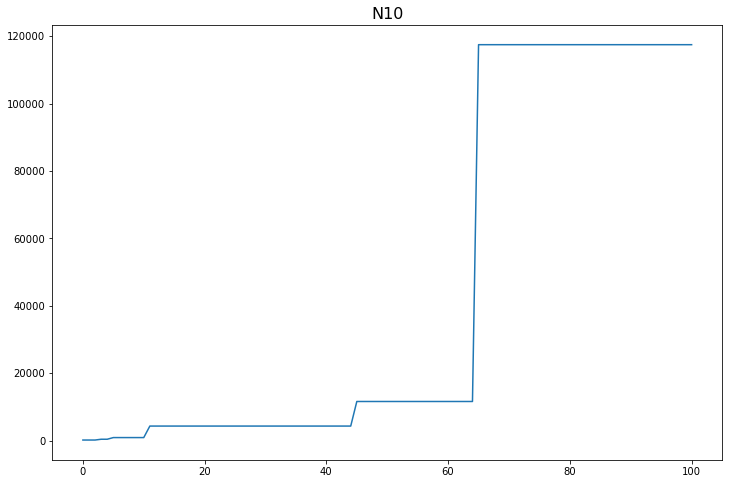

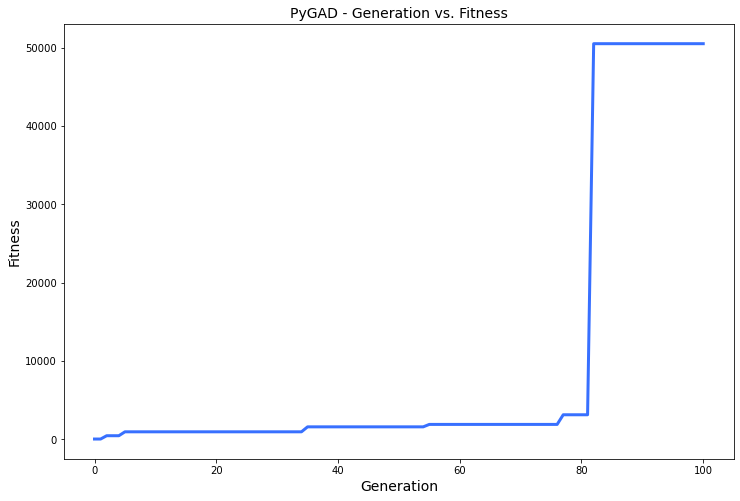

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.449 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.327 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.079 |==================| 5.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.647 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.843 |==================| 36.283 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.851 |==================| 51.696 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.82 |==================| 19.973 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.862 |==================| 121.309 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.821 |==================| 20.299 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.816 |==================| 18.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.817 |==================| 18.804 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.815 |==================| 18.127 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.825 |==================| 22.128 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.86 |==================| 96.604 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.836 |==================| 28.694 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.869 |==================| 795.546 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.844 |==================| 38.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.312 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.823 |==================| 21.334 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.829 |==================| 24.393 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 24.814 |==================| 17.883 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 25.493 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.857 |==================| 72.376 |==========| N2 |==========
**********************************************************************
Fitness = 795.5463595493972
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.844 |==================| 38.244 |==========| N2 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.854 |==================| 60.583 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.868 |==================| 352.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.829 |==================| 24.223 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.829 |==================| 24.386 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.822 |==================| 20.702 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.846 |==================| 40.432 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.849 |==================| 47.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.848 |==================| 44.339 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 21.568 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.818 |==================| 19.151 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.83 |==================| 24.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.839 |==================| 32.273 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.849 |==================| 47.863 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.855 |==================| 63.064 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 19.456 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.846 |==================| 41.456 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.817 |==================| 18.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.301 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.86 |==================| 101.264 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.818 |==================| 19.001 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.863 |==================| 129.301 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.818 |==================| 19.128 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.822 |==================| 20.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.816 |==================| 18.376 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.849 |==================| 47.655 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.869 |==================| 908.204 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.836 |==================| 29.505 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.837 |==================| 29.863 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.848 |==================| 45.601 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.825 |==================| 22.17 |==========| N2 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.827 |==================| 22.946 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.835 |==================| 28.039 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.848 |==================| 44.312 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.851 |==================| 52.577 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.835 |==================| 27.999 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.826 |==================| 22.617 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.858 |==================| 78.409 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.008 |===========| 24.814 |==================| 17.729 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.857 |==================| 75.373 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.86 |==================| 100.315 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.87 |==================| 1483.91 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.85 |==================| 48.087 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.844 |==================| 37.535 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.854 |==================| 60.077 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.845 |==================| 40.041 |==========| N2 |==========
**********************************************************************
Change = 575.7061538877232
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.833 |==================| 26.575 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.859 |==================| 84.701 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.827 |==================| 23.285 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.868 |==================| 467.011 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.856 |==================| 68.786 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.869 |==================| 854.253 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.825 |==================| 21.991 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.824 |==================| 21.605 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.836 |==================| 29.454 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.816 |==================| 18.329 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.827 |==================| 23.263 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.866 |==================| 207.246 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.865 |==================| 181.855 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.829 |==================| 24.043 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.863 |==================| 140.587 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.82 |==================| 19.948 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.856 |==================| 68.149 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.863 |==================| 134.075 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 20.929 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.844 |==================| 38.131 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.841 |==================| 33.919 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.816 |==================| 18.543 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.837 |==================| 30.326 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.841 |==================| 33.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 55.205 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.837 |==================| 30.218 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.853 |==================| 56.105 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.848 |==================| 45.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.862 |==================| 126.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.853 |==================| 58.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.859 |==================| 91.11 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.821 |==================| 20.204 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.82 |==================| 19.935 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.815 |==================| 18.038 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.868 |==================| 353.763 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.838 |==================| 30.533 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.866 |==================| 233.629 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 41.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.821 |==================| 20.204 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.85 |==================| 48.357 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.858 |==================| 78.196 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.838 |==================| 31.184 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 75.536 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 21.568 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.865 |==================| 171.352 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 75.578 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.824 |==================| 21.771 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.863 |==================| 144.143 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 24.835 |==================| 28.213 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.816 |==================| 18.457 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.842 |==================| 35.636 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.822 |==================| 20.639 |==========| N2 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.823 |==================| 20.958 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.822 |==================| 20.518 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.87 |==================| 3064.667 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.853 |==================| 56.238 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 37.415 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.864 |==================| 159.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.816 |==================| 18.368 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.827 |==================| 22.903 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.829 |==================| 24.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.824 |==================| 21.628 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.858 |==================| 82.936 |==========| N2 |==========
**********************************************************************


======| 0.756 |===========| 24.828 |==================| 23.687 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.843 |==================| 37.222 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.828 |==================| 23.433 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.822 |==================| 20.718 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


======| 0.764 |===========| 24.828 |==================| 23.435 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.853 |==================| 58.513 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.853 |==================| 57.324 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.824 |==================| 21.704 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.828 |==================| 23.379 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.842 |==================| 35.427 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.832 |==================| 26.369 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 24.331 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.845 |==================| 39.143 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.841 |==================| 34.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.856 |==================| 71.955 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.829 |==================| 24.148 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.865 |==================| 185.592 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.838 |==================| 31.363 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.834 |==================| 27.384 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.845 |==================| 39.143 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.87 |==================| 1295.836 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.866 |==================| 216.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.848 |==================| 43.833 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.827 |==================| 22.808 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.835 |==================| 28.414 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.867 |==================| 333.35 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.867 |==================| 324.676 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.869 |==================| 608.226 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.853 |==================| 57.5 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.849 |==================| 46.001 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.845 |==================| 40.041 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.839 |==================| 32.186 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 28.465 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.837 |==================| 30.009 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.835 |==================| 27.959 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.837 |==================| 29.545 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.825 |==================| 22.028 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.839 |==================| 31.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.858 |==================| 78.238 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.836 |==================| 28.883 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.826 |==================| 22.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.819 |==================| 19.297 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.828 |==================| 23.431 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.845 |==================| 38.802 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.862 |==================| 122.661 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.863 |==================| 128.851 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.848 |==================| 44.867 |==========| N2 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.831 |==================| 25.64 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.827 |==================| 23.314 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.832 |==================| 25.97 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.87 |==================| 6588.896 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.825 |==================| 21.902 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.858 |==================| 80.608 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.835 |==================| 28.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.834 |==================| 27.754 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.825 |==================| 21.814 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.853 |==================| 58.092 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.832 |==================| 26.194 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.868 |==================| 401.811 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.83 |==================| 24.65 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.825 |==================| 22.246 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.822 |==================| 20.767 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.838 |==================| 30.716 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.845 |==================| 39.9 |==========| N2 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.85 |==================| 48.189 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.848 |==================| 45.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.861 |==================| 104.01 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.825 |==================| 21.897 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.865 |==================| 194.237 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.843 |==================| 36.18 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.846 |==================| 41.718 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.848 |==================| 45.682 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.838 |==================| 31.038 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.869 |==================| 604.924 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.826 |==================| 22.472 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.865 |==================| 194.237 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.84 |==================| 32.428 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.324 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.867 |==================| 271.34 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.83 |==================| 24.588 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.854 |==================| 60.67 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.835 |==================| 28.274 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.852 |==================| 55.719 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.838 |==================| 31.306 |==========| N2 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.85 |==================| 48.524 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.864 |==================| 151.534 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.866 |==================| 247.653 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.834 |==================| 27.376 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.825 |==================| 22.246 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.843 |==================| 36.272 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 28.484 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.844 |==================| 37.308 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.855 |==================| 66.981 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.853 |==================| 56.283 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.832 |==================| 25.875 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.825 |==================| 22.246 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.85 |==================| 48.776 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.866 |==================| 245.404 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.865 |==================| 178.99 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.855 |==================| 66.981 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.858 |==================| 79.002 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.824 |==================| 21.749 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.84 |==================| 32.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.864 |==================| 150.633 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.818 |==================| 19.189 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.83 |==================| 24.682 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.86 |==================| 96.629 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 69.569 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.826 |==================| 22.424 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 19.825 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.864 |==================| 150.633 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.835 |==================| 28.031 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 19.338 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.836 |==================| 29.414 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.816 |==================| 18.417 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.825 |==================| 22.14 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.82 |==================| 19.812 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.827 |==================| 22.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.835 |==================| 28.031 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.816 |==================| 18.258 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 28.449 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.845 |==================| 38.699 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.818 |==================| 19.187 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 90.195 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.846 |==================| 41.503 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.831 |==================| 25.271 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.815 |==================| 18.091 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.849 |==================| 47.618 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.84 |==================| 32.621 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.816 |==================| 18.413 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.824 |==================| 21.72 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.82 |==================| 19.685 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.843 |==================| 35.89 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.868 |==================| 466.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.817 |==================| 18.708 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 19.769 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.815 |==================| 18.124 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.828 |==================| 23.443 |==========| N2 |==========
**********************************************************************
Fitness = 6588.896261530032
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.822 |==================| 20.603 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.856 |==================| 68.216 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.821 |==================| 20.409 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.845 |==================| 39.25 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.832 |==================| 25.966 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 220.832 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.861 |==================| 105.298 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.834 |==================| 27.869 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 238.556 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.824 |==================| 21.721 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.857 |==================| 72.683 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.843 |==================| 36.146 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.817 |==================| 18.789 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.848 |==================| 43.786 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.838 |==================| 30.511 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.856 |==================| 71.595 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.864 |==================| 149.177 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.824 |==================| 21.71 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 19.46 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 19.465 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.818 |==================| 19.042 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.869 |==================| 1037.71 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.83 |==================| 25.053 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.857 |==================| 76.686 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.825 |==================| 21.861 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.815 |==================| 18.196 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.845 |==================| 39.759 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.858 |==================| 79.769 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 41.064 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.84 |==================| 32.853 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.817 |==================| 18.591 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.826 |==================| 22.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.845 |==================| 38.685 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.844 |==================| 38.213 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.848 |==================| 44.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.848 |==================| 44.902 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.868 |==================| 410.35 |==========| N2 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.857 |==================| 72.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.845 |==================| 38.866 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.854 |==================| 60.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.817 |==================| 18.794 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.867 |==================| 284.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.826 |==================| 22.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.868 |==================| 425.006 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 219.61 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.868 |==================| 380.776 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 21.574 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.867 |==================| 273.683 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.867 |==================| 284.105 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 19.528 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.841 |==================| 34.635 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.821 |==================| 20.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 37.394 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.839 |==================| 32.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 21.971 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.843 |==================| 36.041 |==========| N2 |==========
**********************************************************************
Fitness = 13783.14827238986
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 19.528 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.84 |==================| 33.369 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.823 |==================| 21.279 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.867 |==================| 288.856 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 24.828 |==================| 23.875 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.849 |==================| 47.558 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 23.49 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 19.449 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 24.333 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.868 |==================| 380.399 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.862 |==================| 126.966 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.857 |==================| 76.017 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.869 |==================| 985.789 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.857 |==================| 73.081 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.822 |==================| 20.534 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.867 |==================| 262.26 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.84 |==================| 32.696 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.83 |==================| 25.035 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.84 |==================| 33.206 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.834 |==================| 27.307 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.824 |==================| 21.503 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.841 |==================| 34.463 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.864 |==================| 159.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.842 |==================| 34.771 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.867 |==================| 301.503 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.838 |==================| 31.071 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.86 |==================| 98.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.857 |==================| 74.439 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.87 |==================| 35371.947 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.844 |==================| 37.545 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.859 |==================| 84.673 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.857 |==================| 75.969 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.859 |==================| 91.506 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.869 |==================| 841.659 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.827 |==================| 22.958 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.838 |==================| 30.936 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.846 |==================| 41.46 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.824 |==================| 21.609 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.866 |==================| 218.039 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.823 |==================| 21.338 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.695 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.865 |==================| 198.145 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.858 |==================| 80.36 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.86 |==================| 94.102 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.832 |==================| 25.842 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.821 |==================| 20.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.819 |==================| 19.584 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.841 |==================| 34.169 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.863 |==================| 127.838 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.87 |==================| 1956.377 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.827 |==================| 23.183 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.82 |==================| 19.689 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.862 |==================| 126.33 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.862 |==================| 114.304 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.865 |==================| 182.808 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 37.424 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.834 |==================| 27.243 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.842 |==================| 35.605 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.854 |==================| 62.172 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.832 |==================| 25.837 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.856 |==================| 70.051 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.827 |==================| 22.836 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.827 |==================| 22.851 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.833 |==================| 26.501 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.843 |==================| 36.177 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.835 |==================| 28.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.824 |==================| 21.414 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.824 |==================| 21.399 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 69.434 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.851 |==================| 52.273 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.841 |==================| 33.836 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.826 |==================| 22.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.836 |==================| 29.263 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.84 |==================| 33.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.832 |==================| 26.18 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.817 |==================| 18.874 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 20.924 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.852 |==================| 54.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.818 |==================| 19.258 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.824 |==================| 21.69 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.821 |==================| 20.384 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.841 |==================| 34.456 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.867 |==================| 285.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.843 |==================| 36.177 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.858 |==================| 82.319 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.832 |==================| 25.793 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.833 |==================| 26.942 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.841 |==================| 34.566 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.834 |==================| 27.426 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.844 |==================| 37.913 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.842 |==================| 35.106 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.86 |==================| 93.588 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.818 |==================| 19.0 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.825 |==================| 21.831 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.858 |==================| 83.665 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.834 |==================| 27.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.857 |==================| 72.844 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.864 |==================| 146.027 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.818 |==================| 18.945 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.836 |==================| 28.923 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.853 |==================| 58.099 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.851 |==================| 51.515 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.829 |==================| 24.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.853 |==================| 57.625 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.82 |==================| 19.808 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.85 |==================| 49.464 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.858 |==================| 83.482 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.829 |==================| 23.96 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.851 |==================| 51.515 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.836 |==================| 29.456 |==========| N2 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 90.014 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.847 |==================| 43.218 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.85 |==================| 48.682 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 21.961 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.828 |==================| 23.355 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.842 |==================| 34.996 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.862 |==================| 119.573 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.825 |==================| 22.263 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.859 |==================| 89.551 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.845 |==================| 39.061 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.846 |==================| 40.888 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 21.959 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.825 |==================| 22.231 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 19.342 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.836 |==================| 29.276 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.86 |==================| 92.504 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.847 |==================| 42.359 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.864 |==================| 158.433 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 21.959 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.836 |==================| 29.491 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.849 |==================| 45.933 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.862 |==================| 122.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.823 |==================| 21.094 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.821 |==================| 20.278 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.825 |==================| 22.1 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.854 |==================| 62.517 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.868 |==================| 381.488 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.846 |==================| 41.633 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.857 |==================| 76.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.831 |==================| 25.547 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.859 |==================| 86.403 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.86 |==================| 101.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.831 |==================| 25.676 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.843 |==================| 37.169 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.836 |==================| 29.347 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.859 |==================| 90.273 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.86 |==================| 98.767 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.861 |==================| 104.639 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.87 |==================| 2008.569 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 19.473 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.818 |==================| 19.039 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.821 |==================| 20.133 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.815 |==================| 18.116 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.832 |==================| 26.007 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.835 |==================| 27.887 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.837 |==================| 30.031 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.833 |==================| 26.51 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.833 |==================| 26.561 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.839 |==================| 31.8 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.822 |==================| 20.796 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.86 |==================| 94.329 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.849 |==================| 46.977 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.851 |==================| 50.782 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.861 |==================| 107.801 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.833 |==================| 26.561 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.87 |==================| 1382.71 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.832 |==================| 26.24 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.861 |==================| 103.894 |==========| N2 |==========
**********************************************************************
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 19.448 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.86 |==================| 100.771 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.829 |==================| 24.255 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 219.935 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.862 |==================| 116.011 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.832 |==================| 26.311 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.843 |==================| 36.886 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.833 |==================| 27.099 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.859 |==================| 91.187 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.824 |==================| 21.79 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.817 |==================| 18.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 28.456 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.842 |==================| 35.168 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.816 |==================| 18.326 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.858 |==================| 79.6 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.829 |==================| 24.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 257.657 |==========| N2 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.829 |==================| 24.453 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.848 |==================| 45.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.818 |==================| 19.059 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.834 |==================| 27.859 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.819 |==================| 19.323 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.839 |==================| 31.543 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.822 |==================| 20.798 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.86 |==================| 92.301 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.84 |==================| 33.038 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.815 |==================| 18.03 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.847 |==================| 42.884 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.832 |==================| 25.821 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.832 |==================| 26.28 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.831 |==================| 25.466 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.815 |==================| 18.185 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.87 |==================| 1267.637 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.815 |==================| 18.217 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.836 |==================| 29.042 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.858 |==================| 80.88 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.823 |==================| 21.333 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 24.814 |==================| 17.894 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.844 |==================| 38.154 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.86 |==================| 92.376 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.815 |==================| 18.217 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.855 |==================| 64.623 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.867 |==================| 335.593 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.82 |==================| 19.873 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.857 |==================| 72.268 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.839 |==================| 32.204 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.819 |==================| 19.301 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.858 |==================| 84.177 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.855 |==================| 64.623 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.862 |==================| 119.572 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.835 |==================| 28.405 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.838 |==================| 30.976 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.824 |==================| 21.379 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.867 |==================| 344.624 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.843 |==================| 36.782 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.851 |==================| 51.757 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.853 |==================| 58.632 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.817 |==================| 18.728 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.831 |==================| 25.661 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.861 |==================| 106.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.849 |==================| 46.228 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.853 |==================| 56.766 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 516.463 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.849 |==================| 46.028 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.869 |==================| 768.055 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.823 |==================| 20.898 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.857 |==================| 77.453 |==========| N2 |==========
**********************************************************************
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.862 |==================| 121.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.829 |==================| 23.95 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.843 |==================| 36.561 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.858 |==================| 80.362 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.861 |==================| 107.784 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.823 |==================| 20.898 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.86 |==================| 98.228 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.844 |==================| 37.992 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.863 |==================| 141.652 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.848 |==================| 44.834 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.816 |==================| 18.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.827 |==================| 23.258 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.843 |==================| 36.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 23.79 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.826 |==================| 22.439 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.842 |==================| 35.787 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.858 |==================| 81.38 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.821 |==================| 20.078 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.823 |==================| 20.969 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.816 |==================| 18.402 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.828 |==================| 23.425 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.86 |==================| 100.783 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.858 |==================| 80.933 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.839 |==================| 32.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.824 |==================| 21.381 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.817 |==================| 18.861 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.829 |==================| 24.12 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 24.818 |==================| 18.973 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.862 |==================| 118.863 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.858 |==================| 80.933 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.869 |==================| 708.054 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.862 |==================| 125.359 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.844 |==================| 38.632 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.84 |==================| 32.453 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.839 |==================| 31.778 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.821 |==================| 20.13 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.82 |==================| 19.752 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.844 |==================| 37.281 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.818 |==================| 18.936 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.858 |==================| 81.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.825 |==================| 22.219 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.839 |==================| 31.778 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.855 |==================| 66.114 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.831 |==================| 25.712 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.861 |==================| 110.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.832 |==================| 26.155 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.861 |==================| 107.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.825 |==================| 22.154 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.854 |==================| 61.301 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.833 |==================| 26.788 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.83 |==================| 24.688 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.85 |==================| 49.216 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.831 |==================| 25.637 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.86 |==================| 96.278 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.87 |==================| 1652.05 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.87 |==================| 1215.739 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.858 |==================| 83.55 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.836 |==================| 28.978 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.836 |==================| 29.418 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.819 |==================| 19.385 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.826 |==================| 22.504 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 24.868 |==================| 495.773 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.869 |==================| 601.774 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.834 |==================| 27.346 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.869 |==================| 908.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.824 |==================| 21.478 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.847 |==================| 42.678 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.31 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.859 |==================| 85.972 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.821 |==================| 20.246 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.839 |==================| 31.452 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.831 |==================| 25.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 21.581 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.825 |==================| 21.894 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.859 |==================| 90.471 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.852 |==================| 53.234 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.849 |==================| 46.012 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.836 |==================| 29.003 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.835 |==================| 28.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.856 |==================| 67.494 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.836 |==================| 28.839 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.867 |==================| 280.138 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.825 |==================| 22.277 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.827 |==================| 23.326 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 24.82 |==================| 19.726 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.835 |==================| 28.094 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.827 |==================| 23.264 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.849 |==================| 46.78 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.824 |==================| 21.491 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.834 |==================| 27.406 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 75.688 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.865 |==================| 180.616 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.829 |==================| 23.969 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.865 |==================| 195.983 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.826 |==================| 22.515 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.861 |==================| 108.494 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.84 |==================| 32.517 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 75.688 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.834 |==================| 27.268 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.833 |==================| 26.851 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.849 |==================| 46.761 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.85 |==================| 48.665 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.844 |==================| 38.362 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.842 |==================| 35.547 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 19.84 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.834 |==================| 27.268 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.868 |==================| 402.758 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.825 |==================| 21.863 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.848 |==================| 44.339 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.862 |==================| 127.171 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 19.843 |==========| N2 |==========
**********************************************************************
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.866 |==================| 228.239 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.834 |==================| 27.459 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.847 |==================| 43.042 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.864 |==================| 151.146 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 238.616 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.834 |==================| 27.624 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.833 |==================| 26.523 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 24.835 |==================| 28.194 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.84 |==================| 32.546 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.84 |==================| 33.331 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.821 |==================| 20.295 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.859 |==================| 88.579 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.858 |==================| 84.089 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.821 |==================| 20.131 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.831 |==================| 25.708 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.859 |==================| 87.608 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.852 |==================| 55.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.819 |==================| 19.615 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.859 |==================| 88.579 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.823 |==================| 21.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.843 |==================| 36.095 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.824 |==================| 21.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.862 |==================| 121.178 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 237.474 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.834 |==================| 27.672 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.829 |==================| 24.427 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.835 |==================| 28.634 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.845 |==================| 39.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.869 |==================| 603.342 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.842 |==================| 35.408 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 237.474 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.868 |==================| 351.544 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.843 |==================| 36.841 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.823 |==================| 21.012 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.824 |==================| 21.397 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.869 |==================| 672.662 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.861 |==================| 111.102 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.855 |==================| 65.177 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.87 |==================| 5145.475 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.862 |==================| 123.18 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.861 |==================| 110.897 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.827 |==================| 22.847 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.852 |==================| 55.751 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.83 |==================| 24.544 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.845 |==================| 39.908 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.862 |==================| 119.513 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.862 |==================| 122.144 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.818 |==================| 19.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.853 |==================| 58.755 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.869 |==================| 1035.372 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 19.839 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.858 |==================| 79.937 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.853 |==================| 58.94 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 24.82 |==================| 19.862 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.845 |==================| 39.618 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.819 |==================| 19.513 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.861 |==================| 106.346 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.855 |==================| 65.848 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.856 |==================| 68.273 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.866 |==================| 242.021 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.867 |==================| 348.982 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.858 |==================| 80.671 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.862 |==================| 117.368 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.85 |==================| 49.556 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.815 |==================| 18.116 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.841 |==================| 34.505 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.824 |==================| 21.536 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.845 |==================| 39.287 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.855 |==================| 63.646 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.836 |==================| 28.69 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 510.619 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.857 |==================| 72.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.853 |==================| 57.887 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 26.999 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 23.778 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.322 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.831 |==================| 25.144 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.869 |==================| 781.312 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.835 |==================| 28.507 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.841 |==================| 33.859 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.831 |==================| 25.693 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.858 |==================| 81.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.816 |==================| 18.501 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.848 |==================| 43.753 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.842 |==================| 34.714 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.867 |==================| 303.61 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.829 |==================| 24.425 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.829 |==================| 24.127 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.844 |==================| 37.292 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.842 |==================| 35.734 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.855 |==================| 63.499 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.836 |==================| 29.348 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.848 |==================| 44.247 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.869 |==================| 695.908 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.861 |==================| 103.256 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.855 |==================| 66.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.836 |==================| 28.795 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.827 |==================| 23.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.839 |==================| 31.531 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.841 |==================| 33.899 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.866 |==================| 216.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.849 |==================| 47.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.861 |==================| 106.006 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 35.467 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.857 |==================| 77.017 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.867 |==================| 259.488 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.843 |==================| 36.48 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.838 |==================| 31.15 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.827 |==================| 22.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.857 |==================| 72.459 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.851 |==================| 52.644 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.83 |==================| 24.796 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.855 |==================| 66.279 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.838 |==================| 31.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.831 |==================| 25.569 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.816 |==================| 18.333 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.845 |==================| 40.017 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.865 |==================| 204.293 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.847 |==================| 42.385 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.859 |==================| 90.952 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.847 |==================| 42.426 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.822 |==================| 20.71 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.82 |==================| 19.779 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.841 |==================| 33.791 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.833 |==================| 27.056 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.852 |==================| 54.881 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.844 |==================| 38.323 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.838 |==================| 31.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.852 |==================| 53.895 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.835 |==================| 28.147 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.858 |==================| 80.475 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.827 |==================| 23.124 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 24.343 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.857 |==================| 72.448 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.83 |==================| 25.072 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.846 |==================| 40.333 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 89.822 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.824 |==================| 21.381 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.847 |==================| 41.938 |==========| N2 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.855 |==================| 63.925 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.841 |==================| 34.323 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.845 |==================| 38.721 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.832 |==================| 26.286 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 18.744 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.826 |==================| 22.334 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.837 |==================| 29.758 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.86 |==================| 99.928 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.847 |==================| 42.806 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.836 |==================| 29.448 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 18.744 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.818 |==================| 19.167 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.833 |==================| 27.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.845 |==================| 40.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.815 |==================| 18.009 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.864 |==================| 158.723 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 24.819 |==================| 19.431 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.854 |==================| 60.498 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.864 |==================| 167.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.818 |==================| 18.954 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.835 |==================| 28.345 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.824 |==================| 21.552 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.865 |==================| 181.379 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 25.321 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.83 |==================| 24.957 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.841 |==================| 34.198 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.839 |==================| 31.783 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.87 |==================| 1254.703 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.833 |==================| 26.443 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.826 |==================| 22.386 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.826 |==================| 22.739 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.866 |==================| 257.586 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.834 |==================| 27.671 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.853 |==================| 57.161 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.825 |==================| 22.016 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.861 |==================| 110.325 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.843 |==================| 36.883 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.838 |==================| 30.787 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.853 |==================| 58.59 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.867 |==================| 273.75 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.856 |==================| 68.665 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.849 |==================| 46.239 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.863 |==================| 130.069 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.869 |==================| 1080.802 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.826 |==================| 22.637 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 20.924 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.85 |==================| 48.502 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.826 |==================| 22.731 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.862 |==================| 124.03 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.854 |==================| 59.418 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.83 |==================| 24.904 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.846 |==================| 40.744 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.845 |==================| 38.886 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.866 |==================| 252.584 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.831 |==================| 25.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 24.343 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 41.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.858 |==================| 84.192 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.848 |==================| 45.372 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.816 |==================| 18.253 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 24.819 |==================| 19.361 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.832 |==================| 26.011 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.852 |==================| 53.81 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.852 |==================| 53.575 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.847 |==================| 42.261 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.851 |==================| 52.92 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.838 |==================| 31.154 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.863 |==================| 130.879 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.848 |==================| 45.33 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.818 |==================| 19.249 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.843 |==================| 37.067 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.83 |==================| 24.482 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.843 |==================| 36.353 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.849 |==================| 46.898 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.823 |==================| 21.287 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.848 |==================| 45.33 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.822 |==================| 20.625 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.823 |==================| 21.319 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.867 |==================| 260.978 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.854 |==================| 60.67 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.831 |==================| 25.552 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.845 |==================| 38.98 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 516.641 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.83 |==================| 24.677 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.87 |==================| 2059.735 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.825 |==================| 22.063 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.86 |==================| 100.638 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 218.607 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.831 |==================| 25.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.828 |==================| 23.401 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.856 |==================| 70.128 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 55.185 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.862 |==================| 125.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.86 |==================| 100.12 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.862 |==================| 115.185 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.829 |==================| 24.202 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.843 |==================| 37.047 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.846 |==================| 40.237 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.854 |==================| 61.743 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.829 |==================| 24.471 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.818 |==================| 19.041 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.862 |==================| 117.422 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.85 |==================| 48.474 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 24.338 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.841 |==================| 34.044 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.843 |==================| 36.567 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.847 |==================| 42.392 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.849 |==================| 47.123 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.841 |==================| 34.306 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.824 |==================| 21.508 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.828 |==================| 23.518 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.821 |==================| 20.097 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.854 |==================| 61.101 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.852 |==================| 55.285 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.857 |==================| 75.14 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.841 |==================| 34.306 |==========| N2 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.853 |==================| 56.394 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.836 |==================| 29.331 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.821 |==================| 20.141 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.836 |==================| 29.042 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 37.401 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.837 |==================| 29.712 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.857 |==================| 73.532 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.825 |==================| 22.197 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.857 |==================| 77.63 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.825 |==================| 22.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.864 |==================| 160.794 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.847 |==================| 42.613 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.863 |==================| 130.186 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.843 |==================| 36.456 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.848 |==================| 44.328 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.847 |==================| 43.481 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.845 |==================| 38.797 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.859 |==================| 85.577 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.856 |==================| 67.629 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.87 |==================| 9783.788 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.842 |==================| 35.653 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.822 |==================| 20.77 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.865 |==================| 201.165 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.845 |==================| 39.483 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.867 |==================| 321.247 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 24.835 |==================| 28.202 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.849 |==================| 47.172 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.826 |==================| 22.57 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.862 |==================| 119.463 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.858 |==================| 79.796 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.825 |==================| 22.265 |==========| N2 |==========
**********************************************************************
Generation = 85
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 24.827 |==================| 23.058 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.828 |==================| 23.838 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.846 |==================| 41.125 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 19.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.835 |==================| 28.376 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.815 |==================| 17.953 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.849 |==================| 47.29 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.846 |==================| 41.435 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.846 |==================| 41.807 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.845 |==================| 39.558 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.86 |==================| 97.113 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.825 |==================| 21.848 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.852 |==================| 53.85 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.864 |==================| 159.44 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 518.096 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.842 |==================| 34.871 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.818 |==================| 19.239 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.844 |==================| 37.492 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.87 |==================| 5679.37 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.842 |==================| 35.368 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.839 |==================| 32.109 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.823 |==================| 20.992 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.816 |==================| 18.386 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.865 |==================| 176.038 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.867 |==================| 262.301 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.852 |==================| 53.292 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.869 |==================| 633.87 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.837 |==================| 29.861 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.853 |==================| 58.597 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.846 |==================| 41.299 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.868 |==================| 459.865 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.826 |==================| 22.357 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 38.429 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.815 |==================| 17.955 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.838 |==================| 30.729 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.824 |==================| 21.585 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.85 |==================| 49.227 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.824 |==================| 21.67 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.822 |==================| 20.582 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.83 |==================| 25.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.849 |==================| 46.389 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.831 |==================| 25.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.849 |==================| 46.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.831 |==================| 25.209 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.823 |==================| 21.244 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.817 |==================| 18.627 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.851 |==================| 51.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.815 |==================| 18.185 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.833 |==================| 26.584 |==========| N2 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.821 |==================| 20.449 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.818 |==================| 18.954 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.843 |==================| 36.529 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.859 |==================| 85.75 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.859 |==================| 86.175 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.855 |==================| 65.633 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.822 |==================| 20.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.851 |==================| 51.477 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.823 |==================| 21.071 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 24.829 |==================| 23.891 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.867 |==================| 310.388 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.836 |==================| 28.992 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.849 |==================| 47.104 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.828 |==================| 23.355 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.863 |==================| 141.207 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.825 |==================| 21.936 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.853 |==================| 58.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.823 |==================| 21.108 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 19.207 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.825 |==================| 21.975 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.828 |==================| 23.839 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.815 |==================| 18.078 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 42.033 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.853 |==================| 58.241 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.841 |==================| 34.058 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.843 |==================| 36.757 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.855 |==================| 64.438 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.857 |==================| 73.117 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.828 |==================| 23.465 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.846 |==================| 40.739 |==========| N2 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.826 |==================| 22.604 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.87 |==================| 1391.633 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 19.774 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.839 |==================| 32.291 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.849 |==================| 46.974 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 19.346 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.815 |==================| 18.099 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.852 |==================| 53.861 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.864 |==================| 156.283 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 19.774 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 38.426 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.834 |==================| 27.712 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.85 |==================| 48.102 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.848 |==================| 43.957 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.869 |==================| 784.658 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.818 |==================| 19.193 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 19.205 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 38.426 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.816 |==================| 18.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.853 |==================| 58.875 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.869 |==================| 940.521 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.817 |==================| 18.862 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.856 |==================| 70.112 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.827 |==================| 23.319 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.833 |==================| 26.914 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.82 |==================| 19.704 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 511.58 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.833 |==================| 26.458 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.869 |==================| 718.957 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.865 |==================| 171.723 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.853 |==================| 57.858 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.842 |==================| 35.63 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 19.773 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.827 |==================| 23.191 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.869 |==================| 617.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.858 |==================| 83.668 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.855 |==================| 63.594 |==========| N2 |==========
**********************************************************************
Fitness = 35371.94659143564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.844 |==================| 38.51 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.866 |==================| 233.43 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.835 |==================| 28.239 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.859 |==================| 84.709 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.84 |==================| 32.984 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.857 |==================| 77.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.864 |==================| 150.576 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.838 |==================| 30.901 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.829 |==================| 24.116 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.823 |==================| 21.192 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.819 |==================| 19.551 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.856 |==================| 70.384 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.861 |==================| 108.143 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.864 |==================| 168.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.821 |==================| 20.424 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.869 |==================| 859.416 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.823 |==================| 21.192 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.817 |==================| 18.585 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.868 |==================| 509.642 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.86 |==================| 96.41 |==========| N2 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.838 |==================| 30.541 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.847 |==================| 43.094 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.824 |==================| 21.778 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.84 |==================| 32.548 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.817 |==================| 18.585 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.838 |==================| 30.516 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.815 |==================| 18.165 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.866 |==================| 220.775 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.828 |==================| 23.46 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.848 |==================| 44.652 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.839 |==================| 32.306 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.865 |==================| 179.81 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.861 |==================| 101.502 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.839 |==================| 31.586 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.858 |==================| 82.693 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.841 |==================| 33.729 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.815 |==================| 18.009 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.818 |==================| 18.997 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.863 |==================| 143.487 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.862 |==================| 117.305 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.818 |==================| 19.044 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.835 |==================| 27.978 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.834 |==================| 27.533 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.821 |==================| 20.198 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.867 |==================| 270.816 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.84 |==================| 33.104 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.857 |==================| 76.529 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.866 |==================| 237.205 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.823 |==================| 21.226 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.831 |==================| 25.452 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.835 |==================| 28.449 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.815 |==================| 18.169 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.817 |==================| 18.644 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.856 |==================| 69.984 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.837 |==================| 29.643 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.832 |==================| 26.298 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.849 |==================| 46.562 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.843 |==================| 37.048 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 24.819 |==================| 19.395 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.843 |==================| 36.066 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.862 |==================| 119.254 |==========| N2 |==========
**********************************************************************

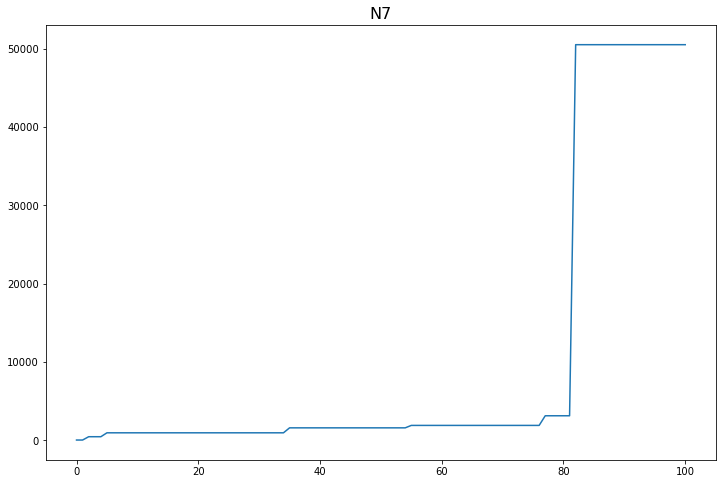

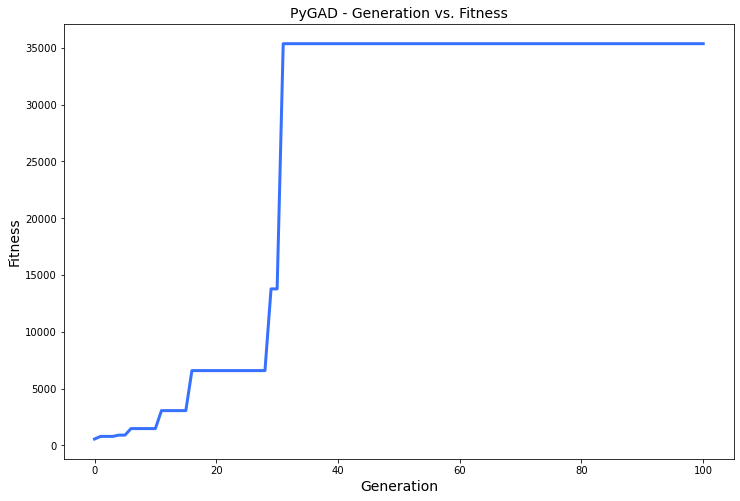

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.815 |==================| 18.169 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.817 |==================| 18.644 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.866 |==================| 224.481 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.85 |==================| 48.075 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 305.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 26.592 |==================| 38.207 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.541 |==================| 12.949 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.574 |==================| 22.511 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.575 |==================| 23.512 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 26.595 |==================| 44.421 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 26.59 |==================| 36.312 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.34 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 26.557 |==================| 16.323 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.236 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 26.604 |==================| 72.568 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.574 |==================| 22.936 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.546 |==================| 13.948 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.964 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 26.586 |==================| 31.512 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.553 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.556 |==================| 16.175 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 26.6 |==================| 56.946 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.578 |==================| 24.753 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 26.597 |==================| 47.829 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 26.55 |==================| 14.734 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.55 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.572 |==================| 21.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.569 |==================| 20.481 |==========| N6 |==========
**********************************************************************
=====

======| 0.448 |===========| 26.583 |==================| 28.989 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.549 |==================| 14.601 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.564 |==================| 18.455 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 26.589 |==================| 34.45 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.542 |==================| 13.089 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.561 |==================| 17.531 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.583 |==================| 28.989 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.549 |==================| 14.601 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.74 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.559 |==================| 16.831 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 300.749 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.542 |==================| 13.089 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.548 |==================| 14.365 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.566 |==================| 19.383 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.562 |==================| 17.909 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.218 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.558 |==================| 16.604 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.46 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.556 |==================| 16.113 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 26.617 |==================| 1512.306 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 26.614 |==================| 244.131 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.866 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.543 |==================| 13.33 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.569 |==================| 20.496 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.829 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.03 |==========| N6 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.572 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.565 |==================| 18.723 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 26.547 |==================| 14.137 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.584 |==================| 29.298 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.561 |==================| 17.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.829 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 26.609 |==================| 110.107 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 26.596 |==================| 44.738 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.544 |==================| 13.568 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.579 |==================| 25.746 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 26.594 |==================| 42.43 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.564 |==================| 18.535 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.573 |==================| 22.15 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 26.605 |==================| 77.223 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.547 |==================| 14.104 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 26.6 |==================| 55.166 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 26.572 |==================| 21.776 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 26.59 |==================| 36.35 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.007 |===========| 26.54 |==================| 12.8 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 26.606 |==================| 80.597 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 26.587 |==================| 32.348 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.543 |==================| 13.285 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.552 |==================| 15.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.576 |==================| 23.958 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.261 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 26.582 |==================| 27.66 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 26.602 |==================| 62.917 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.548 |==================| 14.395 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.686 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.552 |==================| 15.127 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 26.608 |==================| 95.905 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 26.613 |==================| 213.775 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 26.57 |==================| 21.024 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 26.591 |==================| 37.154 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 26.615 |==================| 361.118 |==========| N6 |==========
**********************************************************************
Fitness = 1512.306345274253
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 26.593 |==================| 39.422 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 26.581 |==================| 27.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 26.599 |==================| 54.098 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 26.566 |==================| 19.325 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.558 |==================| 16.645 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.565 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 26.563 |==================| 18.33 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 26.586 |==================| 31.611 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 26.615 |==================| 347.222 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 26.594 |==================| 41.376 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.568 |==================| 19.897 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.567 |==================| 19.769 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 26.607 |==================| 90.191 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 26.598 |==================| 50.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 26.586 |==================| 31.611 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 26.593 |==================| 40.123 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 26.59 |==================| 35.189 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.557 |==================| 16.453 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 26.612 |==================| 167.15 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.765 |==========| N6 |==========
**********************************************************************
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.312 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.559 |==================| 17.073 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 26.613 |==================| 209.342 |==========| N6 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 26.594 |==================| 42.01 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.252 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.301 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.183 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 26.603 |==================| 64.839 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.576 |==================| 23.929 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 26.599 |==================| 53.78 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 26.542 |==================| 13.201 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.55 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 26.597 |==================| 47.434 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 26.609 |==================| 106.333 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.832 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.957 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.006 |===========| 26.54 |==================| 12.817 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 26.587 |==================| 32.184 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.883 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 26.605 |==================| 77.927 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.552 |==================| 15.199 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 26.608 |==================| 101.056 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 26.589 |==================| 34.134 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.475 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 26.612 |==================| 178.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.69 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.565 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 26.61 |==================| 131.677 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 26.598 |==================| 50.419 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.562 |==================| 17.834 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 26.595 |==================| 44.491 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 200.461 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 26.586 |==================| 31.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 26.603 |==================| 65.916 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 26.604 |==================| 70.809 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.556 |==================| 16.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.261 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.142 |==========| N6 |==========
**********************************************************************
Fitness = 1512.306345274253
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.555 |==================| 15.809 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.555 |==================| 15.901 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.96 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 26.57 |==================| 20.701 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.556 |==================| 16.061 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.008 |===========| 26.54 |==================| 12.788 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 26.608 |==================| 100.849 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.582 |==================| 27.611 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.557 |==================| 16.449 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 26.587 |==================| 32.522 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.533 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 26.575 |==================| 23.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 26.595 |==================| 43.38 |==========| N6 |==========
**********************************************************************
=====

======| 0.482 |===========| 26.581 |==================| 26.929 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 26.616 |==================| 440.445 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 26.575 |==================| 23.289 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 26.591 |==================| 37.735 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.577 |==================| 24.559 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 26.613 |==================| 188.99 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 251.44 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.557 |==================| 16.335 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.582 |==================| 27.586 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.424 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 26.588 |==================| 33.235 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 26.601 |==================| 60.731 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.579 |==================| 25.618 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 26.594 |==================| 41.881 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 26.588 |==================| 33.362 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.844 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 26.601 |==================| 58.629 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 26.595 |==================| 44.093 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.576 |==================| 23.733 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 333.624 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 26.55 |==================| 14.738 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.064 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 26.589 |==================| 35.068 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.434 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 199.939 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.737 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 333.624 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.542 |==================| 13.141 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.381 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.086 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 26.565 |==================| 18.875 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 26.591 |==================| 37.419 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 26.615 |==================| 330.025 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 26.595 |==================| 43.926 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 26.544 |==================| 13.524 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.446 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.579 |==================| 25.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.568 |==================| 20.052 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.584 |==================| 29.65 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 26.597 |==================| 47.778 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.561 |==================| 17.641 |==========| N6 |==========
**********************************************************************
Fitness = 1512.306345274253
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.929 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.446 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.559 |==================| 16.881 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.561 |==================| 17.684 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.021 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 26.597 |==================| 47.297 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 26.549 |==================| 14.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.55 |==================| 14.67 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 26.554 |==================| 15.739 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 26.611 |==================| 149.487 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.568 |==================| 20.01 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 26.607 |==================| 94.859 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.593 |==================| 40.862 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.156 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.577 |==================| 24.662 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.822 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 26.597 |==================| 46.806 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.604 |==================| 74.305 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 26.616 |==================| 580.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.035 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 26.605 |==================| 78.312 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.552 |==================| 15.202 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 26.541 |==================| 13.025 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 26.608 |==================| 101.807 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 26.616 |==================| 440.461 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 26.587 |==================| 32.234 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.571 |==================| 21.188 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 26.569 |==================| 20.578 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.576 |==================| 23.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 26.602 |==================| 61.913 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.561 |==================| 17.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.571 |==================| 21.516 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.541 |==================| 13.05 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.576 |==================| 23.84 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 26.595 |==================| 43.789 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 26.588 |==================| 33.464 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 26.614 |==================| 257.618 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 26.571 |==================| 21.454 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 26.606 |==================| 85.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 26.557 |==================| 16.397 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 26.576 |==================| 23.778 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.832 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.769 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 26.569 |==================| 20.397 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 26.618 |==================| 4183.188 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.544 |==================| 13.506 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.578 |==================| 25.193 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.689 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 26.613 |==================| 195.515 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.584 |==================| 29.406 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 26.551 |==================| 14.989 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 26.607 |==================| 94.059 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 26.617 |==================| 1802.838 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 26.605 |==================| 77.7 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.998 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.609 |==================| 118.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 26.616 |==================| 616.571 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.561 |==================| 17.487 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.584 |==================| 29.198 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 26.542 |==================| 13.217 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.784 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.552 |==================| 15.281 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.56 |==================| 17.116 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 26.599 |==================| 52.715 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 26.603 |==================| 67.421 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 26.602 |==================| 63.373 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.26 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.555 |==================| 15.998 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 26.562 |==================| 17.791 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 26.608 |==================| 98.476 |==========| N6 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.582 |==================| 27.456 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.548 |==================| 14.391 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 26.61 |==================| 119.928 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.26 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.568 |==================| 19.89 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.722 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.568 |==================| 20.215 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.571 |==================| 21.115 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.52 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.565 |==================| 19.0 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.581 |==================| 27.332 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.568 |==================| 19.89 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.546 |==================| 13.996 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.569 |==================| 20.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 26.616 |==================| 585.649 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.52 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.548 |==================| 14.397 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 26.606 |==================| 87.359 |==========| N6 |==========
**********************************************************************
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.549 |==================| 14.404 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.717 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.56 |==================| 17.144 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 26.567 |==================| 19.522 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.558 |==================| 16.742 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 391.02 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.573 |==================| 22.364 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 26.584 |==================| 29.091 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.553 |==================| 15.42 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.229 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.584 |==================| 29.382 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.546 |==================| 13.992 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 26.563 |==================| 18.151 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.553 |==================| 15.444 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 26.575 |==================| 23.317 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 26.59 |==================| 36.239 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 26.604 |==================| 73.488 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 26.599 |==================| 53.98 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.572 |==================| 21.617 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.577 |==================| 24.221 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 26.609 |==================| 110.269 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 26.593 |==================| 39.757 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 26.602 |==================| 62.345 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 236.919 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 26.617 |==================| 1223.373 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 26.615 |==================| 406.44 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.56 |==================| 17.141 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 26.59 |==================| 36.431 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 26.574 |==================| 22.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.563 |==================| 18.353 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.184 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 26.61 |==================| 124.084 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.561 |==================| 17.643 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 250.494 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.614 |==================| 288.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.885 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 26.599 |==================| 53.054 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.228 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.569 |==================| 20.482 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 308.421 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 26.613 |==================| 208.93 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.168 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 26.614 |==================| 231.311 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.772 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.561 |==================| 17.536 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 26.592 |==================| 38.136 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 26.602 |==================| 60.962 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.584 |==================| 29.662 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.369 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 26.609 |==================| 116.623 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 26.612 |==================| 163.133 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.61 |==================| 118.952 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 26.596 |==================| 45.861 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.64 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 26.615 |==================| 328.16 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.556 |==================| 16.173 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.555 |==================| 15.963 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 26.566 |==================| 19.316 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 26.585 |==================| 30.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.548 |==================| 14.3 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.318 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 26.618 |==================| 10954.022 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 26.6 |==================| 55.953 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 26.573 |==================| 22.254 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 26.602 |==================| 62.814 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.523 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 26.589 |==================| 34.385 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.593 |==================| 40.873 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.581 |==================| 27.303 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 26.541 |==================| 13.003 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 26.61 |==================| 123.454 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.304 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.57 |==================| 20.785 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.291 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.574 |==================| 22.647 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.668 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.555 |==================| 15.952 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 26.616 |==================| 635.699 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 26.602 |==================| 61.905 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.581 |==================| 27.379 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.933 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.583 |==================| 28.681 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.602 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 26.601 |==================| 57.768 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 26.599 |==================| 51.968 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.583 |==================| 28.319 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 26.595 |==================| 44.361 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 26.588 |==================| 33.722 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.583 |==================| 28.681 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 401.553 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 26.568 |==================| 20.129 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 26.571 |==================| 21.281 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 26.585 |==================| 29.912 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 26.616 |==================| 571.829 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 26.596 |==================| 46.212 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.863 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.541 |==================| 12.948 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 26.611 |==================| 147.477 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.584 |==================| 29.27 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 26.598 |==================| 50.324 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 26.556 |==================| 16.155 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.614 |==================| 287.851 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.554 |==================| 15.617 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.393 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 26.593 |==================| 40.603 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 26.59 |==================| 36.031 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 26.55 |==================| 14.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 26.595 |==================| 44.524 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.126 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.559 |==================| 16.889 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 264.43 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.577 |==================| 24.456 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.543 |==================| 13.4 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.865 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.583 |==================| 28.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.559 |==================| 16.922 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 26.593 |==================| 39.413 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 26.609 |==================| 109.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 26.586 |==================| 31.743 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 26.585 |==================| 29.962 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.865 |==========| N6 |==========
**********************************************************************

======| 0.962 |===========| 26.543 |==================| 13.409 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.565 |==================| 18.744 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.582 |==================| 27.595 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 26.601 |==================| 58.366 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 26.597 |==================| 48.553 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.584 |==================| 29.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 26.59 |==================| 36.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 26.612 |==================| 160.73 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.568 |==================| 20.005 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.541 |==================| 13.061 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.559 |==================| 16.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.875 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 26.612 |==================| 163.15 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.55 |==================| 14.761 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 26.605 |==================| 78.925 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 336.33 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.567 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.549 |==================| 14.5 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 26.602 |==================| 61.91 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.577 |==================| 24.521 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 26.592 |==================| 38.252 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 26.616 |==================| 658.479 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.294 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 26.603 |==================| 67.266 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 26.563 |==================| 18.194 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.557 |==================| 16.351 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 26.616 |==================| 430.001 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 26.603 |==================| 69.221 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.56 |==================| 17.238 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.576 |==================| 23.818 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.554 |==================| 15.599 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.197 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.441 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.612 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 26.611 |==================| 146.607 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 26.587 |==================| 32.781 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 26.592 |==================| 39.303 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.564 |==================| 18.518 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.561 |==================| 17.519 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 26.564 |==================| 18.438 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 26.587 |==================| 31.858 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 26.589 |==================| 34.273 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.63 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 26.551 |==================| 14.974 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.549 |==================| 14.506 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.891 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 26.587 |==================| 32.097 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.451 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 26.593 |==================| 40.71 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.557 |==================| 16.525 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.677 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.932 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 26.591 |==================| 37.179 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 26.603 |==================| 66.463 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.451 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 26.548 |==================| 14.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 26.614 |==================| 260.993 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 26.597 |==================| 47.926 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.615 |==================| 291.319 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 26.601 |==================| 57.783 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.56 |==================| 17.356 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 26.568 |==================| 19.952 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.561 |==================| 17.482 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.579 |==================| 25.447 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 26.593 |==================| 39.724 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 26.614 |==================| 240.655 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.212 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 26.558 |==================| 16.676 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.19 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 26.607 |==================| 93.823 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.605 |==================| 74.686 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 26.574 |==================| 22.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 26.613 |==================| 206.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.549 |==================| 14.484 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.61 |==================| 119.025 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 26.605 |==================| 75.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 26.606 |==================| 84.365 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 26.586 |==================| 31.703 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 26.601 |==================| 59.314 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 26.611 |==================| 138.177 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 26.606 |==================| 83.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.568 |==================| 20.008 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.552 |==================| 15.257 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 26.614 |==================| 244.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.549 |==================| 14.558 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.565 |==================| 19.063 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.254 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 26.55 |==================| 14.767 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.559 |==================| 16.84 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 26.609 |==================| 112.201 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.577 |==================| 24.465 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 26.611 |==================| 135.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 26.561 |==================| 17.595 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.572 |==================| 21.597 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.553 |==================| 15.376 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.706 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 26.607 |==================| 91.286 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 26.608 |==================| 103.336 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.578 |==================| 24.869 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 26.609 |==================| 108.383 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 26.59 |==================| 35.686 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.567 |==================| 19.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.567 |==================| 19.731 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.542 |==================| 13.099 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 26.599 |==================| 53.838 |==========| N6 |==========
**********************************************************************
Fitness = 10954.021632024003
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.547 |==================| 14.088 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 26.563 |==================| 18.144 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 26.588 |==================| 33.179 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.668 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 26.616 |==================| 648.407 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 26.603 |==================| 66.259 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.699 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.995 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 453.241 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.561 |==================| 17.632 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.558 |==================| 16.738 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 272.695 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 26.606 |==================| 84.962 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 26.601 |==================| 57.699 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 26.565 |==================| 19.042 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.391 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.582 |==================| 27.735 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.56 |==================| 17.283 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.583 |==================| 28.619 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 306.884 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.315 |==========| N6 |==========
**********************************************************************
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 26.603 |==================| 68.26 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 26.593 |==================| 40.761 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.937 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 26.562 |==================| 17.992 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.56 |==================| 17.279 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 26.544 |==================| 13.581 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.574 |==================| 22.582 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.483 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 26.567 |==================| 19.512 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.579 |==================| 25.388 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.58 |==================| 26.425 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.528 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.044 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 26.599 |==================| 53.753 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.573 |==================| 22.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.71 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.397 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.298 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 26.572 |==================| 21.545 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.813 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.288 |==========| N6 |==========
**********************************************************************
==

======| 0.193 |===========| 26.603 |==================| 67.641 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 26.603 |==================| 67.239 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 26.59 |==================| 35.391 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.522 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 26.607 |==================| 90.408 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.619 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.03 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 26.593 |==================| 39.407 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 26.589 |==================| 34.889 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 26.598 |==================| 49.196 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.565 |==================| 19.057 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 26.609 |==================| 115.592 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 269.389 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.57 |==================| 20.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 26.593 |==================| 40.114 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 26.6 |==================| 55.265 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 26.617 |==================| 770.65 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 26.592 |==================| 39.012 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 26.597 |==================| 47.974 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.052 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 237.784 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.741 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.559 |==================| 17.055 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.432 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.573 |==================| 22.478 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.781 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 26.57 |==================| 20.77 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 237.784 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.583 |==================| 28.581 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.58 |==================| 26.02 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.56 |==================| 17.377 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.573 |==================| 22.478 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 26.6 |==================| 54.814 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 26.589 |==================| 34.891 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.58 |==================| 26.519 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 26.606 |==================| 84.521 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 26.565 |==================| 18.757 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 26.598 |==================| 50.467 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 26.59 |==================| 35.615 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.572 |==================| 21.951 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.577 |==================| 24.448 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 26.569 |==================| 20.325 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.498 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 26.615 |==================| 329.15 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.898 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.206 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.571 |==================| 21.487 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.542 |==================| 13.105 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 26.613 |==================| 186.055 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 26.602 |==================| 61.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.454 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 26.593 |==================| 39.453 |==========| N6 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.82 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 26.585 |==================| 30.362 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 26.591 |==================| 37.133 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.573 |==================| 22.351 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 26.544 |==================| 13.458 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.563 |==================| 18.089 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.731 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.62 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.545 |==================| 13.713 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 72.159 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 26.611 |==================| 146.919 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 26.57 |==================| 20.876 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.554 |==================| 15.615 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 24.972 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 26.571 |==================| 21.398 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.549 |==================| 14.508 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.793 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.615 |==================| 291.51 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 26.614 |==================| 235.151 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 26.618 |==================| 3671.601 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 26.613 |==================| 190.887 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 26.563 |==================| 18.326 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 26.57 |==================| 20.683 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 26.58 |==================| 26.095 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 26.602 |==================| 63.356 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 26.594 |==================| 41.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.695 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.551 |==================| 14.84 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.563 |==================| 18.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.563 |==================| 18.285 |==========| N6 |==========
**********************************************************************
Fitness = 10954.021632024003
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.6 |==================| 54.231 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.661 |==========| N6 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 26.608 |==================| 105.128 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.563 |==================| 18.28 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.581 |==================| 26.9 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 26.588 |==================| 32.985 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 26.571 |==================| 21.393 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 26.609 |==================| 111.548 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 26.585 |==================| 30.345 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 26.606 |==================| 83.285 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 26.597 |==================| 47.054 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 26.588 |==================| 33.252 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 26.593 |==================| 39.313 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.563 |==================| 18.126 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.583 |==================| 28.609 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.583 |==================| 28.602 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.554 |==================| 15.725 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.542 |==================| 13.091 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 26.548 |==================| 14.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 26.545 |==================| 13.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.566 |==================| 19.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.542 |==================| 13.104 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 26.598 |==================| 51.124 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 26.612 |==================| 173.382 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 26.551 |==================| 14.926 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 26.548 |==================| 14.302 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 26.554 |==================| 15.757 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.58 |==================| 26.347 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.56 |==================| 17.346 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 26.598 |==================| 51.124 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.46 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.942 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 26.6 |==================| 56.361 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.492 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.164 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.212 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.576 |==================| 23.946 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.46 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.321 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 26.612 |==================| 155.661 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.578 |==================| 24.864 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.554 |==================| 15.529 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.264 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 26.607 |==================| 95.666 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.564 |==================| 18.682 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 26.602 |==================| 61.755 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.753 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 26.595 |==================| 43.442 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.586 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.264 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.547 |==================| 14.154 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.846 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.56 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 26.574 |==================| 22.604 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.716 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.459 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 26.596 |==================| 45.215 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.559 |==================| 16.93 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.578 |==================| 24.945 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.572 |==================| 21.541 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.566 |==================| 19.192 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.716 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.546 |==================| 13.811 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 26.556 |==================| 16.189 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.558 |==================| 16.703 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.559 |==================| 17.048 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 26.591 |==================| 36.57 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 26.611 |==================| 150.262 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.566 |==================| 19.091 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.546 |==================| 13.811 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.945 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 335.694 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.942 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.551 |==================| 14.86 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.562 |==================| 17.734 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 26.592 |==================| 38.018 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 26.606 |==================| 82.265 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.561 |==================| 17.711 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.569 |==================| 20.415 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.558 |==================| 16.584 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.563 |==================| 18.343 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.562 |==================| 17.734 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 26.614 |==================| 242.44 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 26.617 |==================| 859.959 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 26.589 |==================| 34.956 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.569 |==================| 20.415 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.565 |==================| 18.981 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 26.614 |==================| 244.791 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 26.609 |==================| 115.803 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 26.573 |==================| 22.083 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 26.61 |==================| 130.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 26.595 |==================| 44.288 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 26.595 |==================| 44.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.551 |==================| 15.008 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 26.617 |==================| 1674.734 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.568 |==================| 20.029 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 26.57 |==================| 20.757 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 26.599 |==================| 52.994 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 26.608 |==================| 97.964 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.575 |==================| 23.119 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 26.606 |==================| 85.03 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.577 |==================| 24.721 |==========| N6 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.872 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 26.58 |==================| 26.085 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.572 |==================| 21.658 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.55 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.938 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 26.541 |==================| 13.026 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 26.546 |==================| 13.862 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 250.971 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 26.602 |==================| 63.787 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.223 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.572 |==================| 21.85 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.956 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 26.601 |==================| 60.77 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 26.566 |==================| 19.194 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 26.556 |==================| 16.096 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 26.589 |==================| 34.94 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.581 |==================| 26.927 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 26.597 |==================| 47.313 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.944 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.567 |==================| 19.708 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 26.571 |==================| 21.362 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.567 |==================| 19.752 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.562 |==================| 17.767 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 26.586 |==================| 30.945 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.562 |==================| 17.908 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.234 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.583 |==================| 28.397 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 26.591 |==================| 37.766 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.584 |==================| 29.527 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.604 |==========| N6 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 26.562 |==================| 17.99 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 26.604 |==================| 69.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.559 |==================| 16.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.579 |==================| 25.661 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 26.591 |==================| 37.33 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.802 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.76 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.568 |==================| 20.192 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 26.586 |==================| 31.619 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 26.61 |==================| 130.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 26.594 |==================| 41.285 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 26.604 |==================| 73.957 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.574 |==================| 22.668 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.545 |==================| 13.777 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 26.605 |==================| 75.293 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 26.59 |==================| 36.008 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 26.544 |==================| 13.462 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 26.612 |==================| 181.691 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 26.608 |==================| 100.475 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.579 |==================| 25.742 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.566 |==================| 19.097 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.594 |==================| 40.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.776 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.562 |==================| 17.765 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 26.543 |==================| 13.293 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.584 |==================| 29.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.581 |==================| 27.253 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.568 |==================| 20.2 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.434 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.657 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.544 |==================| 13.534 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 26.59 |==================| 35.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.543 |==================| 13.41 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.134 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.56 |==================| 17.19 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.543 |==================| 13.37 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.354 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.541 |==================| 13.053 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 26.608 |==================| 96.231 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 26.593 |==================| 39.913 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 26.598 |==================| 49.379 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 26.603 |==================| 66.867 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.565 |==================| 18.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.072 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 26.61 |==================| 122.862 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.553 |==================| 15.488 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.236 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 26.607 |==================| 92.131 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 26.558 |==================| 16.55 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 26.589 |==================| 34.151 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 421.847 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 26.604 |==================| 70.874 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.559 |==================| 16.848 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 26.608 |==================| 103.103 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.587 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.452 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 26.609 |==================| 115.89 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 26.608 |==================| 103.436 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 26.618 |==================| 2957.973 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.477 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 26.589 |==================| 34.971 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.03 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.565 |==================| 18.886 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 26.547 |==================| 14.116 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 26.589 |==================| 35.15 |==========| N6 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 142.018 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.616 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.549 |==================| 14.606 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.548 |==================| 14.254 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 26.542 |==================| 13.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 26.591 |==================| 37.633 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.581 |==================| 26.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 26.607 |==================| 89.5 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.556 |==================| 16.123 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.555 |==================| 15.772 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.574 |==================| 23.013 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 26.554 |==================| 15.573 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.551 |==================| 14.867 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.453 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.574 |==================| 22.712 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 26.601 |==================| 57.474 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.076 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 26.545 |==================| 13.642 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 26.592 |==================| 38.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.555 |==================| 15.86 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.55 |==================| 14.673 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.567 |==================| 19.459 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 26.583 |==================| 28.895 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 26.609 |==================| 109.272 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.52 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 26.594 |==================| 41.277 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 26.615 |==================| 319.37 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 26.607 |==================| 92.961 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 26.588 |==================| 33.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 26.597 |==================| 46.804 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.554 |==================| 15.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 26.565 |==================| 18.716 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 26.6 |==================| 56.944 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 26.608 |==================| 101.544 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.541 |==================| 13.044 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.599 |==================| 51.485 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.58 |==================| 26.479 |==========| N6 |==========
**********************************************************************
Fitness = 166913.48175715515
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.577 |==================| 24.552 |==========| N6 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 26.586 |==================| 31.301 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 26.58 |==================| 26.204 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 26.597 |==================| 46.888 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 26.567 |==================| 19.507 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 26.57 |==================| 20.85 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.553 |==================| 15.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.559 |==================| 16.888 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 26.595 |==================| 43.126 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 26.604 |==================| 69.377 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 26.57 |==================| 20.685 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 266.703 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.547 |==================| 14.059 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 26.584 |==================| 29.843 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 26.582 |==================| 27.491 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.576 |==================| 23.967 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 26.552 |==================| 15.106 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 26.606 |==================| 81.08 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.543 |==================| 13.312 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.578 |==================| 24.94 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.551 |==================| 14.89 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.722 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.567 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.835 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 26.618 |==================| 14088.906 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 26.573 |==================| 22.027 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 26.611 |==================| 140.746 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 26.597 |==================| 47.439 |==========| N6 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 26.599 |==================| 52.854 |==========| N6 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 313.897 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 26.613 |==================| 220.406 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 26.58 |==================| 26.352 |==========| N6 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.565 |==================| 18.886 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 26.554 |==================| 15.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 26.609 |==================| 117.063 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 26.6 |==================| 57.049 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.56 |==================| 17.319 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 26.613 |==================| 221.504 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 26.591 |==================| 37.756 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 377.787 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 26.55 |==================| 14.777 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 26.588 |==================| 32.876 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.574 |==================| 22.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 26.586 |==================| 31.212 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 26.603 |==================| 67.049 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.554 |==================| 15.622 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 26.556 |==================| 16.148 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.783 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 26.587 |==================| 32.123 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.566 |==================| 19.191 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.543 |==================| 13.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.544 |==================| 13.585 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.542 |==================| 13.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 26.58 |==================| 26.239 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 26.61 |==================| 122.503 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.541 |==================| 13.074 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.583 |==================| 28.432 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.44 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 26.562 |==================| 17.817 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.553 |==================| 15.403 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 26.591 |==================| 37.322 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 26.546 |==================| 13.895 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 26.601 |==================| 57.876 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.343 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 26.601 |==================| 59.479 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 26.586 |==================| 31.669 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 26.612 |==================| 171.216 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.912 |==========| N6 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 26.612 |==================| 160.317 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.565 |==================| 18.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 26.578 |==================| 25.125 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.6 |==================| 54.239 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 26.546 |==================| 13.881 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 26.59 |==================| 35.498 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 26.616 |==================| 587.282 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.655 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 26.616 |==================| 562.594 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 26.583 |==================| 28.262 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 26.56 |==================| 17.173 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.12 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 26.617 |==================| 1966.695 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 26.618 |==================| 6984.955 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.582 |==================| 27.447 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.578 |==========| N6 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 26.613 |==================| 217.972 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 26.612 |==================| 164.186 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 26.609 |==================| 105.954 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 26.61 |==================| 122.1 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 64.99 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 26.575 |==================| 23.273 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 26.546 |==================| 13.85 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.569 |==================| 20.417 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.463 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 26.612 |==================| 171.265 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.359 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.555 |==================| 15.991 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.56 |==================| 17.232 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.839 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 26.554 |==================| 15.683 |==========| N6 |==========
**********************************************************************
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.545 |==================| 13.708 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.543 |==================| 13.257 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 26.608 |==================| 104.699 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.599 |==================| 51.511 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.548 |==================| 14.248 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 26.607 |==================| 90.296 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 26.601 |==================| 59.326 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 26.604 |==================| 72.989 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.563 |==================| 18.314 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.583 |==================| 28.324 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 26.542 |==================| 13.231 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.563 |==================| 18.039 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.6 |==================| 54.325 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 26.599 |==================| 52.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.544 |==================| 13.61 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.546 |==================| 13.943 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.57 |==================| 20.721 |==========| N6 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.55 |==================| 14.712 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 141.697 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.541 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.56 |==================| 17.2 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 26.591 |==================| 37.074 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 26.592 |==================| 38.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 26.611 |==================| 134.447 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 26.551 |==================| 14.98 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 26.609 |==================| 112.339 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 248.651 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.553 |==================| 15.514 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 26.591 |==================| 37.074 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 26.605 |==================| 76.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.559 |==================| 17.076 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.577 |==================| 24.573 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.134 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.584 |==================| 29.265 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.571 |==================| 21.532 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 26.602 |==================| 62.853 |==========| N6 |==========
**********************************************************************
Fitness = 166913.48175715515
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.821 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.236 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 26.612 |==================| 183.339 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 26.554 |==================| 15.647 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 26.608 |==================| 101.993 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.581 |==================| 26.98 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 26.591 |==================| 37.118 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.48 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 26.593 |==================| 40.077 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.566 |==================| 19.352 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 26.587 |==================| 31.821 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.579 |==================| 25.522 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 26.587 |==================| 32.522 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 26.616 |==================| 523.17 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.518 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 26.589 |==================| 35.064 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 26.593 |==================| 40.519 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.052 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.555 |==================| 15.833 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 26.6 |==================| 55.495 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 26.606 |==================| 83.071 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.548 |==================| 14.291 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 26.61 |==================| 125.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.703 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.052 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 26.6 |==================| 56.869 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 26.587 |==================| 32.794 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.554 |==================| 15.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.548 |==================| 14.291 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.548 |==================| 14.37 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.562 |==================| 18.023 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 26.591 |==================| 36.447 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 26.59 |==================| 35.936 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 26.611 |==================| 134.769 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.559 |==================| 16.93 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 26.563 |==================| 18.336 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 26.602 |==================| 63.816 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.56 |==================| 17.303 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.847 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.582 |==================| 28.116 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.553 |==================| 15.33 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 26.574 |==================| 22.535 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 26.601 |==================| 59.311 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 26.598 |==================| 49.842 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.57 |==================| 20.741 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.581 |==================| 26.743 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 26.606 |==================| 80.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.495 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 26.599 |==================| 51.655 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 26.549 |==================| 14.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.547 |==================| 14.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.604 |==================| 74.298 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.548 |==================| 14.284 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.728 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 121.144 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.561 |==================| 17.709 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 26.587 |==================| 32.499 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 26.611 |==================| 138.545 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.743 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 26.597 |==================| 47.983 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 26.603 |==================| 65.448 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 26.613 |==================| 197.006 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.8 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 26.611 |==================| 153.852 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.459 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.578 |==================| 24.754 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 26.591 |==================| 37.513 |==========| N6 |==========
**********************************************************************
Fitness = 166913.48175715515
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 26.573 |==================| 22.279 |==========| N6 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.798 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 26.592 |==================| 38.097 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 26.604 |==================| 70.601 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 26.594 |==================| 42.459 |==========| N6 |==========
**********************************************************************
=

======| 0.302 |===========| 26.595 |==================| 43.027 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 26.598 |==================| 49.792 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.578 |==================| 24.803 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.558 |==================| 16.655 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 26.598 |==================| 50.795 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 26.614 |==================| 275.037 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 26.599 |==================| 53.218 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.547 |==================| 14.06 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 26.557 |==================| 16.278 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 26.6 |==================| 54.454 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 26.594 |==================| 41.013 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.555 |==================| 15.846 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.545 |==================| 13.801 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.561 |==================| 17.641 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 26.542 |==================| 13.2 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 26.592 |==================| 38.579 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.553 |==================| 15.395 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.778 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.565 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.543 |==================| 13.364 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.581 |==================| 26.981 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 26.568 |==================| 20.156 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.569 |==================| 20.427 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 26.585 |==================| 30.791 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 26.615 |==================| 401.047 |==========| N6 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 26.583 |==================| 28.808 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 26.586 |==================| 31.4 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 378.154 |==========| N6 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.574 |==================| 22.566 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.257 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.55 |==================| 14.826 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 26.587 |==================| 32.603 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.567 |==================| 19.473 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 26.55 |==================| 14.687 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 26.598 |==================| 50.188 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.541 |==================| 13.072 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.659 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.583 |==================| 28.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.555 |==================| 15.944 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.584 |==================| 29.246 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.557 |==================| 16.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.572 |==================| 21.625 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 26.566 |==================| 19.16 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 265.062 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.417 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.562 |==================| 18.032 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 26.607 |==================| 88.318 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 26.593 |==================| 39.887 |==========| N6 |==========
**********************************************************************


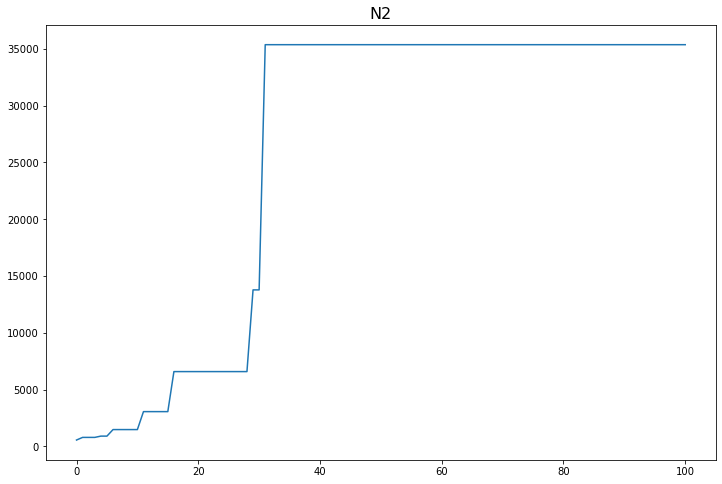

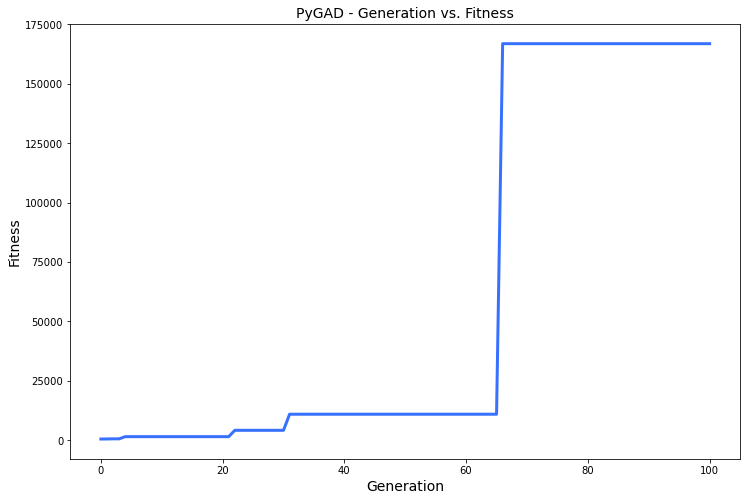

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 26.566 |==================| 19.16 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 265.062 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.554 |==================| 15.695 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.659 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.02 |==================| 15.273 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.064 |==================| 46.906 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.899 |==================| 5.388 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 26.962 |==================| 8.123 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.049 |==================| 27.385 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.081 |==================| 279.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.974 |==================| 8.976 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.131 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.04 |==================| 22.22 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 26.93 |==================| 6.459 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.591 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.903 |==================| 5.481 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 26.904 |==================| 5.536 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.069 |==================| 61.772 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.998 |==================| 11.522 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.019 |==================| 15.185 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 26.949 |==================| 7.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 26.984 |==================| 9.871 |==========| N3 |==========
**********************************************************************
Fitness = 279.57204643621094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.911 |==================| 5.735 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.96 |==================| 7.993 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.737 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.057 |==================| 35.23 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.893 |==================| 5.215 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 26.892 |==================| 5.184 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.917 |==================| 5.961 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.442 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.968 |==================| 8.572 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.006 |==================| 12.687 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.98 |==================| 9.496 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.911 |==================| 5.739 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.876 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 26.955 |==================| 7.693 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.203 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.649 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.983 |==================| 9.81 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.083 |==================| 608.108 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.935 |==================| 6.675 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.876 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.936 |==================| 6.726 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 26.897 |==================| 5.327 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 26.954 |==================| 7.631 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.971 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.984 |==================| 9.935 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.001 |==================| 11.91 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.933 |==================| 6.577 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.95 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.98 |==================| 9.54 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.013 |==================| 13.932 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.063 |==================| 45.347 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.055 |==================| 33.35 |==========| N3 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.332 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.066 |==================| 53.009 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 26.9 |==================| 5.399 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.98 |==================| 9.54 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.016 |==================| 14.53 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.924 |==================| 6.202 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.944 |==================| 7.073 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.332 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.91 |==================| 5.719 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.89 |==================| 5.138 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.918 |==================| 5.986 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.239 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.974 |==================| 9.016 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.022 |==================| 15.943 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.738 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.91 |==================| 5.719 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.979 |==================| 9.44 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.03 |==================| 18.123 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.985 |==================| 9.998 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.568 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.077 |==================| 130.16 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.312 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.963 |==================| 8.2 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.889 |==================| 5.1 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.036 |==================| 20.204 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.61 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 26.896 |==================| 5.282 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.076 |==================| 109.947 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 26.961 |==================| 8.048 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.05 |==================| 28.402 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.485 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.035 |==================| 20.166 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.034 |==================| 19.458 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.025 |==================| 16.748 |==========| N3 |==========
**********************************************************************
Fitness = 608.1079462051274
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.07 |==================| 65.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.039 |==================| 21.661 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.039 |==================| 21.498 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.989 |==================| 10.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.929 |==================| 6.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.034 |==================| 19.458 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.072 |==================| 76.602 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.945 |==================| 7.126 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.938 |==================| 6.784 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.974 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.457 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.009 |==================| 13.213 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.99 |==================| 10.499 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.127 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.019 |==================| 15.232 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.985 |==================| 10.006 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.057 |==================| 36.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.794 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.969 |==================| 8.656 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.913 |==================| 5.803 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.953 |==================| 7.592 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.177 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.011 |==================| 13.499 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.011 |==================| 13.485 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.033 |==================| 19.123 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.969 |==================| 8.656 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.98 |==================| 9.53 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.651 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.208 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.934 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.044 |==================| 24.553 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.004 |==================| 12.372 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.084 |==================| 785.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.966 |==================| 8.398 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.014 |==================| 14.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.921 |==================| 6.113 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.066 |==================| 53.958 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 26.931 |==================| 6.484 |==========| N3 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.963 |==================| 8.201 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.646 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.978 |==================| 9.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.953 |==================| 7.592 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.656 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.033 |==================| 19.21 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.013 |==================| 13.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.08 |==================| 202.324 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.925 |==================| 6.266 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.467 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.589 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.924 |==================| 6.217 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.904 |==================| 5.524 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.003 |==================| 12.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.426 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.939 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.085 |==================| 2497.66 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 26.976 |==================| 9.131 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.029 |==================| 17.785 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.94 |==================| 6.897 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.04 |==================| 22.002 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.036 |==================| 20.281 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.03 |==================| 18.261 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.992 |==================| 10.734 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.007 |==================| 12.806 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.88 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.946 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.078 |==================| 142.054 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.964 |==================| 8.281 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.958 |==================| 7.902 |==========| N3 |==========
**********************************************************************
Fitness = 2497.6598654464324
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.044 |==================| 24.213 |==========| N3 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.873 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.049 |==================| 27.752 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.013 |==================| 13.81 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.898 |==================| 5.356 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.996 |==================| 11.206 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 26.929 |==================| 6.397 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.012 |==================| 13.736 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.042 |==================| 23.186 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.954 |==================| 7.648 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.972 |==================| 8.836 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.932 |==================| 6.523 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.349 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.037 |==================| 20.941 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.915 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.369 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.951 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.874 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.067 |==================| 56.919 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.933 |==================| 6.58 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.025 |==================| 16.765 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.921 |==================| 6.09 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 26.891 |==================| 5.15 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.972 |==================| 8.81 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.874 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.072 |==================| 76.244 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.047 |==================| 25.993 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 26.95 |==================| 7.408 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.928 |==================| 6.38 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.891 |==================| 5.141 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.645 |==========| N3 |==========
**********************************************************************
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 26.912 |==================| 5.779 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 26.959 |==================| 7.949 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.006 |==================| 12.642 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.051 |==================| 29.793 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.064 |==================| 48.121 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 26.965 |==================| 8.35 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.416 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.915 |==================| 5.878 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.183 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.182 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.08 |==================| 193.042 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.956 |==================| 7.73 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.925 |==================| 6.255 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.918 |==================| 5.998 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 26.956 |==================| 7.744 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.026 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.047 |==================| 26.386 |==========| N3 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.034 |==================| 19.577 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.658 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.074 |==================| 91.385 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.854 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.04 |==================| 22.191 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.21 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.142 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.079 |==================| 179.946 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.978 |==================| 9.351 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.897 |==================| 5.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.491 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.04 |==================| 22.191 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.017 |==================| 14.715 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.948 |==================| 7.301 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.035 |==================| 19.97 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.025 |==================| 16.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.997 |==================| 11.364 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 26.975 |==================| 9.085 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.477 |==========| N3 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.987 |==================| 10.191 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.039 |==================| 21.76 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.894 |==================| 5.245 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.964 |==================| 8.282 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 307.851 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.034 |==================| 19.761 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.121 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.031 |==================| 18.496 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.034 |==================| 19.407 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.93 |==================| 6.454 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.018 |==================| 14.846 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.974 |==================| 9.014 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.036 |==================| 20.396 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.695 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.002 |==================| 11.977 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.912 |==================| 5.795 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 26.95 |==================| 7.406 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.991 |==================| 10.675 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.981 |==================| 9.595 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.977 |==================| 9.273 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.904 |==================| 5.526 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.053 |==================| 31.539 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 26.927 |==================| 6.344 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.077 |==================| 118.669 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.918 |==================| 5.998 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.072 |==================| 74.379 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.022 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.29 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.662 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.643 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 26.93 |==================| 6.471 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.917 |==================| 5.943 |==========| N3 |==========
**********************************************************************
Genera

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.922 |==================| 6.132 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.07 |==================| 68.142 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.009 |==================| 13.127 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.662 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.92 |==================| 6.052 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.461 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.615 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.847 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.08 |==================| 196.79 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.966 |==================| 8.407 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 7.0 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.91 |==================| 5.723 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.861 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.044 |==================| 24.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.013 |==================| 13.865 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.24 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.057 |==================| 35.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.066 |==================| 51.35 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 26.891 |==================| 5.146 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.919 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.938 |==================| 6.782 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.957 |==================| 7.832 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.047 |==================| 26.463 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.978 |==================| 9.379 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.012 |==================| 13.619 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.006 |==================| 12.715 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.019 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.909 |==================| 5.675 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.024 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.057 |==================| 35.719 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 26.905 |==================| 5.548 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 463.367 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.061 |==================| 40.835 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.536 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 26.941 |==================| 6.96 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.903 |==================| 5.486 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.585 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.023 |==================| 16.22 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.075 |==================| 95.661 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.861 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.061 |==================| 41.015 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.068 |==================| 58.102 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.925 |==================| 6.261 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.94 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.931 |==================| 6.497 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.984 |==================| 9.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.945 |==================| 7.122 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.915 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.198 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.919 |==================| 6.019 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.959 |==================| 7.934 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.083 |==================| 634.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.057 |==================| 35.333 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.896 |==================| 5.301 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.956 |==================| 7.773 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.923 |==================| 6.175 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.78 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.787 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.014 |==================| 14.055 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.893 |==================| 5.199 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 26.991 |==================| 10.607 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.068 |==================| 59.419 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.923 |==================| 6.175 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 26.926 |==================| 6.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.064 |==================| 46.563 |==========| N3 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.011 |==================| 13.505 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.078 |==================| 141.532 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.567 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.277 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.903 |==================| 5.499 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.004 |==================| 12.344 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.986 |==================| 10.115 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 26.956 |==================| 7.766 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.99 |==================| 10.544 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.906 |==================| 5.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.007 |==================| 12.843 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 26.983 |==================| 9.84 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 26.888 |==================| 5.074 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.009 |==================| 13.074 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.036 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.0 |==================| 11.798 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.906 |==================| 5.574 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.014 |==================| 14.135 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.935 |==================| 6.66 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 26.934 |==================| 6.602 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.95 |==================| 7.393 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.985 |==================| 9.951 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 472.774 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.915 |==================| 5.882 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.971 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.17 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.581 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 26.934 |==================| 6.641 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.935 |==================| 6.678 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.075 |==================| 95.115 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.04 |==================| 22.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.658 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.06 |==================| 40.528 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 26.893 |==================| 5.22 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.491 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.006 |==================| 12.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.037 |==================| 20.741 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 26.946 |==================| 7.205 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.082 |==================| 337.631 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.329 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.042 |==================| 23.338 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.19 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.963 |==================| 8.194 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 26.906 |==================| 5.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.664 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 26.979 |==================| 9.449 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.262 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.167 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.944 |==================| 7.072 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.032 |==================| 18.699 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.618 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.937 |==================| 6.765 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.926 |==================| 6.29 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.024 |==================| 16.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.985 |==================| 9.994 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.061 |==================| 42.068 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.048 |==================| 27.056 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.952 |==================| 7.533 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.992 |==================| 10.785 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.066 |==================| 51.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 26.94 |==================| 6.879 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.898 |==================| 5.359 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.918 |==================| 5.98 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.986 |==================| 10.072 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.946 |==================| 7.213 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.117 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 26.938 |==================| 6.803 |==========| N3 |==========
**********************************************************************
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.029 |==================| 17.948 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.925 |==================| 6.261 |==========| N3 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.18 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.988 |==================| 10.353 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.099 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.972 |==================| 8.873 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.068 |==================| 58.976 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.049 |==================| 27.842 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 26.888 |==================| 5.076 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.017 |==================| 14.761 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.648 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.959 |==================| 7.932 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.0 |==================| 11.819 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.035 |==================| 19.879 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.059 |==================| 37.751 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.889 |==================| 5.099 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.972 |==================| 8.885 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.648 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.976 |==================| 9.162 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.013 |==================| 13.805 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.983 |==================| 9.791 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.924 |==================| 6.194 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.03 |==================| 18.059 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.669 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.061 |==================| 41.561 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.035 |==================| 20.033 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.95 |==================| 7.387 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.911 |==================| 5.758 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.594 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 26.965 |==================| 8.346 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.004 |==================| 12.312 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.91 |==================| 5.727 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.968 |==================| 8.532 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.044 |==================| 24.6 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.329 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.061 |==================| 40.915 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.612 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.977 |==================| 9.222 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.011 |==================| 13.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.991 |==================| 10.676 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.966 |==================| 8.405 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 26.895 |==================| 5.273 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 26.922 |==================| 6.142 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 26.981 |==================| 9.635 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.97 |==================| 8.689 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.923 |==================| 6.17 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.991 |==================| 10.595 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.048 |==================| 26.91 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 26.926 |==================| 6.286 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.034 |==================| 19.531 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.0 |==================| 11.826 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.039 |==================| 21.925 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.618 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.985 |==================| 10.02 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.99 |==================| 10.468 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 26.922 |==================| 6.147 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.04 |==================| 22.154 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 26.969 |==================| 8.614 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.96 |==================| 8.017 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.96 |==================| 8.016 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.076 |==================| 107.086 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.064 |==================| 46.745 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.006 |==================| 12.704 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.373 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.05 |==================| 28.849 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 6.996 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.006 |==================| 12.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.968 |==================| 8.528 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.195 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.081 |==================| 263.247 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.075 |==================| 97.407 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.937 |==================| 6.772 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.929 |==================| 6.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.928 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.631 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.195 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.239 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 26.995 |==================| 11.144 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 26.979 |==================| 9.417 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.025 |==================| 16.704 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.049 |==================| 27.705 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.051 |==================| 29.346 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.167 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.024 |==================| 16.304 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.013 |==================| 13.83 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.057 |==================| 35.108 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.895 |==================| 5.274 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.049 |==================| 27.705 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.924 |==================| 6.229 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.707 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.998 |==================| 11.552 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.906 |==================| 5.598 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.054 |==================| 32.435 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.263 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.988 |==================| 10.301 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.052 |==================| 30.325 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 27.083 |==================| 419.201 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.893 |==================| 5.201 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.472 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.059 |==================| 39.165 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.962 |==================| 8.128 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.084 |==================| 654.786 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 27.083 |==================| 439.773 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.048 |==================| 27.003 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.012 |==================| 13.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.023 |==================| 16.233 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.964 |==================| 8.297 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.921 |==================| 6.097 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.617 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.908 |==================| 5.648 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.006 |==================| 12.729 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.04 |==================| 22.066 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 26.935 |==================| 6.65 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.902 |==================| 5.459 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.049 |==================| 27.801 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.617 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 26.919 |==================| 6.035 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 27.031 |==================| 18.443 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 26.93 |==================| 6.445 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.069 |==================| 61.258 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.901 |==================| 5.432 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.046 |==================| 25.608 |==========| N3 |==========
**********************************************************************
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.933 |==================| 6.578 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.901 |==================| 5.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.204 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.944 |==================| 7.078 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.056 |==================| 34.921 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 26.949 |==================| 7.329 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 26.975 |==================| 9.06 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.901 |==================| 5.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.204 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.94 |==================| 6.902 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 26.914 |==================| 5.854 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.61 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.23 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.944 |==================| 7.099 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.011 |==================| 13.426 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.014 |==================| 14.169 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.721 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 26.987 |==================| 10.169 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.98 |==================| 9.527 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.9 |==================| 5.419 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.991 |==================| 10.645 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.989 |==================| 10.378 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.901 |==================| 5.444 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.128 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.054 |==================| 32.533 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.847 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.916 |==================| 5.931 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.993 |==================| 10.85 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.989 |==================| 10.378 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.019 |==================| 15.253 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.945 |==================| 7.131 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.939 |==================| 6.843 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.94 |==================| 6.915 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.951 |==================| 7.464 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.901 |==================| 5.433 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 26.992 |==================| 10.765 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 26.902 |==================| 5.454 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.014 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.054 |==================| 32.188 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.935 |==================| 6.682 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.951 |==================| 7.464 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.052 |==================| 30.55 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 26.934 |==================| 6.629 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 26.94 |==================| 6.878 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 26.965 |==================| 8.365 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.023 |==================| 16.041 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.081 |==================| 273.047 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 26.929 |==================| 6.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.043 |==================| 23.955 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.084 |==================| 1470.272 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.946 |==================| 7.188 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.945 |==================| 7.117 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.972 |==================| 8.875 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 26.991 |==================| 10.631 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.016 |==================| 14.585 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.02 |==================| 15.441 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.083 |==================| 407.007 |==========| N3 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.856 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 26.922 |==================| 6.149 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 26.913 |==================| 5.817 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.933 |==================| 6.584 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.537 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.059 |==================| 37.903 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 26.95 |==================| 7.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.073 |==================| 85.284 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.877 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.045 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.011 |==================| 13.429 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 26.975 |==================| 9.109 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.005 |==================| 12.497 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.125 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.947 |==================| 7.246 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 26.913 |==================| 5.826 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.985 |==================| 9.955 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.012 |==================| 13.612 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.897 |==================| 5.313 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.905 |==================| 5.57 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.061 |==================| 41.845 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.034 |==================| 19.638 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.916 |==================| 5.899 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.985 |==================| 10.045 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.187 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.972 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.998 |==================| 11.509 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.061 |==================| 41.845 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.044 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.999 |==================| 11.571 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.936 |==================| 6.699 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 26.897 |==================| 5.315 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.064 |==================| 47.959 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.047 |==================| 26.613 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.95 |==================| 7.425 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.921 |==================| 6.11 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.91 |==================| 5.697 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.923 |==================| 6.161 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.077 |==================| 122.547 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.056 |==================| 34.51 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.074 |==================| 94.155 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.028 |==================| 17.51 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.034 |==================| 19.788 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.957 |==================| 7.836 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 26.997 |==================| 11.33 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.161 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.923 |==================| 6.163 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.075 |==================| 103.933 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.178 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.901 |==================| 5.423 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.957 |==================| 7.836 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.917 |==================| 5.951 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.984 |==================| 9.91 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.035 |==================| 20.104 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.979 |==================| 9.432 |==========| N3 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.936 |==================| 6.703 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.073 |==================| 83.543 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.659 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.917 |==================| 5.951 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.97 |==================| 8.728 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.286 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 26.959 |==================| 7.909 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 26.894 |==================| 5.231 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.079 |==================| 168.606 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.925 |==================| 6.26 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.976 |==================| 9.154 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.976 |==================| 9.138 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 26.953 |==================| 7.55 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.982 |==================| 9.706 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.007 |==================| 12.802 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.965 |==================| 8.304 |==========| N3 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.021 |==================| 15.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.223 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.391 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.004 |==================| 12.381 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.043 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.903 |==================| 5.48 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.027 |==================| 17.382 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.059 |==================| 37.879 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.01 |==================| 13.308 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.042 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.046 |==================| 25.667 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.083 |==================| 597.869 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.016 |==================| 14.406 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.081 |==================| 240.762 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.024 |==================| 16.283 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.906 |==================| 5.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.081 |==================| 267.559 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.005 |==================| 12.491 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.078 |==================| 134.503 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.045 |==================| 24.762 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.967 |==================| 8.463 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.053 |==================| 31.249 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.363 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.05 |==================| 28.224 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.971 |==================| 8.733 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.292 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.993 |==================| 10.812 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.966 |==================| 8.423 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.955 |==================| 7.682 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.897 |==================| 5.332 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.05 |==================| 28.832 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 7.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 26.931 |==================| 6.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.056 |==================| 34.856 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.075 |==================| 102.703 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.899 |==================| 5.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.055 |==================| 33.626 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.926 |==================| 6.294 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.0 |==================| 11.828 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.933 |==================| 6.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.899 |==================| 5.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.955 |==================| 7.676 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 26.995 |==================| 11.081 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.181 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.107 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.971 |==================| 8.736 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 26.933 |==================| 6.572 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.048 |==================| 26.851 |==========| N3 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.938 |==================| 6.818 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.0 |==================| 11.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.308 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.074 |==================| 93.782 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.076 |==================| 113.974 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.077 |==================| 127.621 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.048 |==================| 26.851 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.618 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.958 |==================| 7.898 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.954 |==================| 7.64 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.074 |==================| 93.782 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.085 |==================| 3722.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.936 |==================| 6.728 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.062 |==================| 42.851 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.059 |==================| 39.108 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.055 |==================| 33.023 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.007 |==================| 12.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.893 |==================| 5.217 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.045 |==================| 24.971 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.297 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.055 |==================| 33.475 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.956 |==================| 7.776 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.005 |==================| 12.455 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.052 |==================| 29.901 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.009 |==================| 13.121 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.968 |==================| 8.581 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.971 |==================| 8.79 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 26.945 |==================| 7.16 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 26.888 |==================| 5.075 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.918 |==================| 5.985 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.052 |==================| 29.901 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.013 |==================| 13.929 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.929 |==================| 6.412 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.063 |==================| 45.476 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.492 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.485 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.025 |==================| 16.601 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 26.899 |==================| 5.367 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.199 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.001 |==================| 11.968 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 304.88 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.068 |==================| 60.156 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.109 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.001 |==================| 11.875 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.075 |==================| 96.51 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 26.9 |==================| 5.402 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.08 |==================| 215.356 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 26.906 |==================| 5.59 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.171 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.015 |==================| 14.211 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.07 |==================| 66.546 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 26.943 |==================| 7.06 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.212 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.993 |==================| 10.868 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.99 |==================| 10.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.838 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.008 |==================| 13.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 26.89 |==================| 5.131 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.65 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.89 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.97 |==================| 8.719 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.049 |==================| 27.672 |==========| N3 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.937 |==================| 6.734 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.064 |==================| 47.598 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.763 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.028 |==================| 17.65 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.004 |==================| 12.379 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.266 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.923 |==================| 6.168 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.034 |==================| 19.503 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.935 |==================| 6.666 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.074 |==================| 90.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.9 |==================| 5.407 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.064 |==================| 47.155 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.916 |==================| 5.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.915 |==================| 5.883 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.9 |==================| 5.412 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.499 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.012 |==================| 13.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.026 |==========| N3 |==========
**********************************************************************
Fitnes

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.445 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.924 |==================| 6.208 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.719 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.046 |==================| 25.636 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.945 |==================| 7.14 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.009 |==================| 13.223 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.014 |==================| 14.049 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.998 |==================| 11.493 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 12.011 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.578 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.992 |==================| 10.742 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.897 |==================| 5.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.072 |==================| 78.153 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.978 |==================| 9.301 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.082 |==================| 335.316 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.003 |==================| 12.128 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 26.89 |==================| 5.137 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.95 |==================| 7.429 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.039 |==================| 21.708 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.019 |==================| 15.203 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.984 |==================| 9.865 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 26.965 |==================| 8.34 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.13 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 21.019 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.9 |==================| 5.413 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.091 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 26.992 |==================| 10.762 |==========| N3 |==========
**********************************************************************
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.031 |==================| 18.342 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.057 |==================| 35.468 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 26.999 |==================| 11.627 |==========| N3 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.012 |==================| 13.662 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.388 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 26.995 |==================| 11.14 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.932 |==================| 6.528 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.028 |==================| 17.617 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.023 |==================| 16.097 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.004 |==================| 12.412 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.301 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.984 |==================| 9.891 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.963 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.936 |==================| 6.688 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.925 |==================| 6.259 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.47 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.994 |==================| 11.021 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.01 |==================| 13.295 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.056 |==================| 34.12 |==========| N3 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.035 |==================| 20.023 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.079 |==================| 158.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.057 |==================| 35.932 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.983 |==================| 9.783 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.921 |==================| 6.087 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.99 |==================| 10.569 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.943 |==================| 7.018 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 26.906 |==================| 5.591 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.911 |==================| 5.754 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.904 |==================| 5.523 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 26.954 |==================| 7.621 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.479 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.89 |==================| 5.126 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.906 |==================| 5.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.932 |==================| 6.547 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.468 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.02 |==================| 15.483 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.576 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 304.592 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.06 |==================| 40.135 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 26.996 |==================| 11.278 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 26.93 |==================| 6.466 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.265 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.02 |==================| 15.483 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.97 |==================| 8.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.03 |==================| 18.25 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 26.899 |==================| 5.366 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.96 |==================| 7.992 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.926 |==================| 6.271 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.992 |==================| 10.781 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.888 |==================| 5.08 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.898 |==================| 5.35 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.9 |==================| 5.395 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.981 |==================| 9.617 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.995 |==================| 11.116 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.914 |==================| 5.841 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.756 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.985 |==================| 10.018 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.978 |==================| 9.349 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.009 |==================| 13.236 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.014 |==================| 14.003 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.887 |==================| 5.045 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.079 |==================| 164.993 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.997 |==================| 11.421 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 26.953 |==================| 7.599 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 26.989 |==================| 10.414 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 26.908 |==================| 5.639 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.971 |==================| 8.797 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.981 |==================| 9.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.027 |==================| 17.299 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.917 |==================| 5.967 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.152 |==========| N3 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.888 |==================| 5.088 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.246 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.665 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.012 |==================| 13.757 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.922 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.08 |==================| 202.943 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.954 |==================| 7.658 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.058 |==================| 36.539 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.901 |==================| 5.449 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.597 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.062 |==================| 43.865 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.99 |==================| 10.496 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.002 |==================| 12.079 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.978 |==================| 9.377 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 26.915 |==================| 5.869 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.901 |==================| 5.449 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.042 |==================| 23.125 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.963 |==================| 8.215 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.068 |==================| 59.903 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.907 |==================| 5.611 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.05 |==================| 28.566 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.007 |==================| 12.871 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.939 |==================| 6.843 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.331 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.94 |==================| 6.9 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.986 |==================| 10.048 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.072 |==================| 78.764 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.92 |==================| 6.051 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.005 |==================| 12.544 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.031 |==================| 18.645 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 26.926 |==================| 6.304 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.057 |==================| 35.134 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.046 |==================| 25.821 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.078 |==================| 149.79 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.044 |==================| 24.426 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.887 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.913 |==================| 5.813 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.049 |==================| 28.049 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.661 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.751 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 26.937 |==================| 6.743 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 26.911 |==================| 5.761 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.943 |==================| 7.051 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.954 |==================| 7.654 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.964 |==================| 8.291 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.207 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.995 |==================| 11.055 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.98 |==================| 9.553 |==========| N3 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.992 |==================| 10.708 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.034 |==================| 19.671 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 26.891 |==================| 5.156 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.902 |==================| 5.463 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.939 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.947 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.947 |==================| 7.225 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.212 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.013 |==================| 13.874 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.046 |==================| 25.596 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.997 |==================| 11.362 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.933 |==================| 6.583 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.232 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.535 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.013 |==================| 13.874 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.068 |==================| 57.229 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.937 |==================| 6.774 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.717 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.136 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.446 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 27.063 |==================| 44.725 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.013 |==================| 13.947 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.068 |==================| 57.229 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.991 |==================| 10.662 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.94 |==================| 6.909 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.078 |==================| 151.085 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.536 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.887 |==================| 5.053 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.053 |==================| 31.564 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.938 |==================| 6.786 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 26.945 |==================| 7.138 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.47 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 26.894 |==================| 5.224 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.961 |==================| 8.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.968 |==================| 8.541 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 26.965 |==================| 8.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.076 |==================| 107.239 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.907 |==================| 5.625 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.253 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.973 |==================| 8.907 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.977 |==================| 9.218 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.069 |==================| 61.343 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.981 |==================| 9.616 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 26.944 |==================| 7.11 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.046 |==================| 25.582 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.04 |==================| 22.374 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.078 |==================| 146.752 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.998 |==================| 11.535 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.239 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 26.996 |==================| 11.256 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.012 |==================| 13.756 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.048 |==================| 27.354 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.02 |==================| 15.333 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 26.93 |==================| 6.439 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 26.965 |==================| 8.336 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 26.907 |==================| 5.605 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.55 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.002 |==================| 11.983 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.904 |==================| 5.534 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.888 |==================| 5.087 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.957 |==================| 7.837 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.028 |==================| 17.559 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 26.956 |==================| 7.777 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 26.934 |==================| 6.624 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 26.887 |==================| 5.058 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.077 |==================| 128.269 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.009 |==================| 13.16 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.0 |==================| 11.771 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.934 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.985 |==================| 9.948 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 26.987 |==================| 10.15 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.92 |==================| 6.066 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.045 |==================| 25.134 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.066 |==================| 53.62 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.005 |==================| 12.505 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.049 |==================| 27.755 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.05 |==================| 28.689 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.079 |==================| 170.482 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 26.956 |==================| 7.753 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.037 |==================| 20.675 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.01 |==================| 13.304 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 12.007 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.927 |==================| 6.312 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 26.897 |==================| 5.316 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.048 |==================| 27.192 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.961 |==================| 8.044 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.981 |==================| 9.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 514.669 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 26.927 |==================| 6.315 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.618 |==========| N3 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.029 |==================| 17.743 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.078 |==================| 147.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.076 |==================| 110.133 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.925 |==================| 6.246 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.025 |==================| 16.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.633 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 26.974 |==================| 8.994 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.972 |==================| 8.863 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.893 |==================| 5.196 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.919 |==================| 6.014 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.948 |==================| 7.286 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.919 |==================| 6.017 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.034 |==================| 19.475 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.066 |==================| 51.581 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.896 |==================| 5.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.014 |==================| 13.985 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.061 |==================| 41.716 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.079 |==================| 167.432 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.98 |==================| 9.543 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.157 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.94 |==================| 6.896 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.908 |==================| 5.634 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.926 |==================| 6.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.974 |==================| 9.038 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.047 |==================| 26.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.054 |==================| 32.12 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.962 |==================| 8.109 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 26.915 |==================| 5.874 |==========| N3 |==========
**********************************************************************
Fitness = 179534.72126856906
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.494 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.029 |==================| 17.729 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.903 |==================| 5.495 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.484 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.055 |==================| 33.737 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.916 |==================| 5.931 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.053 |==================| 31.067 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.663 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.026 |==================| 16.919 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.037 |==================| 20.721 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.898 |==================| 5.338 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.06 |==================| 40.418 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 26.919 |==================| 6.026 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.98 |==================| 9.544 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.04 |==================| 22.026 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.923 |==================| 6.181 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.067 |==================| 56.74 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.944 |==================| 7.08 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.952 |==================| 7.516 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.073 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.628 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.053 |==================| 31.18 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.004 |==================| 12.388 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 26.965 |==================| 8.336 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.901 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.977 |==================| 9.229 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.024 |==================| 16.391 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.025 |==================| 16.567 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.945 |==================| 7.134 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.976 |==================| 9.142 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.905 |==================| 5.564 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.948 |==================| 7.275 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.954 |==================| 7.659 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.963 |==================| 8.166 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.938 |==================| 6.781 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.03 |==================| 18.141 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.987 |==================| 10.174 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.013 |==================| 13.914 |==========| N3 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.954 |==================| 7.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.031 |==================| 18.355 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.231 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.938 |==================| 6.781 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.904 |==================| 5.533 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 26.892 |==================| 5.185 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.17 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.078 |==================| 150.001 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 26.918 |==================| 5.995 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 26.968 |==================| 8.51 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.074 |==================| 89.109 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.596 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.026 |==================| 17.009 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.985 |==================| 10.033 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.286 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.915 |==================| 5.885 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.991 |==================| 10.658 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 300.88 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.022 |==================| 15.88 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 26.951 |==================| 7.48 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.858 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.009 |==================| 13.087 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.988 |==================| 10.353 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.916 |==================| 5.923 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.901 |==================| 5.437 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.023 |==================| 16.133 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.973 |==================| 8.914 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.077 |==================| 120.629 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.946 |==================| 7.218 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.038 |==================| 21.441 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.004 |==================| 12.299 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.052 |==================| 30.68 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.931 |==================| 6.495 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.988 |==================| 10.305 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.955 |==================| 7.673 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 26.912 |==================| 5.779 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 26.965 |==================| 8.36 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.892 |==================| 5.186 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.97 |==================| 8.66 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.124 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 6.997 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.944 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.372 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.078 |==================| 145.191 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.729 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 26.958 |==================| 7.864 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.036 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.937 |==================| 6.738 |==========| N3 |==========
**********************************************************************
====

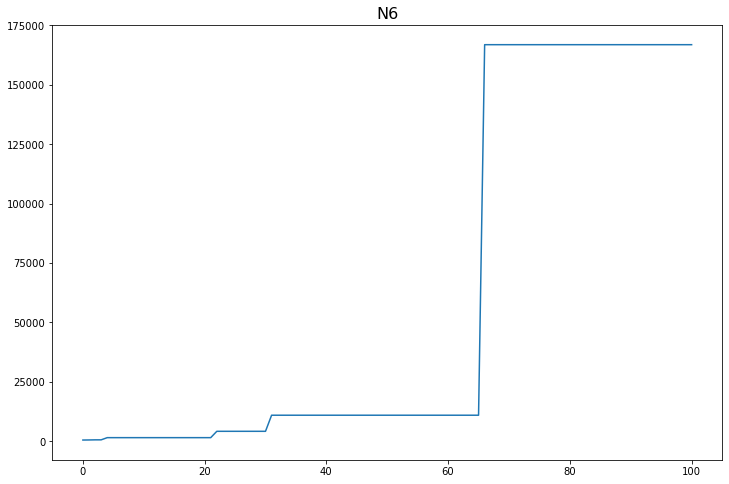

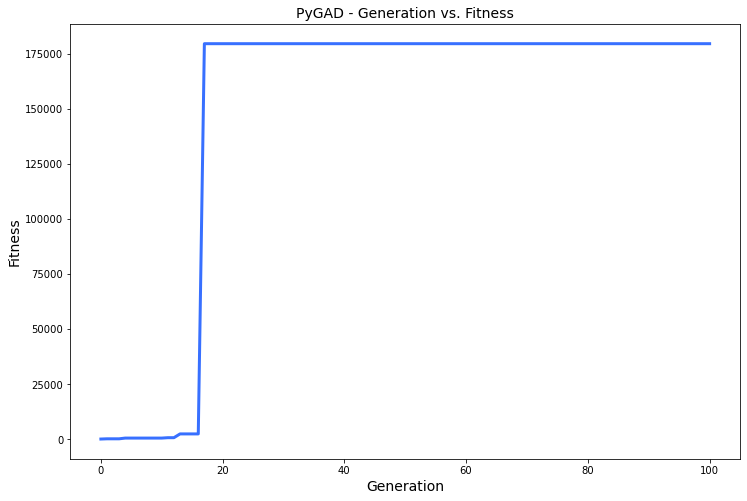

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 26.974 |==================| 9.001 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.729 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 26.958 |==================| 7.864 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.989 |==================| 5.874 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 25.043 |==================| 8.621 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 25.151 |==================| 125.425 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.46 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 25.145 |==================| 70.777 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.154 |==================| 185.511 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.155 |==================| 225.386 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.911 |==================| 4.029 |==========| N8 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.123 |==================| 27.216 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 25.107 |==================| 19.221 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.964 |==================| 5.127 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 25.123 |==================| 27.827 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.919 |==================| 4.168 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 25.091 |==================| 14.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.768 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.928 |==================| 4.319 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.94 |==================| 4.554 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.987 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 25.124 |==================| 28.359 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.297 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.898 |==================| 3.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 24.904 |==================| 3.911 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.577 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 25.139 |==================| 49.302 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 25.041 |==================| 8.43 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.897 |==================| 3.819 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.192 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.972 |==================| 5.341 |==========| N8 |==========
**********************************************************************
Fitness = 225.3862049594528
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.045 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 25.092 |==================| 14.961 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.89 |==================| 3.716 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.965 |==================| 5.145 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.9 |==================| 3.859 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.938 |==================| 4.526 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.925 |==================| 4.26 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 25.1 |==================| 16.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.962 |==================| 5.064 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.938 |==================| 4.524 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 25.113 |==================| 21.613 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 25.136 |==================| 42.12 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.909 |==================| 3.991 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.661 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 25.018 |==================| 7.082 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.992 |==================| 5.972 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 25.047 |==================| 8.911 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 25.077 |==================| 12.126 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 25.101 |==================| 17.281 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.924 |==================| 4.258 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.937 |==================| 4.504 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.907 |==================| 3.958 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.949 |==================| 4.757 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.924 |==================| 4.258 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 25.11 |==================| 20.332 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 25.064 |==================| 10.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 25.036 |==================| 8.099 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 25.075 |==================| 11.858 |==========| N8 |==========
**********************************************************************
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.266 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.901 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.262 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.947 |==================| 4.704 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.929 |==================| 4.35 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.999 |==================| 6.25 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 25.032 |==================| 7.872 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.886 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 25.107 |==================| 19.265 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 25.043 |==================| 8.61 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.919 |==================| 4.166 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.921 |==================| 4.192 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 25.118 |==================| 24.285 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 25.1 |==================| 16.919 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.917 |==================| 4.126 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 25.033 |==================| 7.926 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 25.066 |==================| 10.742 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.858 |==================| 3.316 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.626 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 25.051 |==================| 9.256 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 25.028 |==================| 7.618 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.885 |==================| 3.65 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.844 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 25.073 |==================| 11.577 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 25.042 |==================| 8.552 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.906 |==================| 3.952 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 25.089 |==================| 14.148 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.914 |==================| 4.081 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.987 |==================| 5.82 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 25.019 |==================| 7.143 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 25.05 |==================| 9.151 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.882 |==================| 3.607 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.964 |==================| 5.112 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.153 |==================| 163.557 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.892 |==================| 3.747 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.933 |==================| 4.422 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.925 |==================| 4.274 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.99 |==================| 5.916 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.382 |==========| N8 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.965 |==================| 5.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 25.117 |==================| 23.655 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 25.104 |==================| 18.167 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 25.09 |==================| 14.469 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 25.108 |==================| 19.399 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 25.087 |==================| 13.849 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 25.018 |==================| 7.068 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.917 |==================| 4.126 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 25.087 |==================| 13.79 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.96 |==================| 5.016 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.881 |==================| 3.588 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 25.157 |==================| 376.555 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.991 |==================| 5.945 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.159 |==================| 2351.377 |==========| N8 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.021 |==================| 7.208 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 25.141 |==================| 54.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 25.063 |==================| 10.424 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.891 |==================| 3.732 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 25.026 |==================| 7.519 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 25.059 |==================| 9.938 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.873 |==================| 3.497 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.992 |==================| 5.98 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.97 |==================| 5.27 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.888 |==================| 3.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.915 |==================| 4.101 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.892 |==================| 3.739 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.889 |==================| 3.7 |==========| N8 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.952 |==================| 4.819 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 25.052 |==================| 9.366 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.914 |==================| 4.083 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.154 |==================| 180.542 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.999 |==================| 6.245 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 25.063 |==================| 10.433 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 25.004 |==================| 6.422 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 25.154 |==================| 191.11 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.35 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 25.132 |==================| 36.904 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 25.105 |==================| 18.439 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.885 |==================| 3.646 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 25.136 |==================| 43.878 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.191 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 25.045 |==================| 8.716 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 25.057 |==================| 9.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 25.128 |==================| 31.659 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.909 |==================| 3.999 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.981 |==================| 5.608 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.137 |==================| 45.908 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.197 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.981 |==================| 5.61 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.943 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.874 |==================| 3.504 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 25.01 |==================| 6.693 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 25.079 |==================| 12.506 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 25.139 |==================| 48.811 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.036 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.931 |==================| 4.388 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 25.034 |==================| 7.953 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 25.019 |==================| 7.153 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 25.071 |==================| 11.309 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.203 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.296 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.921 |==================| 4.198 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 25.126 |==================| 29.731 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.969 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 25.107 |==================| 19.19 |==========| N8 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 25.011 |==================| 6.757 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.995 |==================| 6.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.946 |==================| 4.697 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.899 |==================| 3.839 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 25.087 |==================| 13.776 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.972 |==================| 5.352 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 25.151 |==================| 124.218 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.857 |==================| 3.312 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.074 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1007.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.93 |==================| 4.358 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.925 |==================| 4.264 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 25.048 |==================| 8.996 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 25.054 |==================| 9.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.891 |==================| 3.733 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 25.01 |==================| 6.706 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.437 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 25.057 |==================| 9.817 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 25.003 |==================| 6.393 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 25.04 |==================| 8.378 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.016 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 25.1 |==================| 16.798 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 25.119 |==================| 24.606 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.906 |==================| 3.953 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.864 |==================| 3.382 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 25.033 |==================| 7.893 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 25.041 |==================| 8.441 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.016 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.9 |==================| 3.853 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.078 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 25.09 |==================| 14.357 |==========| N8 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.935 |==================| 4.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 25.103 |==================| 17.752 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 25.062 |==================| 10.262 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 25.086 |==================| 13.625 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.87 |==================| 3.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.127 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.446 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.616 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.865 |==================| 3.401 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.122 |==================| 27.057 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.975 |==================| 5.422 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 25.075 |==================| 11.829 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.993 |==================| 6.007 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 25.028 |==================| 7.636 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.937 |==================| 4.492 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.983 |==================| 5.668 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.913 |==================| 4.053 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.619 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.972 |==================| 5.352 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.887 |==================| 3.679 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 25.089 |==================| 14.175 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 25.087 |==================| 13.822 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.997 |==================| 6.175 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 25.063 |==================| 10.439 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.972 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.153 |==================| 171.079 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 25.062 |==================| 10.245 |==========| N8 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.923 |==================| 4.234 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.134 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.042 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.995 |==================| 6.083 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.945 |==========| N8 |==========
**********************************************************************
Fitness = 4955.668579409157
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.909 |==================| 3.998 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.94 |==================| 4.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 25.039 |==================| 8.334 |==========| N8 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.022 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 25.112 |==================| 21.283 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.952 |==================| 4.819 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.858 |==================| 3.314 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 19.002 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 25.055 |==================| 9.594 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.924 |==================| 4.243 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.967 |==================| 5.206 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.943 |==================| 4.622 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 25.001 |==================| 6.331 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.927 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.886 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 25.027 |==================| 7.565 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.9 |==================| 3.863 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.947 |==================| 4.703 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 25.112 |==================| 21.114 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 25.064 |==================| 10.522 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.87 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 25.109 |==================| 19.853 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 25.035 |==================| 8.053 |==========| N8 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 25.106 |==================| 18.631 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.949 |==================| 4.747 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.896 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.87 |==================| 3.46 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.213 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 25.111 |==================| 20.917 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 25.086 |==================| 13.623 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.984 |==================| 5.695 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 25.134 |==================| 39.872 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.949 |==================| 4.758 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.886 |==================| 3.655 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.946 |==================| 4.682 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.445 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.149 |==================| 99.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 25.128 |==================| 32.275 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.143 |==================| 63.219 |==========| N8 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.374 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 25.12 |==================| 25.663 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.087 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.903 |==================| 3.906 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.955 |==================| 4.906 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 25.008 |==================| 6.602 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 25.084 |==================| 13.344 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 25.051 |==================| 9.213 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.661 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.937 |==================| 4.507 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.895 |==================| 3.785 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.996 |==================| 6.123 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 25.06 |==================| 10.029 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 25.002 |==================| 6.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.756 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.997 |==================| 6.182 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 25.027 |==================| 7.573 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 25.027 |==================| 7.589 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 25.055 |==================| 9.561 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 25.095 |==================| 15.547 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.919 |==================| 4.163 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 24.854 |==================| 3.279 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 25.104 |==================| 17.949 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.994 |==================| 6.066 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.985 |==================| 5.743 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.937 |==================| 4.505 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.154 |==================| 182.709 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 25.019 |==================| 7.109 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 25.037 |==================| 8.174 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.586 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.89 |==================| 3.718 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 25.12 |==================| 25.239 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.723 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.973 |==================| 5.382 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.665 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.755 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.866 |==================| 3.408 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 25.147 |==================| 83.244 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 25.003 |==================| 6.415 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.988 |==================| 5.824 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.579 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 25.0 |==================| 6.284 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.928 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.882 |==================| 3.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.919 |==================| 4.165 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.865 |==================| 3.394 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.965 |==================| 5.145 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.013 |==================| 6.815 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 25.074 |==================| 11.728 |==========| N8 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.095 |==================| 15.629 |==========| N8 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 25.021 |==================| 7.25 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.941 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 25.088 |==================| 14.021 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 25.159 |==================| 2177.428 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 25.134 |==================| 38.989 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.897 |==================| 3.816 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.876 |==================| 3.532 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 25.061 |==================| 10.225 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.429 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 25.048 |==================| 9.021 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.918 |==================| 4.139 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 25.025 |==================| 7.475 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 25.029 |==================| 7.666 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 25.029 |==================| 7.657 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.977 |==================| 5.489 |==========| N8 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 24.853 |==================| 3.27 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.95 |==================| 4.781 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.993 |==================| 6.032 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.948 |==================| 4.74 |==========| N8 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.961 |==================| 5.053 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 25.06 |==================| 10.102 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 25.029 |==================| 7.687 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.976 |==================| 5.468 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 25.023 |==================| 7.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.867 |==================| 3.424 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 25.132 |==================| 36.47 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.876 |==================| 3.528 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 25.136 |==================| 42.549 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 25.1 |==================| 16.955 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.957 |==================| 4.94 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 25.076 |==================| 12.057 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 25.04 |==================| 8.36 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 25.051 |==================| 9.214 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 25.074 |==================| 11.673 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.951 |==================| 4.807 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.159 |==================| 4131.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 25.018 |==================| 7.076 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.898 |==================| 3.829 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.192 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.901 |==================| 3.871 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 25.125 |==================| 29.074 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.988 |==================| 5.854 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 25.091 |==================| 14.713 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.92 |==================| 4.182 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 25.043 |==================| 8.637 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.979 |==================| 5.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.864 |==================| 3.39 |==========| N8 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.874 |==================| 3.512 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.92 |==================| 4.184 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.863 |==================| 3.379 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 25.073 |==================| 11.598 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.994 |==================| 6.039 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 25.153 |==================| 156.577 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 25.123 |==================| 27.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.921 |==================| 4.192 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.855 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 25.136 |==================| 42.393 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.905 |==================| 3.933 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.99 |==================| 5.908 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.965 |==================| 5.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 25.095 |==================| 15.609 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.302 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 25.064 |==================| 10.542 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 25.064 |==================| 10.529 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 25.001 |==================| 6.328 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 25.118 |==================| 24.347 |==========| N8 |==========
**********************************************************************
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.988 |==================| 5.841 |==========| N8 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 25.083 |==================| 13.043 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 25.042 |==================| 8.558 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.919 |==================| 4.155 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.158 |==================| 606.694 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 25.013 |==================| 6.849 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.126 |==================| 29.655 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.983 |==================| 5.662 |==========| N8 |==========
**********************************************************************
====

======| 0.774 |===========| 24.923 |==================| 4.237 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.894 |==================| 3.764 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.62 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.877 |==================| 3.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.151 |==================| 115.608 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.869 |==================| 3.449 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 25.124 |==================| 28.743 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 25.121 |==================| 26.073 |==========| N8 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 25.024 |==================| 7.401 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 25.1 |==================| 16.857 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.061 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 25.123 |==================| 27.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 25.111 |==================| 20.943 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.924 |==================| 4.244 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.888 |==================| 3.684 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.947 |==================| 4.715 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.912 |==================| 4.052 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 25.048 |==================| 9.007 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.58 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 25.136 |==================| 42.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.894 |==================| 3.774 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.866 |==================| 3.41 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.147 |==================| 84.25 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.995 |==================| 6.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 25.098 |==================| 16.408 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 25.136 |==================| 43.153 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 25.036 |==================| 8.098 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 25.064 |==================| 10.518 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 25.064 |==================| 10.476 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 25.138 |==================| 46.704 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.9 |==================| 3.858 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.929 |==================| 4.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 25.126 |==================| 29.835 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 25.146 |==================| 78.156 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.921 |==================| 4.189 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.869 |==================| 3.445 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.985 |==================| 5.742 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.994 |==================| 6.036 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.999 |==================| 6.243 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.514 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 24.964 |==================| 5.117 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.769 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 25.112 |==================| 21.132 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.121 |==================| 25.812 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.9 |==================| 3.858 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.006 |==================| 6.507 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.859 |==================| 3.333 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.93 |==================| 4.365 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.856 |==================| 3.299 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.891 |==================| 3.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 25.133 |==================| 37.802 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.981 |==================| 5.599 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 25.052 |==================| 9.321 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.874 |==================| 3.502 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 25.075 |==================| 11.936 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.507 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.862 |==================| 3.36 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.9 |==================| 3.863 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 25.1 |==================| 16.802 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.825 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 25.024 |==================| 7.418 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.622 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.189 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 25.075 |==================| 11.896 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 25.084 |==================| 13.359 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.933 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 25.089 |==================| 14.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.88 |==================| 3.577 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 25.084 |==================| 13.256 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 25.045 |==================| 8.739 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.195 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.566 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.899 |==========| N8 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 25.024 |==================| 7.417 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.536 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.934 |==================| 4.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 25.072 |==================| 11.482 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.149 |==================| 101.06 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 24.873 |==================| 3.493 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.873 |==================| 3.498 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.93 |==================| 4.359 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 25.111 |==================| 20.905 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.893 |==================| 3.75 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 25.014 |==================| 6.883 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.884 |==================| 3.639 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.994 |==================| 6.044 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.157 |==================| 469.083 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 18.986 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 25.035 |==================| 8.021 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 25.035 |==================| 8.039 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.875 |==================| 3.521 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 25.015 |==================| 6.934 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 25.107 |==================| 19.222 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.92 |==================| 4.187 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.942 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.929 |==================| 4.341 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.153 |==================| 173.819 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.957 |==================| 4.936 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.859 |==================| 3.336 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 25.088 |==================| 14.096 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.925 |==================| 4.262 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 25.151 |==================| 122.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.197 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 25.093 |==================| 15.13 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 25.064 |==================| 10.484 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.01 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.985 |==================| 5.739 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.992 |==================| 5.976 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.91 |==================| 4.009 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 25.06 |==================| 10.048 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.14 |==================| 52.81 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.972 |==================| 5.347 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 25.051 |==================| 9.23 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 25.05 |==================| 9.127 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 25.042 |==================| 8.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.961 |==================| 5.038 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 25.085 |==================| 13.525 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.884 |==================| 3.628 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 25.125 |==================| 29.231 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.489 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.892 |==================| 3.74 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.901 |==================| 3.875 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.937 |==================| 4.505 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 25.036 |==================| 8.099 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 25.017 |==================| 7.006 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.976 |==================| 5.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.074 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.998 |==================| 6.185 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.065 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 25.073 |==================| 11.609 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.128 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.771 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.931 |==================| 4.382 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.916 |==================| 4.104 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.745 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.144 |==================| 65.317 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.859 |==================| 3.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 25.12 |==================| 25.671 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 25.029 |==================| 7.686 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 25.096 |==================| 15.901 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.958 |==================| 4.97 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.901 |==================| 3.875 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.428 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.491 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 25.021 |==================| 7.222 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.457 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.989 |==================| 5.86 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.841 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.916 |==================| 4.108 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.866 |==================| 3.405 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.88 |==================| 3.576 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 25.083 |==================| 13.061 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.971 |==================| 5.3 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.979 |==================| 5.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 25.115 |==================| 22.526 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 25.034 |==================| 8.006 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.954 |==================| 4.86 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 25.063 |==================| 10.356 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.871 |==================| 3.468 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.156 |==================| 312.684 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.69 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.157 |==================| 533.429 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.802 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 25.042 |==================| 8.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.87 |==================| 3.457 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.905 |==================| 3.935 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 25.073 |==================| 11.552 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.881 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.146 |==================| 77.099 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.399 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 25.055 |==================| 9.632 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.858 |==================| 3.32 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.986 |==================| 5.758 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.88 |==================| 3.575 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.489 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 25.153 |==================| 155.897 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 25.059 |==================| 10.025 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 25.012 |==================| 6.804 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 25.05 |==================| 9.176 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.978 |==================| 5.503 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 25.074 |==================| 11.755 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.908 |==================| 3.983 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 25.008 |==================| 6.611 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 25.118 |==================| 24.39 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.969 |==================| 5.254 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 25.018 |==================| 7.069 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.949 |==================| 4.746 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 25.108 |==================| 19.69 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 25.052 |==================| 9.309 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 25.141 |==================| 54.278 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 25.019 |==================| 7.115 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 25.025 |==================| 7.432 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.928 |==================| 4.322 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.971 |==================| 5.319 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.964 |==================| 5.132 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.875 |==================| 3.523 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 25.009 |==================| 6.65 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.131 |==================| 34.842 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 25.081 |==================| 12.842 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 25.037 |==================| 8.166 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 25.124 |==================| 28.413 |==========| N8 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.994 |==================| 6.069 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.632 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.997 |==================| 6.173 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.859 |==================| 3.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.867 |==================| 3.417 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 25.031 |==================| 7.798 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 25.024 |==================| 7.396 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.489 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 25.021 |==================| 7.224 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.567 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.725 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 25.098 |==================| 16.377 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.138 |==================| 46.128 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.041 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.961 |==================| 5.034 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.923 |==================| 4.241 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 25.089 |==================| 14.313 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 25.1 |==================| 16.968 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 25.063 |==================| 10.423 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.752 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 25.089 |==================| 14.223 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.919 |==================| 4.16 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 25.067 |==================| 10.827 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.991 |==================| 5.938 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 25.016 |==================| 6.986 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.976 |==================| 5.451 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1230.89 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 25.131 |==================| 35.614 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.895 |==================| 3.78 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 25.109 |==================| 20.009 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.92 |==================| 4.173 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.858 |==================| 3.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.97 |==================| 5.289 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.71 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.909 |==================| 3.999 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 25.136 |==================| 42.263 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 25.045 |==================| 8.783 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.223 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.935 |==================| 4.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 25.111 |==================| 20.725 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 25.041 |==================| 8.439 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.939 |==================| 4.541 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.193 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 25.13 |==================| 34.314 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.856 |==================| 3.294 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 25.089 |==================| 14.203 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.984 |==================| 5.691 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 25.034 |==================| 8.013 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.982 |==================| 5.628 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 25.014 |==================| 6.873 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 25.011 |==================| 6.757 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.856 |==================| 3.294 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.407 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 25.093 |==================| 15.042 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 25.058 |==================| 9.85 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.957 |==================| 4.954 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.883 |==================| 3.619 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.865 |==================| 3.397 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.459 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.488 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.122 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.774 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 25.006 |==================| 6.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.932 |==================| 4.401 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 25.103 |==================| 17.81 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.622 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 25.026 |==================| 7.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.138 |==================| 46.273 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.434 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.981 |==================| 5.619 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 25.108 |==================| 19.599 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.157 |==================| 493.353 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.898 |==================| 3.825 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 25.138 |==================| 47.632 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.855 |==================| 3.284 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.924 |==================| 4.25 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 25.042 |==================| 8.498 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.154 |==================| 175.361 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.326 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.158 |==================| 661.79 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.936 |==================| 4.478 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.896 |==================| 3.793 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.689 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.933 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 25.015 |==================| 6.954 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 25.154 |==================| 204.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.887 |==================| 3.675 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 25.137 |==================| 45.597 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.327 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 25.05 |==================| 9.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 25.098 |==================| 16.296 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 25.124 |==================| 28.116 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 25.052 |==================| 9.287 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.619 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 25.097 |==================| 16.181 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 24.882 |==================| 3.607 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.193 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.445 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 25.128 |==================| 32.157 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.15 |==================| 111.394 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.138 |==================| 46.116 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.976 |==================| 5.446 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.01 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.952 |==================| 4.814 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 25.08 |==================| 12.668 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 25.087 |==================| 13.809 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.92 |==================| 4.175 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.046 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 25.06 |==================| 10.099 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.375 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 25.046 |==================| 8.797 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.927 |==================| 4.301 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.774 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 25.071 |==================| 11.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 25.147 |==================| 78.812 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 25.055 |==================| 9.611 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 25.04 |==================| 8.402 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.99 |==================| 5.896 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 25.096 |==================| 15.885 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.921 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.923 |==================| 4.225 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 25.088 |==================| 13.951 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.993 |==================| 6.026 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.96 |==================| 5.012 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 25.029 |==================| 7.664 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.866 |==================| 3.405 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.475 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.937 |==================| 4.493 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.98 |==================| 5.587 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.66 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 25.054 |==================| 9.489 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.959 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.891 |==================| 3.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.985 |==================| 5.737 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 25.028 |==================| 7.633 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 25.086 |==================| 13.641 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 25.157 |==================| 435.086 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.927 |==================| 4.299 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.959 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.948 |==================| 4.733 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.881 |==================| 3.597 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.122 |==================| 27.169 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.915 |==================| 4.096 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 25.07 |==================| 11.243 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 25.061 |==================| 10.134 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 25.056 |==================| 9.642 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.879 |==================| 3.572 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 25.093 |==================| 15.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.143 |==================| 60.466 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.919 |==================| 4.169 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.149 |==================| 96.363 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 25.033 |==================| 7.934 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.213 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.959 |==================| 5.0 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 25.004 |==================| 6.422 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.894 |==================| 3.765 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.771 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 25.085 |==================| 13.484 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.993 |==================| 6.007 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 25.128 |==================| 32.183 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.869 |==================| 3.448 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 25.007 |==================| 6.568 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.936 |==================| 4.481 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.951 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.78 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 25.093 |==================| 15.035 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.919 |==================| 4.162 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.96 |==================| 5.012 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.865 |==================| 3.398 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.983 |==================| 5.663 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.148 |==================| 92.941 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 24.872 |==================| 3.482 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 25.064 |==================| 10.462 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.957 |==================| 4.939 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 25.01 |==================| 6.695 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 25.095 |==================| 15.473 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.78 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.897 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.073 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.956 |==================| 4.918 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.872 |==================| 3.487 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.795 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 25.068 |==================| 10.997 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 25.141 |==================| 53.519 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 25.022 |==================| 7.296 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 25.152 |==================| 132.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 38.042 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 25.115 |==================| 22.381 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.899 |==================| 3.841 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 25.146 |==================| 75.69 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.977 |==================| 5.492 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.86 |==================| 3.346 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 25.111 |==================| 20.524 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.927 |==================| 4.313 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 25.097 |==================| 16.025 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 25.135 |==================| 41.574 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.93 |==================| 4.355 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.982 |==================| 5.639 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.795 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.957 |==================| 4.932 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.867 |==================| 3.418 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.995 |==================| 6.07 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.867 |==================| 3.423 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 25.03 |==================| 7.736 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 25.011 |==================| 6.733 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 25.086 |==================| 13.621 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.945 |==================| 4.663 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 25.103 |==================| 17.738 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 25.117 |==================| 23.449 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.945 |==================| 4.662 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.429 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 25.084 |==================| 13.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.98 |==================| 5.577 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.106 |==================| 18.952 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 25.023 |==================| 7.323 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 25.104 |==================| 18.204 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.909 |==================| 3.988 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.91 |==================| 4.02 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 38.245 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.876 |==================| 3.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.141 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 25.039 |==================| 8.339 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.911 |==================| 4.032 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 25.106 |==================| 18.665 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 25.052 |==================| 9.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 25.008 |==================| 6.609 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.894 |==================| 3.767 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 25.11 |==================| 20.244 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.909 |==================| 3.992 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 25.119 |==================| 24.783 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.996 |==================| 6.144 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.864 |==================| 3.382 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.537 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.847 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 25.13 |==================| 33.89 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.171 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.863 |==================| 3.377 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.98 |==================| 5.586 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.867 |==================| 3.424 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.013 |==================| 6.823 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.945 |==================| 4.665 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.929 |==================| 4.34 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.663 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.852 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 25.134 |==================| 39.482 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 25.116 |==================| 23.059 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.923 |==================| 4.228 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.031 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.949 |==================| 4.755 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 25.089 |==================| 14.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 25.13 |==================| 33.742 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.925 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.969 |==================| 5.252 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.071 |==================| 11.283 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.975 |==================| 5.424 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.87 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 25.14 |==================| 52.121 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 25.023 |==================| 7.317 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.362 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.945 |==================| 4.675 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.095 |==================| 15.647 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 25.157 |==================| 385.648 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 25.104 |==================| 18.157 |==========| N8 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.95 |==================| 4.778 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 25.078 |==================| 12.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.772 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.921 |==================| 4.195 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 25.037 |==================| 8.165 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 25.08 |==================| 12.612 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 25.098 |==================| 16.359 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.576 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.328 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.041 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.583 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 25.082 |==================| 12.921 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.942 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 143.573 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 25.003 |==================| 6.386 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.201 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 25.014 |==================| 6.906 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 25.104 |==================| 18.245 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 25.035 |==================| 8.046 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.149 |==================| 100.575 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.913 |==================| 4.068 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.768 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.944 |==================| 4.655 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 25.099 |==================| 16.485 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 25.067 |==================| 10.892 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 25.079 |==================| 12.388 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.664 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.94 |==================| 4.567 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 25.078 |==================| 12.32 |==========| N8 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.887 |==================| 3.673 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.872 |==================| 3.487 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 25.003 |==================| 6.399 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.953 |==================| 4.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 25.101 |==================| 17.306 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 25.047 |==================| 8.87 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 25.057 |==================| 9.734 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.922 |==================| 4.207 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.949 |==================| 4.766 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.781 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.917 |==================| 4.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 25.035 |==================| 8.02 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 25.067 |==================| 10.873 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.351 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 25.078 |==================| 12.306 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.955 |==================| 4.891 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 25.076 |==================| 11.956 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.708 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.918 |==================| 4.148 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 25.007 |==================| 6.556 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 25.157 |==================| 392.401 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.582 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.122 |==================| 27.207 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 25.085 |==================| 13.475 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 25.013 |==================| 6.844 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.585 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.303 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.905 |==================| 3.932 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 25.092 |==================| 14.976 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 25.096 |==================| 15.753 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.9 |==================| 3.855 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 25.077 |==================| 12.209 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 25.052 |==================| 9.289 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 25.041 |==================| 8.455 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 25.011 |==================| 6.733 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 25.081 |==================| 12.781 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.888 |==================| 3.68 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.962 |==================| 5.068 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.98 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 25.088 |==================| 14.129 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 25.124 |==================| 28.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.416 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 33.06 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.898 |==================| 3.832 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.891 |==================| 3.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 25.049 |==================| 9.066 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.49 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.957 |==================| 4.948 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.939 |==================| 4.532 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.12 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.307 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.855 |==================| 3.284 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 25.015 |==================| 6.95 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.176 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 25.108 |==================| 19.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 25.041 |==================| 8.459 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 25.092 |==================| 14.981 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.373 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 25.123 |==================| 27.29 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.159 |==================| 4537.984 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 25.084 |==================| 13.334 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.953 |==================| 4.856 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 25.048 |==================| 8.977 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.997 |==================| 6.159 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.88 |==================| 3.585 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 25.048 |==================| 8.969 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.874 |==================| 3.508 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.112 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.978 |==================| 5.519 |==========| N8 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 25.029 |==================| 7.663 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 25.046 |==================| 8.824 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.958 |==================| 4.98 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.965 |==================| 5.144 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 25.034 |==================| 7.993 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.912 |==================| 4.052 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.296 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 25.13 |==================| 33.72 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.886 |==================| 3.666 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 25.043 |==================| 8.594 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 25.115 |==================| 22.58 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 33.087 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 25.012 |==================| 6.778 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 25.117 |==================| 23.909 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 25.028 |==================| 7.616 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.86 |==================| 3.346 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.86 |==================| 3.346 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.566 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 25.053 |==================| 9.374 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 25.073 |==================| 11.536 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 25.125 |==================| 29.136 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.09 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.966 |==================| 5.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.142 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.627 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 25.095 |==================| 15.616 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.934 |==================| 4.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 25.019 |==================| 7.119 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 25.059 |==================| 9.935 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.934 |==================| 4.449 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.994 |==================| 6.036 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.932 |==================| 4.401 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 25.124 |==================| 28.502 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 25.057 |==================| 9.734 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.972 |==================| 5.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.938 |==================| 4.522 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 25.092 |==================| 14.956 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.901 |==================| 3.872 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 25.044 |==================| 8.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.879 |==================| 3.562 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.871 |==================| 3.475 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.947 |==================| 4.705 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 25.11 |==================| 20.327 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 25.139 |==================| 50.457 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 25.041 |==================| 8.485 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.768 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.925 |==================| 4.273 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 25.139 |==================| 49.143 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.9 |==================| 3.864 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.977 |==================| 5.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 25.041 |==================| 8.485 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 25.048 |==================| 8.963 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 25.145 |==================| 71.22 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 25.009 |==================| 6.672 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.887 |==================| 3.676 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.612 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 24.966 |==================| 5.163 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 25.007 |==================| 6.568 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.904 |==================| 3.92 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.961 |==================| 5.041 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 25.114 |==================| 22.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 25.103 |==================| 17.744 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.94 |==================| 4.556 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.926 |==================| 4.282 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 25.136 |==================| 43.741 |==========| N8 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 25.055 |==================| 9.623 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 25.038 |==================| 8.234 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.142 |==================| 59.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.575 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.105 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 25.113 |==================| 21.811 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 24.877 |==================| 3.542 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 25.139 |==================| 48.373 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 25.152 |==================| 139.814 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 25.09 |==================| 14.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 24.968 |==================| 5.236 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 25.026 |==================| 7.513 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 25.034 |==================| 7.989 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.984 |==================| 5.693 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.09 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 25.136 |==================| 42.869 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.481 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.019 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.897 |==================| 3.815 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 25.068 |==================| 10.907 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.303 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.203 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.843 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.088 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.994 |==================| 6.052 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.972 |==================| 5.334 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.77 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.925 |==================| 4.261 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 25.062 |==================| 10.299 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.86 |==================| 3.347 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 25.008 |==================| 6.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.868 |==================| 3.433 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 25.134 |==================| 39.893 |==========| N8 |==========
**********************************************************************
Fitness = 18134.988377227375
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 25.067 |==================| 10.883 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.863 |==================| 3.381 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.984 |==================| 5.692 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 25.075 |==================| 11.926 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 25.063 |==================| 10.379 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.959 |==================| 4.982 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.452 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.964 |==================| 5.134 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 25.128 |==================| 31.875 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 25.139 |==================| 49.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.919 |==================| 4.159 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.86 |==================| 3.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.993 |==================| 6.03 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.98 |==================| 5.579 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 25.013 |==================| 6.845 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.014 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.895 |==================| 3.791 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.964 |==================| 5.131 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.96 |==================| 5.028 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 25.077 |==================| 12.168 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.856 |==================| 3.298 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.926 |==================| 4.281 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 25.065 |==================| 10.646 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.957 |==================| 4.95 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.889 |==================| 3.704 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 25.102 |==================| 17.488 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.982 |==================| 5.633 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.919 |==================| 4.158 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 25.063 |==================| 10.41 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.992 |==================| 5.986 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 25.037 |==================| 8.167 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.034 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.194 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.86 |==================| 3.344 |==========| N8 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.121 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 25.095 |==================| 15.685 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.894 |==================| 3.77 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 25.154 |==================| 179.282 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 25.086 |==================| 13.662 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.933 |==================| 4.417 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 25.072 |==================| 11.486 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.932 |==================| 4.4 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 25.109 |==================| 20.062 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 25.005 |==================| 6.471 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.895 |==================| 3.784 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.884 |==================| 3.627 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.963 |==================| 5.102 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 25.116 |==================| 23.336 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.868 |==================| 3.434 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.145 |==================| 71.447 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.913 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.021 |==================| 7.209 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.989 |==================| 5.891 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.006 |==================| 6.507 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.995 |==================| 6.083 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.881 |==================| 3.6 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.875 |==================| 3.513 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.913 |==========| N8 |==========
**********************************************************************
=====|

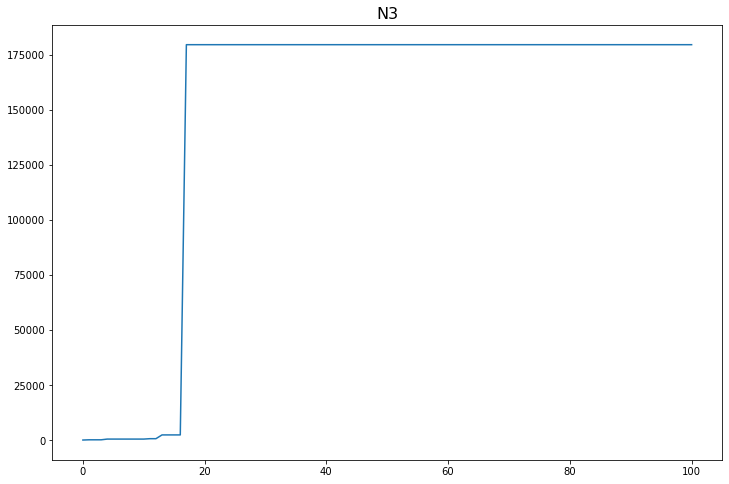

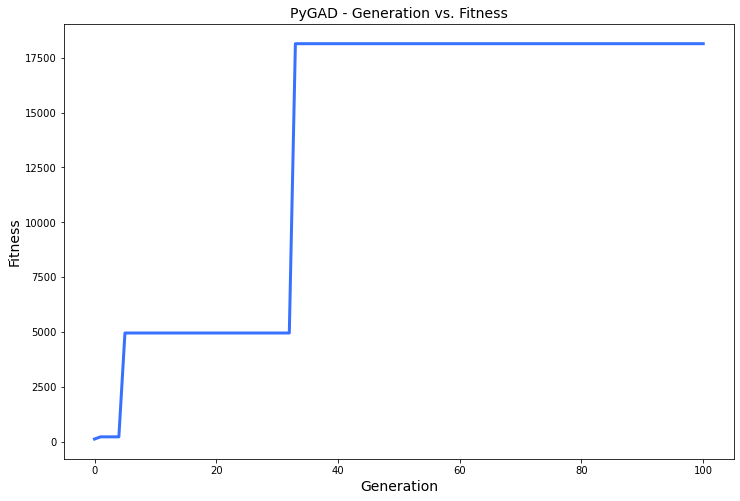

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.868 |==================| 3.434 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.145 |==================| 71.447 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.993 |==================| 6.024 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 25.002 |==================| 6.375 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 29.568 |==================| 0.973 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 30.328 |==================| 3.747 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.562 |==================| 30.36 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 29.496 |==================| 0.909 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 30.483 |==================| 8.866 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 29.75 |==================| 1.184 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.095 |==================| 1.998 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.028 |==================| 1.762 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 29.835 |==================| 1.315 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 29.779 |==================| 1.224 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 29.608 |==================| 1.012 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 30.251 |==================| 2.902 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 29.583 |==================| 0.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.639 |==================| 1.046 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 29.998 |==================| 1.675 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 30.186 |==================| 2.444 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 30.016 |==================| 1.726 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 30.314 |==================| 3.552 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 29.736 |==================| 1.163 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 29.721 |==================| 1.144 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 51.864 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 30.03 |==================| 1.77 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 30.408 |==================| 5.341 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 29.911 |==================| 1.461 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 30.146 |==================| 2.226 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.989 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 29.762 |==================| 1.2 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.638 |==================| 1.045 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 29.727 |==================| 1.151 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 30.468 |==================| 7.864 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 30.293 |==================| 3.312 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 29.721 |==================| 1.144 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 30.133 |==================| 2.163 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 30.523 |==================| 13.766 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.027 |==================| 1.761 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 30.554 |==================| 24.399 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 29.952 |==================| 1.554 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.562 |==================| 29.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.011 |===========| 29.431 |==================| 0.859 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.5 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 30.436 |==================| 6.267 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 29.727 |==================| 1.152 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 29.873 |==================| 1.384 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 30.097 |==================| 2.007 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 30.54 |==================| 17.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 29.686 |==================| 1.1 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 30.22 |==================| 2.663 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 30.231 |==================| 2.745 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 29.917 |==================| 1.475 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.233 |==================| 2.758 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 29.896 |==================| 1.429 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 29.816 |==================| 1.283 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 29.909 |==================| 1.456 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.938 |==================| 1.521 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.131 |==================| 2.155 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 29.736 |==================| 1.164 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 30.328 |==================| 3.742 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 30.38 |==================| 4.649 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.208 |==================| 2.58 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 30.474 |==================| 8.232 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 29.589 |==================| 0.994 |==========| N13 |==========
**********************************************************************
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 30.298 |==================| 3.365 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.521 |==================| 0.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 29.665 |==================| 1.075 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.517 |==================| 12.819 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 30.022 |==================| 1.744 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 29.963 |==================| 1.58 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 29.794 |==================| 1.247 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 30.019 |==================| 1.735 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 29.863 |==================| 1.365 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.775 |==================| 1.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 29.64 |==================| 1.046 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 30.253 |==================| 2.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.811 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 30.385 |==================| 4.76 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 29.62 |==================| 1.025 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 30.508 |==================| 11.476 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 29.695 |==================| 1.11 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 29.68 |==================| 1.093 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 30.444 |==================| 6.596 |==========| N13 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.301 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 29.556 |==================| 0.962 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 30.291 |==================| 3.285 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 30.256 |==================| 2.947 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 29.432 |==================| 0.86 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 30.365 |==================| 4.344 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 29.835 |==================| 1.316 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 29.704 |==================| 1.123 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 29.617 |==================| 1.023 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 29.693 |==================| 1.108 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 30.033 |==================| 1.777 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.576 |==================| 50.668 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 29.685 |==================| 1.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 30.575 |==================| 48.165 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 30.486 |==================| 9.109 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.028 |==================| 1.762 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 30.062 |==================| 1.875 |==========| N13 |==========
**********************************************************************
Fitness = 76.36137952109118
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 30.565 |==================| 32.595 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 30.384 |==================| 4.731 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 29.72 |==================| 1.142 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 29.896 |==================| 1.43 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 30.476 |==================| 8.384 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 29.835 |==================| 1.316 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 29.779 |==================| 1.225 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 30.24 |==================| 2.817 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.947 |==================| 1.542 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 29.706 |==================| 1.124 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 29.796 |==================| 1.251 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 29.72 |==================| 1.142 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 30.14 |==================| 2.197 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 29.603 |==================| 1.008 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.381 |==================| 4.673 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 30.196 |==================| 2.502 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.946 |==================| 1.541 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.168 |==================| 2.341 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.775 |==================| 1.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.208 |==================| 2.58 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.135 |==================| 2.173 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.233 |==================| 2.76 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 29.95 |==================| 1.549 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 29.591 |==================| 0.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 29.554 |==================| 0.961 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 29.707 |==================| 1.126 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 29.738 |==================| 1.167 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 30.12 |==================| 2.104 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 29.698 |==================| 1.114 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 29.576 |==================| 0.981 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 30.475 |==================| 8.278 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 29.648 |==================| 1.055 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 30.547 |==================| 20.837 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 29.979 |==================| 1.624 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 30.032 |==================| 1.776 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 30.037 |==================| 1.792 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 29.768 |==================| 1.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 29.792 |==================| 1.244 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.916 |==================| 1.472 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 30.311 |==================| 3.513 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.998 |==================| 1.673 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.322 |==================| 3.665 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 30.29 |==================| 3.271 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 29.512 |==================| 0.923 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 30.427 |==================| 5.93 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 29.678 |==================| 1.09 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.098 |==================| 2.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 29.876 |==================| 1.39 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 30.495 |==================| 9.997 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 29.48 |==================| 0.897 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 29.745 |==================| 1.176 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.573 |==================| 0.978 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 30.549 |==================| 21.746 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 29.857 |==================| 1.355 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 29.945 |==================| 1.538 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.287 |==================| 3.24 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 29.942 |==================| 1.53 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 30.229 |==================| 2.732 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 29.885 |==================| 1.408 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 30.278 |==================| 3.15 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.433 |==================| 6.179 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.571 |==================| 0.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.921 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 29.873 |==================| 1.384 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 29.934 |==================| 1.513 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.825 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 30.519 |==================| 13.057 |==========| N13 |==========
**********************************************************************
Fitness = 76.36137952109118
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 30.49 |==================| 9.509 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 29.731 |==================| 1.157 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 29.873 |==================| 1.384 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 30.477 |==================| 8.434 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 29.744 |==================| 1.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 30.021 |==================| 1.742 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 30.272 |==================| 3.094 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 30.483 |==================| 8.921 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 29.564 |==================| 0.97 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.001 |==================| 1.682 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 30.493 |==================| 9.737 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 30.436 |==================| 6.262 |==========| N13 |==========
**********************************************************************
=

======| 0.34 |===========| 30.238 |==================| 2.798 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 30.058 |==================| 1.863 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 29.848 |==================| 1.339 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.63 |==================| 1.036 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 30.038 |==================| 1.795 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 30.156 |==================| 2.275 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 29.669 |==================| 1.079 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.946 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 29.986 |==================| 1.642 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 30.31 |==================| 3.51 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 29.534 |==================| 0.943 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 30.378 |==================| 4.603 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 30.277 |==================| 3.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 30.321 |==================| 3.641 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 30.284 |==================| 3.215 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 30.522 |==================| 13.568 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 30.263 |==================| 3.005 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.301 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 29.718 |==================| 1.14 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 30.439 |==================| 6.405 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.749 |==================| 1.182 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 30.535 |==================| 16.697 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 29.709 |==================| 1.128 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 30.293 |==================| 3.311 |==========| N13 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 30.393 |==================| 4.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 30.204 |==================| 2.554 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 30.549 |==================| 21.467 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 30.026 |==================| 1.757 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 29.877 |==================| 1.392 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 29.643 |==================| 1.05 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 30.188 |==================| 2.456 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 30.487 |==================| 9.201 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 30.069 |==================| 1.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 29.887 |==================| 1.412 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 29.736 |==================| 1.164 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 29.7 |==================| 1.117 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 30.453 |==================| 7.007 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.918 |==================| 1.476 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 30.203 |==================| 2.547 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 30.467 |==================| 7.821 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 30.107 |==================| 2.048 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 29.85 |==================| 1.342 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 30.545 |==================| 19.884 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.515 |==================| 0.926 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 29.602 |==================| 1.007 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.938 |==================| 1.522 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 30.095 |==================| 1.998 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 29.793 |==================| 1.247 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.286 |==================| 3.231 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 30.433 |==================| 6.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 29.93 |==================| 1.503 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 30.2 |==================| 2.529 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 29.866 |==================| 1.37 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 29.913 |==================| 1.466 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 30.327 |==================| 3.733 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 30.107 |==================| 2.048 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 29.675 |==================| 1.086 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 29.867 |==================| 1.373 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.571 |==================| 0.976 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.471 |==================| 8.051 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 30.27 |==================| 3.075 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 30.405 |==================| 5.253 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 30.284 |==================| 3.217 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 29.704 |==================| 1.122 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 29.673 |==================| 1.084 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 29.611 |==================| 1.016 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 29.71 |==================| 1.129 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 30.021 |==================| 1.742 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 29.709 |==================| 1.128 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 29.899 |==================| 1.437 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 30.287 |==================| 3.248 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 30.295 |==================| 3.325 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 30.137 |==================| 2.184 |==========| N13 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 30.57 |==================| 39.845 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.303 |==================| 3.424 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 29.839 |==================| 1.322 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 29.611 |==================| 1.016 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 29.83 |==================| 1.307 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 29.756 |==================| 1.192 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.79 |==================| 1.242 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 29.59 |==================| 0.995 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 30.311 |==================| 3.523 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.241 |==================| 2.826 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 29.572 |==================| 0.977 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 29.792 |==================| 1.245 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 30.309 |==================| 3.499 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 29.744 |==================| 1.175 |==========| N13 |==========
**********************************************************************
Change = 33.34677437210249
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 30.085 |==================| 1.958 |==========| N13 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 29.986 |==================| 1.641 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.486 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.165 |==================| 2.324 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 30.483 |==================| 8.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 30.558 |==================| 26.782 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 29.514 |==================| 0.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 29.985 |==================| 1.64 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 30.573 |==================| 44.903 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 30.104 |==================| 2.037 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 30.318 |==================| 3.609 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 29.741 |==================| 1.171 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 30.495 |==================| 10.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 30.012 |==================| 1.715 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.168 |==================| 2.342 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 30.025 |==================| 1.755 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 29.688 |==================| 1.103 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 29.545 |==================| 0.952 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.897 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 29.792 |==================| 1.245 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.337 |==================| 3.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.518 |==================| 12.968 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 29.718 |==================| 1.14 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 29.585 |==================| 0.99 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 29.661 |==================| 1.07 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 30.183 |==================| 2.426 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 30.118 |==================| 2.093 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 29.788 |==================| 1.239 |==========| N13 |==========
**********************************************************************
Fitness = 109.70815389319367
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 29.914 |==================| 1.468 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 30.127 |==================| 2.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 30.234 |==================| 2.767 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 29.864 |==================| 1.367 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 29.59 |==================| 0.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 30.061 |==================| 1.873 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 30.51 |==================| 11.775 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.088 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.456 |==================| 0.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 30.539 |==================| 17.876 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 29.628 |==================| 1.033 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 30.407 |==================| 5.316 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 30.238 |==================| 2.798 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 29.563 |==================| 0.969 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 29.963 |==================| 1.582 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 30.344 |==================| 3.978 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 29.894 |==================| 1.425 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 30.488 |==================| 9.287 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 29.756 |==================| 1.192 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 29.9 |==================| 1.439 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 29.882 |==================| 1.402 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 30.437 |==================| 6.312 |==========| N13 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 29.976 |==================| 1.614 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 29.651 |==================| 1.059 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.099 |==================| 2.015 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 30.218 |==================| 2.648 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 29.64 |==================| 1.046 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.67 |==================| 1.081 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 30.491 |==================| 9.581 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 30.204 |==================| 2.553 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 30.452 |==================| 6.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 29.917 |==================| 1.474 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 30.56 |==================| 27.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.416 |==================| 5.571 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.918 |==================| 1.476 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 30.15 |==================| 2.247 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 30.114 |==================| 2.077 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 30.452 |==================| 6.993 |==========| N13 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.073 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.03 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 30.55 |==================| 21.95 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.992 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 30.486 |==================| 9.153 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.165 |==================| 2.323 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 29.743 |==================| 1.173 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 30.296 |==================| 3.343 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.281 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 30.478 |==================| 8.557 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 30.566 |==================| 34.344 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 30.444 |==================| 6.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 29.793 |==================| 1.247 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 30.009 |==================| 1.706 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.082 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 29.473 |==================| 0.891 |==========| N13 |==========
**********************************************************************
Fitness = 109.70815389319367
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.873 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 30.098 |==================| 2.009 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.244 |==================| 2.85 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 30.283 |==================| 3.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 30.166 |==================| 2.329 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.278 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 30.301 |==================| 3.399 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.518 |==================| 12.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 30.476 |==================| 8.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 30.288 |==================| 3.25 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 30.112 |==================| 2.07 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 30.399 |==================| 5.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 30.301 |==================| 3.399 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 29.698 |==================| 1.114 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 30.515 |==================| 12.461 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 30.276 |==================| 3.132 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 29.924 |==================| 1.489 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.259 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 29.783 |==================| 1.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 30.19 |==================| 2.467 |==========| N13 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.749 |==================| 1.182 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 30.276 |==================| 3.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 30.311 |==================| 3.513 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.947 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 29.98 |==================| 1.626 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 29.538 |==================| 0.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 30.181 |==================| 2.416 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.001 |==================| 1.682 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 29.929 |==================| 1.501 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 30.471 |==================| 8.017 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 29.909 |==================| 1.457 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 30.431 |==================| 6.082 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 30.48 |==================| 8.66 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 30.05 |==================| 1.834 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 30.469 |==================| 7.891 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.812 |==========| N13 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 30.139 |==================| 2.192 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 29.504 |==================| 0.916 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 30.019 |==================| 1.734 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 30.48 |==================| 8.66 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.19 |==================| 2.465 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 30.584 |==================| 85.223 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 29.812 |==================| 1.276 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 29.755 |==================| 1.191 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.897 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.74 |==================| 1.169 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 30.134 |==================| 2.168 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 29.864 |==================| 1.367 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 29.999 |==================| 1.677 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 30.276 |==================| 3.127 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 30.058 |==================| 1.86 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 29.97 |==================| 1.599 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.349 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.639 |==================| 1.045 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 29.954 |==================| 1.559 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 29.97 |==================| 1.599 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.895 |==================| 1.427 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 30.58 |==================| 67.4 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 29.769 |==================| 1.21 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 29.989 |==================| 1.649 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 30.143 |==================| 2.208 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 29.644 |==================| 1.052 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 29.871 |==================| 1.381 |==========| N13 |==========
**********************************************************************
Fitness = 109.70815389319367
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 30.133 |==================| 2.165 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.065 |==================| 1.885 |==========| N13 |==========
******************************************

======| 0.952 |===========| 29.507 |==================| 0.919 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 29.952 |==================| 1.555 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 29.757 |==================| 1.193 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 29.882 |==================| 1.402 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 30.121 |==================| 2.108 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 30.166 |==================| 2.331 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 30.158 |==================| 2.288 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 29.897 |==================| 1.432 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 30.478 |==================| 8.498 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 30.325 |==================| 3.702 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.739 |==================| 1.168 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 29.663 |==================| 1.073 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 30.2 |==================| 2.532 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 30.425 |==================| 5.885 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.388 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 30.163 |==================| 2.311 |==========| N13 |==========
**********************************************************************
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.497 |==================| 0.91 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.562 |==================| 30.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 29.868 |==================| 1.376 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 30.252 |==================| 2.909 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.388 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 29.729 |==================| 1.154 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 30.238 |==================| 2.8 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 29.746 |==================| 1.177 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 30.526 |==================| 14.436 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 30.163 |==================| 2.312 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 30.347 |==================| 4.032 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 30.191 |==================| 2.471 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.394 |==================| 4.959 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 30.035 |==================| 1.786 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 30.352 |==================| 4.107 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.367 |==================| 4.372 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 30.331 |==================| 3.789 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 29.622 |==================| 1.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 30.473 |==================| 8.159 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 30.3 |==================| 3.385 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 29.975 |==================| 1.612 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 30.512 |==================| 11.985 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 30.421 |==================| 5.729 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.673 |==================| 1.085 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 29.463 |==================| 0.883 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 30.561 |==================| 29.31 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 30.32 |==================| 3.637 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 30.512 |==================| 11.985 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 30.549 |==================| 21.679 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 29.537 |==================| 0.945 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 30.277 |==================| 3.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.225 |==================| 2.697 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 29.985 |==================| 1.638 |==========| N13 |==========
**********************************************************************
Fitness = 109.70815389319367
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 30.031 |==================| 1.771 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 29.778 |==================| 1.223 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 30.569 |==================| 37.721 |==========| N13 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 29.841 |==================| 1.325 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 30.507 |==================| 11.27 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 30.566 |==================| 33.861 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 30.495 |==================| 10.01 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 30.315 |==================| 3.57 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 29.602 |==================| 1.007 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 30.402 |==================| 5.178 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 29.723 |==================| 1.147 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 30.023 |==================| 1.746 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.586 |==================| 0.991 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 29.685 |==================| 1.098 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 29.671 |==================| 1.081 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 30.173 |==================| 2.369 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 30.567 |==================| 34.834 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 30.39 |==================| 4.876 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 30.221 |==================| 2.674 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 30.073 |==================| 1.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 29.804 |==================| 1.264 |==========| N13 |==========
**********************************************************************
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.889 |==================| 1.417 |==========| N13 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.365 |==================| 4.333 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.307 |==================| 3.464 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 29.779 |==================| 1.225 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.497 |==================| 0.91 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 30.392 |==================| 4.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 30.522 |==================| 13.597 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 29.954 |==================| 1.558 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 30.321 |==================| 3.647 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 30.272 |==================| 3.093 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 30.228 |==================| 2.726 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 29.909 |==================| 1.457 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 30.187 |==================| 2.446 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 29.584 |==================| 0.989 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 30.329 |==================| 3.755 |==========| N13 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.571 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 29.92 |==================| 1.481 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 30.25 |==================| 2.893 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 29.461 |==================| 0.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 30.009 |==================| 1.706 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 29.932 |==================| 1.508 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 29.685 |==================| 1.098 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 30.484 |==================| 9.012 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.959 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 29.643 |==================| 1.05 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 29.966 |==================| 1.589 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 29.894 |==================| 1.425 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 30.034 |==================| 1.782 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 30.417 |==================| 5.607 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.551 |==================| 22.705 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 29.942 |==================| 1.532 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 30.35 |==================| 4.075 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 30.187 |==================| 2.449 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 30.545 |==================| 19.732 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 29.519 |==================| 0.929 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 30.317 |==================| 3.588 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 29.88 |==================| 1.399 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 29.858 |==================| 1.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 30.325 |==================| 3.693 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 30.037 |==================| 1.79 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 30.513 |==================| 12.174 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.576 |==================| 50.541 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 30.078 |==================| 1.932 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.551 |==================| 22.69 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 29.76 |==================| 1.196 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 30.175 |==================| 2.38 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 30.364 |==================| 4.316 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 29.817 |==================| 1.285 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 30.112 |==================| 2.068 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 29.906 |==================| 1.451 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 30.144 |==================| 2.217 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 30.327 |==================| 3.727 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 29.87 |==================| 1.378 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 30.012 |==================| 1.715 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 30.361 |==================| 4.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 30.522 |==================| 13.567 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 30.085 |==================| 1.959 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 29.78 |==================| 1.227 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.825 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.639 |==================| 1.045 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 29.515 |==================| 0.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.303 |==================| 3.421 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 29.552 |==================| 0.958 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.286 |==================| 3.231 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 30.248 |==================| 2.883 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 30.27 |==================| 3.077 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.027 |==================| 1.76 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 30.226 |==================| 2.708 |==========| N13 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.577 |==================| 53.211 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 29.603 |==================| 1.008 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 29.687 |==================| 1.101 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 29.561 |==================| 0.967 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 29.523 |==================| 0.932 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.918 |==================| 1.477 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 29.658 |==================| 1.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 30.261 |==================| 2.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 30.515 |==================| 12.446 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 30.351 |==================| 4.09 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 29.618 |==================| 1.024 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 30.197 |==================| 2.51 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 29.755 |==================| 1.19 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 30.376 |==================| 4.566 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 29.459 |==================| 0.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.81 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========| N13 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 29.463 |==================| 0.883 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 29.765 |==================| 1.205 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 29.543 |==================| 0.95 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 30.195 |==================| 2.5 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.286 |==================| 3.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 30.117 |==================| 2.093 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.262 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 30.496 |==================| 10.119 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 29.763 |==================| 1.201 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 29.999 |==================| 1.676 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 30.553 |==================| 23.764 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 29.958 |==================| 1.569 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 30.374 |==================| 4.527 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 30.581 |==================| 67.864 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 30.482 |==================| 8.8 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 30.179 |==================| 2.399 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.366 |==================| 4.358 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 29.793 |==================| 1.246 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 30.311 |==================| 3.519 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 29.846 |==================| 1.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 29.905 |==================| 1.449 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.337 |==================| 3.87 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 29.593 |==================| 0.998 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 30.451 |==================| 6.932 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 29.746 |==================| 1.178 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 29.851 |==================| 1.343 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 29.872 |==================| 1.383 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.776 |==================| 1.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 29.945 |==================| 1.537 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.521 |==================| 0.931 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 29.925 |==================| 1.492 |==========| N13 |==========
**********************************************************************


======| 0.476 |===========| 30.085 |==================| 1.959 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 29.719 |==================| 1.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 29.858 |==================| 1.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 30.446 |==================| 6.708 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.241 |==================| 2.825 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 29.598 |==================| 1.003 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 29.966 |==================| 1.59 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 29.726 |==================| 1.15 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.366 |==================| 4.369 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 30.212 |==================| 2.609 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 29.829 |==================| 1.304 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 30.24 |==================| 2.812 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.184 |==================| 2.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 29.797 |==================| 1.253 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 29.835 |==================| 1.315 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 30.511 |==================| 11.8 |==========| N13 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 30.499 |==================| 10.345 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.455 |==================| 0.877 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 29.746 |==================| 1.177 |==========| N13 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 30.373 |==================| 4.501 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 29.751 |==================| 1.185 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.463 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 30.446 |==================| 6.706 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 30.144 |==================| 2.214 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.112 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 30.133 |==================| 2.163 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.074 |==================| 1.92 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 30.419 |==================| 5.666 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 29.649 |==================| 1.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 30.256 |==================| 2.949 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 29.565 |==================| 0.97 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 30.091 |==================| 1.982 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 29.91 |==================| 1.459 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 29.964 |==================| 1.584 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.812 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 29.569 |==================| 0.975 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.74 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 30.541 |==================| 18.503 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.255 |==================| 2.938 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 29.499 |==================| 0.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 29.944 |==================| 1.535 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 30.457 |==================| 7.254 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 30.552 |==================| 23.073 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 29.711 |==================| 1.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 30.568 |==================| 36.643 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.255 |==================| 2.938 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 29.728 |==================| 1.154 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.819 |==================| 1.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 29.979 |==================| 1.623 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.209 |==================| 2.586 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 29.959 |==================| 1.573 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 30.104 |==================| 2.034 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 30.14 |==================| 2.196 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 29.512 |==================| 0.923 |==========| N13 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 29.716 |==================| 1.138 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 29.992 |==================| 1.658 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.135 |==================| 2.171 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 30.366 |==================| 4.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 30.128 |==================| 2.138 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 30.578 |==================| 56.176 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 29.65 |==================| 1.058 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 30.021 |==================| 1.743 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 30.232 |==================| 2.752 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 30.13 |==================| 2.148 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.497 |==================| 10.191 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 29.736 |==================| 1.164 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 30.012 |==================| 1.713 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 30.445 |==================| 6.662 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 30.211 |==================| 2.602 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 29.87 |==================| 1.379 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 30.457 |==================| 7.212 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 29.508 |==================| 0.919 |==========| N13 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 30.351 |==================| 4.093 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.189 |==================| 2.463 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 30.166 |==================| 2.332 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 30.229 |==================| 2.731 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.168 |==================| 2.338 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 30.352 |==================| 4.103 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 30.081 |==================| 1.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 30.1 |==================| 2.02 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 30.53 |==================| 15.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 30.353 |==================| 4.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 29.879 |==================| 1.396 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 29.749 |==================| 1.182 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 30.531 |==================| 15.548 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 30.412 |==================| 5.444 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 30.194 |==================| 2.492 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 29.454 |==================| 0.876 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 29.851 |==================| 1.343 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 29.759 |==================| 1.195 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 30.29 |==================| 3.275 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 30.525 |==================| 14.274 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 29.847 |==================| 1.336 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 30.16 |==================| 2.299 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 30.298 |==================| 3.364 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 30.236 |==================| 2.783 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 29.843 |==================| 1.33 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 30.294 |==================| 3.314 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 30.422 |==================| 5.758 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 29.695 |==================| 1.11 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 30.275 |==================| 3.122 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 30.116 |==================| 2.087 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 29.972 |==================| 1.605 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 30.497 |==================| 10.142 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 30.48 |==================| 8.703 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 29.95 |==================| 1.549 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 29.717 |==================| 1.138 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 30.486 |==================| 9.116 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.436 |==================| 6.259 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 29.853 |==================| 1.347 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 30.09 |==================| 1.978 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 30.292 |==================| 3.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 29.797 |==================| 1.252 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 29.579 |==================| 0.984 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 30.113 |==================| 2.074 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 29.652 |==================| 1.061 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 29.585 |==================| 0.99 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 30.16 |==================| 2.298 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 29.701 |==================| 1.119 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 30.539 |==================| 17.793 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 29.678 |==================| 1.09 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 29.927 |==================| 1.497 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.242 |==================| 2.83 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 29.94 |==================| 1.527 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 30.157 |==================| 2.279 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 29.84 |==================| 1.323 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 30.306 |==================| 3.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 30.216 |==================| 2.637 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 30.099 |==================| 2.016 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 29.969 |==================| 1.596 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 29.702 |==================| 1.12 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.064 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 29.913 |==================| 1.466 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 30.127 |==================| 2.137 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.408 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 30.13 |==================| 2.151 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 30.414 |==================| 5.53 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 29.616 |==================| 1.021 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 29.653 |==================| 1.061 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.433 |==================| 6.179 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.806 |==================| 1.267 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.301 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 29.925 |==================| 1.491 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 30.534 |==================| 16.213 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 30.072 |==================| 1.912 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 30.033 |==================| 1.778 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 30.465 |==================| 7.7 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 29.963 |==================| 1.582 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 30.009 |==================| 1.707 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 29.818 |==================| 1.286 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.132 |==================| 2.158 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.28 |==================| 3.167 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 29.569 |==================| 0.974 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 30.371 |==================| 4.449 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 30.369 |==================| 4.422 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 30.104 |==================| 2.036 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 30.162 |==================| 2.306 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 30.348 |==================| 4.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 30.33 |==================| 3.771 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 30.571 |==================| 40.559 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 29.777 |==================| 1.222 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 30.079 |==================| 1.935 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 29.903 |==================| 1.444 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 29.495 |==================| 0.908 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 30.295 |==================| 3.327 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 30.137 |==================| 2.182 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 30.034 |==================| 1.781 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 30.281 |==================| 3.178 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 29.995 |==================| 1.667 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 30.038 |==================| 1.795 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 30.254 |==================| 2.93 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 30.273 |==================| 3.101 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 30.094 |==================| 1.994 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.74 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 30.212 |==================| 2.611 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.595 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 30.143 |==================| 2.213 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 29.853 |==================| 1.348 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 30.199 |==================| 2.526 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 30.115 |==================| 2.083 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.338 |==================| 3.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.997 |==================| 1.671 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 29.716 |==================| 1.137 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.416 |==================| 5.574 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.819 |==================| 1.288 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 30.56 |==================| 28.358 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.338 |==================| 3.88 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 29.624 |==================| 1.029 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 29.746 |==================| 1.177 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 30.398 |==================| 5.065 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.361 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 30.186 |==================| 2.443 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 29.747 |==================| 1.179 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.224 |==================| 2.696 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.064 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 29.617 |==================| 1.022 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.576 |==================| 50.675 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 30.532 |==================| 15.71 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 29.832 |==================| 1.31 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 30.444 |==================| 6.59 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.245 |==================| 2.855 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.823 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 30.162 |==================| 2.31 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 30.223 |==================| 2.687 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.353 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 29.603 |==================| 1.008 |==========| N13 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 30.069 |==================| 1.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.272 |==================| 3.089 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 30.014 |==================| 1.72 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 30.179 |==================| 2.405 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.242 |==================| 2.827 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 30.291 |==================| 3.291 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 29.953 |==================| 1.557 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.404 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 29.886 |==================| 1.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.819 |==================| 1.288 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 30.297 |==================| 3.356 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 29.961 |==================| 1.577 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.896 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 30.346 |==================| 4.004 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 29.833 |==================| 1.312 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 30.551 |==================| 22.371 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 29.902 |==================| 1.443 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 29.845 |==================| 1.332 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 30.261 |==================| 2.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 30.446 |==================| 6.677 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 30.005 |==================| 1.693 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 29.591 |==================| 0.995 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 29.846 |==================| 1.335 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 30.453 |==================| 7.024 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 30.109 |==================| 2.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 30.127 |==================| 2.134 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 30.545 |==================| 19.941 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.498 |==================| 10.237 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 29.809 |==================| 1.272 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 30.247 |==================| 2.867 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 29.705 |==================| 1.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 30.109 |==================| 2.056 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 30.481 |==================| 8.743 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 29.513 |==================| 0.924 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.099 |==================| 2.015 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 30.3 |==================| 3.389 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 30.214 |==================| 2.622 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 30.041 |==================| 1.806 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 30.252 |==================| 2.911 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 30.575 |==================| 48.572 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 30.337 |==================| 3.874 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 30.531 |==================| 15.44 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 30.259 |==================| 2.97 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 29.465 |==================| 0.885 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.464 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 29.777 |==================| 1.221 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 29.965 |==================| 1.588 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 30.183 |==================| 2.427 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.689 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.991 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 29.733 |==================| 1.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.147 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 30.039 |==================| 1.797 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 30.036 |==================| 1.787 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 30.314 |==================| 3.558 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.435 |==================| 6.223 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 30.423 |==================| 5.806 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 30.393 |==================| 4.935 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 30.422 |==================| 5.779 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 29.705 |==================| 1.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 29.897 |==================| 1.432 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 29.924 |==================| 1.489 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 30.297 |==================| 3.348 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 29.715 |==================| 1.136 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.26 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 30.159 |==================| 2.293 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 29.887 |==================| 1.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 30.583 |==================| 78.539 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 30.388 |==================| 4.834 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 29.532 |==================| 0.94 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 30.587 |==================| 116.129 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 30.12 |==================| 2.103 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.259 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 29.979 |==================| 1.622 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.292 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.543 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 30.082 |==================| 1.948 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 30.397 |==================| 5.054 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.704 |==================| 1.122 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 29.765 |==================| 1.204 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.991 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 30.525 |==================| 14.189 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.064 |==================| 1.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.935 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 30.223 |==================| 2.689 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 30.467 |==================| 7.81 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 29.532 |==================| 0.941 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 29.768 |==================| 1.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 29.708 |==================| 1.128 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 30.049 |==================| 1.83 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.573 |==================| 0.978 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 30.41 |==================| 5.406 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 29.768 |==================| 1.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 30.09 |==================| 1.978 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 30.155 |==================| 2.273 |==========| N13 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 29.955 |==================| 1.563 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 30.556 |==================| 25.193 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.801 |==================| 1.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 29.747 |==================| 1.179 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.947 |==================| 1.543 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 30.363 |==================| 4.302 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 30.182 |==================| 2.422 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.96 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 30.593 |==================| 402.097 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 30.052 |==================| 1.841 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.785 |==================| 1.234 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 30.589 |==================| 158.626 |==========| N13 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 30.226 |==================| 2.71 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.503 |==================| 0.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.046 |==================| 1.822 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 30.588 |==================| 136.34 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.046 |==================| 1.821 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 30.392 |==================| 4.912 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.208 |==================| 2.581 |==========| N13 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 29.676 |==================| 1.088 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 30.39 |==================| 4.881 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.86 |==================| 1.361 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 30.254 |==================| 2.934 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 30.24 |==================| 2.817 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 30.198 |==================| 2.518 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 30.591 |==================| 231.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 30.06 |==================| 1.868 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 30.127 |==================| 2.133 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 30.07 |==================| 1.904 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 30.579 |==================| 62.031 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 30.077 |==================| 1.93 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 29.605 |==================| 1.01 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 30.556 |==================| 25.246 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 30.406 |==================| 5.276 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.689 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 30.055 |==================| 1.85 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 29.877 |==================| 1.392 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 29.471 |==================| 0.889 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 30.21 |==================| 2.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 29.729 |==================| 1.155 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 29.705 |==================| 1.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.614 |==================| 1.019 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 29.788 |==================| 1.238 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 29.658 |==================| 1.066 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.045 |==================| 1.818 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 30.399 |==================| 5.104 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 30.438 |==================| 6.376 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.137 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 30.2 |==================| 2.532 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.586 |==================| 0.99 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 29.682 |==================| 1.095 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 29.648 |==================| 1.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 30.523 |==================| 13.9 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 29.689 |==================| 1.103 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 30.089 |==================| 1.977 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.221 |==================| 2.668 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 29.609 |==================| 1.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 30.572 |==================| 42.893 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 29.465 |==================| 0.885 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 30.223 |==================| 2.689 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 30.113 |==================| 2.071 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 30.463 |==================| 7.539 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 30.584 |==================| 87.264 |==========| N13 |==========
**********************************************************************
Fitness = 669.7199202287758
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.084 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 30.38 |==================| 4.642 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 30.347 |==================| 4.022 |==========| N13 |==========
*********************************************

======| 0.397 |===========| 30.175 |==================| 2.379 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 29.528 |==================| 0.937 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 30.344 |==================| 3.98 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.517 |==================| 0.927 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 29.968 |==================| 1.595 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.416 |==================| 5.568 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 29.497 |==================| 0.911 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 30.377 |==================| 4.584 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 30.279 |==================| 3.165 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 29.983 |==================| 1.634 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 30.356 |==================| 4.18 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 30.348 |==================| 4.038 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 30.308 |==================| 3.481 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 29.524 |==================| 0.933 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 30.587 |==================| 124.939 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 29.71 |==================| 1.13 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.939 |==================| 1.523 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 30.46 |==================| 7.395 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.286 |==================| 3.229 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 29.891 |==================| 1.42 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 30.293 |==================| 3.307 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.335 |==================| 3.837 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 30.374 |==================| 4.512 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 30.067 |==================| 1.891 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 29.484 |==================| 0.9 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 29.773 |==================| 1.215 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 29.703 |==================| 1.12 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 30.293 |==================| 3.307 |==========| N13 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 30.058 |==================| 1.861 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 29.602 |==================| 1.007 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 30.489 |==================| 9.411 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 30.056 |==================| 1.856 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.279 |==================| 3.166 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.96 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 30.433 |==================| 6.172 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 29.53 |==================| 0.939 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.638 |==================| 1.045 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 29.635 |==================| 1.041 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.578 |==================| 57.552 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.265 |==================| 3.023 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 30.436 |==================| 6.296 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 30.027 |==================| 1.758 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.286 |==================| 3.233 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.578 |==================| 57.552 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.388 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 29.561 |==================| 0.967 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 29.557 |==================| 0.963 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.287 |==================| 3.241 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 29.734 |==================| 1.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 29.921 |==================| 1.482 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.307 |==================| 3.469 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 30.447 |==================| 6.762 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 29.592 |==================| 0.997 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 30.263 |==================| 3.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 30.343 |==================| 3.96 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.307 |==================| 3.465 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.233 |==================| 2.759 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 29.859 |==================| 1.358 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 29.513 |==================| 0.924 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 30.239 |==================| 2.804 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 30.09 |==================| 1.978 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.045 |==================| 1.819 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 29.649 |==================| 1.057 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 30.359 |==================| 4.24 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 29.865 |==================| 1.37 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 30.068 |==================| 1.896 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 29.664 |==================| 1.074 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 29.761 |==================| 1.199 |==========| N13 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.286 |==================| 3.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 29.537 |==================| 0.945 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 30.122 |==================| 2.113 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.594 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.031 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 29.664 |==================| 1.074 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 29.75 |==================| 1.183 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 29.985 |==================| 1.638 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 30.287 |==================| 3.249 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 30.019 |==================| 1.736 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 30.159 |==================| 2.292 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 30.394 |==================| 4.968 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 29.614 |==================| 1.019 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.165 |==================| 2.323 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 29.448 |==================| 0.871 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 30.441 |==================| 6.477 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 29.613 |==================| 1.018 |==========| N13 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 30.388 |==================| 4.813 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 29.54 |==================| 0.947 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 29.493 |==================| 0.907 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 30.468 |==================| 7.848 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 29.839 |==================| 1.322 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 30.485 |==================| 9.071 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 29.865 |==================| 1.37 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 30.581 |==================| 72.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 30.437 |==================| 6.298 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 30.016 |==================| 1.725 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 30.59 |==================| 177.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.99 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 30.396 |==================| 5.016 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 29.991 |==================| 1.654 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 29.69 |==================| 1.104 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 29.995 |==================| 1.667 |==========| N13 |==========
**********************************************************************
Fitness = 799.8820161509748
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.552 |==================| 22.862 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 29.785 |==================| 1.234 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 29.626 |==================| 1.032 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 30.292 |==================| 3.301 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 30.214 |==================| 2.621 |==========| N13 |==========
**********************************************************************
=

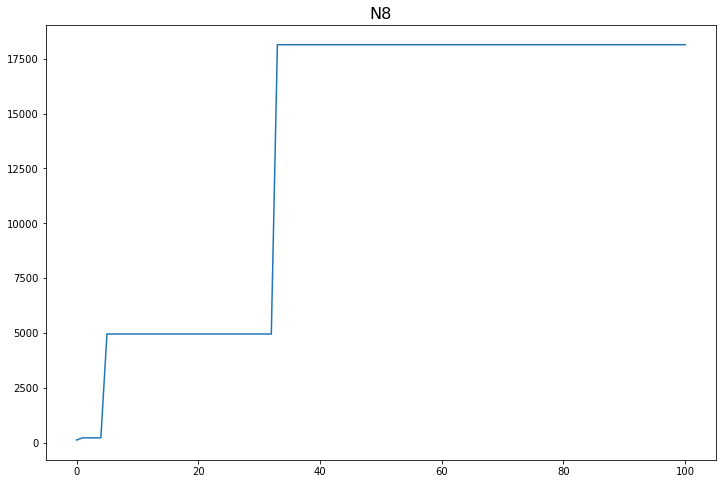

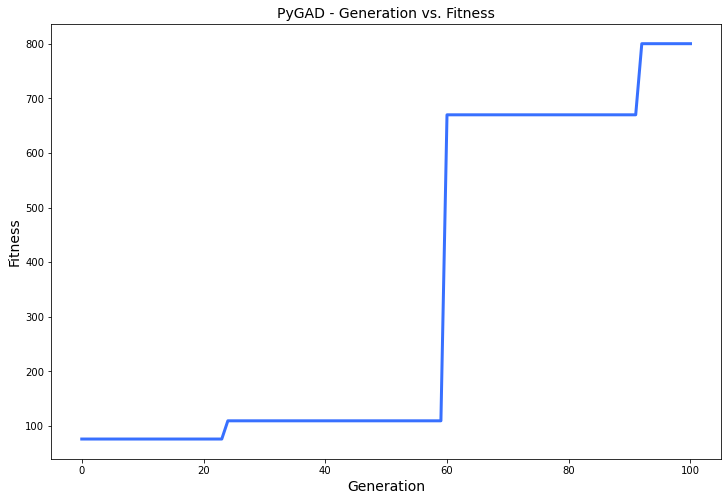

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.552 |==================| 22.862 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.067 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 30.59 |==================| 177.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.99 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.221 |==================| 6.591 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 24.085 |==================| 3.483 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.267 |==================| 9.529 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.127 |==================| 4.084 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.346 |==================| 37.718 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.357 |==================| 67.256 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.238 |==================| 7.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.095 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.121 |==================| 3.976 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.34 |==================| 31.234 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.162 |==================| 4.748 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.38 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.255 |==================| 8.508 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.232 |==================| 7.129 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.14 |==================| 4.304 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.371 |==================| 586.618 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.179 |==================| 5.187 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.252 |==================| 8.285 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.362 |==================| 93.313 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.139 |==================| 4.28 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.112 |==================| 3.849 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.837 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.118 |==================| 3.933 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.179 |==================| 5.187 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.193 |==================| 5.59 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.25 |==================| 8.187 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.126 |==================| 4.054 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.16 |==================| 4.701 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.159 |==================| 4.695 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.361 |==================| 85.938 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.396 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.04 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.132 |==================| 4.159 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.345 |==================| 36.058 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.236 |==================| 7.336 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.186 |==================| 5.382 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 24.087 |==================| 3.509 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.024 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.357 |==================| 63.608 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.068 |==================| 3.292 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.164 |==================| 4.794 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.087 |==================| 3.502 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.311 |==================| 16.331 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.372 |==================| 1334.882 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.328 |==================| 22.364 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.46 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.526 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.107 |==================| 3.776 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.101 |==================| 3.686 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.166 |==================| 4.846 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.309 |==================| 15.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.117 |==================| 3.92 |==========| N9 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.19 |==================| 5.489 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 24.096 |==================| 3.617 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.32 |==================| 19.225 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.325 |==================| 21.341 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.158 |==================| 4.66 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.276 |==================| 10.355 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.271 |==================| 9.835 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.172 |==================| 4.996 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.266 |==================| 9.405 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.327 |==================| 21.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.169 |==================| 4.918 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.319 |==================| 18.765 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.197 |==================| 5.714 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.26 |==================| 8.934 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.743 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.234 |==================| 7.231 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.402 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.065 |==================| 3.259 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.224 |==================| 6.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.11 |==================| 3.812 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.065 |==================| 3.251 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.276 |==================| 10.439 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.242 |==================| 7.668 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.15 |==================| 4.494 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.706 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.529 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.265 |==================| 9.286 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.656 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.121 |==================| 3.986 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.194 |==================| 5.599 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 125.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.24 |==================| 7.541 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.103 |==================| 3.709 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.151 |==================| 4.515 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.351 |==================| 46.273 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.105 |==================| 3.743 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.24 |==================| 7.584 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.24 |==================| 7.532 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.364 |==================| 121.752 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.252 |==================| 8.343 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.173 |==================| 5.02 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 24.074 |==================| 3.354 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.217 |==================| 6.436 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.134 |==================| 4.199 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.368 |==================| 226.563 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.372 |==================| 2157.804 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.154 |==================| 4.587 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.36 |==================| 80.243 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.198 |==================| 5.733 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.272 |==================| 9.945 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.904 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.162 |==================| 4.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.244 |==================| 7.805 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.354 |==================| 56.221 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.017 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.319 |==================| 18.946 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.616 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.346 |==================| 37.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.819 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.132 |==================| 4.167 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.314 |==================| 17.025 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.358 |==================| 71.44 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.159 |==================| 4.679 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.094 |==================| 3.593 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.224 |==================| 6.756 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.297 |==================| 13.268 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.124 |==================| 4.024 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.242 |==================| 7.673 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.231 |==================| 7.081 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.099 |==================| 3.662 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.326 |==================| 21.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.338 |==================| 28.936 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.244 |==================| 7.826 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.326 |==================| 21.703 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.284 |==================| 11.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.455 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.078 |==================| 3.396 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.307 |==================| 15.362 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.407 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.078 |==================| 3.395 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.33 |==================| 23.4 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.252 |==================| 8.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.211 |==================| 6.214 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.009 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.162 |==================| 4.745 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.126 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.271 |==================| 9.867 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.328 |==================| 22.778 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.289 |==================| 11.968 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.258 |==================| 8.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.371 |==================| 584.831 |==========| N9 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.22 |==================| 6.565 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.316 |==================| 17.658 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.331 |==================| 24.239 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.974 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.206 |==================| 6.031 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.266 |==================| 9.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.442 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.368 |==================| 238.692 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.224 |==================| 6.723 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.352 |==================| 50.391 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.128 |==================| 4.09 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.544 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.218 |==================| 6.496 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.299 |==================| 13.59 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.224 |==================| 6.729 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.171 |==================| 4.956 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.29 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.204 |==================| 5.94 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.361 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.352 |==================| 50.41 |==========| N9 |==========
**********************************************************************
Fitness

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.344 |==================| 34.915 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.759 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.773 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.29 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.314 |==================| 17.039 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.063 |==================| 3.234 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.232 |==================| 7.135 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.082 |==================| 3.441 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.881 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.148 |==================| 4.466 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.298 |==================| 13.54 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.369 |==================| 351.834 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.159 |==================| 4.685 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.313 |==================| 17.003 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.333 |==================| 25.179 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.128 |==================| 4.091 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.235 |==================| 7.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.204 |==================| 5.937 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.248 |==================| 8.023 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.31 |==================| 16.182 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.078 |==================| 3.394 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.331 |==================| 24.095 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.561 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.219 |==================| 6.53 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.31 |==================| 15.986 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.369 |==================| 271.477 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.166 |==================| 4.838 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.1 |==================| 3.667 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.945 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.182 |==================| 5.264 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.362 |==================| 92.93 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.17 |==================| 4.942 |==========| N9 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.528 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.533 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 24.066 |==================| 3.266 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.306 |==================| 15.151 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.157 |==================| 4.655 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.236 |==================| 7.319 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.273 |==================| 10.091 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 48.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 161.894 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.078 |==================| 3.397 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.093 |==================| 3.584 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.383 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.304 |==================| 14.746 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.318 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.297 |==================| 13.223 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.249 |==================| 8.119 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.064 |==================| 3.239 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.251 |==================| 8.225 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.207 |==================| 6.04 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.287 |==================| 11.664 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.469 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.147 |==================| 4.443 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.351 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.077 |==================| 3.382 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.126 |==================| 4.052 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.154 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.213 |==================| 6.287 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.332 |==================| 25.001 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.317 |==================| 18.209 |==========| N9 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.342 |==================| 33.252 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.208 |==================| 6.074 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.152 |==================| 4.539 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.154 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.253 |==================| 8.406 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.338 |==================| 28.826 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.25 |==================| 8.163 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.281 |==================| 11.013 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.072 |==================| 3.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.321 |==================| 19.445 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.199 |==================| 5.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.1 |==================| 3.673 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.258 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.245 |==================| 7.883 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.077 |==================| 3.39 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.635 |==========| N9 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.148 |==================| 4.45 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.228 |==================| 6.922 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.111 |==================| 3.82 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.219 |==================| 6.523 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.167 |==================| 4.865 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.189 |==================| 5.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 24.078 |==================| 3.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.353 |==================| 50.763 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.283 |==================| 11.229 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.161 |==================| 4.722 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.223 |==================| 6.689 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.195 |==================| 5.642 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.334 |==================| 26.395 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.359 |==================| 75.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.278 |==================| 10.625 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.109 |==================| 3.792 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.022 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.346 |==================| 37.384 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.202 |==================| 5.873 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.076 |==================| 3.376 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.167 |==================| 4.867 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.133 |==================| 4.181 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.042 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.244 |==================| 7.79 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.293 |==================| 12.615 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.23 |==================| 7.04 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.396 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.351 |==================| 46.895 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.216 |==================| 6.411 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.262 |==================| 9.083 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.05 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.099 |==================| 3.665 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.241 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.312 |==================| 16.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.202 |==================| 5.881 |==========| N9 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.107 |==================| 3.766 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.095 |==================| 3.613 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.179 |==================| 5.184 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.266 |==================| 9.427 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.266 |==================| 9.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.251 |==================| 8.235 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.117 |==================| 3.925 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.325 |==================| 21.214 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.294 |==================| 12.725 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.445 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.131 |==================| 4.14 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.155 |==================| 4.604 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.29 |==================| 12.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.315 |==================| 17.309 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.286 |==================| 11.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.782 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.321 |==================| 19.536 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.146 |==================| 4.416 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.355 |==================| 56.968 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.148 |==================| 4.463 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.088 |==================| 3.515 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.081 |==================| 3.429 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.078 |==================| 3.395 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.203 |==================| 5.9 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.195 |==================| 5.632 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.429 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.267 |==================| 9.482 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.607 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.13 |==================| 4.12 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.353 |==================| 52.186 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.37 |==================| 421.468 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.107 |==================| 3.775 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.134 |==================| 4.192 |==========| N9 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.185 |==================| 5.35 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.238 |==================| 7.442 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.368 |==================| 209.637 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.197 |==================| 5.721 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.125 |==================| 4.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.107 |==================| 3.765 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.068 |==================| 3.285 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.522 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.367 |==================| 198.439 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.465 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.757 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.504 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.305 |==================| 14.947 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.2 |==================| 5.814 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.093 |==================| 3.583 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.219 |==================| 6.531 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.08 |==================| 3.418 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.351 |==================| 46.227 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.209 |==================| 6.14 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.077 |==================| 3.391 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 64.711 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.286 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.259 |==================| 8.791 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.195 |==================| 5.638 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.31 |==================| 15.999 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.128 |==================| 4.1 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.292 |==================| 12.51 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.067 |==================| 3.275 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.248 |==================| 8.053 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.147 |==================| 4.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 24.088 |==================| 3.521 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.482 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.339 |==================| 30.274 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.126 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.193 |==================| 5.593 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.073 |==================| 3.34 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.312 |==================| 16.615 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.128 |==================| 4.087 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.182 |==================| 5.254 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.123 |==================| 4.017 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.082 |==================| 3.447 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.099 |==================| 3.654 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.314 |==================| 17.145 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.146 |==================| 4.413 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.293 |==================| 12.539 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.119 |==================| 3.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.213 |==================| 6.297 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.233 |==================| 7.166 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.078 |==================| 3.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.519 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.296 |==================| 13.15 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.216 |==================| 6.408 |==========| N9 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.876 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 24.066 |==================| 3.268 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 61.018 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.332 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.282 |==================| 11.089 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 5.0 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.205 |==================| 5.966 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.384 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.215 |==================| 6.375 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.295 |==================| 12.873 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.222 |==================| 6.64 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.179 |==================| 5.176 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.593 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.155 |==================| 4.611 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.17 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.255 |==================| 8.514 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.185 |==================| 5.331 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.108 |==================| 3.781 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.855 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.593 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.296 |==================| 13.128 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.347 |==================| 40.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.082 |==================| 3.441 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.122 |==================| 3.999 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.243 |==================| 7.739 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.08 |==================| 3.421 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.173 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.17 |==================| 4.932 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.193 |==================| 5.585 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.258 |==================| 8.75 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.835 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.948 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.231 |==================| 7.096 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.126 |==================| 4.058 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.305 |==================| 14.865 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.213 |==================| 6.278 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.184 |==================| 5.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.237 |==================| 7.408 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.274 |==================| 10.206 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.198 |==================| 5.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.35 |==================| 44.981 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.019 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.267 |==================| 9.5 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.116 |==================| 3.909 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.11 |==================| 3.819 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.066 |==================| 3.265 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.012 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.902 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.197 |==================| 5.72 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.745 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.367 |==================| 182.882 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.233 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.171 |==================| 4.961 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.071 |==================| 3.315 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.314 |==================| 17.13 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.21 |==================| 6.145 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.183 |==================| 5.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.141 |==================| 4.33 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.332 |==================| 24.564 |==========| N9 |==========
**********************************************************************
=====

======| 0.79 |===========| 24.126 |==================| 4.065 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.317 |==================| 18.162 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.258 |==================| 8.769 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.345 |==================| 36.011 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.19 |==================| 5.478 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.263 |==================| 9.139 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.155 |==================| 4.604 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.31 |==================| 16.182 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.132 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.57 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.287 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.49 |==========| N9 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.308 |==================| 15.471 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.091 |==================| 3.551 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 64.173 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.17 |==================| 4.933 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.267 |==================| 9.462 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.33 |==================| 23.488 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.323 |==================| 20.281 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.721 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.095 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.319 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.242 |==================| 7.652 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.359 |==================| 75.433 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.144 |==================| 4.383 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.209 |==================| 6.119 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.27 |==================| 9.764 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.196 |==================| 5.667 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.179 |==================| 5.184 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.182 |==================| 5.247 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.198 |==================| 5.747 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.367 |==================| 177.115 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.268 |==================| 9.589 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.209 |==================| 6.13 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.187 |==================| 5.399 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.203 |==================| 5.916 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.011 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.339 |==================| 30.178 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.197 |==================| 5.713 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.266 |==================| 9.45 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.321 |==================| 19.653 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.099 |==========| N9 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.274 |==================| 10.178 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.082 |==================| 3.441 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.344 |==================| 35.562 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.16 |==================| 4.721 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.113 |==================| 3.862 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.134 |==================| 4.192 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.266 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.325 |==================| 21.337 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.242 |==================| 7.659 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.149 |==================| 4.474 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.071 |==================| 3.323 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.073 |==================| 3.341 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.29 |==================| 12.123 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.369 |==================| 269.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.426 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.272 |==================| 10.012 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.333 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.095 |==================| 3.601 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.285 |==================| 11.504 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.322 |==================| 20.063 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.277 |==================| 10.525 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.187 |==================| 5.411 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.312 |==================| 16.561 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.89 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.229 |==================| 6.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.295 |==================| 12.993 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.156 |==================| 4.615 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.361 |==================| 92.112 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.369 |==================| 290.436 |==========| N9 |==========
**********************************************************************
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.065 |==================| 3.253 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.319 |==================| 18.816 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.168 |==================| 4.884 |==========| N9 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.095 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.342 |==================| 33.457 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.197 |==================| 5.708 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.161 |==================| 4.739 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.122 |==================| 3.999 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.322 |==================| 19.848 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.097 |==================| 3.631 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.258 |==================| 8.729 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.364 |==================| 120.475 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.233 |==================| 7.17 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.323 |==================| 20.304 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.287 |==================| 11.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.169 |==================| 4.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.069 |==================| 3.296 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.294 |==================| 12.825 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.113 |==================| 3.857 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.251 |==================| 8.261 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.183 |==================| 5.284 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.094 |==================| 3.589 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.251 |==================| 8.249 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.353 |==================| 51.093 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.109 |==================| 3.801 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.143 |==================| 4.369 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.611 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.839 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.325 |==================| 20.933 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.171 |==================| 4.977 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.22 |==================| 6.551 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.008 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.243 |==================| 7.723 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.261 |==================| 9.008 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.583 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.126 |==================| 4.053 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.167 |==================| 4.865 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.632 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.187 |==================| 5.388 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.146 |==================| 4.419 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.244 |==================| 7.769 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.184 |==================| 5.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.063 |==================| 3.23 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.071 |==================| 3.315 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.118 |==================| 3.93 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.076 |==================| 3.376 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.307 |==================| 15.35 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.23 |==================| 7.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.37 |==================| 498.481 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.104 |==================| 3.733 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.345 |==================| 36.188 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.113 |==================| 3.851 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.236 |==================| 7.349 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.269 |==================| 9.691 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.107 |==================| 3.776 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.348 |==================| 41.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.652 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 60.51 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.122 |==================| 3.995 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.304 |==================| 14.578 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.199 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.041 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.188 |==================| 5.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.182 |==================| 5.249 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.115 |==================| 3.887 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.559 |==========| N9 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.255 |==================| 8.501 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.407 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.239 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.198 |==================| 5.739 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.211 |==================| 6.212 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.321 |==================| 19.432 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.33 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.191 |==================| 5.513 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.142 |==================| 4.338 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.237 |==================| 7.404 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.255 |==================| 8.526 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.566 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.297 |==================| 13.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.071 |==================| 3.322 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.312 |==================| 16.694 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.355 |==================| 57.659 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.36 |==================| 84.017 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.566 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.174 |==================| 5.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.262 |==================| 9.053 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.35 |==================| 45.765 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.165 |==================| 4.817 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.134 |==================| 4.204 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.135 |==================| 4.212 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 83.326 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.226 |==================| 6.838 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.107 |==================| 3.765 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.156 |==================| 4.633 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.193 |==================| 5.574 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.698 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.178 |==================| 5.159 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.445 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.229 |==================| 6.959 |==========| N9 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.245 |==================| 7.859 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.355 |==================| 56.451 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.23 |==================| 7.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.698 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.386 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.193 |==================| 5.591 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.094 |==================| 3.591 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.319 |==========| N9 |==========
**********************************************************************
====

======| 0.506 |===========| 24.215 |==================| 6.366 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.947 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.323 |==================| 20.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.196 |==================| 5.657 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.149 |==================| 4.481 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.621 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.157 |==================| 4.649 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.215 |==================| 6.366 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.12 |==================| 3.966 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 48.857 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.336 |==================| 27.802 |==========| N9 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.181 |==================| 5.223 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.089 |==================| 3.53 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.185 |==================| 5.337 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.289 |==================| 12.022 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.12 |==================| 3.966 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.329 |==================| 22.889 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.709 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.157 |==================| 4.653 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.295 |==================| 12.9 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.162 |==================| 4.761 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.461 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.364 |==================| 117.188 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.297 |==================| 13.358 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 94.555 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.757 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.104 |==================| 3.723 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.084 |==================| 3.47 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.155 |==================| 4.613 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.365 |==================| 135.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.248 |==================| 8.045 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.325 |==================| 21.372 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.194 |==================| 5.602 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.347 |==================| 39.231 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.219 |==================| 6.512 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.643 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.059 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.29 |==================| 12.224 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.253 |==================| 8.389 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.162 |==================| 4.763 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.688 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.379 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.2 |==================| 5.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.197 |==================| 5.704 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.171 |==================| 4.979 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.265 |==================| 9.311 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.253 |==================| 8.403 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.645 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.292 |==================| 12.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.315 |==================| 17.501 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.127 |==================| 4.08 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.21 |==================| 6.172 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.249 |==================| 8.138 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.322 |==================| 20.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.168 |==================| 4.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.33 |==================| 23.767 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.038 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.85 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.293 |==================| 12.567 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.407 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.282 |==================| 11.022 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.569 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.452 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.097 |==================| 3.629 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.788 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.345 |==================| 36.563 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.149 |==================| 4.478 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.097 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.637 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.346 |==================| 38.025 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.618 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.292 |==================| 12.453 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.109 |==================| 3.795 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.102 |==================| 3.706 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.308 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.853 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.211 |==================| 6.201 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.153 |==================| 4.567 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.577 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.106 |==================| 3.762 |==========| N9 |==========
**********************************************************************
====

======| 0.831 |===========| 24.114 |==================| 3.867 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.793 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.349 |==================| 42.509 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.14 |==================| 4.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.204 |==================| 5.957 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.256 |==================| 8.585 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.113 |==================| 3.856 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.114 |==================| 3.867 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.336 |==================| 27.856 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.218 |==================| 6.491 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.2 |==================| 5.793 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.094 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.262 |==================| 9.108 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.263 |==================| 9.137 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.213 |==================| 6.289 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.305 |==================| 14.796 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.072 |==================| 3.327 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.173 |==================| 5.016 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.302 |==================| 14.17 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.229 |==================| 6.974 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.504 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.15 |==================| 4.505 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.149 |==================| 4.474 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.284 |==================| 11.391 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 96.822 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.279 |==================| 10.761 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.268 |==================| 9.584 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.151 |==================| 4.518 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.821 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.071 |==================| 3.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.238 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.606 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.276 |==================| 10.381 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.138 |==================| 4.265 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.788 |==========| N9 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.093 |==================| 3.58 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.173 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.119 |==================| 3.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.214 |==================| 6.309 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.332 |==================| 24.712 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.317 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.258 |==================| 8.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.333 |==================| 25.322 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 24.137 |==================| 4.244 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.367 |==================| 197.544 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.257 |==================| 8.682 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.294 |==================| 12.851 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.265 |==================| 9.343 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.131 |==================| 4.148 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.349 |==================| 43.015 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.246 |==================| 7.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.151 |==================| 4.512 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.261 |==================| 8.998 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.359 |==================| 74.994 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.236 |==================| 7.353 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.225 |==================| 6.784 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 24.079 |==================| 3.415 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.729 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.761 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.928 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.184 |==================| 5.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.747 |==========| N9 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.155 |==================| 4.613 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.309 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.822 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.704 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.303 |==================| 14.54 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.328 |==================| 22.43 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.455 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.122 |==================| 3.994 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.26 |==================| 8.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.496 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.176 |==================| 5.097 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.358 |==================| 69.54 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.315 |==================| 17.61 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.276 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.139 |==================| 4.28 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.205 |==================| 5.975 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.077 |==================| 3.39 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.355 |==================| 57.097 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.141 |==================| 4.317 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.327 |==================| 21.887 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.19 |==================| 5.475 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.206 |==================| 6.007 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.176 |==================| 5.102 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.299 |==================| 13.602 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.251 |==================| 8.233 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.122 |==================| 3.998 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.253 |==================| 8.389 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.187 |==================| 5.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.25 |==================| 8.162 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.162 |==================| 4.766 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.245 |==================| 7.86 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.112 |==================| 3.839 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.182 |==================| 5.255 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.59 |==========| N9 |==========
**********************************************************************
Fitness = 2157.8039980106314
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.198 |==================| 5.753 |==========| N9 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.069 |==================| 3.298 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.572 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 126.243 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.241 |==================| 7.617 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.348 |==================| 41.325 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.103 |==================| 3.715 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.18 |==================| 5.195 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.271 |==================| 9.836 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.562 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.617 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.098 |==================| 3.649 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.116 |==================| 3.907 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.348 |==================| 41.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.258 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.444 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.265 |==================| 9.29 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.119 |==================| 3.946 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.292 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.969 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.258 |==================| 8.765 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.288 |==================| 11.8 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.312 |==================| 16.532 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.171 |==================| 4.973 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.365 |==================| 141.418 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 24.359 |==================| 73.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.3 |==================| 13.773 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.21 |==================| 6.145 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.646 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.108 |==================| 3.777 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.112 |==================| 3.844 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 4.998 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.3 |==================| 13.849 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.347 |==================| 38.832 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.182 |==================| 5.253 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.241 |==================| 7.604 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.291 |==================| 12.332 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.201 |==================| 5.834 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.197 |==================| 5.71 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.11 |==================| 3.814 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 24.096 |==================| 3.619 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.095 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.231 |==================| 7.087 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 24.082 |==================| 3.442 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.061 |==================| 3.215 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 24.067 |==================| 3.271 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.132 |==================| 4.168 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.211 |==================| 6.211 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.198 |==================| 5.744 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.652 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.121 |==================| 3.981 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.129 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.222 |==================| 6.666 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.35 |==================| 45.495 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.309 |==================| 15.832 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.159 |==================| 4.694 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.094 |==================| 3.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.156 |==================| 4.633 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.185 |==================| 5.331 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.307 |==================| 15.259 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.14 |==================| 4.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.443 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.365 |==================| 145.582 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.136 |==================| 4.241 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.095 |==================| 3.612 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.221 |==================| 6.62 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.073 |==================| 3.342 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.093 |==================| 3.586 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.238 |==================| 7.462 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.263 |==================| 9.149 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.137 |==================| 4.249 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.273 |==================| 10.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.162 |==================| 4.752 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.285 |==================| 11.426 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.645 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.353 |==================| 53.13 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.082 |==================| 3.441 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.344 |==================| 35.243 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.399 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.32 |==================| 19.008 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.26 |==================| 8.921 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.18 |==================| 5.19 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.185 |==========| N9 |==========
**********************************************************************
=====|SOLU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.359 |==================| 76.055 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.226 |==================| 6.843 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.289 |==================| 12.033 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.846 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.372 |==================| 1922.391 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.183 |==================| 5.272 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.071 |==================| 3.32 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.065 |==================| 3.251 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.111 |==================| 3.821 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.178 |==================| 5.135 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.238 |==================| 7.432 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 82.489 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.156 |==================| 4.634 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.168 |==================| 4.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.488 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.155 |==================| 4.595 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.251 |==================| 8.24 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.262 |==================| 9.057 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.147 |==================| 4.44 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.144 |==================| 4.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.251 |==================| 8.253 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.286 |==================| 11.642 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 64.964 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.22 |==================| 6.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.325 |==================| 21.353 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.17 |==================| 4.951 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.069 |==================| 3.297 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.517 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.2 |==================| 5.804 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.798 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.191 |==================| 5.513 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.127 |==================| 4.085 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.201 |==================| 5.85 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.269 |==================| 9.65 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.093 |==================| 3.583 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.171 |==================| 4.964 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.311 |==================| 16.227 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.807 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.465 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.212 |==================| 6.225 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 24.079 |==================| 3.414 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.228 |==================| 6.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.16 |==================| 4.72 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.158 |==================| 4.658 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.761 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.17 |==================| 4.944 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.187 |==================| 5.402 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.069 |==================| 3.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.32 |==================| 19.037 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.148 |==================| 4.467 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.14 |==================| 4.313 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.297 |==================| 13.332 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.186 |==================| 5.356 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.258 |==================| 8.716 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.282 |==================| 11.111 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.171 |==================| 4.964 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.109 |==================| 3.804 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.365 |==================| 137.395 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.622 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.109 |==================| 3.796 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.217 |==================| 6.456 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.325 |==================| 20.976 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.691 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.279 |==================| 10.719 |==========| N9 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.622 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.351 |==================| 46.351 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.095 |==================| 3.602 |==========| N9 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.225 |==================| 6.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.286 |==================| 11.641 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.146 |==================| 4.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.115 |==================| 3.887 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.096 |==================| 3.615 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.1 |==================| 3.669 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.187 |==================| 5.394 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.46 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.233 |==================| 7.185 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.275 |==================| 10.248 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.176 |==================| 5.102 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.197 |==================| 5.701 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.274 |==================| 10.215 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.094 |==================| 3.591 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.543 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.29 |==================| 12.094 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.12 |==================| 3.957 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.101 |==================| 3.683 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.111 |==================| 3.822 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.288 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.727 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.255 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.268 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.328 |==================| 22.756 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.088 |==================| 3.52 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.285 |==================| 11.427 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.103 |==================| 3.71 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.343 |==================| 33.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.357 |==================| 65.363 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.358 |==================| 68.84 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.246 |==================| 7.927 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.122 |==================| 3.999 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.065 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.485 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.43 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.248 |==================| 8.078 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.286 |==================| 11.559 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.159 |==================| 4.693 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.369 |==================| 346.762 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.215 |==================| 6.345 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.173 |==================| 5.019 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.341 |==================| 32.042 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.296 |==================| 13.193 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.226 |==================| 6.822 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.211 |==================| 6.197 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.345 |==================| 36.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.286 |==================| 11.656 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.225 |==================| 6.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.067 |==================| 3.273 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 24.061 |==================| 3.218 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.223 |==================| 6.69 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.189 |==================| 5.448 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.188 |==================| 5.429 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.167 |==================| 4.871 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.753 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.324 |==================| 20.584 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.305 |==================| 14.914 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.211 |==================| 6.209 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.312 |==================| 16.468 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.46 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.318 |==================| 18.321 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.299 |==================| 13.731 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.224 |==================| 6.741 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.148 |==================| 4.462 |==========| N9 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.164 |==================| 4.803 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.281 |==================| 10.983 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.099 |==================| 3.654 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.841 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.29 |==================| 12.221 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.76 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.306 |==================| 15.117 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.224 |==================| 6.728 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.258 |==================| 8.761 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.064 |==================| 3.245 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.255 |==================| 8.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.58 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.544 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.205 |==================| 5.995 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.428 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.202 |==================| 5.874 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.227 |==================| 6.861 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.355 |==================| 59.576 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 24.085 |==================| 3.477 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.314 |==================| 17.12 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.172 |==================| 4.997 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.136 |==================| 4.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.184 |==================| 5.325 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.166 |==================| 4.853 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.117 |==================| 3.914 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.276 |==================| 10.359 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.367 |==================| 207.444 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.28 |==================| 10.782 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.245 |==================| 7.844 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.747 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.35 |==================| 43.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.8 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.149 |==================| 4.486 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.16 |==================| 4.7 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.179 |==================| 5.168 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.115 |==================| 3.881 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.35 |==================| 44.293 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.144 |==================| 4.381 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.362 |==================| 101.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.238 |==================| 7.453 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.092 |==================| 3.568 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.328 |==================| 22.553 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 83.361 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.338 |==================| 29.511 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.818 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.312 |==================| 16.538 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.216 |==================| 6.408 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.224 |==================| 6.739 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.918 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.209 |==================| 6.12 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.27 |==================| 9.776 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.424 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.772 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.367 |==================| 195.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.228 |==================| 6.955 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.78 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.264 |==================| 9.278 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.598 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.078 |==================| 3.393 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.153 |==================| 4.553 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.257 |==================| 8.704 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.182 |==================| 5.242 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.077 |==================| 3.382 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.299 |==================| 13.651 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.278 |==================| 10.623 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.98 |==========| N9 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.95 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.314 |==================| 17.254 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.073 |==================| 3.345 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.636 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.155 |==================| 4.601 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.108 |==================| 3.78 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.249 |==================| 8.082 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.302 |==================| 14.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.129 |==================| 4.115 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.365 |==================| 141.73 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.325 |==================| 20.948 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.079 |==================| 3.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.176 |==================| 5.087 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.158 |==================| 4.675 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.149 |==================| 4.47 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.174 |==================| 5.038 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.34 |==================| 30.926 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.326 |==================| 21.549 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.146 |==================| 4.413 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.28 |==================| 10.864 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.186 |==================| 5.377 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.357 |==================| 64.591 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.148 |==================| 4.469 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.232 |==================| 7.106 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.097 |==================| 3.634 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.787 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 94.833 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.287 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.13 |==================| 4.132 |==========| N9 |==========
**********************************************************************
====

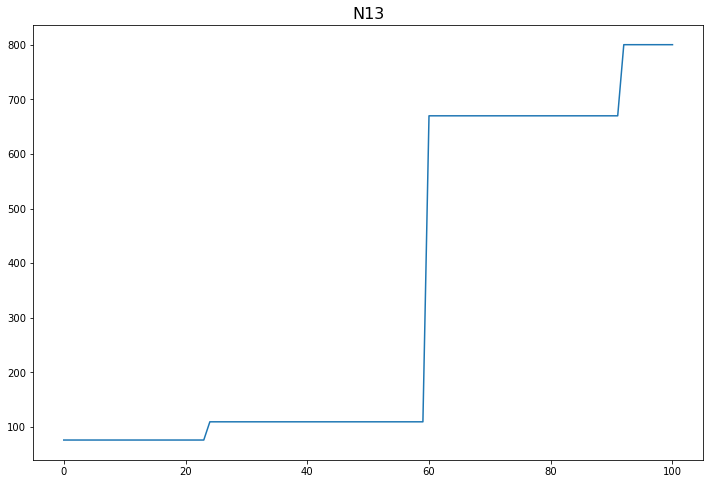

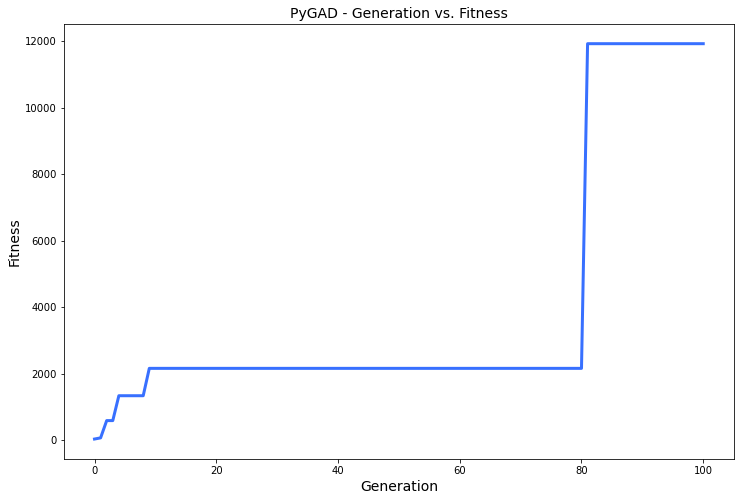

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.17 |==================| 4.942 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.277 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.215 |==================| 6.357 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.745 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.244 |==================| 1.225 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.059 |==================| 0.998 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.87 |==================| 0.839 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.609 |==================| 2.21 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.462 |==================| 1.669 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.08 |==================| 1.019 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.289 |==================| 1.295 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.82 |==================| 4.145 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.828 |==================| 4.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.418 |==================| 1.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.396 |==================| 1.505 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.407 |==================| 1.529 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.86 |==================| 4.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.71 |==================| 2.849 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.131 |==================| 1.075 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.691 |==================| 2.702 |==========| N14 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.722 |==================| 2.952 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.263 |==================| 1.254 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.627 |==================| 2.303 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.862 |==================| 0.834 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.89 |==================| 0.854 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.002 |==================| 17.042 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.962 |==================| 0.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.017 |==================| 22.508 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.006 |==================| 18.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.018 |==================| 0.959 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.145 |==================| 1.091 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.706 |==================| 2.814 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.925 |==================| 0.881 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.649 |==================| 2.429 |==========| N14 |==========
**********************************************************************
Fitness = 36.463530792676785
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.302 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.353 |==================| 1.412 |==========| N14 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.016 |==================| 22.363 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.443 |==================| 1.618 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.512 |==================| 1.82 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.243 |==================| 1.223 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.447 |==================| 1.629 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.344 |==================| 1.395 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.099 |==================| 1.039 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.966 |==================| 10.504 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.918 |==================| 0.875 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.735 |==================| 3.068 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.824 |==================| 4.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.533 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.857 |==================| 4.892 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.79 |==================| 3.696 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.127 |==================| 1.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.998 |==================| 15.867 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.019 |===========| 23.825 |==================| 0.809 |==========| N14 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.052 |==================| 0.991 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.781 |==================| 3.576 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.288 |==================| 1.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.86 |==================| 4.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.622 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.636 |==================| 2.352 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.178 |==================| 1.132 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.743 |==================| 3.145 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.967 |==================| 10.684 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.369 |==================| 1.445 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.009 |==================| 19.124 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.862 |==================| 5.02 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.353 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.99 |==================| 0.933 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.033 |==================| 35.44 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.081 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.883 |==================| 5.605 |==========| N14 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.013 |==================| 0.954 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.54 |==================| 1.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.645 |==================| 2.405 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.919 |==================| 7.051 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.594 |==================| 2.142 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.847 |==================| 4.683 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.496 |==================| 1.769 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.341 |==================| 1.389 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.786 |==================| 3.642 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.928 |==================| 7.521 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.824 |==================| 4.216 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.854 |==================| 4.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.254 |==================| 1.24 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.987 |==================| 0.931 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.948 |==================| 0.899 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.856 |==================| 4.869 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.03 |==================| 0.97 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.098 |==================| 1.039 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.476 |==================| 1.709 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.426 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.168 |==================| 1.12 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.197 |==================| 1.157 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.53 |==================| 1.882 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.007 |==================| 18.547 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.976 |==================| 11.693 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.695 |==================| 2.734 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.738 |==================| 3.101 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.755 |==================| 3.265 |==========| N14 |==========
**********************************************************************
Fitness = 36.463530792676785
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 23.85 |==================| 0.825 |==========| N14 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.471 |==================| 1.694 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.071 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.159 |==================| 1.109 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.794 |==================| 3.739 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.561 |==================| 2.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.396 |==================| 1.505 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.862 |==================| 0.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.872 |==================| 0.841 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.599 |==================| 2.165 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.57 |==================| 2.035 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.396 |==================| 1.503 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.804 |==================| 3.892 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.05 |==================| 92.219 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.049 |==================| 0.988 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.837 |==================| 4.455 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 24.012 |==================| 0.953 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.374 |==================| 1.456 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.157 |==================| 1.107 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.181 |==================| 1.136 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.458 |==================| 1.659 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.075 |==================| 1.014 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.67 |==================| 2.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.662 |==================| 2.504 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.237 |==================| 1.214 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.935 |==================| 0.888 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.656 |==================| 2.472 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.992 |==================| 0.935 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.992 |==================| 14.463 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 51.327 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.637 |==================| 2.358 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 23.959 |==================| 0.908 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 24.188 |==================| 1.145 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.099 |==================| 1.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.077 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 25.057 |==================| 239.239 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.738 |==================| 3.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.943 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.343 |==================| 1.393 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.097 |==================| 1.037 |==========| N14 |==========
**********************************************************************
Change = 68.76520545450703
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.801 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.869 |==================| 5.204 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.034 |==================| 0.973 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 308.005 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.302 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.616 |==================| 2.247 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.888 |==================| 0.852 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.87 |==================| 0.84 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.822 |==================| 4.189 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.068 |==================| 1.007 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.007 |==================| 18.552 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.771 |==================| 3.453 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.667 |==================| 2.54 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.845 |==================| 4.636 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.516 |==================| 1.835 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.938 |==================| 8.132 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.748 |==================| 3.195 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 23.935 |==================| 0.888 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.895 |==================| 6.033 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.892 |==================| 5.912 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.905 |==================| 6.423 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.948 |==================| 8.841 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.682 |==================| 2.639 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.655 |==================| 2.464 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.262 |==================| 1.252 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.703 |==================| 2.79 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.821 |==================| 4.159 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.537 |==================| 1.907 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.701 |==================| 2.777 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.596 |==================| 2.15 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.885 |==================| 0.85 |==========| N14 |==========
**********************************************************************
Fitness = 308.0046145313109
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.262 |==================| 1.252 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.983 |==================| 12.786 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.74 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.548 |==================| 1.949 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.971 |==================| 0.918 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.596 |==================| 2.149 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.214 |==================| 1.181 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.244 |==================| 1.223 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.973 |==================| 11.367 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.335 |==================| 1.378 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 25.0 |==================| 16.519 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.918 |==================| 7.0 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.63 |==================| 2.318 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.888 |==================| 0.853 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.957 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.724 |==================| 2.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.994 |==================| 0.938 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.369 |==================| 1.445 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.099 |==================| 1.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.907 |==================| 0.867 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.354 |==================| 1.415 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.751 |==================| 3.224 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.962 |==================| 10.138 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 24.011 |==================| 0.952 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.578 |==================| 2.07 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.51 |==================| 1.813 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.757 |==================| 3.29 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.135 |==================| 1.08 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.568 |==================| 2.029 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.995 |==================| 0.938 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.752 |==================| 3.237 |==========| N14 |==========
**********************************************************************
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.104 |==================| 1.045 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.27 |==================| 1.265 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.569 |==================| 2.033 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.743 |==================| 3.148 |==========| N14 |==========
**********************************************************************
=

======| 0.452 |===========| 24.575 |==================| 2.057 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.886 |==================| 5.714 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.809 |==================| 3.974 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 25.016 |==================| 22.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.948 |==================| 0.899 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.753 |==================| 3.245 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.288 |==================| 1.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.531 |==================| 1.886 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.974 |==================| 0.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.203 |==================| 1.166 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.253 |==================| 1.237 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.193 |==================| 1.152 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.787 |==================| 3.648 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.014 |==================| 0.955 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.513 |==================| 1.825 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.416 |==================| 1.55 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.433 |==================| 1.593 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.052 |==================| 0.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.966 |==================| 10.486 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.587 |==================| 2.111 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.201 |==================| 1.163 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 23.91 |==================| 0.869 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.012 |==================| 20.202 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.803 |==================| 3.871 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.731 |==================| 3.028 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.265 |==================| 1.257 |==========| N14 |==========
**********************************************************************
Fitness = 308.0046145313109
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 24.357 |==================| 1.421 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.003 |==================| 17.301 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.504 |==================| 1.797 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.678 |==================| 2.614 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.045 |==================| 0.985 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.372 |==================| 1.451 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.083 |==================| 1.023 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.855 |==================| 4.843 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.422 |==================| 1.566 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.3 |==================| 1.314 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.905 |==================| 6.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.007 |==================| 18.408 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.372 |==================| 1.451 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.468 |==================| 1.686 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.971 |==================| 0.917 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.656 |==================| 2.468 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.939 |==================| 0.891 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.255 |==================| 1.241 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.105 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.714 |==================| 2.881 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.802 |==================| 3.862 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.557 |==================| 1.985 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.069 |==================| 1.008 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.027 |==================| 28.997 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.82 |==================| 4.147 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.726 |==================| 2.984 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.95 |==================| 8.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.945 |==================| 8.622 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.953 |==================| 9.224 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.651 |==================| 2.437 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.939 |==================| 0.891 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.534 |==================| 1.897 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.693 |==================| 2.718 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.068 |==================| 1.007 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.692 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.954 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.297 |==================| 1.309 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.556 |==================| 1.978 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.562 |==================| 2.005 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.43 |==================| 1.586 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 25.001 |==================| 16.58 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.265 |==================| 1.256 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.247 |==================| 1.229 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.325 |==================| 1.358 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.552 |==================| 1.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.648 |==================| 2.422 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.099 |==================| 1.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.438 |==================| 1.604 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.332 |==================| 1.372 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 25.018 |==================| 23.275 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.268 |==================| 1.261 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.982 |==================| 0.926 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.94 |==================| 8.23 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.696 |==================| 2.736 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.353 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.984 |==================| 0.928 |==========| N14 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.13 |==================| 1.075 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.006 |==================| 18.165 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.89 |==================| 5.844 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.499 |==================| 1.779 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.83 |==================| 4.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.725 |==================| 2.977 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.958 |==================| 9.696 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.222 |==================| 1.192 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.598 |==================| 2.161 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.735 |==================| 3.072 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.405 |==================| 1.525 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.007 |==================| 0.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.751 |==================| 3.222 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.289 |==================| 1.296 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.338 |==================| 1.384 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.256 |==================| 1.243 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.994 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.958 |==================| 0.907 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.905 |==================| 6.427 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.289 |==================| 1.296 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.913 |==================| 6.761 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.201 |==================| 1.163 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.381 |==================| 1.47 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.562 |==================| 2.004 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.737 |==================| 3.086 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.603 |==================| 2.182 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.114 |==================| 1.056 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.981 |==================| 12.424 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.928 |==================| 7.544 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.728 |==================| 2.999 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.749 |==================| 3.209 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.003 |==================| 17.167 |==========| N14 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.795 |==================| 3.759 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.287 |==================| 1.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.741 |==================| 3.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.483 |==================| 1.73 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.534 |==================| 1.896 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.114 |==================| 1.056 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.941 |==================| 0.893 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.713 |==================| 2.872 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.723 |==================| 2.954 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.005 |==================| 17.963 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.179 |==================| 1.134 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.573 |==================| 2.051 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.389 |==================| 1.489 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.99 |==================| 13.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.977 |==================| 11.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.072 |==================| 1.011 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.689 |==================| 2.684 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.693 |==================| 2.719 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.871 |==================| 5.253 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.458 |==================| 1.658 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.368 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.721 |==================| 2.943 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.669 |==================| 2.552 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.945 |==================| 8.641 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.463 |==================| 1.672 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.317 |==================| 1.344 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.295 |==================| 1.305 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.499 |==================| 1.778 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.354 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.803 |==================| 3.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.257 |==================| 1.243 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.28 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.963 |==================| 10.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.902 |==================| 0.863 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.965 |==================| 0.912 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.295 |==================| 1.305 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.954 |==================| 0.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.48 |==================| 1.721 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.786 |==================| 3.636 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.435 |==================| 1.596 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.37 |==================| 1.447 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.991 |==================| 0.935 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 25.053 |==================| 123.69 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.896 |==================| 6.052 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.556 |==================| 1.98 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.378 |==================| 1.463 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.289 |==================| 1.295 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.899 |==================| 6.177 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.492 |==================| 1.759 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.888 |==================| 0.853 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.912 |==================| 0.871 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.592 |==================| 2.134 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.484 |==================| 1.732 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.816 |==================| 4.073 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.948 |==================| 8.869 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.359 |==================| 1.424 |==========| N14 |==========
**********************************************************************
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.102 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.203 |==================| 1.165 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.558 |==================| 1.987 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.79 |==================| 3.687 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.517 |==================| 1.839 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.582 |==================| 2.088 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.115 |==================| 1.057 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.674 |==================| 2.583 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.431 |==================| 1.588 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.016 |==================| 0.957 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.81 |==================| 3.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.039 |==================| 0.978 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.944 |==================| 8.519 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.501 |==================| 1.787 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.221 |==================| 1.191 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.145 |==================| 1.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.983 |==================| 0.928 |==========| N14 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.847 |==================| 4.677 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.539 |==================| 1.914 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.505 |==================| 1.799 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.284 |==================| 1.286 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.604 |==================| 2.19 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.78 |==================| 3.565 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.917 |==================| 6.945 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.841 |==================| 4.541 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.846 |==================| 4.649 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.044 |==================| 0.983 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.402 |==================| 1.517 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.483 |==================| 1.729 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.308 |==================| 1.327 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.855 |==================| 0.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.639 |==================| 2.371 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.801 |==================| 3.851 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.505 |==================| 1.798 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.937 |==================| 8.076 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.115 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.369 |==================| 1.444 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.384 |==================| 1.478 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.122 |==================| 1.065 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.175 |==================| 1.128 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.862 |==================| 0.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.558 |==================| 1.989 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.696 |==================| 2.742 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.998 |==================| 0.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.31 |==================| 1.331 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.795 |==================| 3.765 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.357 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.566 |==================| 2.019 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.696 |==================| 2.737 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.155 |==================| 1.104 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.397 |==================| 1.505 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.986 |==================| 0.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.587 |==================| 2.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.666 |==================| 2.531 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.439 |==================| 1.608 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.035 |==================| 0.975 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.993 |==================| 14.651 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.706 |==================| 2.814 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.017 |==================| 22.551 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.988 |==================| 13.662 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.702 |==================| 2.782 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.941 |==================| 0.893 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.688 |==================| 2.68 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.395 |==================| 1.501 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.549 |==================| 1.955 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.728 |==================| 3.003 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.739 |==================| 3.104 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.753 |==================| 3.241 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.99 |==================| 0.934 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.401 |==================| 1.515 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.592 |==================| 2.13 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.906 |==================| 6.469 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.659 |==================| 2.49 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.91 |==================| 6.627 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.562 |==================| 2.003 |==========| N14 |==========
**********************************************************************
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.155 |==================| 1.104 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.834 |==================| 4.399 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.725 |==================| 2.977 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.272 |==================| 1.267 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.019 |==================| 23.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.248 |==================| 1.23 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.707 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.154 |==================| 1.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.578 |==================| 2.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.622 |==================| 2.28 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.935 |==================| 0.888 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.881 |==================| 5.568 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.957 |==================| 9.614 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.54 |==================| 1.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.558 |==================| 1.99 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 25.046 |==================| 65.712 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.867 |==================| 0.838 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.51 |==================| 1.814 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.993 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.737 |==================| 3.09 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.972 |==================| 11.295 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.245 |==================| 1.225 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.708 |==================| 2.83 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.898 |==================| 0.86 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.962 |==================| 10.069 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.589 |==================| 2.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.525 |==================| 1.866 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.069 |==================| 1.008 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.635 |==================| 2.345 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.939 |==================| 0.891 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.656 |==================| 2.468 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.285 |==================| 1.289 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.445 |==================| 1.625 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.03 |==================| 31.979 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.047 |==================| 70.91 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.484 |==================| 1.734 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.631 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.951 |==================| 9.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.238 |==================| 1.215 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.014 |==================| 0.955 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.863 |==================| 5.051 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.913 |==================| 6.771 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.462 |==================| 1.668 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.433 |==================| 1.593 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.517 |==================| 1.837 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.63 |==================| 2.321 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.158 |==================| 1.108 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.101 |==================| 1.042 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.403 |==================| 1.519 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.039 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.217 |==================| 1.185 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.153 |==================| 1.102 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.541 |==================| 1.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.1 |==================| 1.041 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.087 |==================| 1.026 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.885 |==================| 0.851 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.635 |==================| 2.345 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.988 |==================| 13.781 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.388 |==================| 1.485 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.118 |==================| 1.06 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.192 |==================| 1.151 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.301 |==================| 1.315 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.528 |==================| 1.875 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.551 |==================| 1.959 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.472 |==================| 1.698 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.793 |==================| 3.734 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.886 |==================| 5.723 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.203 |==================| 1.166 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.629 |==================| 2.314 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.606 |==================| 2.195 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.719 |==================| 2.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.282 |==================| 1.284 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.007 |==================| 18.544 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.879 |==================| 5.482 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.904 |==================| 0.864 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.276 |==================| 1.274 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.735 |==================| 3.065 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.055 |==================| 169.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.614 |==================| 2.237 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.922 |==================| 0.878 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.484 |==================| 1.733 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.438 |==================| 1.605 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.064 |==================| 1.003 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.662 |==================| 2.506 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.15 |==================| 1.097 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.84 |==================| 4.525 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.205 |==================| 1.168 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.97 |==================| 10.931 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.236 |==================| 1.211 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.725 |==================| 2.979 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.86 |==================| 4.974 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 25.046 |==================| 66.817 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.717 |==================| 2.906 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.035 |==================| 0.975 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.629 |==================| 2.314 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.73 |==================| 3.02 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.753 |==================| 3.247 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 23.919 |==================| 0.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.654 |==================| 2.455 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.427 |==================| 1.578 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.56 |==================| 1.998 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.807 |==================| 3.934 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.076 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 25.026 |==================| 28.36 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.822 |==================| 4.192 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.59 |==================| 2.124 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.873 |==================| 0.842 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.185 |==================| 1.141 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.163 |==================| 1.114 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.734 |==================| 3.056 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.964 |==================| 10.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.984 |==================| 0.928 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.65 |==================| 2.433 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.167 |==================| 1.118 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.804 |==================| 3.884 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.057 |==================| 224.151 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.887 |==================| 0.852 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.891 |==================| 0.855 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.461 |==================| 1.668 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.708 |==================| 2.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.891 |==================| 0.854 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.066 |==================| 1.005 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.603 |==========| N14 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.663 |==================| 2.516 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.319 |==================| 1.348 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.212 |==================| 1.178 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.548 |==================| 1.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.768 |==================| 3.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.642 |==================| 2.388 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.855 |==================| 0.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.196 |==================| 1.156 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.254 |==================| 1.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.106 |==================| 1.047 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.141 |==================| 1.087 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.622 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.456 |==================| 1.653 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.323 |==================| 1.355 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.16 |==================| 1.11 |==========| N14 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.29 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.368 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.493 |==================| 1.762 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.485 |==================| 1.736 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.832 |==================| 4.373 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.781 |==================| 3.572 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.832 |==================| 4.367 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.785 |==================| 3.628 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.712 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.321 |==================| 1.352 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.316 |==================| 1.342 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.938 |==================| 8.127 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.139 |==================| 1.084 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.784 |==================| 3.608 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.022 |==================| 0.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.808 |==================| 3.958 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.996 |==================| 15.451 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.178 |==================| 1.133 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.583 |==================| 2.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.213 |==================| 1.179 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.753 |==================| 3.242 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.014 |==================| 21.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.789 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.139 |==================| 1.085 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.733 |==================| 3.048 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.863 |==================| 0.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.153 |==================| 1.101 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.442 |==================| 1.614 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.334 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.387 |==================| 1.485 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.853 |==================| 4.816 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.095 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.158 |==================| 1.107 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.365 |==================| 1.437 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.613 |==================| 2.232 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.024 |==================| 0.965 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.995 |==================| 0.938 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.308 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.235 |==================| 1.21 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.809 |==================| 3.973 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.359 |==================| 1.424 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.946 |==================| 8.73 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.965 |==================| 0.913 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.862 |==================| 0.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.98 |==================| 0.925 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.043 |==================| 56.104 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.455 |==================| 1.651 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.821 |==================| 4.158 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.033 |==================| 35.293 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.978 |==================| 12.106 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.514 |==================| 1.827 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.524 |==================| 1.863 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.959 |==================| 9.774 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.377 |==================| 1.462 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.099 |==================| 1.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.991 |==================| 14.347 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.763 |==================| 3.361 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.942 |==================| 8.432 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.599 |==================| 2.165 |==========| N14 |==========
**********************************************************************
Generation = 61
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.65 |==================| 2.435 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 52.091 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.403 |==================| 1.52 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.786 |==================| 3.642 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.156 |==================| 1.105 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.551 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 357.436 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.845 |==================| 4.622 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.522 |==================| 1.855 |==========| N14 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.426 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 25.045 |==================| 61.609 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.965 |==================| 10.458 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.46 |==================| 1.663 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.414 |==================| 1.545 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.755 |==================| 3.269 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.646 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.354 |==================| 1.415 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.702 |==================| 2.787 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.899 |==================| 6.19 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.393 |==================| 1.498 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.387 |==================| 1.484 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.15 |==================| 1.098 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.687 |==================| 2.673 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.325 |==================| 1.359 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.785 |==================| 3.622 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.11 |==================| 1.052 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.325 |==================| 1.359 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.398 |==================| 1.509 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.892 |==================| 5.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.724 |==================| 2.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.573 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.518 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.551 |==================| 1.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.65 |==================| 2.433 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.321 |==================| 1.351 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.29 |==================| 1.298 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.759 |==================| 3.307 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.814 |==================| 4.044 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.387 |==================| 1.483 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.861 |==================| 4.999 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.248 |==================| 1.229 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.394 |==================| 1.499 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.741 |==================| 3.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.767 |==================| 3.403 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.924 |==================| 7.28 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.015 |==================| 21.721 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.998 |==================| 15.989 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.573 |==================| 2.05 |==========| N14 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.173 |==================| 1.127 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.972 |==================| 11.222 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.229 |==================| 1.203 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.908 |==================| 6.521 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.281 |==================| 1.281 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 25.04 |==================| 48.263 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.88 |==================| 0.846 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.939 |==================| 8.2 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.262 |==================| 1.251 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.902 |==================| 0.863 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.631 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.923 |==================| 7.269 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.946 |==================| 8.729 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.421 |==================| 1.563 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.989 |==================| 0.933 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.636 |==================| 2.35 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.829 |==================| 4.314 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.277 |==================| 1.275 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.5 |==================| 1.782 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.714 |==================| 2.881 |==========| N14 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.966 |==================| 0.913 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.947 |==================| 8.735 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.035 |==================| 37.804 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.14 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.583 |==================| 2.09 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.094 |==================| 1.034 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.571 |==================| 2.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.938 |==================| 8.124 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.685 |==================| 2.662 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.398 |==================| 1.509 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.988 |==================| 13.785 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.015 |==================| 21.542 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.919 |==================| 7.061 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.704 |==================| 2.799 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.883 |==================| 5.63 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.986 |==================| 13.351 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.578 |==================| 2.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.53 |==================| 1.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.602 |==================| 2.18 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.006 |==================| 0.948 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.613 |==================| 2.234 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.765 |==================| 3.373 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.252 |==================| 1.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.224 |==================| 1.194 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.887 |==================| 5.751 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.401 |==================| 1.516 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.033 |==================| 35.192 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.876 |==================| 0.844 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.737 |==================| 3.087 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.924 |==================| 7.31 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.03 |==================| 32.552 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.087 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.893 |==================| 0.856 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.951 |==================| 9.07 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.659 |==================| 2.486 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.44 |==================| 1.611 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.527 |==================| 1.872 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.721 |==================| 2.942 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.448 |==================| 1.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.52 |==================| 1.849 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.596 |==================| 2.15 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.303 |==================| 1.319 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.972 |==================| 0.918 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.103 |==================| 1.044 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.256 |==================| 1.242 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.346 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.845 |==================| 4.635 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.5 |==================| 1.784 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.744 |==================| 3.156 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.39 |==================| 1.49 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.953 |==================| 0.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.049 |==================| 0.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.244 |==================| 1.224 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.67 |==================| 2.557 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.632 |==================| 2.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.862 |==================| 5.035 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.359 |==================| 1.425 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.612 |==================| 2.228 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.493 |==================| 1.762 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 363.718 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.057 |==================| 230.825 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.626 |==================| 2.3 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 25.007 |==================| 18.505 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.786 |==================| 3.636 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.463 |==================| 1.673 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.719 |==================| 2.926 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.695 |==================| 2.733 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 25.038 |==================| 44.334 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 25.003 |==================| 17.353 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.802 |==================| 3.854 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.786 |==================| 3.638 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.422 |==================| 1.566 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.939 |==================| 8.172 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.106 |==================| 1.047 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.836 |==================| 4.442 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.525 |==================| 1.867 |==========| N14 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.051 |==================| 0.99 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.242 |==================| 1.221 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.986 |==================| 0.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.82 |==================| 4.144 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.953 |==================| 9.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.805 |==================| 3.909 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.349 |==================| 1.405 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.508 |==================| 1.809 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.379 |==================| 1.466 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.592 |==================| 2.132 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.502 |==================| 1.79 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.877 |==================| 5.431 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.0 |==================| 0.943 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 23.911 |==================| 0.869 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.351 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.548 |==================| 1.949 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.735 |==================| 3.064 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.235 |==================| 1.211 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.462 |==================| 1.668 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.781 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.39 |==================| 1.491 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.358 |==================| 1.423 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.201 |==================| 1.163 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.679 |==================| 2.617 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.99 |==================| 14.138 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.974 |==================| 0.92 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.12 |==================| 1.062 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.11 |==================| 1.051 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.887 |==================| 5.744 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.085 |==================| 1.024 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.553 |==================| 1.969 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.017 |==================| 0.958 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.344 |==================| 1.394 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.905 |==================| 0.865 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.367 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.811 |==================| 4.005 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.872 |==================| 5.288 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.617 |==================| 2.254 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.672 |==================| 2.569 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.633 |==================| 2.335 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.158 |==================| 1.107 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.938 |==================| 0.891 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.367 |==================| 1.441 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.933 |==================| 7.838 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.797 |==================| 3.786 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.446 |==================| 1.625 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.67 |==================| 2.555 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.895 |==================| 0.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.747 |==================| 3.189 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.049 |==================| 85.709 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 24.722 |==================| 2.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.694 |==================| 2.723 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.632 |==================| 2.331 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.417 |==================| 1.553 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.873 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.033 |==================| 35.937 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.985 |==================| 13.123 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.029 |==================| 0.969 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.665 |==================| 2.526 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.805 |==================| 3.907 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.793 |==================| 3.726 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.081 |==================| 1.021 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.88 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.86 |==================| 0.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.709 |==================| 2.838 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.167 |==================| 1.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.131 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.894 |==================| 0.857 |==========| N14 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.885 |==================| 5.666 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.387 |==================| 1.484 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.383 |==================| 1.476 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.707 |==================| 2.821 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.125 |==================| 1.069 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.581 |==================| 2.084 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.591 |==================| 2.129 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.581 |==================| 2.085 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.878 |==================| 5.476 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.943 |==================| 8.453 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.473 |==================| 1.702 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.693 |==================| 2.719 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.207 |==================| 1.17 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.03 |==================| 0.97 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 25.023 |==================| 26.062 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.342 |==================| 1.391 |==========| N14 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.067 |==================| 1.006 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.592 |==================| 2.133 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.882 |==================| 5.579 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.449 |==================| 1.633 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.561 |==================| 2.001 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.97 |==================| 0.916 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.654 |==================| 2.457 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.599 |==================| 2.163 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.332 |==================| 1.371 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.941 |==================| 0.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.95 |==================| 9.009 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 25.025 |==================| 28.122 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.49 |==================| 1.751 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.076 |==================| 1.015 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.95 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.882 |==================| 0.848 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.406 |==================| 1.526 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.071 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.277 |==================| 1.276 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.312 |==================| 1.336 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.04 |==================| 0.98 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.304 |==================| 1.32 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.177 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.644 |==================| 2.397 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.009 |==================| 19.206 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.863 |==================| 5.049 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.439 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.229 |==================| 1.202 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.059 |==================| 0.998 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.117 |==================| 1.06 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.92 |==================| 7.108 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.844 |==================| 4.614 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 23.988 |==================| 0.932 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.154 |==================| 1.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.043 |==================| 55.02 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.327 |==================| 1.362 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 25.025 |==================| 27.879 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.718 |==================| 2.917 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.993 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.404 |==================| 1.522 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.082 |==================| 1.021 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.034 |==================| 0.974 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.054 |==================| 145.805 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 23.884 |==================| 0.85 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.489 |==================| 1.749 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.787 |==================| 3.644 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.138 |==================| 1.084 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.788 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.697 |==================| 2.748 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.98 |==================| 0.925 |==========| N14 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.157 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.906 |==================| 0.866 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.839 |==================| 4.494 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.513 |==================| 1.823 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.886 |==================| 5.713 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.919 |==================| 7.033 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.168 |==================| 1.12 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.962 |==================| 0.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.291 |==================| 1.299 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.261 |==================| 1.25 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.687 |==================| 2.672 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.542 |==================| 1.925 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.574 |==================| 2.052 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.283 |==================| 1.286 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.706 |==================| 2.82 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.019 |==================| 23.935 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.341 |==================| 1.389 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.969 |==================| 10.813 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.209 |==================| 1.174 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.16 |==================| 1.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.367 |==================| 1.442 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.867 |==================| 0.838 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.382 |==================| 1.473 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.679 |==================| 2.618 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.627 |==================| 2.304 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.822 |==================| 4.175 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.092 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.8 |==================| 3.836 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.502 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.059 |==================| 0.998 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.433 |==================| 1.593 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.024 |==================| 26.785 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.236 |==================| 1.212 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.52 |==================| 1.847 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.908 |==================| 0.867 |==========| N14 |==========
**********************************************************************
=

======| 0.976 |===========| 23.886 |==================| 0.851 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.813 |==================| 4.037 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.606 |==================| 2.199 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.432 |==================| 1.591 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.946 |==================| 0.897 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.469 |==================| 1.69 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.375 |==================| 1.457 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.063 |==================| 1.001 |==========| N14 |==========
**********************************************************************
==

**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.292 |==================| 1.3 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.502 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.869 |==================| 5.219 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.947 |==================| 8.796 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.923 |==================| 7.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.168 |==================| 1.119 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.133 |==================| 1.077 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.726 |==================| 2.983 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.808 |==================| 3.954 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.503 |==================| 1.792 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.996 |==================| 15.269 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.409 |==================| 1.535 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.645 |==================| 2.406 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.992 |==================| 0.936 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.062 |==================| 1.001 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.465 |==================| 1.678 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.488 |==================| 1.747 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.966 |==================| 0.913 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.674 |==================| 2.584 |==========| N14 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.928 |==================| 7.526 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.529 |==================| 1.88 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.642 |==================| 2.388 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.807 |==================| 3.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.356 |==================| 1.418 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.422 |==================| 1.564 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.631 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.798 |==================| 3.799 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.199 |==================| 1.16 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.995 |==================| 15.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.741 |==================| 3.128 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.338 |==================| 1.383 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.002 |==================| 0.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.712 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.652 |==================| 2.446 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.897 |==================| 6.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.993 |==================| 0.936 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.745 |==================| 3.166 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.547 |==================| 1.946 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.428 |==================| 1.579 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.978 |==================| 11.986 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.551 |==================| 1.959 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.687 |==================| 2.673 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.111 |==================| 1.052 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.875 |==================| 0.843 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.059 |==================| 0.998 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.705 |==================| 2.806 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.301 |==================| 1.316 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.829 |==================| 4.303 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.687 |==================| 2.673 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.441 |==================| 1.612 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.91 |==================| 0.868 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.989 |==================| 13.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.527 |==================| 1.872 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.706 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.493 |==================| 1.761 |==========| N14 |==========
**********************************************************************
Fitness = 3143.0616101562564
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.378 |==================| 1.464 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.644 |==================| 2.398 |==========| N14 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.677 |==================| 2.604 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.688 |==================| 2.681 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.212 |==================| 1.178 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.069 |==================| 1.008 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.353 |==================| 1.412 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.294 |==================| 1.304 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.007 |==================| 18.671 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.99 |==================| 14.034 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.46 |==================| 1.663 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.589 |==================| 2.118 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.526 |==================| 1.871 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.925 |==================| 7.326 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 23.959 |==================| 0.907 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.603 |==================| 2.184 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.573 |==================| 2.05 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.022 |==================| 0.962 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.384 |==================| 1.477 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.695 |==================| 2.731 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.867 |==================| 5.141 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.859 |==================| 0.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.804 |==================| 3.887 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.451 |==================| 1.639 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.855 |==================| 0.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.063 |==================| 1.002 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.467 |==================| 1.685 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.864 |==================| 5.086 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.235 |==================| 1.21 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.686 |==================| 2.664 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.837 |==================| 4.473 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.49 |==================| 1.751 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.877 |==================| 5.443 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.674 |==================| 2.581 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.525 |==================| 1.864 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.861 |==================| 0.833 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.935 |==================| 0.888 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.819 |==================| 4.137 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.055 |==================| 170.156 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.128 |==================| 1.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.289 |==================| 1.296 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.965 |==================| 0.913 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.405 |==================| 1.525 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.355 |==================| 1.416 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.715 |==================| 2.888 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.256 |==================| 1.243 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.925 |==================| 7.36 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.416 |==================| 1.549 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.091 |==================| 1.031 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.051 |==================| 103.298 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.054 |==================| 151.016 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.108 |==================| 1.05 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.151 |==================| 1.098 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.989 |==================| 0.933 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.951 |==================| 0.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.955 |==================| 9.39 |==========| N14 |==========
**********************************************************************
==

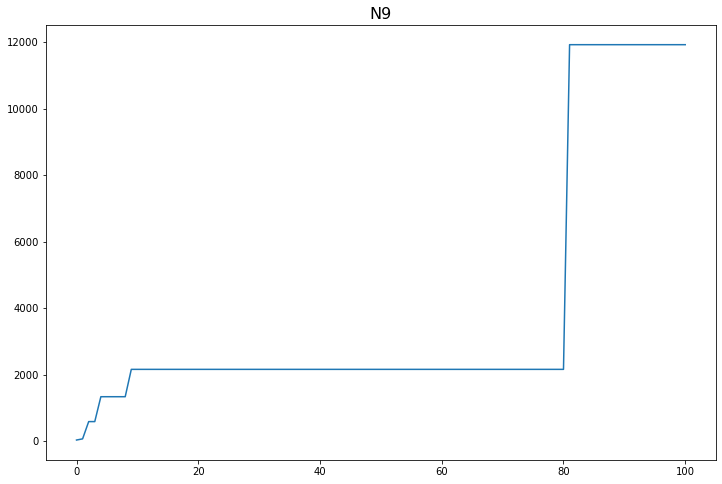

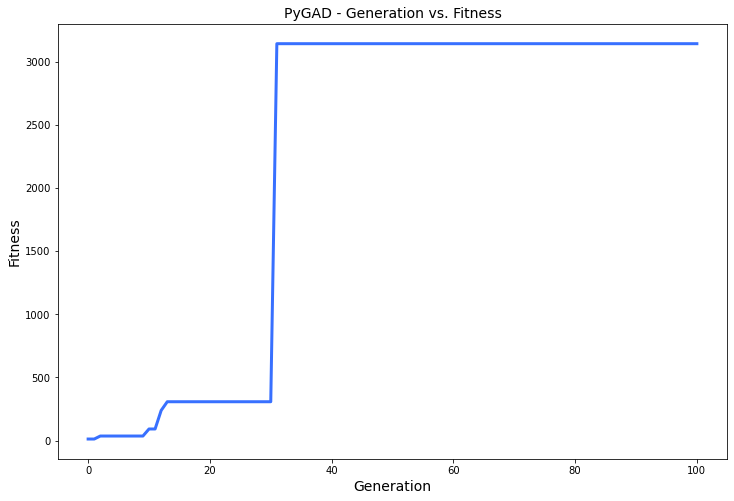

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.17 |==================| 1.123 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.013 |==================| 0.954 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.738 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.081 |==================| 1.02 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.774 |==================| 4.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 28.816 |==================| 5.434 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.698 |==================| 3.31 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.085 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.519 |==================| 2.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.527 |==================| 2.114 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.767 |==================| 4.278 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.945 |==================| 18.204 |==========| N4 |==========
**********************************************************************
===

======| 0.613 |===========| 28.68 |==================| 3.119 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.013 |===========| 28.417 |==================| 1.714 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.753 |==================| 4.047 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.728 |==================| 3.67 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.778 |==================| 4.498 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.651 |==================| 2.865 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.55 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.794 |==================| 4.857 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.847 |==================| 6.511 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.493 |==================| 1.971 |==========| N4 |==========
**********************************************************************
Fitness = 131.98791403843745
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.946 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.576 |==================| 2.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.808 |==================| 5.186 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.127 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.043 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.739 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.981 |==================| 50.772 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.57 |==================| 2.324 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.132 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.579 |==================| 2.371 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.766 |==================| 4.273 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.989 |==================| 85.135 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.555 |==================| 2.246 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 28.79 |==================| 4.752 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.492 |==================| 1.968 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 54.129 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.512 |==================| 2.046 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.425 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.885 |==================| 8.663 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.452 |==================| 1.823 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.92 |==================| 12.409 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.599 |==================| 2.494 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.888 |==================| 8.892 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 28.691 |==================| 3.237 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.747 |==================| 3.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.524 |==================| 2.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.985 |==================| 65.013 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.47 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.286 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.575 |==================| 2.352 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.621 |==================| 2.633 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.77 |==================| 4.343 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.949 |==================| 19.639 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.026 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.801 |==================| 5.01 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.158 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.828 |==================| 5.809 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.869 |==================| 7.62 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.833 |==================| 5.972 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.723 |==================| 3.607 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.944 |==================| 17.902 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.835 |==================| 6.061 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.493 |==================| 1.97 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.712 |==================| 3.466 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.81 |==================| 5.251 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 28.544 |==================| 2.189 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.596 |==================| 2.473 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.524 |==================| 2.101 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.89 |==================| 9.048 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.735 |==================| 3.773 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 28.758 |==================| 4.124 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.93 |==================| 14.166 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.93 |==================| 14.257 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.829 |==================| 5.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.144 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.569 |==================| 2.317 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.453 |==================| 1.827 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.095 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.568 |==================| 2.316 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.694 |==================| 3.268 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.671 |==================| 3.036 |==========| N4 |==========
**********************************************************************
Fitness = 131.98791403843745
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.633 |==================| 2.72 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.533 |==================| 2.139 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.095 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.431 |==================| 1.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 28.53 |==================| 2.126 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.22 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.715 |==================| 3.507 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.835 |==================| 6.042 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.952 |==================| 20.498 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.612 |==================| 2.572 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 28.937 |==================| 15.908 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 334.961 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.56 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.561 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.462 |==================| 1.857 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.942 |==================| 17.157 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.893 |==================| 9.31 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.728 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.735 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.74 |==================| 3.834 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 28.57 |==================| 2.322 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.641 |==================| 2.781 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.92 |==================| 12.404 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.834 |==================| 6.027 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.24 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.735 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.443 |==================| 1.794 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.967 |==================| 29.861 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.613 |==================| 2.58 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.77 |==================| 4.337 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.985 |==================| 65.208 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.632 |==================| 2.716 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.986 |==================| 68.499 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.744 |==================| 3.903 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.834 |==================| 6.026 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.684 |==================| 3.161 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.704 |==================| 3.372 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.705 |==================| 3.383 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.891 |==================| 9.114 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.936 |==================| 15.506 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.495 |==================| 1.978 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.695 |==================| 3.271 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.561 |==================| 2.275 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.655 |==================| 2.898 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.614 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.602 |==================| 2.509 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.813 |==================| 5.337 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 53.795 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.902 |==================| 10.195 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.526 |==================| 2.109 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 53.658 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.896 |==================| 9.612 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.469 |==================| 1.883 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.565 |==================| 2.299 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.982 |==================| 55.547 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.522 |==================| 2.091 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.869 |==================| 7.609 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.597 |==================| 2.476 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 22.043 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.204 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.84 |==================| 6.231 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.879 |==================| 8.25 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 28.487 |==================| 1.946 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.461 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.59 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.918 |==================| 12.077 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.715 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.489 |==================| 1.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.868 |==================| 7.537 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.738 |==================| 3.814 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.814 |==================| 5.36 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.641 |==================| 2.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.461 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.853 |==================| 6.803 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.708 |==================| 3.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.537 |==================| 2.161 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.921 |==================| 12.678 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.655 |==================| 2.892 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.483 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.575 |==================| 2.349 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.47 |==================| 1.884 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.894 |==================| 9.445 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.679 |==================| 3.117 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.775 |==================| 4.437 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.82 |==================| 5.555 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.559 |==================| 2.266 |==========| N4 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.586 |==================| 2.415 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.938 |==================| 16.073 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.851 |==================| 6.708 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 28.927 |==================| 13.583 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.805 |==================| 5.107 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.91 |==================| 11.081 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.832 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.457 |==================| 1.841 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.662 |==================| 2.957 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.587 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.042 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.773 |==================| 4.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.9 |==================| 9.934 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.906 |==================| 10.598 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.797 |==================| 4.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.858 |==================| 7.005 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.588 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.64 |==================| 2.779 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.841 |==================| 6.274 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.567 |==================| 2.309 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.976 |==================| 40.508 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.913 |==================| 11.473 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.859 |==================| 7.069 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.566 |==================| 2.303 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.442 |==================| 1.792 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.783 |==================| 4.596 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.541 |==================| 2.176 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.14 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.491 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.628 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.703 |==================| 3.36 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.528 |==================| 2.117 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.499 |==================| 1.995 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.744 |==================| 3.903 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.671 |==================| 3.034 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.636 |==================| 2.746 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.942 |==================| 17.018 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.675 |==================| 3.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.641 |==================| 2.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.549 |==================| 2.216 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.034 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.597 |==================| 2.48 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 34.861 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.816 |==================| 5.418 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.672 |==================| 3.048 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.743 |==================| 3.893 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.525 |==================| 2.104 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.684 |==================| 3.161 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.682 |==================| 3.14 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.797 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.533 |==================| 2.14 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.657 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.461 |==================| 1.854 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.784 |==================| 4.632 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.544 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.983 |==================| 57.284 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 28.475 |==================| 1.903 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.454 |==================| 1.831 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 145.408 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.791 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.541 |==================| 2.179 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.62 |==================| 2.626 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.818 |==================| 5.478 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.462 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 21.973 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.657 |==================| 2.913 |==========| N4 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.803 |==================| 5.065 |==========| N4 |==========
*************************************************************

======| 0.792 |===========| 28.567 |==================| 2.307 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.584 |==================| 2.4 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.935 |==================| 15.322 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.729 |==================| 3.692 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.72 |==================| 3.573 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.67 |==================| 3.032 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.567 |==================| 2.307 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.584 |==================| 2.4 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.945 |==================| 17.959 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.757 |==================| 4.106 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.766 |==================| 4.267 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.403 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.398 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.119 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.853 |==================| 6.8 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 54.46 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.879 |==================| 8.217 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.794 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 35.312 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.584 |==================| 2.404 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.287 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.454 |==================| 1.829 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.883 |==================| 8.519 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 28.619 |==================| 2.624 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.784 |==================| 4.628 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.757 |==================| 4.116 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 28.527 |==================| 2.111 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.539 |==================| 2.169 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.848 |==================| 6.568 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.714 |==================| 3.491 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.58 |==================| 2.377 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.705 |==================| 3.384 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.816 |==================| 5.427 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.981 |==================| 51.008 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.929 |==================| 13.937 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.542 |==================| 2.183 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.976 |==================| 40.335 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.799 |==================| 4.966 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.72 |==================| 3.562 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.577 |==================| 2.364 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.784 |==================| 4.618 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.938 |==================| 16.051 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.64 |==================| 2.777 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.958 |==================| 23.528 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.454 |==================| 1.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.735 |==================| 3.774 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.942 |==================| 17.008 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.784 |==================| 4.618 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.902 |==================| 10.129 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.869 |==================| 7.603 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.445 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.854 |==================| 6.844 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.84 |==================| 6.222 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 21.963 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.87 |==================| 7.682 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.672 |==================| 3.042 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.975 |==================| 39.607 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.19 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.846 |==================| 6.474 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.672 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.947 |==================| 18.7 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.909 |==================| 10.952 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.723 |==================| 3.601 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 28.7 |==================| 3.33 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.746 |==================| 3.925 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.57 |==================| 2.326 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.878 |==================| 8.165 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.578 |==================| 2.37 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.52 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.569 |==================| 2.319 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.863 |==================| 7.261 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 106.013 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.804 |==================| 5.09 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.537 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.691 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.924 |==================| 13.101 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.904 |==================| 10.367 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 27.031 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.552 |==================| 2.228 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.804 |==================| 5.084 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 25.668 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.983 |==================| 57.385 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.803 |==================| 5.065 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.556 |==================| 2.253 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.845 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.83 |==================| 5.887 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.631 |==================| 2.711 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.705 |==================| 3.383 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.729 |==================| 3.681 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.688 |==================| 3.197 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.738 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.381 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.828 |==================| 5.807 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.921 |==================| 12.55 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.947 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.491 |==================| 1.965 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.162 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.986 |==================| 70.44 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.935 |==================| 15.373 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.48 |==================| 1.92 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.921 |==================| 12.55 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.448 |==================| 1.812 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.436 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.712 |==================| 3.467 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.754 |==================| 4.056 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.596 |==================| 2.471 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.826 |==================| 5.726 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.831 |==================| 5.904 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.966 |==================| 28.788 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.596 |==================| 2.473 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.602 |==================| 2.511 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 28.502 |==================| 2.005 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.899 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.7 |==================| 3.326 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.839 |==================| 6.199 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.923 |==================| 12.856 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.985 |==================| 66.766 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.586 |==================| 2.415 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.792 |==================| 4.807 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.438 |==================| 1.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 141.29 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.759 |==================| 4.152 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.463 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.553 |==================| 2.237 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.509 |==================| 2.034 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.607 |==================| 2.541 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 35.229 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.816 |==================| 5.422 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.772 |==================| 4.387 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.642 |==================| 2.788 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.846 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.677 |==================| 3.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.938 |==================| 16.084 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.871 |==================| 7.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.47 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.613 |==================| 2.58 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.462 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.834 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.929 |==================| 13.978 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.915 |==================| 11.691 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.531 |==================| 2.132 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.516 |==================| 2.063 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.92 |==================| 12.433 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.848 |==================| 6.55 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 28.868 |==================| 7.567 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 28.79 |==================| 4.752 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.964 |==================| 27.849 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.517 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.749 |==================| 3.981 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.597 |==================| 2.479 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.947 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.708 |==================| 3.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.902 |==================| 10.196 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.888 |==================| 8.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.67 |==================| 3.024 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.746 |==================| 3.936 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.639 |==================| 2.765 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.639 |==================| 2.771 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.46 |==================| 1.85 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.654 |==================| 2.885 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.737 |==================| 3.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.903 |==================| 10.236 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.652 |==================| 2.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.881 |==================| 8.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.841 |==================| 6.286 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.514 |==================| 2.057 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.809 |==================| 5.223 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.456 |==================| 1.837 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.737 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.675 |==================| 3.071 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 29.0 |==================| 1434.609 |==========| N4 |==========
**********************************************************************
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.572 |==================| 2.332 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.803 |==================| 5.075 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.595 |==================| 2.464 |==========| N4 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.236 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.756 |==================| 4.087 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.454 |==================| 1.831 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.5 |==================| 2.0 |==========| N4 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.561 |==================| 2.277 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.578 |==================| 2.371 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.974 |==================| 38.429 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.955 |==================| 22.154 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.873 |==================| 7.836 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.974 |==================| 37.382 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.638 |==================| 2.762 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.708 |==================| 3.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.496 |==================| 1.983 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.823 |==================| 5.643 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.803 |==================| 5.078 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.696 |==================| 3.286 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.538 |==================| 2.162 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.782 |==================| 4.584 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.966 |==================| 29.232 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.523 |==================| 2.095 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.777 |==================| 4.482 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.769 |==================| 4.325 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.693 |==================| 3.253 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.944 |==================| 17.67 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.694 |==================| 3.268 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.824 |==================| 5.684 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.893 |==================| 9.35 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.484 |==================| 1.936 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.587 |==================| 2.419 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.632 |==================| 2.713 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.949 |==================| 19.423 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.893 |==================| 9.276 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.848 |==================| 6.549 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.585 |==================| 2.406 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.482 |==================| 1.93 |==========| N4 |==========
**********************************************************************
Fitnes

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.565 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.928 |==================| 13.843 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.571 |==================| 2.331 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.693 |==================| 3.256 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.972 |==================| 35.177 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.637 |==================| 2.754 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.92 |==================| 12.523 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.925 |==================| 13.191 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.435 |==================| 1.769 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.936 |==================| 15.46 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.496 |==================| 1.982 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.95 |==================| 19.943 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.428 |==================| 1.747 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.689 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.65 |==================| 2.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.83 |==================| 5.874 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.541 |==================| 2.179 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.999 |==================| 578.639 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.552 |==================| 2.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.795 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.462 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.46 |==================| 1.851 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.919 |==================| 12.365 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.712 |==================| 3.464 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.516 |==================| 2.066 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.732 |==================| 3.73 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.444 |==================| 1.798 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 26.983 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.146 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.519 |==================| 2.076 |==========| N4 |==========
**********************************************************************
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.96 |==================| 24.735 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.568 |==================| 2.313 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.883 |==================| 8.53 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.647 |==================| 2.828 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.274 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 28.771 |==================| 4.36 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.767 |==================| 4.279 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.831 |==================| 5.9 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.803 |==================| 5.056 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.979 |==================| 47.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.779 |==================| 4.518 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.747 |==================| 3.946 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 28.427 |==================| 1.744 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.377 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.673 |==================| 3.059 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.687 |==================| 3.196 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.823 |==================| 5.644 |==========| N4 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.445 |==================| 1.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.713 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.377 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.836 |==================| 6.072 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.477 |==================| 1.91 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.801 |==================| 5.016 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.856 |==================| 6.927 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.509 |==================| 2.033 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.655 |==================| 2.899 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.531 |==================| 2.132 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.472 |==================| 1.894 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.711 |==================| 3.459 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.797 |==================| 4.926 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.554 |==================| 2.239 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.858 |==================| 7.041 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.607 |==================| 2.541 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.769 |==================| 4.322 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.634 |==================| 2.733 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.646 |==================| 2.826 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.953 |==================| 20.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.791 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.858 |==================| 7.041 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.831 |==================| 5.918 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.515 |==================| 2.062 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.689 |==================| 3.21 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.809 |==================| 5.224 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.579 |==================| 2.375 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.792 |==================| 4.8 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.48 |==================| 1.921 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.59 |==================| 2.435 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.488 |==================| 1.952 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.579 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.713 |==================| 3.483 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.769 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.844 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.734 |==================| 3.75 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.869 |==================| 7.63 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.857 |==================| 6.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.503 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.435 |==================| 1.77 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.564 |==================| 2.29 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.998 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.653 |==================| 2.875 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.531 |==================| 2.133 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 28.873 |==================| 7.881 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.512 |==================| 2.046 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.547 |==================| 2.208 |==========| N4 |==========
**********************************************************************
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.827 |==================| 5.763 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.942 |==================| 17.151 |==========| N4 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.831 |==================| 5.904 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.515 |==================| 2.061 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.552 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.855 |==================| 6.887 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.711 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.793 |==================| 4.818 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 325.653 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.802 |==================| 5.052 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.464 |==================| 1.866 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.97 |==================| 33.158 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.597 |==================| 2.479 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.917 |==================| 12.025 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.446 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.943 |==================| 17.44 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.654 |==================| 2.887 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.743 |==================| 3.89 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 28.486 |==================| 1.946 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.851 |==================| 6.717 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.776 |==================| 4.455 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.825 |==================| 5.712 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.541 |==================| 2.175 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.832 |==================| 5.926 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.932 |==================| 14.548 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.717 |==================| 3.523 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.253 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.787 |==================| 4.69 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.153 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.881 |==================| 8.407 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.739 |==================| 3.826 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.9 |==================| 10.013 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.718 |==================| 3.542 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 28.54 |==================| 2.174 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.988 |==================| 80.925 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.604 |==================| 2.524 |==========| N4 |==========
***********************************************

======| 0.75 |===========| 28.594 |==================| 2.461 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.583 |==================| 2.398 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.443 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.736 |==================| 3.787 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 28.782 |==================| 4.576 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.785 |==================| 4.645 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.823 |==================| 5.643 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.65 |==================| 2.852 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.966 |==================| 29.254 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.659 |==================| 2.933 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.868 |==================| 7.585 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.565 |==================| 2.299 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.9 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.486 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.137 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.911 |==================| 11.212 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.957 |==================| 23.143 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.618 |==================| 2.616 |==========| N4 |==========
**********************************************************************
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.888 |==================| 8.882 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.893 |==================| 9.343 |==========| N4 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.469 |==================| 1.884 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.783 |==================| 4.601 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.749 |==================| 3.98 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.559 |==================| 2.265 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.457 |==================| 1.839 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.52 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.756 |==================| 4.096 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.593 |==================| 2.452 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 28.862 |==================| 7.219 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.589 |==================| 2.429 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.929 |==================| 13.936 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.461 |==================| 1.853 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.907 |==================| 10.733 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.806 |==================| 5.146 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.95 |==================| 19.784 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.66 |==================| 2.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.768 |==================| 4.298 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.992 |==================| 120.888 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.036 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.604 |==================| 2.523 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.469 |==================| 1.882 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.926 |==================| 13.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.832 |==================| 5.926 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.662 |==================| 2.958 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.61 |==================| 2.56 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.82 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.857 |==================| 6.996 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.84 |==================| 6.244 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.837 |==================| 6.135 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.807 |==================| 5.182 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.561 |==================| 2.277 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.864 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.83 |==================| 5.887 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.578 |==================| 2.366 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.822 |==================| 5.618 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.855 |==================| 6.876 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.966 |==================| 29.556 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.761 |==================| 4.174 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.426 |==================| 1.741 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.797 |==================| 4.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.827 |==================| 5.756 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.76 |==================| 4.16 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.768 |==================| 4.296 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.959 |==================| 23.943 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.828 |==================| 5.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.656 |==================| 2.903 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.889 |==================| 9.012 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.631 |==================| 2.711 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.895 |==================| 9.515 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.844 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.841 |==================| 6.282 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.643 |==================| 2.795 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.768 |==================| 4.305 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.884 |==================| 8.607 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.49 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.209 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.667 |==================| 2.998 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.535 |==================| 2.149 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.687 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.91 |==================| 11.101 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.513 |==================| 2.05 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.691 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.761 |==================| 4.181 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.643 |==================| 2.799 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.639 |==================| 2.766 |==========| N4 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.983 |==================| 57.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.287 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.547 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.557 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.547 |==================| 2.208 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.942 |==================| 17.097 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.718 |==================| 3.545 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.433 |==================| 1.763 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.592 |==================| 2.447 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.919 |==================| 12.345 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.633 |==================| 2.723 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.613 |==================| 2.579 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.661 |==================| 2.95 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.713 |==================| 3.479 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.224 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.91 |==================| 11.027 |==========| N4 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.604 |==================| 2.525 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.823 |==================| 5.626 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.683 |==================| 3.156 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.942 |==================| 17.103 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.692 |==================| 3.24 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.957 |==================| 23.28 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.791 |==================| 4.777 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.779 |==================| 4.512 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.819 |==================| 5.522 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 28.475 |==================| 1.902 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.668 |==================| 3.007 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.892 |==================| 9.259 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.999 |==================| 645.113 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.511 |==================| 2.045 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.524 |==================| 2.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.443 |==================| 1.795 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.98 |==================| 48.645 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.724 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.69 |==================| 3.221 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.73 |==================| 3.699 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.025 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.529 |==================| 2.122 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 28.658 |==================| 2.919 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.923 |==================| 12.882 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.916 |==================| 11.813 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.703 |==================| 3.362 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.551 |==================| 2.223 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.909 |==================| 10.899 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.838 |==================| 6.157 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.707 |==================| 3.406 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.635 |==================| 2.741 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.443 |==================| 1.795 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.641 |==================| 2.786 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.663 |==================| 2.962 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.5 |==================| 1.997 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.62 |==================| 2.626 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.027 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.712 |==================| 3.465 |==========| N4 |==========
**********************************************************************
=====|SOLU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.985 |==================| 67.444 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.703 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.764 |==================| 4.229 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.823 |==================| 5.639 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.55 |==================| 2.221 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.342 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.81 |==================| 5.249 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.905 |==================| 10.523 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.939 |==================| 16.263 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.667 |==================| 3.001 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.92 |==================| 12.527 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.964 |==================| 27.767 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.562 |==================| 2.283 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 28.621 |==================| 2.636 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.509 |==================| 2.033 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.478 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.589 |==================| 2.429 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.445 |==================| 1.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.654 |==================| 2.888 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.762 |==================| 4.187 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.138 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.926 |==================| 13.531 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.676 |==================| 3.085 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.831 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.627 |==================| 2.682 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.764 |==================| 4.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.873 |==================| 7.839 |==========| N4 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.906 |==================| 10.642 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.834 |==================| 6.006 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.597 |==================| 2.482 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.578 |==================| 2.366 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.159 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.452 |==================| 1.824 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.562 |==================| 2.281 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.557 |==================| 2.253 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.769 |==================| 4.326 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.425 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.596 |==================| 2.474 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.518 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.917 |==================| 12.07 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.999 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.798 |==================| 4.942 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.778 |==================| 4.49 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.924 |==================| 13.097 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.869 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.748 |==================| 3.958 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.593 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.992 |==================| 124.969 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.747 |==================| 3.949 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.696 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.453 |==================| 1.828 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.962 |==================| 26.256 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.953 |==================| 21.283 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.559 |==================| 2.268 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.447 |==================| 1.809 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 28.894 |==================| 9.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.446 |==================| 1.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.85 |==================| 6.663 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.939 |==================| 16.304 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.561 |==================| 2.278 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.653 |==================| 2.88 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.119 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.983 |==================| 56.921 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.933 |==================| 14.896 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.526 |==================| 2.109 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.864 |==================| 7.312 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.631 |==================| 2.707 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.578 |==================| 2.37 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.553 |==================| 2.238 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.66 |==================| 2.94 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.567 |==================| 2.306 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.743 |==================| 3.885 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.756 |==================| 4.097 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.595 |==================| 2.465 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.725 |==================| 3.63 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.466 |==================| 1.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.891 |==================| 9.116 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.572 |==================| 2.333 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.678 |==================| 3.105 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.692 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.616 |==================| 2.604 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.593 |==================| 2.457 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.902 |==================| 10.128 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.555 |==================| 2.244 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.812 |==================| 5.305 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.615 |==================| 2.598 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.446 |==================| 1.804 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.609 |==================| 2.552 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.467 |==================| 1.874 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.731 |==================| 3.711 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 102.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.957 |==================| 22.831 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.875 |==================| 7.961 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 850.025 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.91 |==================| 11.036 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.25 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.834 |==================| 6.006 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.958 |==================| 23.655 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.754 |==================| 4.065 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.56 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.399 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.964 |==================| 27.309 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.698 |==================| 3.309 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.145 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.591 |==================| 2.444 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.429 |==================| 1.75 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.969 |==================| 31.485 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.858 |==================| 7.048 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.648 |==================| 2.839 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.728 |==================| 3.668 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.841 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.483 |==================| 1.935 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.462 |==================| 1.858 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.949 |==================| 19.39 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.043 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.457 |==================| 1.84 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.428 |==================| 1.747 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.628 |==================| 2.687 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.812 |==================| 5.324 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.428 |==================| 1.748 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.937 |==================| 15.719 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.807 |==================| 5.173 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.507 |==================| 2.029 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.854 |==================| 6.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 28.527 |==================| 2.112 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.692 |==================| 3.248 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.766 |==================| 4.273 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.793 |==================| 4.828 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.975 |==================| 39.219 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.855 |==================| 6.86 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.81 |==================| 5.257 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.728 |==================| 3.667 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.467 |==================| 1.876 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.834 |==================| 6.006 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.992 |==================| 123.545 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 232.844 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.875 |==================| 7.963 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.479 |==================| 1.919 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.613 |==================| 2.582 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.457 |==================| 1.841 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.62 |==================| 2.627 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.895 |==================| 9.509 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 28.689 |==================| 3.213 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.964 |==================| 27.855 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.504 |==================| 2.013 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.901 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.643 |==================| 2.8 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.505 |==================| 2.017 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.52 |==================| 2.082 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.034 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.73 |==================| 3.695 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.47 |==================| 1.886 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.902 |==================| 10.189 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.776 |==================| 4.461 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.455 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.594 |==================| 2.462 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.905 |==========| N4 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.95 |==================| 19.976 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.836 |==================| 6.104 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.261 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.723 |==================| 3.607 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.647 |==================| 2.826 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 28.778 |==================| 4.501 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 28.798 |==================| 4.931 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.983 |==================| 57.87 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.669 |==================| 3.018 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.542 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.557 |==================| 2.253 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.864 |==================| 7.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.824 |==================| 5.664 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.757 |==================| 4.113 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 28.63 |==================| 2.701 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.642 |==================| 2.789 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.47 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.505 |==================| 2.02 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.443 |==================| 1.796 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.701 |==================| 3.346 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.085 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.182 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.781 |==================| 4.55 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 28.557 |==================| 2.256 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.609 |==================| 2.555 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.828 |==================| 5.794 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.865 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.571 |==================| 2.33 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.561 |==================| 2.276 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.986 |==================| 68.226 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.593 |==================| 2.455 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.829 |==================| 5.852 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.968 |==================| 31.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.572 |==================| 2.334 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.726 |==================| 3.649 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.779 |==================| 4.526 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.954 |==================| 21.475 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.598 |==================| 2.487 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.287 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.488 |==================| 1.951 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.761 |==================| 4.18 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.838 |==================| 6.172 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.938 |==================| 16.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.686 |==================| 3.182 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.703 |==================| 3.364 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 28.517 |==================| 2.071 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.868 |==================| 7.531 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.437 |==================| 1.776 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.729 |==================| 3.683 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.663 |==================| 2.964 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.146 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.501 |==================| 2.002 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.771 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.808 |==================| 5.213 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.621 |==================| 2.639 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.725 |==================| 3.626 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.522 |==================| 2.091 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.525 |==================| 2.103 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.957 |==========| N4 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.613 |==================| 2.582 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.791 |==================| 4.784 |==========| N4 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.879 |==================| 8.222 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.62 |==================| 2.629 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.766 |==================| 4.272 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.748 |==================| 3.967 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.612 |==================| 2.577 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.43 |==================| 1.754 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.499 |==================| 1.995 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.713 |==================| 3.483 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.432 |==================| 1.759 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.524 |==================| 2.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.96 |==================| 24.854 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.98 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 28.658 |==================| 2.918 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.654 |==================| 2.89 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.396 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.668 |==================| 3.01 |==========| N4 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.632 |==================| 2.718 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.84 |==================| 6.239 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 28.664 |==================| 2.972 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.49 |==================| 1.959 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 28.692 |==================| 3.239 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.894 |==================| 9.449 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.606 |==================| 2.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.492 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.945 |==================| 18.227 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.491 |==================| 1.963 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.989 |==================| 84.934 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.974 |==================| 38.102 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 28.601 |==================| 2.504 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.899 |==================| 9.91 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.942 |==================| 17.002 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.435 |==================| 1.769 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.526 |==================| 2.107 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.728 |==================| 3.675 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.673 |==================| 3.052 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.467 |==================| 1.877 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.615 |==================| 2.595 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.952 |==================| 20.754 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.924 |==================| 13.051 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.939 |==================| 16.198 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.551 |==================| 2.224 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.562 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.412 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.539 |==================| 2.17 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.698 |==================| 3.304 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.647 |==================| 2.828 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.593 |==================| 2.456 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.957 |==================| 23.246 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.53 |==================| 2.124 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.952 |==================| 20.541 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.592 |==================| 2.449 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.933 |==================| 14.811 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.501 |==================| 2.002 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.945 |==================| 18.196 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.515 |==================| 2.06 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.465 |==================| 1.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.912 |==================| 11.284 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.874 |==================| 7.937 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.618 |==================| 2.619 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.947 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.616 |==================| 2.6 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.819 |==================| 5.505 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.89 |==================| 9.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.806 |==================| 5.143 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.721 |==================| 3.582 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.701 |==================| 3.34 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.705 |==================| 3.387 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.944 |==================| 17.614 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.658 |==================| 2.924 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.832 |==================| 5.953 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.602 |==================| 2.508 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.701 |==================| 3.337 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.546 |==================| 2.201 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.571 |==================| 2.331 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 28.69 |==================| 3.218 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.993 |==================| 134.529 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.522 |==================| 2.092 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.47 |==================| 1.884 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.444 |==================| 1.798 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.643 |==================| 2.8 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.656 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.507 |==================| 2.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.97 |==================| 33.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.545 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.547 |==================| 2.206 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.639 |==================| 2.771 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 28.565 |==================| 2.298 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.522 |==================| 2.089 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 28.582 |==================| 2.393 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.715 |==================| 3.508 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.674 |==================| 3.064 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.585 |==================| 2.406 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.845 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.72 |==================| 3.566 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.716 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.076 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.721 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.644 |==================| 2.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.776 |==================| 4.458 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.901 |==========| N4 |==========
**********************************************************************
Fitness = 4157.743534056159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.833 |==================| 5.964 |==========| N4 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.724 |==================| 3.623 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.975 |==================| 39.916 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.954 |==================| 21.386 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.538 |==================| 2.162 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.945 |==================| 17.98 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.791 |==================| 4.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.776 |==================| 4.468 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.244 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.688 |==================| 3.198 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.921 |==================| 12.586 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.739 |==================| 3.821 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.652 |==================| 2.872 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.986 |==================| 70.348 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.451 |==================| 1.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.87 |==================| 7.668 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.859 |==================| 7.059 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.658 |==================| 2.923 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.884 |==================| 8.629 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.757 |==================| 4.108 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.496 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.81 |==================| 5.266 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.812 |==================| 5.306 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.793 |==================| 4.831 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.461 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.923 |==================| 13.004 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.578 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.496 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.902 |==================| 10.123 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.677 |==================| 3.092 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.66 |==================| 2.939 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.587 |==================| 2.421 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.46 |==================| 1.849 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.679 |==================| 3.108 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.461 |==================| 1.855 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.588 |==========| N4 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.648 |==================| 2.836 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.564 |==================| 2.292 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.917 |==================| 12.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.76 |==================| 4.153 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.804 |==================| 5.087 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.894 |==================| 9.424 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.853 |==================| 6.795 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.833 |==================| 5.984 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.434 |==================| 1.766 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.954 |==================| 21.42 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.936 |==================| 15.493 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.871 |==================| 7.735 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.807 |==================| 5.167 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.802 |==================| 5.049 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.505 |==================| 2.018 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.778 |==================| 4.502 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.856 |==================| 6.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.753 |==================| 4.04 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.656 |==================| 2.903 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.445 |==================| 1.799 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.586 |==================| 2.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.858 |==================| 7.015 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.903 |==================| 10.235 |==========| N4 |==========
**********************************************************************
====

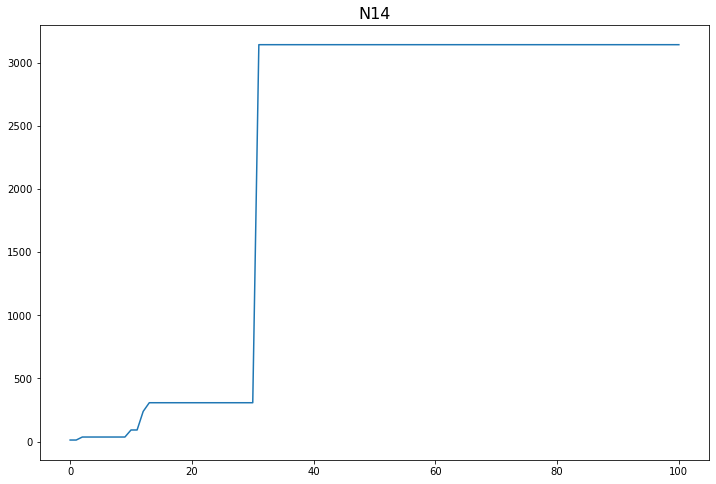

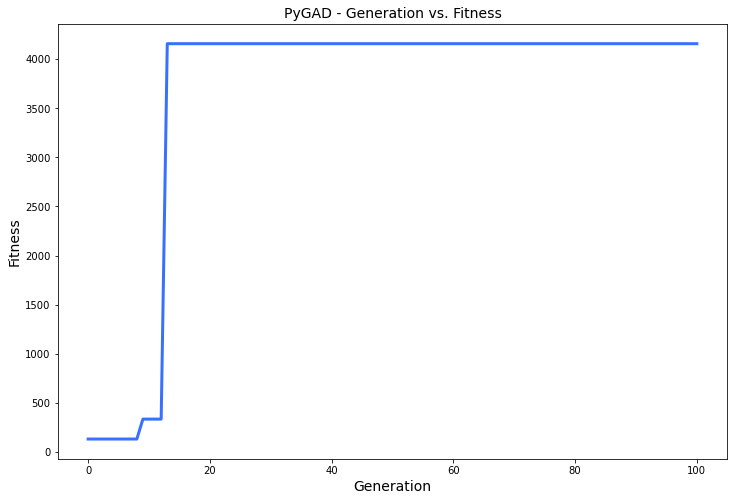

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.802 |==================| 5.049 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.505 |==================| 2.018 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 29.0 |==================| 2173.817 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.969 |==================| 31.478 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.336 |==================| 1.978 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.411 |==================| 2.318 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.708 |==================| 7.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.408 |==================| 2.305 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.61 |==================| 4.308 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.509 |==================| 2.999 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.732 |==================| 9.112 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.5 |==================| 2.925 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.404 |==================| 2.285 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.532 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 27.557 |==================| 3.51 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.696 |==================| 6.846 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.506 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.499 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.65 |==================| 5.219 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.779 |==================| 15.964 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.68 |==================| 6.157 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.745 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.744 |==================| 10.228 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.211 |==========| N11 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.706 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.797 |==================| 22.422 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.523 |==================| 3.138 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.593 |==================| 4.014 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.714 |==================| 7.824 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.637 |==================| 4.887 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.667 |==================| 5.699 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.38 |==================| 2.162 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.56 |==================| 3.542 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.81 |==================| 31.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.434 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.631 |==================| 4.728 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.355 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.574 |==================| 3.725 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.795 |==================| 21.364 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.348 |==================| 2.026 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.749 |==================| 10.72 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.008 |===========| 27.32 |==================| 1.917 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.338 |==================| 1.983 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.744 |==========| N11 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.401 |==================| 2.267 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.34 |==================| 1.992 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.385 |==================| 2.187 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.437 |==================| 2.469 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.754 |==================| 11.393 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.585 |==================| 3.892 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.832 |==================| 96.861 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.506 |==================| 2.979 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.83 |==================| 83.876 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.577 |==================| 3.777 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.202 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.378 |==================| 2.153 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.543 |==================| 3.348 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.379 |==================| 2.157 |==========| N11 |==========
**********************************************************************
Change = 946.499136006288
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.815 |==================| 37.18 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.695 |==================| 6.802 |==========| N11 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.344 |==================| 2.007 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 27.319 |==================| 1.912 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.098 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.828 |==================| 73.528 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.418 |==================| 2.356 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.636 |==================| 4.863 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.634 |==================| 4.813 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.451 |==================| 2.56 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 27.504 |==================| 2.956 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.612 |==================| 4.348 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.475 |==================| 2.724 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.822 |==================| 48.724 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.405 |==================| 2.289 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.732 |==================| 9.071 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.739 |==================| 9.66 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.769 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.421 |==================| 2.374 |==========| N11 |==========
**********************************************************************
Fitness = 1069.0940626403199
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.574 |==================| 3.735 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.822 |==================| 48.724 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.616 |==================| 4.414 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.802 |==================| 24.986 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.58 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.769 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.424 |==================| 2.393 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.367 |==================| 2.106 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.788 |==================| 18.411 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.174 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.558 |==================| 3.519 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.832 |==================| 101.71 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.757 |==================| 11.766 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.381 |==================| 2.169 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.727 |==================| 8.664 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.567 |==================| 3.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.475 |==================| 2.724 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 27.639 |==================| 4.914 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.373 |==================| 2.131 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.637 |==================| 4.867 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.434 |==================| 2.452 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.67 |==================| 5.804 |==========| N11 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.49 |==================| 2.844 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.599 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.734 |==================| 9.295 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.373 |==================| 2.131 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.55 |==================| 3.429 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.437 |==================| 2.466 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.39 |==================| 2.21 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.33 |==================| 1.954 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.343 |==================| 2.005 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.637 |==================| 4.885 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.516 |==================| 3.065 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.588 |==================| 3.944 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 27.639 |==================| 4.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.616 |==================| 4.427 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.337 |==================| 1.979 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.648 |==================| 5.152 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.621 |==================| 4.52 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.371 |==================| 2.121 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.633 |==================| 4.794 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.681 |==================| 6.194 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.702 |==================| 7.134 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.433 |==================| 2.444 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.514 |==================| 3.052 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.393 |==================| 2.227 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.162 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.637 |==================| 4.883 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.507 |==================| 2.984 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 407.442 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.376 |==================| 2.145 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.513 |==================| 3.04 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 69.288 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.583 |==================| 3.862 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.481 |==================| 2.771 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.561 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.722 |==================| 8.344 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.102 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.513 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.618 |==================| 4.465 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.825 |==================| 58.137 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.628 |==================| 4.674 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.133 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.563 |==================| 3.579 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.753 |==================| 11.274 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.447 |==================| 2.531 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 167.073 |==========| N11 |==========
**********************************************************************
Fitness = 1069.0940626403199
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.731 |==================| 8.991 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.714 |==================| 7.809 |==========| N11 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.381 |==================| 2.169 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.82 |==================| 46.412 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.533 |==================| 3.237 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.831 |==================| 92.378 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.815 |==================| 36.97 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.479 |==================| 2.758 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.839 |==================| 358.66 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.379 |==================| 2.161 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.761 |==================| 12.325 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.422 |==================| 2.379 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.101 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.61 |==================| 4.311 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.64 |==================| 4.962 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.526 |==================| 3.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.74 |==================| 9.845 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.782 |==================| 16.583 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.535 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.833 |==================| 106.341 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.811 |==================| 32.163 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.693 |==================| 6.708 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.767 |==================| 13.33 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.294 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.448 |==================| 2.54 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.568 |==================| 3.643 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.42 |==================| 2.367 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.649 |==================| 5.182 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.94 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.743 |==================| 10.058 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.131 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.511 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.507 |==================| 2.984 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.633 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 190.446 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.384 |==================| 2.184 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.464 |==================| 2.645 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.594 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.537 |==================| 3.273 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.834 |==================| 130.494 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.463 |==================| 2.635 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.696 |==================| 6.85 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.216 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.833 |==================| 112.169 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.699 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.625 |==================| 4.597 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.434 |==================| 2.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.593 |==================| 4.01 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.602 |==================| 4.172 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.488 |==================| 2.828 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.456 |==================| 2.589 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.508 |==================| 2.996 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.387 |==================| 2.196 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.866 |==========| N11 |==========
**********************************************************************


======| 0.431 |===========| 27.652 |==================| 5.251 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.713 |==================| 7.78 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.2 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.651 |==================| 5.221 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.711 |==================| 7.623 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.272 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.553 |==================| 3.464 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.482 |==================| 2.779 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.654 |==================| 5.319 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.682 |==================| 6.256 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.713 |==================| 7.763 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.803 |==================| 25.818 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.727 |==================| 8.7 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.779 |==================| 15.823 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.559 |==================| 3.53 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.383 |==================| 2.177 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.463 |==================| 2.641 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.364 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.408 |==================| 2.304 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.404 |==================| 2.281 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.731 |==================| 9.045 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.463 |==================| 2.641 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.429 |==================| 2.424 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.637 |==================| 4.87 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.1 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.987 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.527 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.381 |==================| 2.167 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.377 |==================| 2.151 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.78 |==================| 16.205 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.499 |==================| 2.915 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.746 |==================| 10.447 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.481 |==================| 2.773 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.441 |==================| 2.494 |==========| N11 |==========
**********************************************************************
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.498 |==================| 2.91 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.834 |==================| 121.495 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.659 |==================| 5.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.606 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 27.407 |==================| 2.299 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.763 |==================| 12.637 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.768 |==================| 13.456 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.179 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.587 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.627 |==================| 4.649 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.485 |==================| 2.802 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.747 |==================| 10.553 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.426 |==================| 2.406 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 136.29 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.638 |==================| 4.905 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.18 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.688 |==================| 6.497 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.74 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.633 |==================| 4.78 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.391 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.203 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.607 |==================| 4.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.536 |==================| 3.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.697 |==================| 6.917 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.686 |==================| 6.408 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.379 |==================| 2.158 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.794 |==================| 20.933 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.628 |==================| 4.667 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 27.507 |==================| 2.984 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.303 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.554 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.722 |==================| 8.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.735 |==================| 9.313 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.488 |==================| 2.826 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.746 |==================| 10.394 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.502 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.644 |==================| 5.056 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.593 |==================| 4.022 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.4 |==================| 2.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.649 |==================| 5.184 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.755 |==================| 11.45 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.824 |==================| 54.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.66 |==================| 5.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.361 |==================| 2.077 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.598 |==================| 4.101 |==========| N11 |==========
**********************************************************************
==

**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.72 |==================| 8.215 |==========| N11 |==========
**********************************************************************
Fitness = 1069.0940626403199
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 27.646 |==================| 5.107 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.67 |==================| 5.814 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.624 |==================| 4.584 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.671 |==================| 5.849 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.634 |==================| 4.813 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.675 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.211 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.753 |==================| 11.291 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.746 |==================| 10.452 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.384 |==================| 2.181 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.781 |==================| 16.345 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.572 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.651 |==================| 5.236 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.676 |==================| 6.027 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.835 |==================| 143.81 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.522 |==================| 3.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.525 |==================| 3.149 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.781 |==================| 16.345 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.79 |==================| 19.301 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.821 |==================| 48.558 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.619 |==================| 4.484 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.667 |==================| 5.72 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.568 |==================| 3.648 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.598 |==================| 4.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.365 |==================| 2.096 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.721 |==================| 8.291 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.472 |==================| 2.706 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.392 |==================| 2.223 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.789 |==================| 18.893 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.679 |==================| 6.136 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.375 |==================| 2.14 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.359 |==================| 2.07 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.691 |==================| 6.615 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 27.549 |==================| 3.414 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.779 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.709 |==================| 7.534 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.679 |==================| 6.136 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.56 |==================| 3.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.506 |==================| 2.98 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.753 |==================| 11.225 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.709 |==================| 7.491 |==========| N11 |==========
**********************************************************************
=

======| 0.345 |===========| 27.694 |==================| 6.739 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.729 |==================| 8.859 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.354 |==================| 2.047 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.654 |==================| 5.305 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.698 |==================| 6.937 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.411 |==================| 2.32 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.445 |==================| 2.517 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.744 |==================| 10.156 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.402 |==================| 2.271 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.745 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.608 |==================| 4.277 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.601 |==================| 4.143 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.821 |==================| 47.213 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.523 |==================| 3.132 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.465 |==================| 2.655 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.826 |==================| 64.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.273 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.378 |==================| 2.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.601 |==================| 4.143 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.418 |==================| 2.356 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.816 |==================| 37.901 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.419 |==================| 2.366 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.529 |==================| 3.19 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.663 |==================| 5.585 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.481 |==================| 2.771 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.923 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.54 |==================| 3.306 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.596 |==================| 4.067 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.762 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.343 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.449 |==================| 2.546 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.44 |==================| 2.485 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.495 |==================| 2.88 |==========| N11 |==========
**********************************************************************
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 27.591 |==================| 3.98 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 27.542 |==================| 3.332 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.664 |==================| 5.605 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.571 |==================| 3.684 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.395 |==================| 2.237 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.379 |==================| 2.158 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.579 |==================| 3.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 27.504 |==================| 2.957 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.341 |==================| 1.997 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.497 |==================| 2.895 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.766 |==================| 13.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.556 |==================| 3.491 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.832 |==================| 103.431 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.201 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.393 |==================| 2.225 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.816 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.269 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.398 |==================| 2.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.657 |==================| 5.411 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.328 |==================| 1.947 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.438 |==================| 2.475 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.658 |==================| 5.421 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 7.988 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.821 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.61 |==================| 4.31 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.271 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.663 |==================| 5.578 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.639 |==================| 4.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.817 |==================| 40.158 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.8 |==================| 23.877 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.767 |==================| 13.32 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.506 |==================| 2.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.568 |==================| 3.649 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.782 |==================| 16.59 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.699 |==================| 6.969 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.457 |==================| 2.594 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.337 |==================| 1.981 |==========| N11 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.602 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.718 |==================| 8.054 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.535 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.613 |==================| 4.367 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.716 |==================| 7.96 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.623 |==================| 4.557 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.683 |==================| 6.287 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.532 |==================| 3.229 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.359 |==================| 2.069 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.204 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.805 |==================| 27.007 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.607 |==================| 4.252 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.38 |==================| 2.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.592 |==================| 4.004 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.442 |==================| 2.502 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.609 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.55 |==================| 3.429 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.723 |==================| 8.376 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.766 |==================| 13.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.784 |==================| 17.178 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.664 |==================| 5.618 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.497 |==================| 2.895 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.702 |==================| 7.141 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.805 |==================| 26.815 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.627 |==================| 4.643 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.76 |==================| 12.259 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.769 |==================| 13.608 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.706 |==================| 7.354 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.416 |==================| 2.349 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.38 |==================| 2.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.357 |==================| 2.063 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.822 |==================| 50.792 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.6 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 54.859 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.83 |==================| 81.569 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.361 |==================| 2.08 |==========| N11 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.908 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.811 |==================| 32.234 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.55 |==================| 3.429 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.681 |==================| 6.201 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.348 |==================| 2.024 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.754 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.734 |==================| 9.235 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.7 |==================| 7.041 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.666 |==================| 5.694 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.664 |==================| 5.611 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.582 |==================| 3.843 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.818 |==================| 41.536 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.78 |==================| 16.116 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.471 |==================| 2.697 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.634 |==================| 4.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.527 |==================| 3.177 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.603 |==================| 4.18 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.689 |==================| 6.53 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.631 |==================| 4.744 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.35 |==================| 2.033 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.572 |==================| 3.698 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.54 |==================| 3.31 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.799 |==================| 23.219 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.378 |==================| 2.155 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.522 |==================| 3.121 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.542 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.682 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.692 |==================| 6.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.728 |==================| 8.735 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.818 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 27.373 |==================| 2.13 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.446 |==================| 2.522 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.778 |==================| 15.718 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.913 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.548 |==================| 3.403 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 163.32 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.815 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.479 |==================| 2.753 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.349 |==================| 2.03 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.499 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.7 |==================| 7.021 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.359 |==================| 2.072 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.337 |==================| 1.981 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.827 |==================| 67.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.738 |==================| 9.624 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 54.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.55 |==================| 3.426 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.287 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.771 |==================| 14.049 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.466 |==================| 2.657 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.664 |==================| 5.607 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.53 |==================| 3.208 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.816 |==================| 39.151 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.71 |==================| 7.597 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.634 |==================| 4.804 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.496 |==================| 2.889 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.603 |==================| 4.189 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.789 |==================| 18.707 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.53 |==================| 3.208 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.535 |==================| 3.256 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.709 |==================| 7.501 |==========| N11 |==========
**********************************************************************
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.539 |==================| 3.299 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.607 |==================| 4.246 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.361 |==================| 2.077 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.833 |==================| 105.85 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.376 |==================| 2.145 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.775 |==================| 14.878 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.407 |==================| 2.298 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.499 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 27.647 |==================| 5.117 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.375 |==================| 2.142 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.473 |==================| 2.708 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.783 |==================| 16.912 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.651 |==================| 5.23 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.79 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.803 |==================| 25.406 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.814 |==================| 35.088 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.541 |==================| 3.325 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.607 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.599 |==================| 4.118 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.378 |==================| 2.153 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.765 |==================| 12.983 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.692 |==================| 6.657 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.95 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.472 |==================| 2.705 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.445 |==================| 2.519 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.649 |==================| 5.19 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.708 |==================| 7.44 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.462 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.479 |==================| 2.751 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.705 |==================| 7.273 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.755 |==================| 11.488 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.685 |==================| 6.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.489 |==================| 2.829 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.523 |==================| 3.137 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.618 |==================| 4.473 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.682 |==================| 6.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.491 |==================| 2.846 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.609 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.835 |==================| 133.56 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.715 |==================| 7.868 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.722 |==================| 8.305 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.754 |==================| 11.418 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.818 |==================| 42.139 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.626 |==================| 4.635 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.522 |==================| 3.122 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.486 |==================| 2.806 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.653 |==================| 5.299 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.58 |==================| 3.816 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.701 |==================| 7.113 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.559 |==================| 3.529 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.348 |==================| 2.024 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.407 |==================| 2.298 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.204 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.745 |==================| 10.323 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.702 |==================| 7.158 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.654 |==================| 5.328 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.809 |==================| 30.331 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.692 |==================| 6.662 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.781 |==================| 16.354 |==========| N11 |==========
**********************************************************************
Fitness = 1098.9101430578946
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.602 |==================| 4.173 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 7.999 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.41 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.683 |==================| 6.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.749 |==================| 10.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.838 |==================| 270.044 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 166.396 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.669 |==================| 5.763 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.448 |==================| 2.539 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.817 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.813 |==================| 34.198 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.589 |==================| 3.957 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.689 |==================| 6.533 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.634 |==================| 4.806 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.382 |==================| 2.175 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.751 |==================| 10.931 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.754 |==================| 11.312 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.827 |==================| 67.701 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.756 |==================| 11.647 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.585 |==================| 3.888 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.576 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.575 |==================| 3.746 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.526 |==================| 3.161 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.598 |==================| 4.097 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.66 |==================| 5.5 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.628 |==================| 4.664 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.581 |==================| 3.835 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.676 |==================| 6.009 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.57 |==================| 3.676 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.616 |==================| 4.428 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.797 |==================| 22.224 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.664 |==================| 5.618 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.557 |==================| 3.514 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.594 |==================| 4.034 |==========| N11 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.423 |==================| 2.385 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.589 |==================| 3.954 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.815 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 27.352 |==================| 2.042 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.801 |==================| 24.191 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.611 |==================| 4.334 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.378 |==================| 2.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.775 |==================| 14.965 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.634 |==================| 4.813 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.104 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.687 |==================| 6.457 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.727 |==================| 8.724 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.483 |==================| 2.783 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 27.578 |==================| 3.794 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.396 |==================| 2.243 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.806 |==================| 27.402 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.601 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.773 |==================| 14.558 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.489 |==================| 2.832 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.632 |==================| 4.758 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.775 |==================| 15.017 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.354 |==================| 2.048 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.773 |==================| 14.528 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.534 |==================| 3.242 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.678 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.109 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.357 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.775 |==================| 15.017 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 27.454 |==================| 2.576 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.49 |==================| 2.841 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.377 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.426 |==================| 2.404 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.781 |==================| 16.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.492 |==================| 2.853 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.414 |==================| 2.335 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.829 |==================| 79.141 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.671 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.748 |==================| 10.642 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.48 |==================| 2.761 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.399 |==================| 2.256 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.747 |==================| 10.571 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.26 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.778 |==================| 15.73 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.601 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.625 |==================| 4.599 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 27.492 |==================| 2.857 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.677 |==================| 6.064 |==========| N11 |==========
**********************************************************************
Fitness = 1098.9101430578946
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.791 |==================| 19.448 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.477 |==================| 2.738 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.592 |==================| 4.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.78 |==================| 16.03 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.564 |==================| 3.592 |==========| N11 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.767 |==================| 13.409 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.499 |==================| 2.918 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.214 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.703 |==================| 7.213 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.769 |==================| 13.703 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.49 |==================| 2.844 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.581 |==================| 3.836 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.611 |==================| 4.325 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.558 |==================| 3.522 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.77 |==================| 13.941 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.983 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.769 |==================| 13.703 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.405 |==================| 2.289 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.64 |==================| 4.939 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.392 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.34 |==================| 1.993 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.686 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.414 |==================| 2.339 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.717 |==================| 8.022 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.405 |==================| 2.289 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.357 |==================| 2.061 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.601 |==================| 4.14 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.33 |==================| 1.952 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.686 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.684 |==================| 6.317 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.791 |==================| 19.713 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.547 |==================| 3.385 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.759 |==================| 12.032 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.545 |==================| 3.372 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.745 |==================| 10.35 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.617 |==================| 4.441 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.514 |==========| N11 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.807 |==================| 28.443 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.651 |==================| 5.243 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.794 |==================| 20.765 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.328 |==================| 1.947 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.833 |==================| 109.932 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.697 |==================| 6.876 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.411 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.813 |==================| 34.643 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.361 |==================| 2.078 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.678 |==================| 6.11 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.479 |==================| 2.757 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.833 |==================| 109.932 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.379 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.762 |==================| 12.56 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.374 |==================| 2.136 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.46 |==================| 2.617 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.754 |==================| 11.342 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.825 |==================| 59.154 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.626 |==================| 4.637 |==========| N11 |==========
**********************************************************************
Fitness = 1098.9101430578946
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.658 |==================| 5.42 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.545 |==================| 3.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.446 |==================| 2.522 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.741 |==================| 9.901 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.382 |==================| 2.175 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.565 |==================| 3.61 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.582 |==================| 3.839 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.444 |==================| 2.51 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.464 |==================| 2.644 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.694 |==================| 6.738 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.692 |==================| 6.646 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.662 |==================| 5.566 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.819 |==================| 43.384 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.762 |==================| 12.563 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.536 |==================| 3.271 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.342 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.764 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.47 |==================| 2.689 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.907 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.499 |==================| 2.911 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.755 |==================| 11.457 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.802 |==================| 24.88 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.651 |==================| 5.241 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.826 |==================| 62.525 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.823 |==================| 52.508 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.552 |==================| 3.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.649 |==================| 5.173 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.454 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.149 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 184.154 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.432 |==================| 2.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.501 |==================| 2.93 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.605 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.573 |==================| 3.716 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.576 |==================| 3.754 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.59 |==================| 3.972 |==========| N11 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.831 |==================| 91.103 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.566 |==================| 3.629 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.831 |==================| 92.906 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.605 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.521 |==================| 3.116 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.161 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.758 |==================| 11.942 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.784 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.8 |==================| 23.894 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.787 |==================| 18.33 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.785 |==================| 17.387 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.296 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.812 |==================| 32.94 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.618 |==================| 4.458 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.562 |==================| 3.57 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.678 |==================| 6.079 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.718 |==================| 8.056 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.603 |==================| 4.179 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.373 |==================| 2.131 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.475 |==================| 2.721 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.705 |==================| 7.289 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.434 |==================| 2.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.487 |==================| 2.819 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.374 |==================| 2.135 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.697 |==================| 6.908 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.742 |==================| 10.002 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.351 |==================| 2.037 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.747 |==================| 10.559 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.635 |==================| 4.837 |==========| N11 |==========
**********************************************************************
Fitness = 1098.9101430578946
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.672 |==================| 5.887 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.448 |==================| 2.538 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.347 |==================| 2.02 |==========| N11 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.329 |==================| 1.949 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.38 |==================| 2.166 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.783 |==================| 16.992 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.743 |==================| 10.1 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.592 |==================| 4.007 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.572 |==================| 3.697 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.393 |==================| 2.225 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.489 |==================| 2.83 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.723 |==================| 8.431 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.482 |==================| 2.777 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.743 |==================| 10.1 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.431 |==================| 2.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.641 |==================| 4.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.764 |==================| 12.761 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.573 |==================| 3.722 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.521 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.823 |==================| 52.949 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.395 |==================| 2.237 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.603 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.57 |==================| 3.671 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.431 |==================| 2.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.327 |==================| 1.943 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.806 |==================| 27.368 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.721 |==================| 8.229 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.827 |==================| 65.555 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.57 |==================| 3.671 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.597 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.607 |==================| 4.248 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.411 |==================| 2.318 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.358 |==================| 2.066 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.745 |==================| 10.338 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.842 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.764 |==================| 12.774 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.717 |==================| 8.026 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.542 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.562 |==================| 3.57 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.391 |==================| 2.218 |==========| N11 |==========
**********************************************************************
=

======| 0.167 |===========| 27.774 |==================| 14.797 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.658 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.975 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.414 |==================| 2.335 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.716 |==================| 7.918 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.566 |==================| 3.623 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.774 |==================| 14.797 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.658 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.723 |==================| 8.369 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.618 |==================| 4.467 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.669 |==================| 5.793 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.761 |==================| 12.346 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.552 |==================| 3.449 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.372 |==================| 2.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.821 |==================| 47.211 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.356 |==================| 2.056 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.807 |==================| 28.163 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.647 |==================| 5.136 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.764 |==================| 12.749 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 27.576 |==================| 3.763 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.787 |==================| 18.23 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.604 |==================| 4.205 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.64 |==================| 4.947 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.333 |==================| 1.965 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.402 |==================| 2.274 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.742 |==================| 9.988 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.493 |==================| 2.865 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.787 |==================| 18.23 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.676 |==================| 6.015 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.667 |==================| 5.712 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.276 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.737 |==================| 9.56 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.403 |==================| 2.275 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.626 |==================| 4.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.376 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.35 |==================| 2.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.699 |==================| 6.978 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.507 |==================| 2.982 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.741 |==================| 9.922 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.682 |==================| 6.23 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.564 |==================| 3.591 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.672 |==================| 5.869 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 27.481 |==================| 2.768 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.543 |==================| 3.347 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.729 |==================| 8.833 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 27.417 |==================| 2.351 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.403 |==================| 2.276 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.405 |==================| 2.286 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.805 |==================| 26.67 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.717 |==================| 7.971 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.543 |==================| 3.347 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.805 |==================| 27.091 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.707 |==================| 7.378 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.355 |==================| 2.052 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.336 |==================| 1.976 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.621 |==================| 4.517 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.628 |==================| 4.681 |==========| N11 |==========
**********************************************************************
Fitness = 1098.9101430578946
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.553 |==================| 3.459 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.805 |==================| 27.091 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.406 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.766 |==================| 13.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.786 |==================| 17.692 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 27.519 |==================| 3.091 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.472 |==================| 2.7 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.607 |==================| 4.256 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.445 |==================| 2.518 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.501 |==================| 2.928 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.841 |==================| 1145.744 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.82 |==================| 46.045 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.796 |==================| 21.766 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.463 |==================| 2.637 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.734 |==================| 9.255 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.387 |==================| 2.197 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.528 |==================| 3.183 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.627 |==================| 4.64 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.637 |==================| 4.884 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.625 |==================| 4.613 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.67 |==================| 5.827 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.571 |==========| N11 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.793 |==================| 20.481 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.354 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 54.898 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.203 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.528 |==================| 3.188 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.782 |==================| 16.569 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.574 |==================| 3.735 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.63 |==================| 4.713 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.816 |==================| 38.472 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.74 |==================| 9.778 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.833 |==================| 115.193 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.353 |==================| 2.044 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.484 |==================| 2.792 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.753 |==================| 11.274 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.812 |==================| 32.843 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.538 |==================| 3.292 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.687 |==================| 6.454 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.511 |==================| 3.023 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.109 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.48 |==================| 2.761 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.742 |==================| 9.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.688 |==================| 6.499 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.456 |==================| 2.588 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.47 |==================| 2.69 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.908 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.769 |==================| 13.625 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.513 |==================| 3.036 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 27.325 |==================| 1.933 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.502 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.812 |==================| 33.845 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.649 |==================| 5.172 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.988 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.341 |==================| 1.994 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.696 |==================| 6.846 |==========| N11 |==========
**********************************************************************
Fitness = 1145.7438515471233
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.502 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.43 |==================| 2.427 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.37 |==================| 2.117 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.47 |==================| 2.69 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.381 |==================| 2.169 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.82 |==================| 45.782 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.475 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.352 |==================| 2.039 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.372 |==================| 2.126 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.096 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.536 |==================| 3.272 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.682 |==================| 6.244 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.458 |==================| 2.604 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.665 |==================| 5.659 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.633 |==================| 4.795 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.006 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.096 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.613 |==================| 4.364 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.675 |==================| 5.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.676 |==================| 6.038 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.345 |==================| 2.014 |==========| N11 |==========
**********************************************************************


======| 0.098 |===========| 27.803 |==================| 25.913 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.605 |==================| 4.221 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.425 |==================| 2.4 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.554 |==================| 3.467 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.84 |==================| 532.988 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 27.541 |==================| 3.324 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.514 |==================| 3.052 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.803 |==================| 25.913 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.496 |==================| 2.888 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.78 |==================| 16.16 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.609 |==================| 4.286 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.683 |==================| 6.269 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.806 |==================| 27.425 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.508 |==================| 2.994 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.33 |==================| 1.951 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.496 |==================| 2.892 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.711 |==================| 7.65 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.132 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.603 |==================| 4.177 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.806 |==================| 27.425 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 27.504 |==================| 2.958 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.782 |==================| 16.69 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.702 |==================| 7.16 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.798 |==================| 22.469 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.648 |==================| 5.146 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.797 |==================| 22.229 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 27.504 |==================| 2.958 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 69.684 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.2 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.575 |==================| 3.747 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.506 |==================| 2.972 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.579 |==================| 3.809 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.396 |==================| 2.242 |==========| N11 |==========
**********************************************************************
Fitness = 1145.7438515471233
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.46 |==================| 2.617 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.176 |==========| N11 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.69 |==================| 6.597 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.355 |==================| 2.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.651 |==================| 5.228 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.42 |==================| 2.368 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.768 |==================| 13.45 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.723 |==================| 8.384 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.615 |==================| 4.404 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.601 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.437 |==================| 2.47 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.76 |==================| 12.201 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.767 |==================| 13.32 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.683 |==================| 6.303 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.814 |==================| 35.219 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.704 |==================| 7.251 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.456 |==================| 2.59 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.468 |==================| 2.674 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.471 |==================| 2.698 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.559 |==================| 3.533 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.46 |==================| 2.615 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.792 |==================| 19.971 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.392 |==================| 2.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.817 |==================| 39.684 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.761 |==================| 12.393 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.723 |==================| 8.42 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.727 |==================| 8.701 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.804 |==================| 26.207 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.375 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.824 |==================| 56.72 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.841 |==================| 839.234 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.704 |==================| 7.25 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.745 |==================| 10.268 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.622 |==================| 4.546 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.749 |==================| 10.798 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.411 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.735 |==================| 9.311 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.48 |==================| 2.758 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.375 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.428 |==================| 2.416 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.354 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.729 |==================| 8.885 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.526 |==================| 3.164 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.824 |==================| 56.578 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.746 |==================| 10.441 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.822 |==================| 50.962 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.434 |==================| 2.451 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.579 |==================| 3.808 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.473 |==================| 2.708 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.611 |==================| 4.321 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.769 |==================| 13.676 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.671 |==================| 5.851 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.517 |==================| 3.073 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.38 |==================| 2.166 |==========| N11 |==========
**********************************************************************
Fitness = 1145.7438515471233
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.866 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.545 |==================| 3.371 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.611 |==================| 4.321 |==========| N11 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.641 |==================| 4.974 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.464 |==================| 2.643 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.629 |==================| 4.694 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.808 |==================| 29.456 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.773 |==================| 14.492 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.329 |==================| 1.949 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.456 |==================| 2.593 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.697 |==================| 6.898 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.267 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.602 |==================| 4.158 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.812 |==================| 33.29 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.664 |==================| 5.625 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.345 |==================| 2.012 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.755 |==================| 11.478 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.75 |==================| 10.87 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.71 |==================| 7.573 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.581 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.622 |==================| 4.543 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.611 |==================| 4.328 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.783 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.629 |==================| 4.692 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.747 |==================| 10.473 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.354 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.581 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.817 |==================| 39.745 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.796 |==================| 21.514 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.489 |==================| 2.829 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.512 |==================| 3.026 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.456 |==================| 2.593 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.516 |==================| 3.071 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.543 |==================| 3.348 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.443 |==================| 2.509 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 8.002 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.393 |==================| 2.228 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.501 |==================| 2.93 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.456 |==================| 2.593 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.091 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.516 |==================| 3.069 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.629 |==================| 4.684 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 8.002 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.537 |==================| 3.279 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 27.355 |==================| 2.051 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.548 |==================| 3.405 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.35 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.521 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.413 |==================| 2.33 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.427 |==================| 2.409 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.569 |==================| 3.667 |==========| N11 |==========
**********************************************************************
=

======| 0.752 |===========| 27.477 |==================| 2.743 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.436 |==================| 2.466 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.767 |==================| 13.255 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.779 |==================| 15.933 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.675 |==================| 5.976 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.617 |==================| 4.444 |==========| N11 |==========
**********************************************************************
Fitness = 1145.7438515471233
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.477 |==================| 2.743 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.436 |==================| 2.466 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.494 |==================| 2.87 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.742 |==================| 9.985 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.711 |==================| 7.645 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.444 |==================| 2.511 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.622 |==================| 4.551 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.332 |==================| 1.962 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.757 |==================| 11.76 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.512 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.703 |==================| 7.205 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.945 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.444 |==================| 2.511 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.523 |==================| 3.135 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.659 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.77 |==================| 13.959 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.653 |==================| 5.278 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.473 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.722 |==================| 8.349 |==========| N11 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.439 |==================| 2.481 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.83 |==================| 83.046 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.682 |==================| 6.238 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 27.501 |==================| 2.936 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.473 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.461 |==================| 2.624 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.711 |==================| 7.658 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.514 |==================| 3.048 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.83 |==================| 83.046 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.389 |==================| 2.206 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.833 |==================| 115.359 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.741 |==================| 9.912 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.866 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.447 |==================| 2.531 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.797 |==================| 22.389 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.519 |==================| 3.098 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.332 |==================| 1.961 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.778 |==================| 15.602 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.603 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.596 |==================| 4.073 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.558 |==================| 3.526 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 158.881 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.405 |==================| 2.287 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.327 |==================| 1.943 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.651 |==================| 5.231 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.633 |==================| 4.789 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.825 |==================| 59.954 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.861 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 158.881 |==========| N11 |==========
********************************************************************

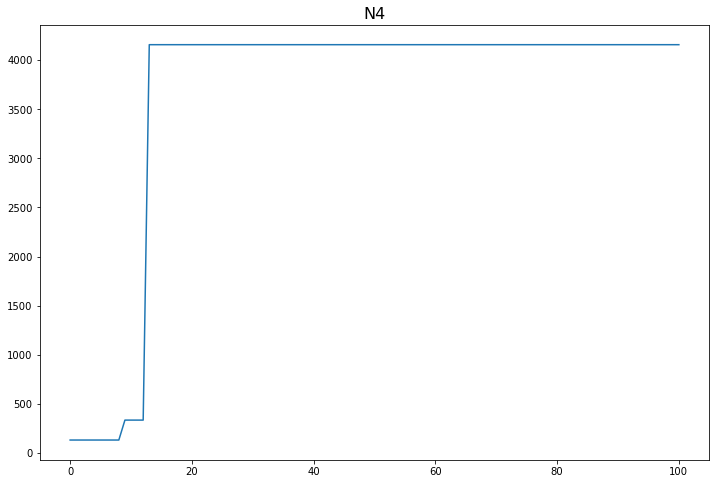

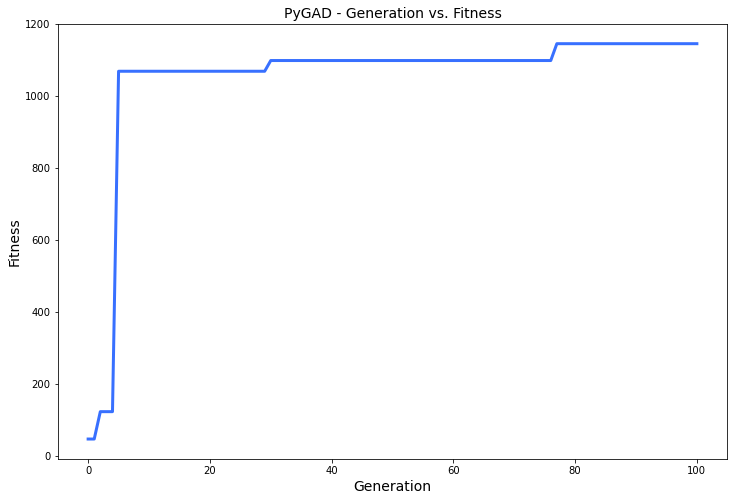

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.603 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.596 |==================| 4.073 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.558 |==================| 3.526 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.809 |==================| 30.433 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.561 |==================| 0.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.586 |==================| 0.998 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.479 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.365 |==================| 4.473 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.618 |==================| 1.031 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.994 |==================| 1.682 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.838 |==================| 1.333 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.852 |==================| 1.358 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.305 |==================| 3.534 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.069 |===========| 23.468 |==================| 0.893 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.365 |==================| 4.473 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.01 |==================| 1.731 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.106 |==================| 2.074 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.574 |==================| 71.421 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.884 |==================| 1.42 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.835 |==================| 1.327 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.704 |==================| 1.131 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.734 |==================| 1.171 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.01 |==================| 1.731 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.052 |==================| 1.863 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.695 |==================| 1.119 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.286 |==================| 3.304 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.158 |==================| 2.322 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.939 |==================| 1.539 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.578 |==================| 102.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.357 |==================| 4.316 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.931 |==================| 1.521 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.206 |==================| 2.617 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.428 |==================| 6.249 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.131 |==================| 2.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.939 |==================| 1.539 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 23.851 |==================| 1.357 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.33 |==================| 3.877 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.515 |==================| 13.623 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.972 |==================| 1.624 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.498 |==================| 11.12 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.577 |==================| 89.345 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 23.991 |==================| 1.673 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.575 |==================| 75.482 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.952 |==================| 1.571 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.59 |==================| 1.002 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.482 |==================| 9.446 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.479 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 23.775 |==================| 1.23 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.002 |==================| 1.706 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 23.987 |==================| 1.664 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.873 |==================| 1.398 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.039 |==================| 1.82 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.878 |==================| 1.408 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.54 |==================| 20.925 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.716 |==================| 1.147 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.041 |==================| 1.826 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.135 |==================| 2.208 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.7 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.252 |==================| 2.978 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 23.799 |==================| 1.267 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.182 |==================| 2.462 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.077 |==================| 1.954 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.811 |==================| 1.286 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.839 |==================| 1.335 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.755 |==================| 1.2 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.238 |==================| 2.853 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.165 |==================| 2.36 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 23.803 |==================| 1.274 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.266 |==================| 3.102 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 7.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 23.976 |==================| 1.632 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 23.699 |==================| 1.124 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.881 |==================| 1.414 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.593 |==================| 1.004 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.688 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.247 |==================| 2.934 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.02 |==================| 1.76 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.573 |==================| 66.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.356 |==================| 4.297 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.722 |==================| 1.154 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.805 |==================| 1.276 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.737 |==================| 1.175 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.781 |==================| 1.238 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.234 |==================| 2.823 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.258 |==================| 3.027 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.022 |==================| 1.765 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.582 |==================| 162.524 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.017 |==================| 1.751 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.485 |==================| 9.643 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.581 |==================| 0.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.299 |==================| 3.459 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.258 |==================| 3.027 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.336 |==================| 3.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.31 |==================| 3.59 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.584 |==================| 210.523 |==========| N12 |==========
**********************************************************************
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.389 |==================| 5.024 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.973 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.716 |==================| 1.146 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.804 |==================| 1.275 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.432 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.02 |==================| 1.76 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.565 |==================| 0.978 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.973 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.203 |==================| 2.593 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.638 |==================| 1.052 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.892 |==================| 1.435 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.572 |==================| 0.984 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 23.85 |==================| 1.355 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.819 |==================| 1.299 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.164 |==================| 2.357 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.943 |==================| 1.55 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.79 |==================| 1.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.657 |==================| 1.074 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.903 |==================| 1.459 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.005 |==================| 1.715 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.305 |==================| 3.529 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.897 |==================| 1.447 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.551 |==================| 26.935 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.534 |==================| 18.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.15 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.597 |==================| 1.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.486 |==================| 9.783 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.543 |==================| 22.316 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.793 |==================| 1.258 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.582 |==================| 169.034 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.169 |==================| 2.383 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.15 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.557 |==================| 31.637 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.448 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.011 |==================| 1.732 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.793 |==================| 1.258 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.173 |==================| 2.409 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.276 |==================| 3.2 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========| N12 |==========
**********************************************************************
Generation = 13
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.368 |==================| 4.538 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.513 |==================| 13.36 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.479 |==================| 9.157 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.359 |==================| 4.368 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.415 |==================| 5.759 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.544 |==================| 22.341 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.503 |==================| 11.793 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.509 |==================| 12.644 |==========| N12 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.909 |==================| 1.472 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.963 |==================| 1.599 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.834 |==================| 1.325 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.881 |==================| 1.413 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.902 |==================| 1.458 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.842 |==================| 1.341 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.481 |==================| 9.34 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.909 |==================| 1.472 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.144 |==================| 2.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.341 |==================| 4.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.405 |==================| 5.469 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.679 |==================| 1.099 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.041 |==================| 1.827 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.226 |==================| 2.763 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.288 |==================| 3.327 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.2 |==================| 2.575 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.197 |==================| 2.555 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.009 |==================| 1.727 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.005 |===========| 23.543 |==================| 0.957 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.106 |==================| 2.074 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 23.544 |==================| 0.957 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.282 |==================| 3.267 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.098 |==================| 2.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.892 |==================| 1.436 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.584 |==================| 0.996 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.256 |==================| 3.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.688 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.567 |==================| 0.979 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.861 |==================| 1.376 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.493 |==================| 10.445 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.791 |==================| 1.254 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.188 |==================| 2.496 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.466 |==================| 8.204 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.15 |==================| 2.283 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.848 |==================| 1.35 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.02 |==================| 1.76 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 23.973 |==================| 1.626 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.249 |==================| 2.949 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.336 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.086 |==================| 1.992 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.747 |==================| 1.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.057 |==================| 1.881 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.238 |==================| 2.852 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.342 |==================| 4.054 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.113 |==================| 2.104 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.71 |==================| 1.138 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.151 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.497 |==================| 10.943 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.161 |==================| 2.338 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.627 |==================| 1.04 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.546 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.763 |==================| 1.212 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.047 |==================| 1.846 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.732 |==================| 1.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.069 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 23.857 |==================| 1.367 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.304 |==================| 3.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.496 |==================| 10.86 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.038 |==================| 1.818 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 23.574 |==================| 0.986 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.383 |==================| 4.88 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.303 |==================| 3.5 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.334 |==================| 3.927 |==========| N12 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.68 |==================| 1.101 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.402 |==================| 5.358 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 23.714 |==================| 1.144 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.112 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.891 |==================| 1.433 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 23.829 |==================| 1.317 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.813 |==================| 1.29 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 23.841 |==================| 1.338 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 23.964 |==================| 1.602 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.283 |==================| 3.274 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.074 |==================| 1.944 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 7.99 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.087 |==================| 1.996 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 23.85 |==================| 1.354 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.411 |==================| 5.633 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.118 |==================| 2.125 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.358 |==================| 4.337 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.696 |==================| 1.121 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.815 |==================| 1.294 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.222 |==================| 2.733 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.642 |==================| 1.057 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.094 |==================| 2.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.473 |==================| 8.657 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.462 |==================| 7.919 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.316 |==================| 3.678 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.892 |==================| 1.436 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.422 |==================| 6.012 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.146 |==================| 2.259 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.966 |==================| 1.607 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.211 |==================| 2.652 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 23.923 |==================| 1.503 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.696 |==================| 1.121 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.174 |==================| 2.411 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.268 |==================| 3.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 23.962 |==================| 1.597 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.532 |==================| 17.7 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.757 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.724 |==================| 1.156 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.132 |==================| 2.192 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.549 |==================| 25.612 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.066 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.904 |==================| 1.461 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.346 |==================| 4.12 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.52 |==================| 14.588 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.313 |==================| 3.638 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.426 |==================| 6.168 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.183 |==================| 2.469 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.467 |==================| 8.278 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.932 |==================| 1.525 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.892 |==================| 1.436 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.981 |==================| 1.647 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.605 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.774 |==================| 1.228 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.467 |==================| 8.278 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.432 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.585 |==================| 0.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.005 |==================| 1.714 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.98 |==================| 1.644 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.186 |==================| 2.483 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.735 |==================| 1.172 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.077 |==================| 1.957 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.827 |==================| 1.313 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.12 |==================| 2.134 |==========| N12 |==========
**********************************************************************
Change = 201.5239681569588
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.586 |==================| 412.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.423 |==================| 6.037 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.186 |==================| 2.483 |==========| N12 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.746 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.582 |==================| 160.844 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.064 |==================| 1.907 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.331 |==================| 3.892 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.794 |==================| 1.258 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.137 |==================| 2.215 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.423 |==================| 6.038 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.557 |==================| 32.157 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.407 |==================| 5.504 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.995 |==================| 1.684 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.163 |==================| 2.351 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.313 |==================| 3.638 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.032 |==================| 1.798 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.242 |==================| 2.891 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.207 |==================| 2.621 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.185 |==================| 2.481 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.81 |==================| 1.286 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.196 |==================| 2.55 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========| N12 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.763 |==================| 1.212 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.586 |==================| 0.998 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.915 |==================| 1.485 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.876 |==================| 1.404 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.892 |==================| 1.437 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.248 |==================| 2.937 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 23.68 |==================| 1.101 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.138 |==================| 2.221 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.644 |==================| 1.059 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.971 |==================| 1.62 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.591 |==================| 1.003 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.312 |==================| 3.624 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.131 |==================| 2.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.121 |==================| 2.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.794 |==================| 1.259 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.644 |==================| 1.059 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.909 |==================| 1.473 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.541 |==================| 21.206 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.318 |==================| 3.701 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.735 |==================| 1.172 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.604 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.707 |==================| 1.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.485 |==================| 9.684 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.554 |==================| 0.967 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.354 |==================| 4.266 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.022 |==================| 1.765 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.604 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.167 |==================| 2.373 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.679 |==================| 1.1 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.995 |==================| 1.686 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.735 |==================| 1.171 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.524 |==================| 15.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.101 |==================| 2.052 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.523 |==================| 15.381 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.396 |==================| 5.209 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.855 |==================| 1.363 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.209 |==================| 2.64 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.828 |==================| 1.315 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.562 |==================| 0.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 23.977 |==================| 1.636 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.588 |==================| 1492.38 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.218 |==================| 2.699 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.009 |==================| 1.725 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.569 |==================| 0.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.446 |==================| 7.045 |==========| N12 |==========
**********************************************************************


======| 0.554 |===========| 24.043 |==================| 1.833 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.428 |==================| 6.226 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 23.714 |==================| 1.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.346 |==================| 4.131 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.717 |==================| 1.148 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 23.961 |==================| 1.594 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.226 |==================| 2.764 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.685 |==================| 1.107 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.876 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.003 |==================| 1.71 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.752 |==================| 1.195 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.165 |==================| 2.362 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.412 |==================| 5.667 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.384 |==================| 4.888 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.868 |==================| 1.388 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.876 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.731 |==================| 1.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.456 |==================| 7.534 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.308 |==================| 3.566 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.398 |==================| 5.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.531 |==================| 17.614 |==========| N12 |==========
**********************************************************************
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 23.895 |==================| 1.442 |==========| N12 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.527 |==================| 16.411 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.284 |==================| 3.289 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.837 |==================| 1.332 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.346 |==================| 4.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.105 |==================| 2.068 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.958 |==================| 1.588 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.549 |==================| 25.781 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.677 |==================| 1.098 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.547 |==================| 24.167 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.447 |==================| 7.101 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.97 |==================| 1.617 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.782 |==================| 1.24 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 23.703 |==================| 1.129 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.823 |==================| 1.306 |==========| N12 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.541 |==================| 21.064 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.491 |==================| 10.239 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.182 |==================| 2.461 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.97 |==================| 1.617 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.876 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.353 |==================| 4.248 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.577 |==================| 86.357 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.187 |==================| 2.491 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 23.707 |==================| 1.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 61.161 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.493 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.876 |==================| 1.403 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.325 |==================| 3.798 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.402 |==================| 5.355 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.409 |==================| 5.568 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.63 |==================| 1.043 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.121 |==================| 2.141 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.577 |==================| 85.353 |==========| N12 |==========
**********************************************************************
Fitness = 1492.3799399640582
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.799 |==================| 1.266 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.325 |==================| 3.798 |==========| N12 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.259 |==================| 3.039 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.107 |==================| 2.077 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.003 |==================| 1.709 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.121 |==================| 2.141 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.249 |==================| 2.943 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.169 |==================| 2.387 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.15 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.166 |==================| 2.37 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 23.924 |==================| 1.504 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.813 |==================| 1.289 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.624 |==================| 1.037 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.249 |==================| 2.943 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.465 |==================| 8.116 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 23.674 |==================| 1.094 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 23.899 |==================| 1.451 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.822 |==================| 1.306 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.069 |==========| N12 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.373 |==================| 4.637 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.165 |==================| 2.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.312 |==================| 3.624 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.587 |==================| 816.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.105 |==================| 2.069 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.413 |==================| 5.712 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.315 |==================| 3.658 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 23.923 |==================| 1.502 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.629 |==================| 1.042 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.19 |==================| 2.508 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 23.691 |==================| 1.114 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.491 |==================| 10.257 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 23.577 |==================| 0.989 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.869 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.116 |==================| 2.116 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.732 |==================| 1.168 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.83 |==================| 1.32 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.503 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.595 |==================| 1.006 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.524 |==================| 15.6 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.43 |==================| 6.312 |==========| N12 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.642 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.567 |==================| 46.17 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.706 |==================| 1.134 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.524 |==================| 15.455 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.424 |==================| 6.083 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.751 |==================| 1.195 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.037 |==================| 1.815 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.125 |==================| 2.16 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.909 |==================| 1.471 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.956 |==================| 1.581 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.765 |==================| 1.215 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.119 |==================| 2.133 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.534 |==================| 18.378 |==========| N12 |==========
**********************************************************************
Fitness = 1492.3799399640582
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.492 |==================| 10.38 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.261 |==================| 3.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.55 |==================| 25.973 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.951 |==================| 1.568 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.103 |==================| 2.063 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.735 |==================| 1.172 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.214 |==================| 2.669 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.184 |==================| 2.472 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.435 |==================| 6.539 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.515 |==================| 13.705 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.103 |==================| 2.063 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.705 |==================| 1.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.201 |==================| 2.583 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.907 |==================| 1.467 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.892 |==================| 1.436 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 23.829 |==================| 1.318 |==========| N12 |==========
**********************************************************************
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.755 |==================| 1.2 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.183 |==================| 2.468 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.068 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.587 |==================| 0.999 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.632 |==================| 1.045 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.207 |==================| 2.621 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.245 |==================| 2.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.156 |==================| 2.313 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.407 |==================| 5.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.068 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.684 |==================| 1.106 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.79 |==================| 1.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.845 |==================| 1.346 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.37 |==================| 4.572 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.294 |==================| 3.401 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.469 |==================| 8.35 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.679 |==================| 1.099 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.154 |==================| 2.304 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.909 |==================| 1.472 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.928 |==================| 1.514 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.464 |==================| 8.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.393 |==================| 5.132 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.576 |==================| 81.94 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.178 |==================| 2.438 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.927 |==================| 1.512 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.12 |==================| 2.135 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.533 |==================| 18.027 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.079 |==================| 1.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.448 |==================| 7.133 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.576 |==================| 81.94 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.589 |==================| 1.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.147 |==================| 2.266 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.43 |==================| 6.304 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.807 |==================| 1.28 |==========| N12 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.557 |==================| 0.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 23.73 |==================| 1.166 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.707 |==================| 1.134 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.589 |==================| 1.0 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.971 |==================| 1.62 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.066 |==================| 1.915 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 23.867 |==================| 1.386 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.557 |==================| 0.969 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.337 |==================| 3.98 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.496 |==================| 10.885 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.755 |==================| 1.199 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.226 |==================| 2.761 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.0 |==================| 1.699 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.196 |==================| 2.552 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 23.949 |==================| 1.564 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.337 |==================| 3.98 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.43 |==================| 6.335 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.055 |==================| 1.877 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.514 |==================| 13.377 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.486 |==================| 9.816 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.853 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.513 |==================| 13.366 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.479 |==================| 9.116 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.853 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.084 |==================| 1.982 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 23.982 |==================| 1.65 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.532 |==================| 17.747 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.853 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.46 |==================| 7.812 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.497 |==================| 10.938 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.466 |==================| 8.207 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 23.948 |==================| 1.562 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.438 |==================| 6.644 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.552 |==================| 0.965 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.189 |==================| 2.506 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.588 |==================| 1520.768 |==========| N12 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.327 |==================| 3.83 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.326 |==================| 3.819 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.585 |==================| 349.298 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 23.83 |==================| 1.318 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.418 |==================| 5.872 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.094 |==================| 2.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.136 |==================| 2.21 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.027 |==================| 1.781 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.282 |==================| 3.267 |==========| N12 |==========
**********************************************************************
Fitness = 1520.7684264923819
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.873 |==================| 1.399 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.133 |==================| 2.196 |==========| N12 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.071 |==================| 1.934 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.42 |==================| 5.947 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.657 |==================| 1.074 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.412 |==================| 5.664 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.076 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.639 |==================| 1.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.008 |==================| 1.724 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.184 |==================| 2.476 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 294.346 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.501 |==================| 11.514 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.755 |==================| 1.2 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.534 |==================| 18.385 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.546 |==================| 23.885 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 23.882 |==================| 1.416 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.917 |==================| 1.49 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.495 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.966 |==================| 1.606 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.426 |==================| 6.15 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.35 |==================| 4.193 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.873 |==================| 1.398 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.364 |==================| 4.461 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.72 |==================| 1.152 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.187 |==================| 2.489 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.395 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.874 |==================| 1.4 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.35 |==================| 4.193 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.145 |==================| 2.256 |==========| N12 |==========
**********************************************************************
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.925 |==================| 1.507 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.92 |==================| 1.496 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.488 |==================| 10.015 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.321 |==================| 3.738 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.56 |==================| 35.547 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.625 |==================| 1.038 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.391 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.04 |==================| 1.822 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.454 |==================| 7.461 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.114 |==================| 2.109 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 23.74 |==================| 1.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.917 |==================| 1.491 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 23.809 |==================| 1.283 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.583 |==================| 0.995 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.563 |==================| 0.976 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.469 |==================| 8.369 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.06 |==================| 1.892 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.345 |==================| 4.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.184 |==================| 2.474 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 23.672 |==================| 1.092 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.548 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.931 |==================| 1.521 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.474 |==================| 8.75 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 23.738 |==================| 1.176 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.239 |==================| 2.866 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.268 |==================| 3.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.618 |==================| 1.03 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.886 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.931 |==================| 1.521 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.244 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.478 |==================| 9.075 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.186 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.616 |==================| 1.029 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.55 |==================| 26.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.015 |==================| 1.744 |==========| N12 |==========
**********************************************************************
Fitness = 1520.7684264923819
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 23.949 |==================| 1.563 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.177 |==================| 2.434 |==========| N12 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.89 |==================| 1.432 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.088 |==================| 1.998 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.954 |==================| 1.576 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.688 |==================| 1.111 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.244 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.801 |==================| 1.27 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.334 |==================| 3.939 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.044 |==================| 1.836 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.266 |==================| 3.107 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.436 |==================| 6.547 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.401 |==================| 5.349 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.244 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.124 |==================| 2.152 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.735 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.762 |==================| 1.21 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.338 |==================| 3.997 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.111 |==================| 2.096 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.756 |==================| 1.201 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.888 |==================| 1.428 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 23.831 |==================| 1.321 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.582 |==================| 153.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.005 |==================| 1.716 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 23.603 |==================| 1.015 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.771 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.786 |==================| 1.246 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.526 |==================| 15.962 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.582 |==================| 153.981 |==========| N12 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.499 |==================| 11.164 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.566 |==================| 0.978 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.129 |==================| 2.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.327 |==================| 3.82 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.849 |==================| 1.352 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.251 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.69 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.547 |==================| 24.044 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.41 |==================| 5.597 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.59 |==================| 1.002 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.792 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.849 |==================| 1.352 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.406 |==================| 5.482 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.109 |==================| 2.087 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.077 |==================| 1.956 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.407 |==================| 5.519 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.176 |==================| 2.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.884 |==================| 1.42 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.396 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.124 |==================| 2.154 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.444 |==================| 6.931 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.334 |==================| 3.931 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.147 |==================| 2.268 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.04 |==================| 1.823 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.6 |==================| 1.012 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.406 |==================| 5.481 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.239 |==================| 2.861 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.677 |==================| 1.098 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 23.683 |==================| 1.104 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.787 |==================| 1.249 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.33 |==================| 3.869 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 23.844 |==================| 1.343 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.925 |==================| 1.507 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.901 |==================| 1.454 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.476 |==================| 8.942 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.879 |==================| 1.409 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 23.99 |==================| 1.672 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.422 |==================| 6.018 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.577 |==================| 0.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.924 |==================| 1.505 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 23.775 |==================| 1.229 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.258 |==================| 3.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.02 |==================| 1.76 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.852 |==================| 1.358 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.787 |==================| 1.248 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.043 |==================| 1.832 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.059 |==================| 1.891 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 23.623 |==================| 1.036 |==========| N12 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.304 |==================| 3.513 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.607 |==================| 1.02 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 23.811 |==================| 1.287 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.687 |==================| 1.109 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.258 |==================| 3.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.113 |==================| 2.103 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.021 |==================| 1.763 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.93 |==================| 1.518 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.13 |==================| 2.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.165 |==================| 2.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.729 |==================| 1.164 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.57 |==================| 55.802 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.318 |==================| 3.699 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.455 |==================| 7.505 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.411 |==================| 5.65 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.061 |==================| 1.896 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 23.948 |==================| 1.562 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.581 |==================| 145.895 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.534 |==================| 18.319 |==========| N12 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.206 |==================| 2.619 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.824 |==================| 1.308 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.58 |==================| 115.291 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.0 |==================| 1.701 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.971 |==================| 1.619 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.023 |==================| 1.769 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.754 |==================| 1.199 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.208 |==================| 2.629 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.254 |==================| 2.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.257 |==================| 3.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.252 |==================| 2.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.677 |==================| 1.098 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 23.828 |==================| 1.315 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.475 |==================| 8.833 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.553 |==================| 0.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.696 |==================| 1.121 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.957 |==================| 1.584 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.53 |==================| 17.278 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.341 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.425 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.626 |==================| 1.039 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.505 |==================| 11.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.957 |==================| 1.584 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.54 |==================| 20.924 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.286 |==================| 3.306 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.377 |==================| 4.737 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.625 |==================| 1.039 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.878 |==================| 1.407 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.57 |==================| 0.982 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.338 |==================| 4.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.854 |==================| 1.362 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 23.832 |==================| 1.322 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.07 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.498 |==================| 11.064 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.41 |==================| 5.614 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.073 |==================| 1.94 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.386 |==================| 4.949 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.152 |==================| 2.293 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.457 |==================| 7.639 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.112 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.498 |==================| 11.074 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.423 |==================| 6.066 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.984 |==================| 1.656 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.566 |==================| 0.978 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.668 |==================| 1.086 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.849 |==================| 1.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.112 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.626 |==================| 1.039 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.051 |==================| 1.86 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.55 |==================| 26.406 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.874 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.83 |==================| 1.32 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.55 |==================| 26.178 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.338 |==================| 3.993 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.875 |==================| 1.402 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.282 |==================| 3.262 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.481 |==================| 9.343 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.874 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.761 |==================| 1.208 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.038 |==================| 1.816 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.58 |==================| 126.867 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.959 |==================| 1.588 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.583 |==================| 180.283 |==========| N12 |==========
**********************************************************************
Fitness = 1520.7684264923819
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.873 |==================| 1.399 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.761 |==================| 1.208 |==========| N12 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.383 |==================| 4.88 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.342 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.387 |==================| 4.973 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.583 |==================| 180.283 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.971 |==================| 1.619 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 23.881 |==================| 1.414 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.933 |==================| 1.525 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 23.841 |==================| 1.338 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.119 |==================| 2.132 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.876 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.917 |==================| 1.49 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.685 |==================| 1.108 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.592 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.288 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.864 |==================| 1.381 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.681 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.667 |==================| 1.085 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.232 |==================| 2.808 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.495 |==================| 10.751 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.472 |==================| 8.609 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.059 |==================| 1.888 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.859 |==================| 1.372 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.681 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.067 |==================| 1.917 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.897 |==================| 1.446 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.15 |==================| 2.281 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.113 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.208 |==================| 2.633 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 23.73 |==================| 1.165 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.822 |==================| 1.306 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.91 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.106 |==================| 2.075 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.757 |==================| 1.203 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 23.799 |==================| 1.267 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.208 |==================| 2.633 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 23.815 |==================| 1.293 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.414 |==================| 5.726 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 23.845 |==================| 1.345 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.461 |==================| 7.858 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.984 |==================| 1.655 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.836 |==================| 1.33 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.563 |==================| 0.975 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 23.725 |==================| 1.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.338 |==================| 3.994 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.406 |==================| 5.49 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.607 |==================| 1.019 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.061 |==================| 1.897 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.394 |==================| 5.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.838 |==================| 1.333 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.025 |==================| 1.775 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.643 |==================| 1.057 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.507 |==================| 12.255 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.151 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.524 |==================| 15.612 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.099 |==================| 2.046 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.274 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.743 |==================| 1.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.185 |==================| 2.482 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.37 |==================| 4.583 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.692 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.184 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.757 |==================| 1.203 |==========| N12 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.517 |==================| 14.1 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.409 |==================| 5.567 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.459 |==================| 7.763 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.365 |==================| 4.489 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.525 |==================| 15.821 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.138 |==================| 2.222 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.238 |==================| 2.858 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.085 |==================| 1.989 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.212 |==================| 2.66 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.158 |==================| 2.325 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.501 |==================| 11.416 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.457 |==================| 7.626 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.826 |==================| 1.312 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.349 |==================| 4.177 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.733 |==================| 1.169 |==========| N12 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.709 |==================| 1.138 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.238 |==================| 2.858 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.516 |==================| 13.865 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.819 |==================| 1.3 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.322 |==================| 3.762 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.431 |==================| 6.371 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.621 |==================| 1.034 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 23.803 |==================| 1.273 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.642 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.958 |==================| 1.588 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.266 |==================| 3.099 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.883 |==================| 1.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 23.712 |==================| 1.142 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.822 |==================| 1.305 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.431 |==================| 6.34 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.429 |==================| 6.273 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.452 |==================| 7.324 |==========| N12 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.346 |==================| 4.124 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.692 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.561 |==================| 36.221 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.822 |==================| 1.305 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.525 |==================| 15.716 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.143 |==================| 2.248 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.517 |==================| 13.957 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 23.831 |==================| 1.321 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.978 |==================| 1.639 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.541 |==================| 21.116 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.374 |==================| 4.671 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.742 |==================| 1.182 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.453 |==================| 7.412 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.25 |==================| 2.959 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.943 |==================| 1.55 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.291 |==================| 3.365 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.08 |==================| 1.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.646 |==================| 1.062 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.539 |==================| 20.109 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.504 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.898 |==================| 1.448 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.454 |==================| 7.424 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.297 |==================| 3.438 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.928 |==================| 1.515 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.228 |==================| 2.773 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.744 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.404 |==================| 5.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.161 |==================| 2.341 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.757 |==================| 1.202 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.978 |==================| 1.638 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.487 |==================| 9.913 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.006 |==================| 1.718 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.001 |==================| 1.703 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.053 |==================| 1.869 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.526 |==================| 16.141 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.566 |==================| 44.873 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.151 |==================| 2.285 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.546 |==================| 23.513 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.112 |==================| 2.099 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.935 |==================| 1.531 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.539 |==================| 20.291 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.203 |==================| 2.597 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.724 |==================| 1.157 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.151 |==================| 2.285 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.71 |==================| 1.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.044 |==================| 1.836 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.296 |==================| 3.42 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 23.923 |==================| 1.504 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 23.934 |==================| 1.529 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.492 |==================| 10.337 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.97 |==================| 1.618 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.483 |==================| 9.504 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.162 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.362 |==================| 4.42 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.688 |==================| 1.111 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.322 |==================| 3.756 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.353 |==================| 4.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.645 |==================| 1.06 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.316 |==================| 3.677 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.537 |==================| 19.416 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.08 |==================| 1.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.688 |==================| 1.111 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.269 |==================| 3.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.203 |==================| 2.593 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.002 |==================| 1.705 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.111 |==================| 2.096 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.795 |==================| 1.26 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.854 |==================| 1.361 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.709 |==================| 1.138 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.464 |==================| 8.023 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.059 |==================| 1.89 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.372 |==================| 4.625 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.584 |==================| 0.996 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.795 |==================| 1.26 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.587 |==================| 0.999 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.428 |==================| 6.234 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 23.714 |==================| 1.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.858 |==================| 1.369 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.134 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.591 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.63 |==================| 1.043 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.108 |==================| 2.084 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.265 |==================| 3.089 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.553 |==================| 0.966 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.106 |==================| 2.073 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.134 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.471 |==================| 8.555 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.353 |==================| 4.242 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.546 |==================| 23.845 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.856 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.482 |==================| 9.405 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.481 |==================| 9.294 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.547 |==================| 23.964 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.444 |==================| 6.916 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.963 |==================| 1.6 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.225 |==================| 2.755 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.578 |==================| 98.951 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.865 |==================| 1.383 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.131 |==================| 2.188 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.251 |==================| 2.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.39 |==================| 5.042 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.454 |==================| 7.475 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.103 |==================| 2.062 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.406 |==================| 5.5 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 23.758 |==================| 1.205 |==========| N12 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.161 |==================| 2.34 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.155 |==================| 2.306 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.082 |==================| 1.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.335 |==================| 3.947 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.533 |==================| 18.164 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.405 |==================| 5.456 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.091 |==================| 2.011 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.59 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 23.745 |==================| 1.185 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.679 |==================| 1.099 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.852 |==================| 1.359 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.311 |==================| 3.604 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.055 |==================| 1.874 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.916 |==================| 1.488 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 23.745 |==================| 1.185 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 59.744 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.418 |==================| 5.868 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.747 |==================| 1.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.352 |==================| 4.234 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.255 |==================| 3.003 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 23.904 |==================| 1.462 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.064 |==================| 1.906 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.557 |==================| 0.97 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.216 |==================| 2.685 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.984 |==================| 1.654 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.209 |==================| 2.638 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.267 |==================| 3.11 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.15 |==========| N12 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.168 |==================| 2.379 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.499 |==================| 11.253 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.331 |==================| 3.883 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 60.595 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.15 |==========| N12 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.055 |==================| 1.876 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.855 |==================| 1.365 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.601 |==================| 1.013 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.535 |==================| 18.652 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 24.586 |==================| 520.775 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.489 |==================| 10.085 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.1 |==================| 2.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 23.714 |==================| 1.143 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.293 |==================| 3.386 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.091 |==================| 2.011 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.729 |==================| 1.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.306 |==================| 3.538 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.816 |==================| 1.295 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.25 |==================| 2.956 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.586 |==================| 0.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.295 |==================| 3.406 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.0 |==================| 1.701 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 23.75 |==================| 1.193 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.053 |==================| 1.868 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.644 |==================| 1.059 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.194 |==================| 2.538 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.041 |==================| 1.826 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.361 |==================| 4.4 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.588 |==================| 1.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.457 |==================| 7.59 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.696 |==================| 1.12 |==========| N12 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 23.872 |==================| 1.397 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.811 |==================| 1.286 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.028 |==================| 1.785 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.361 |==================| 4.4 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.101 |==================| 2.054 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.781 |==================| 1.239 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.883 |==================| 1.418 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.457 |==================| 7.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.428 |==================| 6.221 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.426 |==================| 6.161 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.358 |==================| 4.349 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.148 |==================| 2.273 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.492 |==================| 10.382 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.113 |==================| 2.102 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.679 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.928 |==================| 1.514 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 305.192 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.383 |==================| 4.867 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.157 |==================| 2.32 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.321 |==================| 3.74 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.384 |==================| 4.885 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.759 |==================| 1.206 |==========| N12 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.919 |==================| 1.495 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 23.906 |==================| 1.465 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.314 |==================| 3.641 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.414 |==================| 5.724 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.94 |==================| 1.543 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.575 |==================| 73.356 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.527 |==================| 16.234 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.726 |==================| 1.16 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.523 |==================| 15.389 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.527 |==================| 16.438 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 23.689 |==================| 1.112 |==========| N12 |==========
**********************************************************************


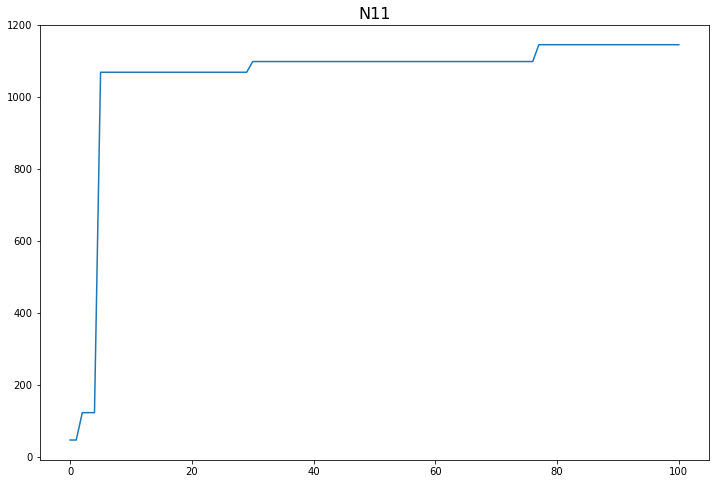

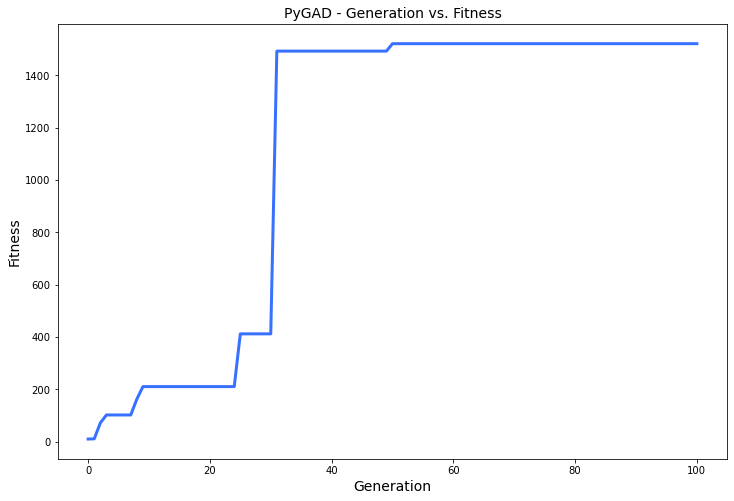

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.324 |==================| 3.79 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.525 |==================| 15.847 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.169 |==================| 2.383 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.726 |==================| 1.16 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.533 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.861 |==================| 9.51 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.744 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.623 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.957 |==================| 109.095 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.503 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.854 |==================| 8.957 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.312 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.849 |==================| 8.536 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.599 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.963 |==================| 332.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.907 |==================| 16.998 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.947 |==================| 53.51 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.825 |==================| 7.112 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.863 |==================| 9.669 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.653 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.919 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.908 |==================| 17.239 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.843 |==================| 8.111 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.947 |==================| 53.51 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.014 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.916 |==================| 19.792 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.911 |==================| 18.225 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.739 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.883 |==================| 12.028 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.877 |==================| 11.258 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.948 |==================| 54.788 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.898 |==================| 14.772 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.868 |==================| 10.244 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.133 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.825 |==================| 7.092 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.948 |==================| 54.016 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.892 |==================| 13.45 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.895 |==================| 14.168 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.923 |==================| 23.288 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.913 |==================| 18.734 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.905 |==================| 16.309 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.881 |==================| 11.795 |==========| N15 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.954 |==================| 80.663 |==========| N15 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.901 |==================| 15.429 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.833 |==================| 7.497 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 28.965 |==================| 1604.521 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.042 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.909 |==================| 17.435 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.848 |==================| 8.445 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.96 |==================| 172.507 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.92 |==================| 21.514 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.862 |==================| 9.592 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.877 |==================| 11.278 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 28.932 |==================| 29.662 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.866 |==================| 10.008 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.203 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.425 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.899 |==================| 14.918 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.862 |==================| 9.592 |==========| N15 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.832 |==================| 7.439 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.865 |==================| 9.907 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.15 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.826 |==================| 7.123 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.763 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.909 |==================| 17.461 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.884 |==================| 12.174 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.909 |==================| 17.625 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.945 |==================| 46.935 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.926 |==================| 24.878 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.885 |==================| 12.282 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.763 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.941 |==================| 39.303 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.893 |==================| 13.615 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.875 |==================| 10.972 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.069 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.938 |==================| 35.298 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.887 |==================| 12.694 |==========| N15 |==========
**********************************************************************
Fitness = 1604.5206555511775
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.919 |==================| 21.286 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.856 |==================| 9.105 |==========| N15 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.091 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.903 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.844 |==================| 8.185 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.863 |==================| 9.704 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.833 |==================| 7.507 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.911 |==================| 18.188 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.963 |==================| 326.734 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.946 |==================| 49.246 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.934 |==================| 31.642 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.358 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.933 |==================| 29.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.957 |==================| 112.564 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.826 |==================| 7.116 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.824 |==================| 7.048 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.842 |==================| 8.081 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.934 |==================| 31.642 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.829 |==================| 7.323 |==========| N15 |==========
**********************************************************************
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.825 |==================| 7.106 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.83 |==================| 7.355 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.708 |==========| N15 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.954 |==================| 82.049 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.836 |==================| 7.702 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.887 |==================| 12.622 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.396 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.962 |==================| 245.128 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.9 |==================| 15.099 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.942 |==================| 41.957 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.858 |==================| 9.271 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.834 |==================| 7.575 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.054 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.832 |==================| 7.45 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.355 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.873 |==================| 10.716 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.924 |==================| 23.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.903 |==================| 15.773 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.859 |==================| 9.318 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.959 |==================| 150.256 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.913 |==================| 18.891 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.885 |==================| 12.39 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.884 |==================| 12.187 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.841 |==================| 7.995 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.876 |==================| 11.084 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.846 |==================| 8.296 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.844 |==================| 8.226 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 252.907 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.925 |==================| 24.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.931 |==================| 28.687 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.939 |==================| 37.645 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.957 |==================| 107.311 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.023 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.881 |==================| 11.748 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.352 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.944 |==================| 45.574 |==========| N15 |==========
**********************************************************************
Fitness = 1604.5206555511775
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.961 |==================| 187.8 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 182.407 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.924 |==================| 24.008 |==========| N15 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.84 |==================| 7.941 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.936 |==================| 33.815 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.888 |==================| 12.744 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.938 |==================| 35.614 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.842 |==================| 8.051 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.788 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.973 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 28.835 |==================| 7.651 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.93 |==================| 27.605 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.905 |==================| 16.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.392 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.883 |==================| 11.975 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.9 |==================| 15.112 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.874 |==================| 10.831 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.855 |==================| 8.985 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.253 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.946 |==================| 49.199 |==========| N15 |==========
**********************************************************************
Generation = 14
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.861 |==================| 9.56 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 28.914 |==================| 19.152 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.833 |==================| 7.54 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.9 |==================| 15.106 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.834 |==================| 7.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.891 |==================| 13.253 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.956 |==================| 96.717 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.919 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.831 |==================| 7.411 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.91 |==================| 17.801 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.388 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.942 |==================| 42.095 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.851 |==================| 8.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.833 |==================| 7.54 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.83 |==================| 7.358 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.888 |==================| 12.847 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.925 |==================| 24.38 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.388 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.856 |==================| 9.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.885 |==================| 12.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.859 |==================| 9.319 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.831 |==================| 7.392 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.944 |==================| 44.425 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.962 |==================| 243.899 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.825 |==================| 7.097 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.84 |==================| 7.942 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.948 |==================| 56.707 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.461 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.111 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.96 |==================| 179.281 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.845 |==================| 8.256 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.917 |==================| 20.506 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.965 |==================| 674.599 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.912 |==================| 18.353 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.928 |==================| 26.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.831 |==================| 7.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.846 |==================| 8.347 |==========| N15 |==========
**********************************************************************
Fitness = 1604.5206555511775
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.104 |==========| N15 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.954 |==================| 81.461 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 28.848 |==================| 8.458 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.913 |==================| 18.888 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.846 |==================| 8.315 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.715 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.866 |==================| 9.999 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.833 |==================| 7.541 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 86.306 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.83 |==================| 7.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 184.176 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.746 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.715 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.916 |==================| 20.054 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.391 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.898 |==================| 14.715 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.85 |==================| 8.597 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.306 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.931 |==================| 28.844 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.827 |==================| 7.207 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.891 |==================| 13.397 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.95 |==================| 62.072 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.882 |==================| 11.827 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.306 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.931 |==================| 28.844 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 28.848 |==================| 8.454 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.916 |==================| 19.798 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.921 |==================| 22.294 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.851 |==================| 8.661 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.514 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 28.849 |==================| 8.542 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.944 |==================| 45.907 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.944 |==================| 44.448 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.94 |==================| 38.358 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.92 |==================| 21.501 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.965 |==================| 676.688 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.514 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.874 |==================| 10.832 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.898 |==================| 14.739 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.908 |==================| 17.307 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.882 |==================| 11.917 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.871 |==================| 10.47 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.945 |==================| 48.635 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.919 |==================| 21.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.882 |==================| 11.898 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.94 |==================| 39.0 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.908 |==================| 17.276 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.952 |==================| 69.668 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.897 |==================| 14.436 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.593 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.947 |==================| 51.958 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.826 |==================| 7.139 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.887 |==================| 12.687 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.964 |==================| 395.554 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.593 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.947 |==================| 51.958 |==========| N15 |==========
********************************************************************

======| 0.095 |===========| 28.954 |==================| 85.881 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.932 |==================| 29.403 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.956 |==================| 99.161 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.969 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.076 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.894 |==================| 13.823 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.924 |==================| 23.513 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.691 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.951 |==================| 68.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.841 |==================| 7.992 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.352 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.076 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.956 |==================| 102.469 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.83 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.965 |==================| 674.244 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.746 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 19.969 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.917 |==================| 20.436 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 28.953 |==================| 74.19 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.865 |==================| 9.883 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.884 |==================| 12.189 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.926 |==================| 24.69 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.894 |==================| 13.844 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.827 |==================| 7.202 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.099 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.95 |==================| 62.667 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.967 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.918 |==================| 20.895 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.123 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.959 |==================| 140.333 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.918 |==================| 20.91 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.939 |==================| 37.042 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.296 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.612 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.915 |==================| 19.456 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.874 |==================| 10.816 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.42 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 83.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.932 |==================| 29.538 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.965 |==================| 1042.165 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.132 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.923 |==================| 23.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.503 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 83.421 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 21.004 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.95 |==================| 62.201 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.93 |==================| 28.073 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.132 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.919 |==================| 21.219 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.905 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.896 |==================| 14.273 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.955 |==================| 92.747 |==========| N15 |==========
*******************************************************************

======| 0.077 |===========| 28.957 |==================| 106.344 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.9 |==================| 15.028 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.935 |==================| 32.319 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.842 |==================| 8.084 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.961 |==================| 203.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.948 |==================| 54.916 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.957 |==================| 106.344 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.9 |==================| 15.028 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.942 |==================| 41.407 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.893 |==================| 13.63 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.665 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.915 |==================| 19.744 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 28.86 |==================| 9.407 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.832 |==================| 7.433 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.949 |==================| 60.015 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.942 |==================| 41.407 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.786 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.954 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.922 |==================| 22.613 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.306 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.834 |==================| 7.552 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.895 |==================| 14.093 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.928 |==================| 26.442 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.906 |==================| 16.546 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.949 |==================| 59.097 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.887 |==================| 12.615 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 28.88 |==================| 11.63 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.834 |==================| 7.552 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.873 |==================| 10.696 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.877 |==================| 11.285 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.522 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.95 |==================| 63.364 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.841 |==================| 8.009 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.896 |==================| 14.335 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.85 |==================| 8.651 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 28.847 |==================| 8.396 |==========| N15 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.871 |==================| 10.472 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 28.966 |==================| 21906.333 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.945 |==================| 48.013 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.841 |==================| 8.009 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.885 |==================| 12.345 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.265 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.889 |==================| 12.965 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.244 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.426 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 28.853 |==================| 8.866 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.883 |==================| 12.102 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.943 |==================| 43.01 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.94 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.896 |==================| 14.322 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.937 |==================| 34.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.917 |==================| 20.427 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.859 |==================| 9.322 |==========| N15 |==========
**********************************************************************
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.299 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.95 |==================| 62.081 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.935 |==================| 32.324 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.939 |==================| 36.79 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.893 |==================| 13.75 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.964 |==================| 531.142 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.859 |==================| 9.322 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.833 |==================| 7.498 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.871 |==================| 10.561 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.844 |==================| 8.204 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.939 |==================| 36.79 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.539 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.959 |==================| 149.412 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.87 |==================| 10.39 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.929 |==================| 26.655 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.867 |==================| 10.056 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.864 |==================| 9.767 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.891 |==================| 13.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.912 |==================| 18.475 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.958 |==================| 125.965 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.849 |==================| 8.517 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.053 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.959 |==================| 147.447 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 28.945 |==================| 48.141 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 28.841 |==================| 8.003 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.864 |==================| 9.763 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.958 |==================| 125.965 |==========| N15 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.886 |==================| 12.439 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.143 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.833 |==================| 7.494 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.851 |==================| 8.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.911 |==================| 18.294 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.939 |==================| 37.412 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.951 |==================| 65.716 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.929 |==================| 27.021 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.942 |==================| 41.886 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.865 |==================| 9.924 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.658 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.833 |==================| 7.511 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.909 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.11 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.955 |==================| 86.989 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.931 |==================| 28.603 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.964 |==================| 403.909 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.946 |==================| 48.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.89 |==================| 13.185 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.862 |==================| 9.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.02 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.939 |==================| 37.039 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.948 |==================| 55.553 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.906 |==================| 16.751 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.924 |==================| 23.847 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.839 |==================| 7.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.951 |==================| 64.994 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.841 |==================| 7.977 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 19.98 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.888 |==================| 12.74 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.839 |==================| 7.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.951 |==================| 64.994 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.827 |==================| 7.166 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.36 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.826 |==================| 7.147 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.932 |==================| 28.965 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.216 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.885 |==================| 12.264 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.931 |==================| 28.701 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.874 |==================| 10.904 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.871 |==================| 10.478 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.932 |==================| 28.965 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.906 |==================| 16.658 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.918 |==================| 20.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 28.927 |==================| 25.518 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.862 |==================| 9.585 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.698 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.886 |==================| 12.454 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.957 |==================| 115.368 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.954 |==================| 83.706 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.934 |==================| 31.661 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.956 |==================| 100.805 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.879 |==================| 11.477 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.898 |==================| 14.613 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.954 |==================| 82.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.058 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.235 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.966 |==================| 2165.858 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.928 |==================| 25.973 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.892 |==================| 13.439 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.883 |==================| 12.051 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.895 |==================| 14.034 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.867 |==================| 10.115 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 33.991 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.849 |==================| 8.531 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.855 |==================| 8.999 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.955 |==================| 92.062 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.901 |==================| 15.297 |==========| N15 |==========
**********************************************************************
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 28.909 |==================| 17.521 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.949 |==================| 58.191 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.387 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.412 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 65.758 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.847 |==================| 8.415 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.668 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.328 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.888 |==================| 12.836 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.387 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.852 |==================| 8.782 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.878 |==================| 11.386 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 28.84 |==================| 7.927 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.853 |==================| 8.808 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.873 |==================| 10.77 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.919 |==================| 21.317 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.175 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 236.722 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.961 |==================| 212.377 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.9 |==================| 15.136 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.905 |==================| 16.283 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.957 |==================| 104.71 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.189 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.953 |==================| 76.397 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.931 |==================| 28.477 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.95 |==================| 62.822 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.915 |==================| 19.522 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.906 |==================| 16.701 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.85 |==================| 8.597 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.874 |==================| 10.881 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.881 |==================| 11.8 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.824 |==================| 7.048 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.859 |==================| 9.379 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.825 |==================| 7.102 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.84 |==================| 7.952 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.886 |==================| 12.519 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.904 |==================| 16.151 |==========| N15 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.839 |==================| 7.855 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.955 |==================| 86.67 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.914 |==================| 19.283 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.964 |==================| 532.961 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.849 |==================| 8.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.948 |==================| 56.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.876 |==================| 11.056 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.902 |==================| 15.718 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.45 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.824 |==================| 7.057 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.924 |==================| 23.5 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 141.406 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.903 |==================| 15.928 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.849 |==================| 8.508 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.88 |==================| 11.56 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.45 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.953 |==================| 76.367 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.943 |==================| 44.005 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.714 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.101 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.468 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.951 |==================| 67.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.964 |==================| 451.319 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.889 |==================| 12.96 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.878 |==================| 11.355 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.366 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.925 |==================| 24.611 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.907 |==================| 17.035 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.831 |==================| 7.389 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.832 |==================| 7.479 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.842 |==================| 8.077 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.94 |==================| 37.725 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.846 |==================| 8.352 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.884 |==================| 12.241 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.898 |==================| 14.794 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.964 |==================| 396.314 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.147 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.957 |==================| 115.97 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.748 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.846 |==================| 8.352 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.939 |==================| 37.038 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.759 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.951 |==================| 68.013 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.901 |==================| 15.486 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.933 |==================| 30.537 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.929 |==================| 26.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.864 |==================| 9.757 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.939 |==================| 36.809 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 28.869 |==================| 10.299 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.091 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.858 |==================| 9.27 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.616 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.658 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.863 |==================| 9.692 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.955 |==================| 92.876 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.93 |==================| 27.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.873 |==================| 10.725 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.847 |==================| 8.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.616 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.122 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.963 |==================| 302.52 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.895 |==================| 14.013 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.831 |==================| 7.38 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.846 |==================| 8.332 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.673 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.924 |==================| 23.558 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.122 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.893 |==================| 13.76 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.632 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.829 |==================| 7.298 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.913 |==================| 18.734 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 28.888 |==================| 12.804 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.126 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.835 |==================| 7.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.906 |==================| 16.701 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.855 |==================| 8.985 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.826 |==================| 7.116 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.855 |==================| 8.969 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.865 |==================| 9.9 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.942 |==================| 41.669 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.837 |==================| 7.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 238.886 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.203 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.931 |==================| 28.284 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.959 |==================| 145.976 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.868 |==================| 10.211 |==========| N15 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.829 |==================| 7.297 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.858 |==================| 9.222 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.836 |==================| 7.674 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.516 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.93 |==================| 27.721 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.958 |==================| 119.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.58 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.878 |==================| 11.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.861 |==================| 9.534 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.911 |==================| 18.323 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.885 |==================| 12.401 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.949 |==================| 59.187 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.856 |==================| 9.066 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.954 |==================| 85.219 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.864 |==================| 9.754 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 28.965 |==================| 1629.884 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.911 |==================| 18.323 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.936 |==================| 32.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.111 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.911 |==================| 18.008 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.869 |==================| 10.29 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.947 |==================| 52.149 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.834 |==================| 7.594 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.055 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.922 |==================| 22.673 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 19.973 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.101 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.906 |==================| 16.562 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.919 |==================| 21.178 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.962 |==================| 258.694 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.965 |==================| 1031.181 |==========| N15 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.895 |==================| 14.068 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.852 |==================| 8.747 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.857 |==================| 9.147 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.906 |==================| 16.562 |==========| N15 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.96 |==================| 170.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.946 |==================| 49.006 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.727 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.964 |==================| 523.81 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.838 |==================| 7.821 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.849 |==================| 8.554 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.29 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.892 |==================| 13.45 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.941 |==================| 39.768 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.901 |==================| 15.46 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.838 |==================| 7.821 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.894 |==================| 13.877 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.3 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.9 |==================| 15.242 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.894 |==================| 13.836 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.685 |==========| N15 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 28.966 |==================| 8603.254 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.915 |==================| 19.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.827 |==================| 7.204 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.085 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.93 |==================| 27.558 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.244 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.961 |==================| 186.683 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.964 |==================| 627.279 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.929 |==================| 26.708 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.911 |==================| 18.226 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.849 |==================| 8.528 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.394 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.832 |==================| 7.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.6 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.9 |==================| 15.182 |==========| N15 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.559 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.957 |==================| 108.985 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.921 |==================| 22.394 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.852 |==================| 8.75 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.86 |==================| 9.444 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.85 |==================| 8.601 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.907 |==================| 16.966 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.881 |==================| 11.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.327 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.932 |==================| 29.24 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.852 |==================| 8.75 |==========| N15 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.614 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.942 |==================| 42.027 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.884 |==================| 12.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.871 |==================| 10.561 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.635 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 221.703 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.877 |==================| 11.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.83 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.825 |==================| 7.071 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.923 |==================| 22.999 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.897 |==================| 14.383 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.635 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.904 |==================| 16.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.867 |==================| 10.113 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.844 |==================| 8.166 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.923 |==================| 23.073 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.88 |==================| 11.658 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.905 |==================| 16.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.924 |==================| 23.603 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.832 |==================| 7.456 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.898 |==================| 14.702 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.142 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.917 |==================| 20.534 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.946 |==================| 49.66 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.079 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.965 |==================| 998.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.899 |==================| 14.829 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.739 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.929 |==================| 26.97 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.899 |==================| 14.859 |==========| N15 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.899 |==================| 15.002 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.851 |==================| 8.678 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.829 |==================| 7.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.921 |==================| 21.955 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.881 |==================| 11.818 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.946 |==================| 50.949 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.314 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.95 |==================| 61.141 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.964 |==================| 410.573 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.829 |==================| 7.321 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.883 |==================| 11.985 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.91 |==================| 17.839 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.906 |==================| 16.585 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.914 |==================| 19.291 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.119 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.83 |==================| 7.363 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.88 |==================| 11.655 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.835 |==================| 7.623 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.871 |==================| 10.515 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.946 |==================| 48.91 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.938 |==================| 35.764 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.949 |==================| 57.037 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.861 |==================| 9.527 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.878 |==================| 11.367 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.824 |==================| 7.017 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.881 |==================| 11.724 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.841 |==================| 7.969 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.824 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.907 |==================| 17.036 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.942 |==================| 41.905 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.824 |==================| 7.032 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.145 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.923 |==================| 23.206 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.868 |==================| 10.226 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.899 |==================| 14.984 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.946 |==================| 50.828 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 28.888 |==================| 12.808 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.828 |==================| 7.236 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.059 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 28.96 |==================| 169.107 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.897 |==================| 14.486 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.876 |==================| 11.157 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.931 |==================| 28.711 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 225.356 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.885 |==================| 12.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 86.12 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.923 |==================| 23.437 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.953 |==================| 79.076 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.708 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.952 |==================| 68.967 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.626 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.913 |==================| 19.023 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.943 |==================| 43.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.831 |==================| 7.395 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.891 |==================| 13.332 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.963 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.668 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.041 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.84 |==================| 7.949 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.96 |==================| 164.481 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.926 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.928 |==================| 26.374 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.867 |==================| 10.057 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.876 |==================| 11.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.843 |==================| 8.111 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.862 |==================| 9.585 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.067 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.898 |==================| 14.65 |==========| N15 |==========
**********************************************************************
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.958 |==================| 119.321 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.965 |==================| 844.431 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.918 |==================| 20.847 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.857 |==================| 9.157 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.951 |==================| 67.408 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.857 |==================| 9.166 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.839 |==================| 7.895 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.825 |==================| 7.1 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.582 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.918 |==================| 20.847 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.529 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.827 |==================| 7.171 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.914 |==================| 19.377 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.844 |==================| 8.162 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.9 |==================| 15.029 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.961 |==================| 213.765 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.934 |==================| 30.891 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.529 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 100.233 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.849 |==================| 8.563 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.136 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.879 |==================| 11.507 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.836 |==================| 7.695 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.895 |==================| 14.052 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.901 |==================| 15.484 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.964 |==================| 529.466 |==========| N15 |==========
*******************************************************************

======| 0.886 |===========| 28.842 |==================| 8.04 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.882 |==================| 11.908 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 28.865 |==================| 9.942 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.906 |==================| 16.769 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 28.955 |==================| 88.211 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 28.934 |==================| 31.033 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.932 |==================| 29.785 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.851 |==================| 8.703 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.927 |==================| 25.529 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.911 |==================| 18.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.593 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.875 |==================| 10.977 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.943 |==================| 43.84 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.901 |==================| 15.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.962 |==================| 245.962 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.874 |==================| 10.831 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.826 |==================| 7.142 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.858 |==================| 9.225 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.907 |==================| 17.058 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.897 |==================| 14.503 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.866 |==================| 10.033 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.932 |==================| 29.457 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.9 |==================| 15.069 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.826 |==================| 7.142 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.901 |==================| 15.472 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.891 |==================| 13.306 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.866 |==================| 10.033 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.84 |==================| 7.962 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 28.877 |==================| 11.219 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.881 |==================| 11.8 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.941 |==================| 39.804 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.759 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.948 |==================| 54.32 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.851 |==================| 8.727 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.93 |==================| 27.913 |==========| N15 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.879 |==================| 11.477 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.124 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.953 |==================| 75.661 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.759 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.893 |==================| 13.743 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.884 |==================| 12.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.956 |==================| 96.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.965 |==================| 1312.792 |==========| N15 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.903 |==================| 15.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.89 |==================| 13.139 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.94 |==================| 38.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.901 |==================| 15.323 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.804 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.92 |==================| 21.929 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.939 |==================| 36.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.94 |==================| 38.313 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.953 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.925 |==================| 24.074 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.898 |==================| 14.778 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.899 |==================| 14.974 |==========| N15 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.884 |==================| 12.243 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.957 |==================| 111.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.5 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.938 |==================| 35.43 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.91 |==================| 17.81 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.844 |==================| 8.206 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.938 |==================| 36.019 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.861 |==================| 9.544 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 28.897 |==================| 14.384 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.873 |==================| 10.714 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.936 |==================| 33.644 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.851 |==================| 8.661 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.839 |==================| 7.86 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.846 |==================| 8.329 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.904 |==================| 16.188 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.919 |==================| 21.462 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.603 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.844 |==================| 8.19 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.964 |==================| 443.724 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.874 |==================| 10.916 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.878 |==================| 11.314 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.908 |==================| 17.165 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.894 |==================| 13.869 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.848 |==================| 8.503 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.874 |==================| 10.874 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.964 |==================| 515.244 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.849 |==================| 8.562 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.856 |==================| 9.085 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.66 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.835 |==================| 7.616 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.836 |==================| 7.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.9 |==================| 15.168 |==========| N15 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.779 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.887 |==================| 12.665 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.89 |==================| 13.23 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.961 |==================| 189.02 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.825 |==================| 7.084 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.879 |==================| 11.424 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.879 |==================| 11.445 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.943 |==================| 44.189 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.825 |==================| 7.101 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.944 |==================| 44.338 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.675 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.643 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.894 |==================| 13.799 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.138 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.891 |==================| 13.325 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.133 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.962 |==================| 243.88 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.922 |==================| 22.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.868 |==================| 10.165 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.834 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 28.886 |==================| 12.499 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.249 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.851 |==================| 8.701 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.944 |==================| 45.177 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.951 |==================| 68.128 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.96 |==================| 175.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.351 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.824 |==================| 7.023 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.901 |==================| 15.371 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.811 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.419 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.957 |==================| 112.141 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.911 |==================| 18.31 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.873 |==================| 10.69 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.898 |==================| 14.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.879 |==================| 11.541 |==========| N15 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.853 |==================| 8.847 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 28.854 |==================| 8.94 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 28.911 |==================| 18.12 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.862 |==================| 9.577 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.857 |==================| 9.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.908 |==================| 17.318 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.829 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.945 |==================| 46.607 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.95 |==================| 63.343 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.843 |==================| 8.094 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.892 |==================| 13.489 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.782 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.346 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.467 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.886 |==================| 12.476 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.864 |==================| 9.793 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.924 |==================| 23.908 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.899 |==================| 14.998 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.94 |==================| 38.829 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 28.918 |==================| 20.682 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.905 |==================| 16.34 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.953 |==================| 76.379 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.906 |==================| 16.789 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.96 |==================| 153.688 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.856 |==================| 9.122 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 28.86 |==================| 9.456 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.886 |==================| 12.531 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.905 |==================| 16.34 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.928 |==================| 25.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.873 |==================| 10.713 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.862 |==================| 9.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.876 |==================| 11.109 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 28.838 |==================| 7.822 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.337 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.915 |==================| 19.575 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.842 |==================| 8.03 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.899 |==================| 14.914 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.8 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.906 |==================| 16.632 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.604 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.241 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.865 |==================| 9.916 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.464 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.864 |==================| 9.761 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.91 |==================| 17.683 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.872 |==================| 10.628 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 182.979 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 28.856 |==================| 9.082 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.912 |==================| 18.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.949 |==================| 59.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.957 |==================| 114.271 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.924 |==================| 23.678 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.951 |==================| 67.562 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.959 |==================| 149.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.955 |==================| 94.192 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.877 |==================| 11.291 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.913 |==================| 18.833 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.459 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.833 |==================| 7.504 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.951 |==================| 66.531 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.96 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.883 |==================| 12.11 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.964 |==================| 416.683 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.773 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.911 |==================| 18.011 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.923 |==================| 23.467 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.894 |==================| 13.943 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.662 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.956 |==================| 104.172 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.918 |==================| 20.995 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.912 |==================| 18.352 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.183 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 33.951 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.875 |==================| 10.956 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.216 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.959 |==================| 151.537 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.914 |==================| 19.392 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.883 |==================| 12.087 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.214 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 28.96 |==================| 167.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.857 |==================| 9.199 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.207 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.895 |==================| 14.119 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.912 |==================| 18.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 28.931 |==================| 28.384 |==========| N15 |==========
**********************************************************************
Generation = 89
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 28.933 |==================| 30.028 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.945 |==================| 48.638 |==========| N15 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.232 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 28.835 |==================| 7.644 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.19 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.826 |==================| 7.14 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.827 |==================| 7.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.942 |==================| 41.068 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.887 |==================| 12.683 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.909 |==================| 17.667 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.125 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.016 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.925 |==================| 24.071 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.929 |==================| 26.756 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.946 |==================| 49.021 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.952 |==================| 72.978 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.928 |==================| 25.949 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 28.888 |==================| 12.882 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.864 |==================| 9.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.904 |==================| 16.225 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.927 |==================| 25.829 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.137 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 28.945 |==================| 46.567 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.913 |==================| 18.725 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.879 |==================| 11.426 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.964 |==================| 423.901 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.85 |==================| 8.646 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.912 |==================| 18.519 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.682 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 28.963 |==================| 287.736 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.934 |==================| 30.764 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.938 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.877 |==================| 11.274 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.858 |==================| 9.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.916 |==================| 19.929 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.844 |==================| 8.195 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.896 |==================| 14.33 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.956 |==================| 94.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.848 |==================| 8.472 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.833 |==================| 7.513 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.916 |==================| 20.045 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.878 |==================| 11.319 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 28.845 |==================| 8.253 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.889 |==================| 12.918 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.848 |==================| 8.465 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.942 |==================| 41.729 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.834 |==================| 7.549 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.925 |==================| 24.231 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.866 |==================| 10.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.827 |==================| 7.17 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.889 |==================| 12.918 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 238.76 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.918 |==================| 20.942 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.957 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.3 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.929 |==================| 26.855 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.939 |==================| 37.306 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.96 |==================| 158.608 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.471 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.943 |==================| 43.889 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.963 |==================| 326.55 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.395 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.952 |==================| 73.507 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.839 |==================| 7.85 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.951 |==================| 67.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.916 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.836 |==================| 7.7 |==========| N15 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.048 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.83 |==================| 7.339 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.833 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 28.922 |==================| 22.903 |==========| N15 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.223 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.964 |==================| 440.093 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 28.857 |==================| 9.135 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.836 |==================| 7.714 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.864 |==================| 9.825 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.857 |==================| 9.151 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.948 |==================| 55.815 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.951 |==================| 66.834 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.884 |==================| 12.256 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.882 |==================| 11.883 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.871 |==================| 10.5 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.905 |==================| 16.323 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.604 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 28.86 |==================| 9.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.229 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.876 |==================| 11.074 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.902 |==================| 15.589 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.423 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.879 |==================| 11.55 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.889 |==================| 12.99 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.952 |==================| 69.153 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.866 |==================| 9.965 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.617 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.914 |==================| 19.259 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.871 |==================| 10.575 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 28.962 |==================| 231.24 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.934 |==================| 30.877 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.953 |==================| 77.67 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.89 |==================| 13.084 |==========| N15 |==========
**********************************************************************
Fitness = 21906.33280571824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.872 |==================| 10.683 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.591 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.721 |==========| N15 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.851 |==================| 8.694 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.827 |==================| 7.206 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.417 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.648 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.934 |==================| 31.383 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.947 |==================| 52.086 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.834 |==================| 7.558 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.9 |==================| 15.139 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.877 |==================| 11.257 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.894 |==================| 13.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.849 |==================| 8.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.934 |==================| 31.383 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.914 |==================| 19.395 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.964 |==================| 552.267 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.826 |==================| 7.162 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 265.456 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.959 |==================| 144.207 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.897 |==================| 14.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.965 |==================| 1048.268 |==========| N15 |==========
**********************************************************************
Generation = 100
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.953 |==================| 74.418 |==========| N15 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.905 |==================| 16.294 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.886 |==================| 12.541 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.958 |==================| 121.801 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 83.019 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.886 |==================| 12.534 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.921 |==================| 22.246 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.907 |==================| 16.904 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.573 |==========| N15 |==========
********************************************************************

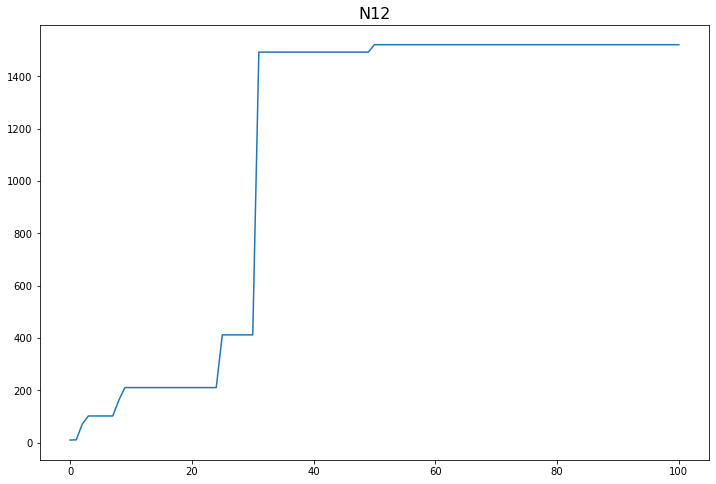

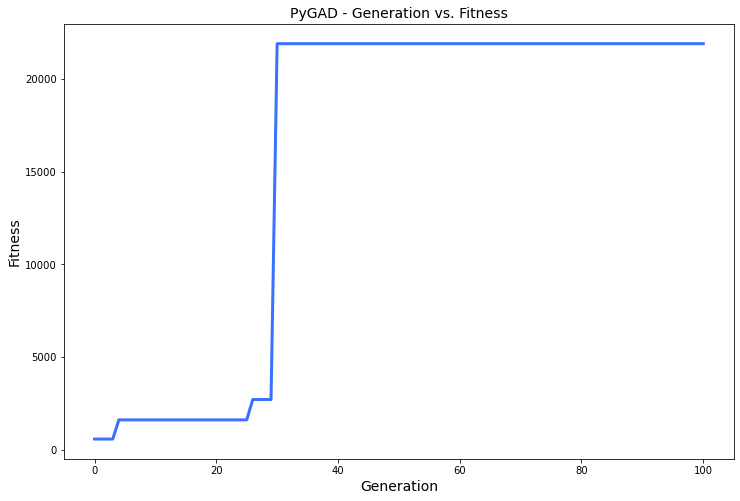

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.953 |==================| 74.418 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.875 |==================| 11.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.129 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.529 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.208 |==================| 22.337 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.216 |==================| 26.964 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.205 |==================| 20.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.596 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.24 |==================| 77.82 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.03 |==================| 4.471 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.527 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.016 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.203 |==================| 20.068 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.233 |==================| 50.493 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.036 |==================| 4.599 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.149 |==================| 9.589 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.712 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.001 |==================| 3.972 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.106 |==================| 6.802 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.548 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.04 |==================| 4.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.267 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.038 |==================| 4.644 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.047 |==================| 4.86 |==========| N16 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.116 |==================| 7.294 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.745 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.203 |==================| 20.015 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.193 |==================| 16.582 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.082 |==================| 5.849 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.472 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.192 |==================| 16.283 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.1 |==================| 6.518 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.207 |==================| 21.571 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.023 |==================| 4.351 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.096 |==================| 6.374 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.141 |==================| 8.909 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.293 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.048 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.043 |==================| 4.757 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.006 |==================| 4.041 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.454 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.086 |==================| 5.992 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.243 |==================| 95.082 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.226 |==================| 36.551 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.251 |==================| 385.595 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.039 |==================| 4.664 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.457 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.19 |==================| 15.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 27.082 |==================| 5.829 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.245 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.175 |==================| 12.789 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.058 |==================| 5.117 |==========| N16 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.241 |==================| 82.666 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.19 |==================| 15.878 |==========| N16 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.05 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.126 |==================| 7.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.148 |==================| 9.514 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.66 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.146 |==================| 9.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.192 |==================| 16.284 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.169 |==================| 11.874 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.2 |==================| 18.698 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.003 |==================| 3.99 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.059 |==================| 5.151 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.117 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.532 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.159 |==================| 10.671 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.214 |==================| 25.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.293 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.221 |==================| 30.843 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.116 |==================| 7.301 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.122 |==================| 7.595 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.612 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.096 |==================| 6.368 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.028 |==================| 4.444 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.116 |==================| 7.276 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.119 |==================| 7.427 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.191 |==================| 16.093 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.219 |==================| 29.249 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.001 |==================| 3.968 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.029 |==================| 4.465 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 27.028 |==================| 4.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 27.096 |==================| 6.379 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.063 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.078 |==================| 5.709 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.135 |==================| 8.459 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.003 |==================| 3.99 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.103 |==================| 6.645 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.072 |==================| 5.53 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.601 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.138 |==================| 8.683 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.244 |==================| 109.295 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.721 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.234 |==================| 51.204 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.729 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.137 |==================| 8.631 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.162 |==================| 10.922 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.06 |==================| 5.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.148 |==================| 9.502 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.237 |==================| 62.865 |==========| N16 |==========
**********************************************************************
Fitness = 545.7265039782978
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.212 |==================| 24.523 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.222 |==================| 31.568 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.101 |==================| 6.583 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.141 |==================| 8.937 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.081 |==================| 5.81 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.13 |==================| 8.131 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.005 |==================| 4.029 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.233 |==================| 48.903 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.897 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.02 |==================| 4.285 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.085 |==================| 5.957 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.184 |==================| 14.404 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.026 |==================| 4.393 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.02 |==================| 4.282 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.126 |==================| 7.837 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.241 |==================| 83.094 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.094 |==================| 6.291 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.224 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.09 |==================| 6.132 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.158 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.188 |==================| 15.453 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.958 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.06 |==================| 5.188 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.025 |==================| 4.374 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.232 |==================| 46.465 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.039 |==================| 4.667 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.071 |==================| 5.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.728 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.253 |==================| 4575.893 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.196 |==================| 17.399 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.196 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.028 |==================| 4.448 |==========| N16 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.202 |==================| 19.719 |==========| N16 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.021 |==================| 4.314 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.502 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.073 |==================| 5.559 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 27.069 |==================| 5.441 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.378 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.041 |==================| 4.702 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.232 |==================| 46.132 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.033 |==================| 4.548 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.031 |==================| 4.504 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.102 |==================| 6.618 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.135 |==================| 8.43 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.125 |==================| 7.8 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.737 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.095 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.546 |==========| N16 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.558 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.978 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.121 |==================| 7.551 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.116 |==================| 7.283 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.228 |==================| 39.545 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.039 |==================| 4.678 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.002 |==================| 3.978 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.134 |==================| 8.371 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.182 |==================| 13.995 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.087 |==================| 6.032 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.115 |==================| 7.255 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.121 |==================| 7.549 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.209 |==================| 22.419 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.398 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.098 |==================| 6.424 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.14 |==================| 8.833 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.245 |==================| 123.892 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.242 |==================| 85.614 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 26.998 |==================| 3.915 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.108 |==================| 6.888 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.103 |==================| 6.644 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.999 |==================| 3.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.069 |==================| 5.422 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.157 |==================| 10.414 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.23 |==================| 43.987 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.094 |==================| 6.269 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.023 |==================| 4.342 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.13 |==================| 8.15 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.702 |==========| N16 |==========
**********************************************************************
Fitness = 4575.893432142072
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.239 |==================| 70.34 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.708 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.14 |==================| 8.812 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.064 |==================| 5.274 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.396 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.159 |==================| 10.66 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.131 |==================| 8.152 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.019 |==================| 4.266 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.241 |==================| 83.695 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.199 |==================| 18.61 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.126 |==================| 7.883 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.415 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 27.061 |==================| 5.198 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.131 |==================| 8.152 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.204 |==================| 20.518 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.014 |==================| 4.181 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.157 |==================| 10.398 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.138 |==================| 8.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.218 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.172 |==================| 12.243 |==========| N16 |==========
**********************************************************************
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.531 |==========| N16 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.388 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.241 |==================| 82.312 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 27.142 |==================| 8.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.571 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.068 |==================| 5.414 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.126 |==================| 7.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.173 |==================| 12.433 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.134 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.013 |==================| 4.171 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.246 |==================| 147.529 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.237 |==================| 60.401 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.875 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.16 |==================| 10.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.052 |==================| 4.962 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.628 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.241 |==================| 78.778 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.084 |==================| 5.904 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.216 |==================| 27.099 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.022 |==================| 4.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.002 |==================| 3.977 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.148 |==================| 9.487 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.169 |==================| 11.879 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.918 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.895 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.107 |==================| 6.84 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.234 |==================| 50.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.103 |==================| 6.678 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.225 |==================| 35.586 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.014 |==================| 4.177 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.178 |==================| 13.36 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.238 |==================| 66.418 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.12 |==================| 7.512 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.094 |==================| 6.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.007 |==================| 4.059 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.919 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.071 |==================| 5.495 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.09 |==================| 6.14 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.827 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.115 |==================| 7.256 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.139 |==================| 8.794 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.193 |==================| 16.739 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.077 |==================| 5.678 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.089 |==================| 6.072 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.043 |==================| 4.769 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.093 |==================| 6.24 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.868 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.974 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.053 |==================| 4.996 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.024 |==================| 4.372 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.223 |==================| 33.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.683 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.07 |==================| 5.471 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.121 |==================| 7.567 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.113 |==================| 7.111 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.78 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.042 |==================| 4.74 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.045 |==================| 4.796 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.178 |==================| 13.269 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.129 |==================| 8.054 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.177 |==================| 13.163 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.159 |==================| 10.566 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.059 |==================| 5.144 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.042 |==================| 4.74 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.744 |==========| N16 |==========
**********************************************************************
Generation = 24
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.196 |==================| 17.354 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.05 |==================| 4.933 |==========| N16 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.182 |==================| 14.029 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.214 |==================| 25.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.03 |==================| 4.488 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.244 |==================| 103.398 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.196 |==================| 17.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.999 |==================| 3.931 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.243 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.072 |==================| 5.526 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.005 |==================| 4.022 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.772 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.358 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.18 |==================| 13.707 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.05 |==================| 4.91 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.261 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.134 |==================| 8.356 |==========| N16 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.234 |==================| 51.584 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.991 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.22 |==================| 29.934 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.212 |==================| 24.063 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.147 |==================| 9.453 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.065 |==================| 5.315 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 126.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.102 |==================| 6.633 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.096 |==================| 6.366 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.162 |==================| 10.985 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.178 |==================| 13.219 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.109 |==================| 6.933 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.774 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.205 |==================| 20.571 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.687 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 126.162 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.219 |==================| 29.381 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.178 |==================| 13.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.836 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.188 |==================| 15.247 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.748 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.865 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.476 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.212 |==================| 24.473 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.0 |==================| 3.948 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.066 |==================| 5.348 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.243 |==================| 100.305 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.056 |==================| 5.08 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.047 |==================| 4.86 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.155 |==================| 10.136 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.185 |==================| 14.581 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.117 |==================| 7.366 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.088 |==================| 6.067 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.181 |==================| 13.919 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.043 |==================| 4.758 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.011 |==================| 4.133 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.15 |==================| 9.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.078 |==================| 5.71 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.348 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.155 |==================| 10.182 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.048 |==================| 4.863 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.026 |==================| 4.396 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.174 |==================| 12.562 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.15 |==================| 9.705 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.057 |==================| 5.085 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.149 |==================| 9.573 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.869 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.143 |==================| 9.075 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.188 |==================| 15.254 |==========| N16 |==========
**********************************************************************
Generation = 30
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.001 |==================| 3.957 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.1 |==================| 6.508 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.05 |==================| 4.911 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.099 |==================| 6.506 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.217 |==================| 27.684 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.636 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.172 |==================| 12.317 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.092 |==================| 6.193 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.025 |==================| 4.385 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.199 |==================| 18.434 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.013 |==================| 4.168 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.134 |==================| 8.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.377 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.187 |==================| 15.077 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.805 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.214 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.207 |==================| 21.546 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.06 |==================| 5.168 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.215 |==================| 26.17 |==========| N16 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 27.144 |==================| 9.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.038 |==================| 4.644 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.214 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.875 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.208 |==================| 22.076 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.107 |==================| 6.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.146 |==================| 9.371 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.066 |==================| 5.332 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.059 |==================| 5.162 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.151 |==================| 9.809 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.019 |==================| 4.272 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.045 |==================| 4.795 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.113 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.253 |==================| 1491.945 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.033 |==================| 4.543 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.209 |==================| 22.391 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.757 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.223 |==================| 33.051 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.855 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.05 |==================| 4.933 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.897 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.02 |==================| 4.287 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.04 |==================| 4.699 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.74 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.178 |==================| 13.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.241 |==================| 82.628 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.207 |==================| 21.733 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.033 |==================| 4.538 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.023 |==================| 4.338 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.009 |==================| 4.089 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.06 |==================| 5.178 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.25 |==================| 315.661 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.059 |==================| 5.146 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.252 |==================| 1274.983 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.166 |==================| 11.495 |==========| N16 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.164 |==================| 11.214 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.183 |==================| 14.307 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.094 |==================| 6.281 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.83 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.068 |==================| 5.389 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.043 |==================| 4.753 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.04 |==================| 4.683 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.035 |==================| 4.59 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.235 |==================| 54.538 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.214 |==================| 25.34 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.693 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.171 |==================| 12.204 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.065 |==================| 5.308 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.066 |==================| 5.33 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.018 |==================| 4.26 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.204 |==================| 20.42 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.02 |==================| 4.294 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.167 |==================| 11.588 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.615 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.065 |==================| 5.308 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.131 |==================| 8.157 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.063 |==================| 5.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.233 |==================| 48.337 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.091 |==================| 6.17 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.026 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.24 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.229 |==================| 40.763 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.527 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.293 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.777 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.235 |==================| 54.407 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.466 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.983 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.056 |==================| 5.066 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.119 |==================| 7.451 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.132 |==================| 8.26 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.243 |==================| 95.179 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.067 |==================| 5.368 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.05 |==================| 4.929 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.721 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.042 |==================| 4.74 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.144 |==================| 9.167 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.401 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.243 |==================| 95.179 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.252 |==================| 1209.223 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.211 |==================| 23.583 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.058 |==================| 5.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.051 |==================| 4.938 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.073 |==================| 5.535 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.026 |==================| 4.395 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.737 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.781 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.121 |==================| 7.546 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.358 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.729 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.961 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.063 |==================| 5.258 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.059 |==================| 5.157 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.131 |==================| 8.201 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.155 |==================| 10.205 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.0 |==================| 3.952 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.096 |==================| 6.369 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.065 |==================| 5.316 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.006 |==================| 4.038 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.152 |==================| 9.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.743 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.053 |==================| 4.993 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.049 |==================| 4.898 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.223 |==================| 32.602 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.146 |==================| 9.337 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.219 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.457 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.052 |==================| 4.981 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.213 |==================| 24.989 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.841 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.174 |==================| 12.604 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.224 |==================| 34.662 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.953 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.734 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.93 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.066 |==================| 5.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.076 |==================| 5.635 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.002 |==================| 3.979 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 107.193 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.658 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.118 |==================| 7.373 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.181 |==================| 13.88 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.168 |==================| 11.784 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.007 |==================| 4.055 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.222 |==================| 32.547 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.193 |==================| 16.634 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.128 |==================| 7.967 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.135 |==================| 8.429 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.211 |==================| 23.435 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.178 |==================| 13.266 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.127 |==================| 7.948 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.183 |==================| 14.179 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.16 |==================| 10.707 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.154 |==================| 10.032 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.063 |==================| 5.253 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.887 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.224 |==================| 34.776 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.151 |==================| 9.753 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.207 |==================| 21.525 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 27.009 |==================| 4.092 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.227 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.18 |==================| 13.716 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.127 |==================| 7.949 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.065 |==================| 5.312 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.655 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.228 |==================| 39.577 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.155 |==================| 10.15 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.075 |==================| 5.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.07 |==================| 5.451 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 74.218 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.217 |==================| 27.39 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.929 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.302 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.124 |==================| 7.725 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.206 |==================| 21.164 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.472 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.155 |==================| 10.141 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.158 |==================| 10.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.137 |==================| 8.582 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.206 |==================| 21.09 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.061 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.51 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.214 |==================| 25.563 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.041 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.186 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.157 |==================| 10.362 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.12 |==================| 7.496 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.063 |==================| 5.249 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.032 |==================| 4.516 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 27.108 |==================| 6.9 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.226 |==================| 36.796 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.247 |==================| 158.527 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.172 |==================| 12.3 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.068 |==================| 5.411 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.004 |==================| 4.017 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.162 |==================| 10.939 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.136 |==================| 8.531 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.237 |==================| 63.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.123 |==================| 7.658 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.1 |==================| 6.542 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 53.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.162 |==================| 10.938 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.978 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.213 |==================| 24.742 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.094 |==================| 6.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.014 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.056 |==================| 5.071 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.009 |==================| 4.099 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.728 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.147 |==================| 9.41 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.153 |==================| 9.972 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.101 |==================| 6.581 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.084 |==================| 5.926 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.056 |==================| 5.062 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.26 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.003 |==================| 4.001 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.174 |==================| 12.564 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.138 |==================| 8.676 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.153 |==================| 9.958 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.743 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 27.143 |==================| 9.054 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.307 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.15 |==================| 9.662 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.397 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.012 |==================| 4.148 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.038 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.436 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.124 |==================| 7.749 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.235 |==================| 54.436 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.111 |==================| 7.028 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.012 |==================| 4.147 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.0 |==================| 3.946 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.003 |==================| 3.994 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.02 |==================| 4.287 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.2 |==================| 18.652 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.016 |==================| 4.208 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 27.08 |==================| 5.767 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.157 |==================| 10.349 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.563 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.137 |==================| 8.573 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.24 |==================| 76.387 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.528 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.083 |==================| 5.875 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.191 |==================| 15.967 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.201 |==================| 19.188 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.999 |==================| 3.934 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.189 |==================| 15.467 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.071 |==================| 5.496 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.884 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.0 |==================| 3.942 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.081 |==================| 5.822 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.123 |==================| 7.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.127 |==================| 7.942 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.158 |==================| 10.496 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.663 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.105 |==================| 6.768 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.217 |==================| 27.375 |==========| N16 |==========
**********************************************************************
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.1 |==================| 6.507 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.703 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.199 |==================| 18.381 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.302 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 27.25 |==================| 346.709 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.147 |==================| 9.378 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.22 |==================| 29.956 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.703 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.105 |==================| 6.771 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.999 |==================| 3.934 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.022 |==================| 4.321 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.417 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.159 |==================| 10.647 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.179 |==================| 13.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.201 |==================| 19.129 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.889 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.264 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.172 |==================| 12.354 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.234 |==================| 52.725 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.0 |==================| 3.944 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.126 |==================| 7.869 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.157 |==================| 10.421 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.145 |==================| 9.251 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.02 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.04 |==================| 4.681 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.211 |==================| 23.636 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.027 |==================| 4.413 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.522 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.116 |==================| 7.313 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.08 |==================| 5.773 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.21 |==================| 23.02 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.011 |==================| 4.135 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.213 |==================| 24.796 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.056 |==================| 5.083 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.227 |==================| 38.522 |==========| N16 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.136 |==================| 8.514 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.009 |==================| 4.088 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.158 |==================| 10.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.151 |==================| 9.789 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.063 |==================| 5.247 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.015 |==================| 4.206 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.162 |==================| 11.019 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.07 |==================| 5.445 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.029 |==================| 4.467 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.108 |==================| 6.881 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.106 |==================| 6.806 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.041 |==================| 4.716 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.169 |==================| 11.817 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.236 |==================| 58.109 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.152 |==================| 9.887 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.734 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.001 |==================| 3.964 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.169 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.224 |==================| 33.749 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.033 |==================| 4.543 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.238 |==================| 65.756 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.122 |==================| 7.632 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.152 |==================| 9.911 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.069 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.155 |==================| 10.133 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.12 |==================| 7.48 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.153 |==================| 9.995 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.19 |==================| 15.935 |==========| N16 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.15 |==================| 9.644 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.027 |==================| 4.424 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.199 |==================| 18.5 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.559 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.066 |==================| 5.351 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.194 |==================| 16.962 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.777 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.029 |==================| 4.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.023 |==================| 4.34 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.136 |==================| 8.566 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.034 |==================| 4.559 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.194 |==================| 16.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.242 |==================| 88.717 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.178 |==================| 13.253 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.092 |==================| 6.217 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.106 |==================| 6.809 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.117 |==================| 7.32 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.243 |==================| 101.346 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.164 |==================| 11.26 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 1015.121 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.03 |==================| 4.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.072 |==================| 5.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.204 |==================| 20.427 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.157 |==================| 10.397 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.619 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.232 |==================| 47.373 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.602 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.142 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.774 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.861 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.139 |==================| 8.757 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.878 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.08 |==================| 5.77 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.171 |==================| 12.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.215 |==================| 25.927 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.018 |==================| 4.248 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.962 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.097 |==================| 6.395 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.246 |==================| 142.101 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.213 |==================| 25.103 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.214 |==================| 25.605 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.139 |==================| 8.75 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.064 |==================| 5.281 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.025 |==================| 4.375 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.245 |==================| 116.796 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.004 |==================| 4.008 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.246 |==================| 131.842 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.735 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.051 |==================| 4.942 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.211 |==================| 23.424 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.043 |==================| 4.751 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.081 |==================| 5.8 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.075 |==================| 5.622 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 27.127 |==================| 7.913 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.219 |==================| 29.396 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.015 |==================| 4.197 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.253 |==================| 1897.904 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.037 |==================| 4.616 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.243 |==================| 101.698 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.105 |==================| 6.753 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 27.127 |==================| 7.913 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.084 |==================| 5.928 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.224 |==================| 34.639 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.199 |==================| 18.513 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.037 |==================| 4.616 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.217 |==================| 27.332 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.2 |==================| 18.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.157 |==================| 10.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.676 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.081 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.999 |==================| 3.94 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.217 |==================| 27.332 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.005 |==================| 4.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.248 |==================| 182.803 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.032 |==================| 4.516 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.071 |==================| 5.483 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.187 |==================| 15.182 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.998 |==================| 3.92 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.841 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.172 |==================| 12.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.057 |==================| 5.089 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.129 |==================| 8.02 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.004 |==================| 4.012 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.183 |==================| 14.344 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.117 |==================| 7.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.15 |==================| 9.673 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.569 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.602 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.7 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.138 |==================| 8.687 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.124 |==================| 7.753 |==========| N16 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.135 |==================| 8.453 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.092 |==================| 6.192 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.039 |==================| 4.668 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.973 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.243 |==================| 100.142 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.082 |==================| 5.853 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.002 |==================| 3.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.163 |==================| 11.146 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.126 |==================| 7.874 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.127 |==================| 7.929 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.246 |==================| 129.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.176 |==================| 12.92 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.047 |==================| 4.851 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.268 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.21 |==================| 23.387 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.02 |==================| 4.281 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.036 |==================| 4.598 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.742 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.037 |==================| 4.63 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.139 |==================| 8.792 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 27.238 |==================| 64.411 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.17 |==================| 12.011 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.157 |==================| 10.344 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.086 |==================| 5.98 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.024 |==================| 4.358 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.998 |==================| 3.921 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.212 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.147 |==================| 9.458 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.1 |==================| 6.546 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.177 |==================| 13.052 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.191 |==================| 16.035 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 835.588 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.117 |==================| 7.368 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.175 |==================| 12.78 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.185 |==================| 14.677 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.178 |==================| 13.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.053 |==================| 4.985 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.0 |==================| 3.943 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 835.588 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.093 |==================| 6.235 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.037 |==================| 4.635 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.244 |==================| 103.6 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.176 |==================| 12.981 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 17.984 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.179 |==================| 13.466 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 27.062 |==================| 5.221 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.041 |==================| 4.708 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.081 |==================| 5.792 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.006 |==================| 4.052 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.174 |==================| 12.669 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.225 |==================| 35.462 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.059 |==================| 5.158 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.589 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.099 |==================| 6.472 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.014 |==================| 4.174 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 27.198 |==================| 18.044 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.154 |==================| 10.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.027 |==================| 4.42 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.156 |==================| 10.297 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.147 |==================| 9.384 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.032 |==================| 4.53 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.121 |==================| 7.547 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.075 |==================| 5.615 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.218 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.214 |==================| 25.277 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.078 |==================| 5.717 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.195 |==================| 17.314 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.109 |==================| 6.931 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.206 |==================| 21.073 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.167 |==================| 11.624 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.148 |==================| 9.501 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.104 |==================| 6.681 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.769 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.087 |==================| 6.026 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.165 |==================| 11.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.544 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.108 |==================| 6.889 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.204 |==================| 20.489 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.244 |==================| 110.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.225 |==================| 35.448 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.113 |==================| 7.126 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.165 |==================| 11.345 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.105 |==================| 6.762 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.026 |==================| 4.407 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.014 |==================| 4.176 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.126 |==================| 7.879 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.102 |==================| 6.633 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.157 |==================| 10.434 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.079 |==================| 5.726 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.954 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 27.18 |==================| 13.67 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.207 |==================| 21.707 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.177 |==================| 13.128 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.098 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.16 |==================| 10.773 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.623 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.175 |==================| 12.829 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.456 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 27.047 |==================| 4.848 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.065 |==================| 5.323 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.211 |==================| 23.54 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.125 |==================| 7.789 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.04 |==================| 4.701 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.14 |==================| 8.814 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.114 |==================| 7.183 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.586 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.605 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.192 |==================| 16.25 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.038 |==================| 4.648 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.149 |==================| 9.608 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.251 |==================| 530.363 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.111 |==================| 7.01 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.071 |==================| 5.481 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.138 |==================| 8.68 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.058 |==================| 5.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.951 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.104 |==================| 6.723 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.205 |==================| 20.606 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.044 |==================| 4.789 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.144 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.05 |==================| 4.919 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.143 |==================| 9.103 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.142 |==================| 8.968 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.235 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.558 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 27.02 |==================| 4.286 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.865 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.086 |==================| 5.965 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 126.638 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.216 |==================| 26.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.205 |==================| 20.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.148 |==================| 9.533 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.144 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.134 |==================| 8.419 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.051 |==================| 4.937 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.021 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 73.61 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.153 |==================| 9.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.082 |==================| 5.846 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 27.132 |==================| 8.221 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.105 |==================| 6.761 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.061 |==================| 5.207 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.07 |==================| 5.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.873 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 27.046 |==================| 4.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.136 |==================| 8.499 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.103 |==================| 6.676 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.231 |==================| 45.129 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.184 |==================| 14.469 |==========| N16 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.13 |==================| 8.1 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.736 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.774 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.016 |==================| 4.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 27.036 |==================| 4.606 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.446 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.114 |==================| 7.175 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.219 |==================| 29.545 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.088 |==================| 6.035 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.295 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.212 |==================| 24.486 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.013 |==================| 4.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.197 |==================| 17.702 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.01 |==================| 4.104 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.893 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.151 |==================| 9.815 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.313 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.159 |==================| 10.613 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.443 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.115 |==================| 7.213 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.031 |==================| 4.495 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.009 |==================| 4.1 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.151 |==================| 9.815 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.237 |==================| 62.258 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.134 |==================| 8.423 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 27.074 |==================| 5.577 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.636 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 27.096 |==================| 6.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.01 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.12 |==================| 7.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.041 |==================| 4.713 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.044 |==================| 4.772 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.061 |==================| 5.215 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.006 |==================| 4.046 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.217 |==================| 27.759 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 27.01 |==================| 4.108 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.055 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.075 |==================| 5.614 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.317 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.072 |==================| 5.518 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.224 |==================| 34.494 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.142 |==================| 9.024 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.293 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.217 |==================| 27.534 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.248 |==================| 177.783 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 127.786 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.103 |==================| 6.673 |==========| N16 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.115 |==================| 7.257 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.014 |==================| 4.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.029 |==================| 4.459 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.046 |==================| 4.821 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.095 |==================| 6.307 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.252 |==================| 670.339 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 27.064 |==================| 5.297 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.801 |==========| N16 |==========
********************************************************************

======| 0.33 |===========| 27.171 |==================| 12.14 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.04 |==================| 4.684 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.954 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.864 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.23 |==================| 42.306 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.357 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.173 |==================| 12.466 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.072 |==================| 5.505 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.187 |==================| 15.038 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.029 |==================| 4.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.153 |==================| 9.952 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.126 |==================| 7.879 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.22 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.218 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.441 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.235 |==================| 54.353 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.052 |==================| 4.963 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.122 |==================| 7.601 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.212 |==================| 24.047 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.227 |==================| 38.22 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.242 |==================| 90.242 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.221 |==================| 30.635 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.014 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.929 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.095 |==================| 6.327 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.146 |==================| 9.329 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.251 |==================| 471.134 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 27.061 |==================| 5.194 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 71.159 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.872 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.193 |==================| 16.723 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.215 |==================| 25.95 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.03 |==================| 4.477 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.179 |==================| 13.568 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.473 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.236 |==================| 56.805 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.134 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.234 |==================| 51.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.167 |==================| 11.638 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.229 |==================| 41.896 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.451 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.011 |==================| 4.137 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.204 |==================| 20.494 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.08 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 165.528 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.002 |==================| 3.976 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.586 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.068 |==================| 5.388 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.188 |==================| 15.223 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.998 |==================| 3.921 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.21 |==================| 22.924 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.247 |==================| 165.528 |==========| N16 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.399 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.139 |==================| 8.723 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.116 |==================| 7.292 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.188 |==================| 15.223 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.068 |==================| 5.395 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.135 |==================| 8.452 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.252 |==================| 1197.904 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.209 |==================| 22.379 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.069 |==================| 5.417 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.603 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.247 |==================| 156.842 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.852 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.134 |==================| 8.376 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.112 |==================| 7.102 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.132 |==================| 8.276 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.069 |==================| 5.417 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.061 |==================| 5.205 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.533 |==========| N16 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.686 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.058 |==================| 5.131 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.869 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.242 |==================| 92.074 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.123 |==================| 7.675 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 73.916 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.167 |==================| 11.559 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.068 |==================| 5.413 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 27.032 |==================| 4.512 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.303 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.211 |==================| 23.876 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.162 |==================| 10.996 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.03 |==================| 4.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.034 |==================| 4.556 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.303 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.136 |==================| 8.56 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.211 |==================| 23.7 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.231 |==================| 44.844 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.165 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.177 |==================| 13.177 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.144 |==================| 9.186 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.043 |==================| 4.748 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.099 |==================| 6.473 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.189 |==================| 15.506 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 27.098 |==================| 6.45 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.097 |==================| 6.386 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.076 |==================| 5.629 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.208 |==================| 22.315 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.152 |==================| 9.884 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.127 |==================| 7.933 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.026 |==================| 4.409 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.008 |==================| 4.084 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.09 |==================| 6.112 |==========| N16 |==========
**********************************************************************
Fitness = 5682.560181383182
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.189 |==================| 15.518 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.208 |==================| 22.315 |==========| N16 |==========
*******************************************

======| 0.722 |===========| 27.071 |==================| 5.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 27.092 |==================| 6.207 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.057 |==================| 5.091 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.1 |==================| 6.51 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.051 |==================| 4.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.132 |==================| 8.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.344 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.102 |==================| 6.633 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.091 |==================| 6.167 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.227 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.18 |==================| 13.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 27.047 |==================| 4.847 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.216 |==================| 26.895 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.207 |==================| 21.705 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.017 |==================| 4.236 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.105 |==================| 6.768 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.133 |==================| 8.312 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.022 |==================| 4.317 |==========| N16 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.202 |==================| 19.42 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.301 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.107 |==================| 6.821 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.001 |==================| 3.969 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.035 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.244 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.213 |==================| 25.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.026 |==================| 4.392 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.301 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.122 |==================| 7.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.435 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.033 |==================| 4.536 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.093 |==================| 6.247 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.153 |==================| 10.03 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.159 |==================| 10.62 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.165 |==================| 11.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.184 |==================| 14.392 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.176 |==================| 12.961 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.179 |==================| 13.551 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.008 |==================| 4.071 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.226 |==================| 37.137 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.999 |==================| 3.941 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.085 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.054 |==================| 5.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.136 |==================| 8.549 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.194 |==================| 16.966 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.056 |==================| 5.081 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.096 |==================| 6.355 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.999 |==================| 3.941 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.08 |==================| 5.787 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.208 |==================| 22.082 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.992 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.196 |==================| 17.389 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.048 |==================| 4.866 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.007 |==================| 4.068 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.039 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.388 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.209 |==================| 22.842 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.067 |==================| 5.377 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.249 |==================| 267.671 |==========| N16 |==========
********************************************************************

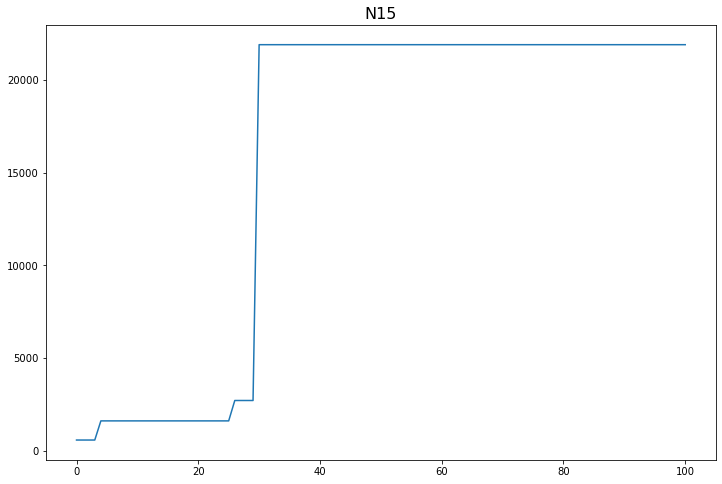

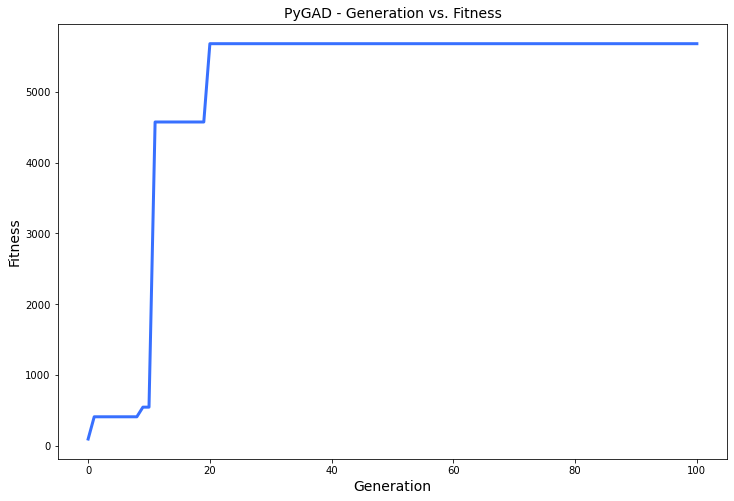

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.055 |==================| 5.038 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.988 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.08 |==================| 5.787 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.208 |==================| 22.082 |==========| N16 |==========
**********************************************************************
=

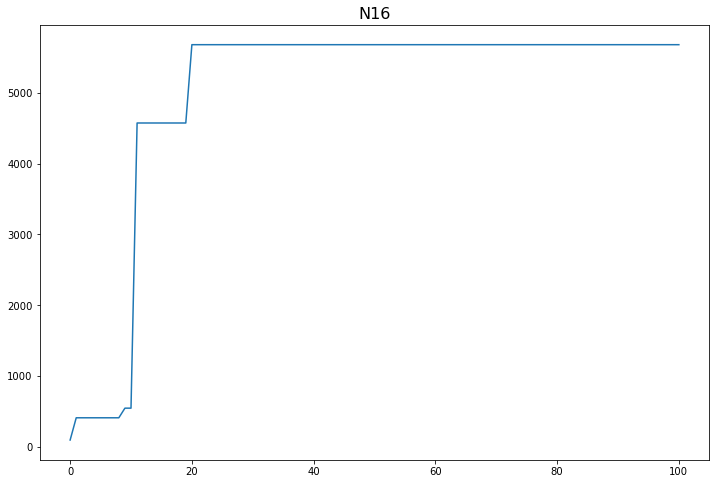

In [14]:
for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    
    if water_model.node in choosen_nodes_for_leak:
        water_model.run(plot_graph=False) # Check if node is our choosen node and add leak
    else:
        wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
        result = water_model.simulate(wn,plot_graph=False)
        water_model.function_inputs = 0.5
        water_model.desired_output = result.node['pressure'].loc[:,water_model.node][0]
        
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "/Fitness_" + val
    plt.savefig(water_model.plots_dir+fitness_name, dpi=150)

In [15]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]*0.5))

pressure = results.node['pressure']
presssure = pressure.loc[:,water_model.node]
print(presssure)

0    27.253019
Name: N16, dtype: float64


In [16]:
# Check the model's prediction
prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))

if ga_instance.best_solution_generation != -1:
    print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))

Predicted output based on the best solution :0.0003548681248704
Best fitness value reached after 20 generations.


In [46]:
directories = os.listdir('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/')
directories

['solutions_for_N6',
 'solutions_for_N1',
 'solutions_for_N8',
 'solutions_for_N9',
 'solutions_for_N7',
 'solutions_for_N10',
 'solutions_for_N11',
 'solutions_for_N16',
 'solutions_for_N2',
 'solutions_for_N5',
 'solutions_for_N4',
 'solutions_for_N3',
 'solutions_for_N13',
 'solutions_for_N14',
 'solutions_for_N15',
 'solutions_for_N12']

In [51]:
for sol in range(len(directories)):
    fitness_solution_per_population = glob.glob(os.path.join('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/',directories[sol],'FITNESS_SOLUTION_N*'))
    water_model.export_results(solutions = fitness_solution_per_population, path=water_model.merged_result, name='merged-optimization-result-per-fitness_'+directories[sol])

File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N6.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N1.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N8.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N9.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N7.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-fitness_solutions_for_N10.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-res

In [53]:
water_model.merged_result

'../leak_location_results/no_leak/merged_results-new'

In [54]:
# Merged all merged solutions into one csv file
merged_solution_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-*')
water_model.export_results(solutions = merged_solution_results, path=water_model.merged_result, name='super-merged-solution')

File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/super-merged-solution.csv


In [55]:
merged_solution_results_data = pd.read_csv(water_model.merged_result+'/super-merged-solution.csv')

In [56]:
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
0,0.467675,25.017230,23.0,7.041427,N8
1,0.813673,24.911004,23.0,4.028315,N8
2,0.940378,24.871864,23.0,3.479681,N8
3,0.955430,24.867206,23.0,3.424180,N8
4,0.367317,25.047859,23.0,8.977617,N8
...,...,...,...,...,...
30715,0.881387,23.978442,13.0,22.121491,N5
30716,0.844346,23.980358,13.0,23.100918,N5
30717,0.776423,23.983869,13.0,25.139769,N5
30718,0.707577,23.987422,13.0,27.605773,N5


In [57]:
merged_solution_results_data = merged_solution_results_data.sort_values(by='FITNESS', ascending=True)
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
13449,0.018804,23.824823,1.5,0.808931,N14
13556,0.004184,23.845861,1.5,0.822936,N14
14651,0.001641,23.849511,1.5,0.825416,N14
15105,0.999526,23.852546,1.5,0.827489,N14
14864,0.999380,23.852756,1.5,0.827632,N14
...,...,...,...,...,...
8279,0.000071,28.970093,1.2,117484.473813,N10
17641,0.000360,9.370606,1.0,151342.811773,N1
25889,0.000065,26.617935,10.1,166913.481757,N6
18002,0.000295,9.370607,1.0,179021.659333,N1


In [69]:
# merge fitness across generations for each node
directories = os.listdir('../leak_location_results/no_leak/each-node-optimization-results-csvs-new/')
for sol in range(len(directories)):
    fitness_solution_per_generation = glob.glob(os.path.join('../leak_location_results/no_leak/each-node-optimization-results-csvs-new',directories[sol],'GENERATION_*'))
    water_model.export_results(solutions = fitness_solution_per_generation, path=water_model.merged_result, name='merged-optimization-result-per-generation_'+directories[sol].lower())

File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n6.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n1.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n8.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n9.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n7.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merged-optimization-result-per-generation_solutions_for_n10.csv
File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/merge

In [68]:
water_model.merged_result

'../leak_location_results/no_leak/merged_results-new'

In [70]:
# Merged all merged generation into one csv file
merged_generation_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-generation_*')
water_model.export_results(solutions = merged_generation_results, path=water_model.merged_result, name='super-merged-generation')

File Exported Successfully to path: ../leak_location_results/no_leak/merged_results-new/super-merged-generation.csv


In [71]:
merged_generation_results = pd.read_csv(water_model.merged_result+'/super-merged-generation.csv')
merged_generation_results = merged_generation_results.sort_values(by='NODE', ascending=True)
merged_generation_results

,GENERATION,FITNESS,NODE
200,87,179021.659333,N1
272,17,179021.659333,N1
271,15,179021.659333,N1
270,29,179021.659333,N1
269,28,179021.659333,N1
...,...,...,...
1128,83,11923.166545,N9
1127,95,11923.166545,N9
1126,81,11923.166545,N9
1124,42,2157.803998,N9


In [72]:
# merge the solution per generation and solution
final_data = pd.merge(merged_solution_results_data,merged_generation_results, how='outer',left_on='FITNESS',right_on='FITNESS')
final_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE_x,GENERATION,NODE_y
0,0.018804,23.824823,1.5,0.808931,N14,NaN,NaN
1,0.004184,23.845861,1.5,0.822936,N14,NaN,NaN
2,0.001641,23.849511,1.5,0.825416,N14,NaN,NaN
3,0.999526,23.852546,1.5,0.827489,N14,NaN,NaN
4,0.999380,23.852756,1.5,0.827632,N14,NaN,NaN
...,...,...,...,...,...,...,...
32241,NaN,NaN,NaN,3156.314405,NaN,77.0,N7
32242,NaN,NaN,NaN,3156.314405,NaN,78.0,N7
32243,NaN,NaN,NaN,3156.314405,NaN,79.0,N7
32244,NaN,NaN,NaN,225.386205,NaN,1.0,N8


In [73]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_data=final_data.groupby(['NODE_x'],sort=True)['FITNESS'].max()
grouped_data=grouped_data.to_frame().sort_values('FITNESS',ascending=False)
grouped_data

,FITNESS
NODE_x,
N3,179534.721269
N1,179021.659333
N6,166913.481757
N10,117484.473813
N7,50520.025822
N2,35371.946600
N5,32413.682230
N15,21906.332806
N8,18134.988377


In [74]:
highest_fitted_node=grouped_data.index[grouped_data['FITNESS'] == max(grouped_data['FITNESS'])].to_list()[0]
print(highest_fitted_node, 'has the highest fitness in the network')

N3 has the highest fitness in the network


In [75]:
generation_=merged_generation_results[merged_generation_results['NODE']==highest_fitted_node] 
generation_=generation_.sort_values(by='FITNESS',ascending=True)
generation_

,GENERATION,FITNESS,NODE
136,2,279.572046,N3
137,3,279.572046,N3
126,1,279.572046,N3
105,7,608.107946,N3
170,10,608.107946,N3
...,...,...,...
192,73,179534.721269,N3
193,98,179534.721269,N3
194,65,179534.721269,N3
196,59,179534.721269,N3


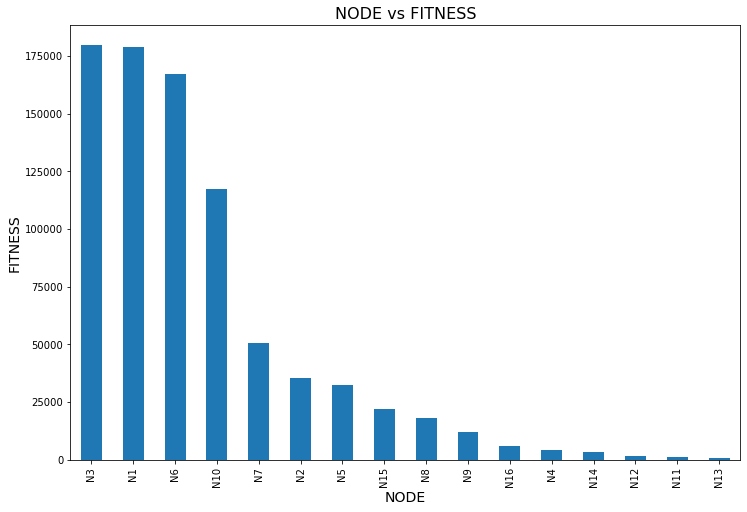

In [76]:
grouped_data['FITNESS'].plot(kind='bar')
plt.xlabel('NODE',fontsize=14) 
plt.ylabel('FITNESS',fontsize=14) 
plt.title('NODE vs FITNESS',fontsize=16) 
plt.show();
plt.savefig(water_model.plots_dir+"/node_with_best_fitness.png") 
plt.close()

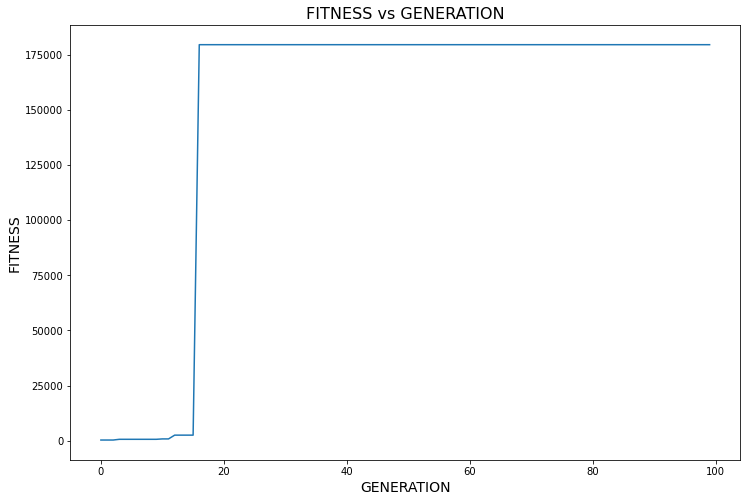

In [77]:
plt.plot(list(range(len(generation_))),generation_['FITNESS']) 
plt.xlabel('GENERATION',fontsize=14)  
plt.ylabel('FITNESS',fontsize=14)
plt.title('FITNESS vs GENERATION',fontsize=16) 
plt.savefig(water_model.plots_dir+"/FITNESS_vs_GENERATION.png") 
plt.show();

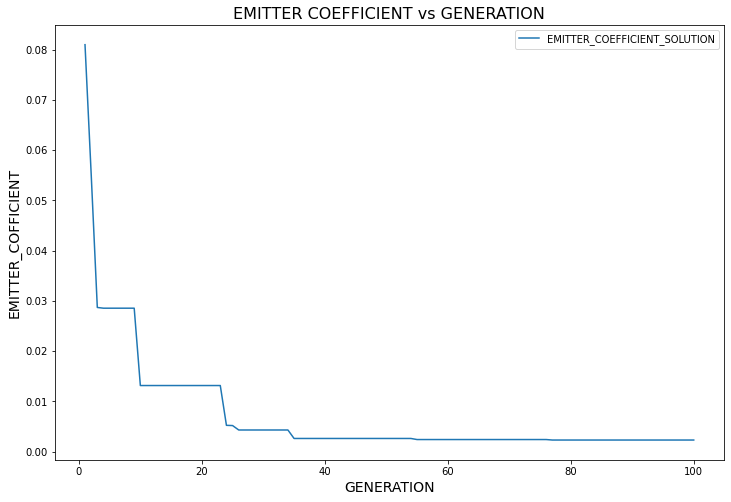

In [78]:
final_data.groupby(['GENERATION'])['EMITTER_COEFFICIENT_SOLUTION'].max().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs GENERATION',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT.png");
plt.close()

In [79]:
# final_data.groupby(['NODE_x'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot(kind='bar')
# plt.xlabel('NODE',fontsize=14)
# plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
# plt.title('EMITTER COEFFICIENT vs NODE',fontsize=16)
# plt.show();
# plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT_vs_NODE.png");
# plt.close()

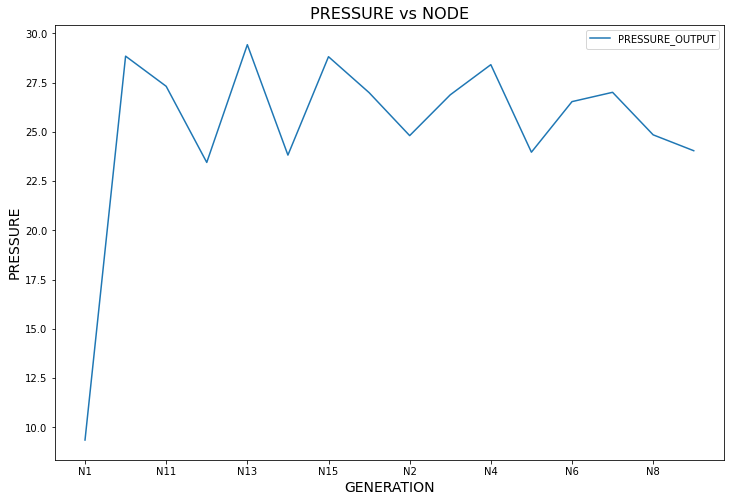

In [80]:
final_data.groupby(['NODE_x'])['PRESSURE_OUTPUT'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

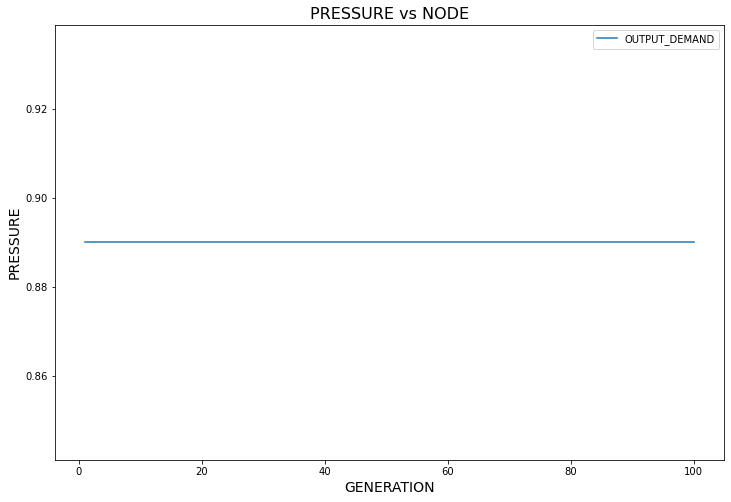

In [81]:
final_data.groupby(['GENERATION'])['OUTPUT_DEMAND'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

## Visualize the Rest of the Fitness for other nodes as well

In [ ]:
# water_model.plots_dir = 'each-node-optimization-plots'

In [ ]:
# # Fitness across all nodes
# fitness_plots = [os.path.join(water_model.plots_dir,file) \
#                  for file in os.listdir(water_model.plots_dir) \
#                  if file.endswith('.png') or file.endswith('.jpg')]
# fitness_plots

In [ ]:
# plt.rcParams['figure.figsize'] = (10,7)

In [ ]:
# # subplot 16 images
# i = 4
# j = 0

# for _ in range(len(fitness_plots)//4):
#     fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
#     axs = axs.ravel()

#     for index, val in enumerate(fitness_plots[j:i]):
#         img = plt.imread(val)
#         axs[index].imshow(img)
#         axs[index].axis('off')
#     fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
#     plt.savefig(water_model.plots_dir+str(f'/fitness/Fitness_group_{j}.png'))
#     plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)
#     j=i
#     i+=4
        
